<a href="https://colab.research.google.com/github/descartesmbogning/phage-therapy-funding/blob/main/Key_Players_phage_therapy_funding.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# import data


In [ ]:
import nltk
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from wordcloud import WordCloud
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from collections import Counter
nltk.download('punkt')
import textwrap

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [ ]:
# Load your dataset

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
pd.set_option('display.max_columns', None)

## import all raw data

In [ ]:
import pandas as pd

# Read the tab delimited file
df1 = pd.read_excel('/content/drive/Othercomputers/My laptop/D:/PROJECT/YORK UNIVERSITY/phage funding/DATA_CLEAN_to_used4.xlsx')
print(df1.shape)
df1['Research Organization - standardized'] = df1['Research Organization - standardized'].str.title()
df1['Researchers'] = df1['Researchers'].str.title().replace('[]', '')
df1.head()

(818, 44)


,Rank,Grant ID,Grant Number(s),Title,Title translated,Abstract,Abstract translated,Keywords,Colonne1,includes ?,Funding amount,Currency,Funding amount in USD,Start date,Start Year,End Date,End Year,Researchers,Research Organization - original,Research Organization - standardized,GRID ID,City of standardized research organization,State of standardized research organization,Country of standardized research organization,Funder,Funder Type,Funder Group,Funder Country,Funder Region,Funder Income group,funder Global north - south,Program,NIH activity code,Resulting publications,Source Linkout,Dimensions URL,Fields of Research (ANZSRC 2020),RCDC Categories,HRCS HC Categories,HRCS RAC Categories,Cancer Types,CSO Categories,Units of Assessment,Sustainable Development Goals
0,1032,grant.2508904,R01GM021941,Gene Control in Infection and Lysogeny by Phag...,Gene Control in Infection and Lysogeny by Phag...,DESCRIPTION (provided by applicant): The objec...,DESCRIPTION (provided by applicant): The objec...,ATP Hydrolysis; Affect; Bacteria; Bacteriophag...,",",1,6150038,USD,6150038,1978-02-01,1978,2014-01-31,2014.0,Jeffrey W Roberts,CORNELL UNIVERSITY,Cornell University,grid.5386.8,Ithaca,New York,United States,National Institute of General Medical Sciences,Facility,US Federal Funders; NIH - National Institutes ...,United States,North America,High income,Global North,Non-SBIR/STTR (Funding Mechanism),R01,pub.1079584441; pub.1062720198; pub.1019119131...,http://projectreporter.nih.gov/project_info_de...,https://app.dimensions.ai/details/grant/grant....,31 Biological Sciences; 3102 Bioinformatics an...,Infectious Diseases; Genetics; HIV/AIDS,Infection; Generic health relevance,1.1 Normal biological development and functioning,Not Site-Specific Cancer,1.1 Normal Functioning,A05 Biological Sciences,NaN
1,1351,grant.6254706,62850101,Evaluation of Water Treatment Processes Using ...,Evaluation of Water Treatment Processes Using ...,A new method was developed to evaluate the rem...,A new method was developed to evaluate the rem...,Chlorination; Activated Sludge Particulate; In...,",",1,6500000,JPY,44888,1987-01-01,1987,1989-12-31,1989.0,"Shinichiro Ohgaki, Shinichiro Ogaki, Akiko Miy...",The University of Tokyo; Faculty of Engineerin...,University Of Tokyo; Ebara (Japan),grid.26999.3d; grid.471037.6,Tokyo,;,Japan,Japan Society for the Promotion of Science,Nonprofit,NaN,Japan,Asia,High income,Global North,Single-year Grants (Allocation Type),Not available,NaN,https://kaken.nii.ac.jp/grant/KAKENHI-PROJECT-...,https://app.dimensions.ai/details/grant/grant....,40 Engineering; 4004 Chemical Engineering; 401...,NaN,NaN,NaN,NaN,NaN,B12 Engineering,NaN
2,1001,grant.6260464,63771020,バクテリオフェオフォルバイドとYAG-Laserによる深部到達性光化学療法の開発,The development of deep reachability photochem...,NaN,NaN,NaN,",",1,900000,JPY,6214,1988-01-01,1988,1988-12-31,1988.0,Maeda Tomiyoshi,Asahikawa Medical College; 旭川医科大学,Asahikawa Medical University,grid.252427.4,Asahikawa,NaN,Japan,Japan Society for the Promotion of Science,Nonprofit,NaN,Japan,Asia,High income,Global North,Single-year Grants (Allocation Type),Not available,NaN,https://kaken.nii.ac.jp/grant/KAKENHI-PROJECT-...,https://app.dimensions.ai/details/grant/grant....,32 Biomedical and Clinical Sciences; 4404 Deve...,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1021,grant.6256045,63550391,下水処理施設内におけるコリファージの不活性化に関する調査及び実験研究,Research and experimental study on the inactiv...,(1)活性汚泥処理において、最終沈澱池越流水までの年平均除去率は大腸菌群、腸球菌およびコリフ...,"(1) In the activated sludge process, the final...",Watering filter bed; Activated sludge; Inactiv...,",",1,2300000,JPY,15886,1988-01-01,1988,1988-12-31,1988.0,"Tatsuo Omura, Teruyuki Umita, Shinichiro Ohgaki",Iwate University; 岩手大学; 東京大学,Iwate University; University Of Tokyo,grid.411792.8; grid.26999.3d,Morioka; Tokyo,;,Japan,Japan Society for the Promotion of Science,Nonprofit,NaN,Japan,Asia,High income,Global North,Single-year Grants (Allocation Type),Not available,NaN,https://kaken.nii.ac.jp/grant/KAKENHI-PROJECT-...,https://a

In [ ]:
df1 = df1[(df1['Start Year'] >= 1999) & (df1['Start Year'] < 2024)]
print(df1.shape)
df1.head(1)

(802, 44)


,Rank,Grant ID,Grant Number(s),Title,Title translated,Abstract,Abstract translated,Keywords,Colonne1,includes ?,Funding amount,Currency,Funding amount in USD,Start date,Start Year,End Date,End Year,Researchers,Research Organization - original,Research Organization - standardized,GRID ID,City of standardized research organization,State of standardized research organization,Country of standardized research organization,Funder,Funder Type,Funder Group,Funder Country,Funder Region,Funder Income group,funder Global north - south,Program,NIH activity code,Resulting publications,Source Linkout,Dimensions URL,Fields of Research (ANZSRC 2020),RCDC Categories,HRCS HC Categories,HRCS RAC Categories,Cancer Types,CSO Categories,Units of Assessment,Sustainable Development Goals
15,995,grant.7139800,BC996337; DAMD17-01-1-0644,Targeting Bone Marrow in vivo by a novel phage...,Targeting Bone Marrow in vivo by a novel phage...,TECHNICAL ABSTRACT\nUse of the phage display l...,TECHNICAL ABSTRACT\nUse of the phage display l...,NaN,",",1,75000,USD,75000,1999-10-01,1999,2000-09-01,2000.0,Amin Hajitou,"M.D. ANDERSON CANCER CENTER, UNIVERSITY OF TEXAS",The University Of Texas Md Anderson Cancer Center,grid.240145.6,Houston,Texas,United States,Congressionally Directed Medical Research Prog...,Government,DoD - United States Department of Defense; US ...,United States,North America,High income,Global North,BCRP (Program); Concept Award (Funding Mechanism),Not available,pub.1018368931; pub.1030297064; pub.1044312036,NaN,https://app.dimensions.ai/details/grant/grant....,31 Biological Sciences; 3206 Medical Biotechno...,Biotechnology,NaN,NaN,Breast Cancer,4.1 Technology Development and/or Marker Disco...,B11 Computer Science and Informatics,NaN


## import topic lda data

In [ ]:
import pandas as pd

# Read the tab delimited file
df3 = pd.read_pickle('/content/drive/Othercomputers/My laptop/D:/PROJECT/YORK UNIVERSITY/phage funding/data_preprocesse/topic_probability_phage_funding.pkl')
print(df3.shape)
df3 = df3.reset_index()[['Grant ID','Topic N°']]
df3.head()

(799, 41)


,Grant ID,Topic N°
0,grant.7444531,4
1,grant.6256045,1
2,grant.6076691,0
3,grant.8683185,0
4,grant.9333780,0


## merge raw data and topics

In [ ]:
data_all = pd.merge(df1, df3, on='Grant ID', how='left')
print(data_all.shape)
data_all.head(1)

(802, 45)


,Rank,Grant ID,Grant Number(s),Title,Title translated,Abstract,Abstract translated,Keywords,Colonne1,includes ?,Funding amount,Currency,Funding amount in USD,Start date,Start Year,End Date,End Year,Researchers,Research Organization - original,Research Organization - standardized,GRID ID,City of standardized research organization,State of standardized research organization,Country of standardized research organization,Funder,Funder Type,Funder Group,Funder Country,Funder Region,Funder Income group,funder Global north - south,Program,NIH activity code,Resulting publications,Source Linkout,Dimensions URL,Fields of Research (ANZSRC 2020),RCDC Categories,HRCS HC Categories,HRCS RAC Categories,Cancer Types,CSO Categories,Units of Assessment,Sustainable Development Goals,Topic N°
0,995,grant.7139800,BC996337; DAMD17-01-1-0644,Targeting Bone Marrow in vivo by a novel phage...,Targeting Bone Marrow in vivo by a novel phage...,TECHNICAL ABSTRACT\nUse of the phage display l...,TECHNICAL ABSTRACT\nUse of the phage display l...,NaN,",",1,75000,USD,75000,1999-10-01,1999,2000-09-01,2000.0,Amin Hajitou,"M.D. ANDERSON CANCER CENTER, UNIVERSITY OF TEXAS",The University Of Texas Md Anderson Cancer Center,grid.240145.6,Houston,Texas,United States,Congressionally Directed Medical Research Prog...,Government,DoD - United States Department of Defense; US ...,United States,North America,High income,Global North,BCRP (Program); Concept Award (Funding Mechanism),Not available,pub.1018368931; pub.1030297064; pub.1044312036,NaN,https://app.dimensions.ai/details/grant/grant....,31 Biological Sciences; 3206 Medical Biotechno...,Biotechnology,NaN,NaN,Breast Cancer,4.1 Technology Development and/or Marker Disco...,B11 Computer Science and Informatics,NaN,2.0


## import gender data

In [ ]:
import pandas as pd

# Read the tab delimited file
gender_data = pd.read_excel('/content/drive/Othercomputers/My laptop/D:/PROJECT/YORK UNIVERSITY/phage funding/gender_data.xlsx')
print(gender_data.shape)
gender_data['Researchers'] = gender_data['Researchers'].str.title().replace('[]', '')
gender_data['gender_bon'] = gender_data['gender_bon'].str.title()
gender_data.head()

(1093, 2)


,Researchers,gender_bon
0,Miki Matsuo,Female
1,Otomi Cho,Female
2,Zuo Joan Zhong,Female
3,Yaya Guan,Female
4,Arshnee Moodley,Female


## import clean research org. metadata


In [ ]:
# #data_topic = pd.read_csv ('/content/drive/MyDrive/YORKU PROJECT/JUDE/BACTERIOPHAGE/patent-phage-therapy-lens-23102023-tiab.csv')
research_org_metadata = pd.read_excel('/content/drive/Othercomputers/My laptop/D:/PROJECT/YORK UNIVERSITY/phage funding/Receiver_data.xlsx')
research_org_metadata['Research Organization - standardized'] = research_org_metadata['Research Organization - standardized'].str.title()
# pd.set_option('display.max_columns', None)
print(len(research_org_metadata))
research_org_metadata.head(1)

534


,Research Organization - standardized,Receiver - GRID ID,Receiver - City of standardized research organization,Receiver - State of standardized research organization,Receiver - Country of standardized research organization,Receiver - Region of standardized research organization,Receiver - Type of standardized research organization,Receiver - Income group,Receiver - Global north - south
0,National Museum Of Australia,NaN,NaN,NaN,Australia,Oceania,Archive,High income,Global North


In [ ]:
research_org_metadata.columns

Index(['Research Organization - standardized', 'Receiver - GRID ID',
       'Receiver - City of standardized research organization',
       'Receiver - State of standardized research organization',
       'Receiver - Country of standardized research organization',
       'Receiver - Region of standardized research organization',
       'Receiver - Type of standardized research organization',
       'Receiver - Income group', 'Receiver - Global north - south'],
      dtype='object')

# data preprocessing

## rename topics

In [ ]:
import pandas as pd
topics_rename = {
    0: 'Bacterial Genetics and Mechanisms',
    1: 'Antibiotic Resistance and Therapeutic Strategies',
    2: 'Immunotherapy and Targeted Treatments',
    3: 'Not Class.',# 'Topic 3',
    4: 'Bacteriophage Therapy and Infectious Disease Control',
    5: 'Topic 5',
    6: 'Topic 6',
    7: 'Topic 7',
    8: 'Topic 8',
    9: 'Topic 9',
    10: 'Topic 10',
    #
    '0': 'Bacterial Genetics and Mechanisms',
    '1': 'Antibiotic Resistance and Therapeutic Strategies',
    '2': 'Immunotherapy and Targeted Treatments',
    '3': 'Not Class.', #'Topic 3',
    '4': 'Bacteriophage Therapy and Infectious Disease Control',
    '5': 'Topic 5',
    '6': 'Topic 6',
    '7': 'Topic 7',
    '8': 'Topic 8',
    '9': 'Topic 9',
    '10': 'Topic 10',
    np.nan : 'Not Class.',
}

#
data_all['Topic N°'] = data_all['Topic N°'].map(topics_rename)#.fillna(data_topic['Topic N°'])
data_all.head(1)

,Rank,Grant ID,Grant Number(s),Title,Title translated,Abstract,Abstract translated,Keywords,Colonne1,includes ?,Funding amount,Currency,Funding amount in USD,Start date,Start Year,End Date,End Year,Researchers,Research Organization - original,Research Organization - standardized,GRID ID,City of standardized research organization,State of standardized research organization,Country of standardized research organization,Funder,Funder Type,Funder Group,Funder Country,Funder Region,Funder Income group,funder Global north - south,Program,NIH activity code,Resulting publications,Source Linkout,Dimensions URL,Fields of Research (ANZSRC 2020),RCDC Categories,HRCS HC Categories,HRCS RAC Categories,Cancer Types,CSO Categories,Units of Assessment,Sustainable Development Goals,Topic N°
0,995,grant.7139800,BC996337; DAMD17-01-1-0644,Targeting Bone Marrow in vivo by a novel phage...,Targeting Bone Marrow in vivo by a novel phage...,TECHNICAL ABSTRACT\nUse of the phage display l...,TECHNICAL ABSTRACT\nUse of the phage display l...,NaN,",",1,75000,USD,75000,1999-10-01,1999,2000-09-01,2000.0,Amin Hajitou,"M.D. ANDERSON CANCER CENTER, UNIVERSITY OF TEXAS",The University Of Texas Md Anderson Cancer Center,grid.240145.6,Houston,Texas,United States,Congressionally Directed Medical Research Prog...,Government,DoD - United States Department of Defense; US ...,United States,North America,High income,Global North,BCRP (Program); Concept Award (Funding Mechanism),Not available,pub.1018368931; pub.1030297064; pub.1044312036,NaN,https://app.dimensions.ai/details/grant/grant....,31 Biological Sciences; 3206 Medical Biotechno...,Biotechnology,NaN,NaN,Breast Cancer,4.1 Technology Development and/or Marker Disco...,B11 Computer Science and Informatics,NaN,Immunotherapy and Targeted Treatments


## add classifications to entitities

#### function

In [ ]:
def clean_entities(sep, df1, df2, col_old, col_clean, col_name):
    # Create a dictionary from df2 for mapping
    df1[col_old] = df1[col_old].apply(lambda x: [item.strip() for item in str(x).split(sep)] if pd.notnull(x) else x)
    df1[col_old] = df1[col_old].apply(lambda x: sep.join(list(set(x))) if isinstance(x, list) else x)
    df2[col_clean] = df2[col_clean].str.strip()

    entity_dict = df2.set_index(col_old)[col_clean].to_dict()

    # Function to clean a single cell
    #def clean_cell(cell):
    def clean_cell(cell):
        if isinstance(cell, str):
            entities = cell.split(sep)
            cleaned = list(set([entity_dict.get(entity, entity) for entity in entities if isinstance(entity_dict.get(entity, entity), str)]))
            return ';'.join(cleaned)
        else:
            return cell


    # Apply the function to each cell in the 'entities_lemat_stop2' column
    df1[col_name] = df1[col_old].apply(clean_cell)

    return df1

# Use the function
#df1_clean = clean_entities(df1, df2)


#### add researcher gender column


In [ ]:
df1 = data_all
df2 =  gender_data
col_old =  'Researchers'
col_clean =  'gender_bon'
col_name = 'Gender'

data_all = clean_entities(',', df1, df2, col_old, col_clean, col_name)#.reset_index()
data_all.head(1)

,Rank,Grant ID,Grant Number(s),Title,Title translated,Abstract,Abstract translated,Keywords,Colonne1,includes ?,Funding amount,Currency,Funding amount in USD,Start date,Start Year,End Date,End Year,Researchers,Research Organization - original,Research Organization - standardized,GRID ID,City of standardized research organization,State of standardized research organization,Country of standardized research organization,Funder,Funder Type,Funder Group,Funder Country,Funder Region,Funder Income group,funder Global north - south,Program,NIH activity code,Resulting publications,Source Linkout,Dimensions URL,Fields of Research (ANZSRC 2020),RCDC Categories,HRCS HC Categories,HRCS RAC Categories,Cancer Types,CSO Categories,Units of Assessment,Sustainable Development Goals,Topic N°,Gender
0,995,grant.7139800,BC996337; DAMD17-01-1-0644,Targeting Bone Marrow in vivo by a novel phage...,Targeting Bone Marrow in vivo by a novel phage...,TECHNICAL ABSTRACT\nUse of the phage display l...,TECHNICAL ABSTRACT\nUse of the phage display l...,NaN,",",1,75000,USD,75000,1999-10-01,1999,2000-09-01,2000.0,Amin Hajitou,"M.D. ANDERSON CANCER CENTER, UNIVERSITY OF TEXAS",The University Of Texas Md Anderson Cancer Center,grid.240145.6,Houston,Texas,United States,Congressionally Directed Medical Research Prog...,Government,DoD - United States Department of Defense; US ...,United States,North America,High income,Global North,BCRP (Program); Concept Award (Funding Mechanism),Not available,pub.1018368931; pub.1030297064; pub.1044312036,NaN,https://app.dimensions.ai/details/grant/grant....,31 Biological Sciences; 3206 Medical Biotechno...,Biotechnology,NaN,NaN,Breast Cancer,4.1 Technology Development and/or Marker Disco...,B11 Computer Science and Informatics,NaN,Immunotherapy and Targeted Treatments,Male


#### add Receiver - Country of standardized research organization columns

In [ ]:
df1 = data_all
df2 =  research_org_metadata
col_old =  'Research Organization - standardized'
col_clean =  'Receiver - Country of standardized research organization'
col_name = 'Receiver - Country of standardized research organization'

data_all = clean_entities(';', df1, df2, col_old, col_clean, col_name)#.reset_index()
data_all.head(1)

,Rank,Grant ID,Grant Number(s),Title,Title translated,Abstract,Abstract translated,Keywords,Colonne1,includes ?,Funding amount,Currency,Funding amount in USD,Start date,Start Year,End Date,End Year,Researchers,Research Organization - original,Research Organization - standardized,GRID ID,City of standardized research organization,State of standardized research organization,Country of standardized research organization,Funder,Funder Type,Funder Group,Funder Country,Funder Region,Funder Income group,funder Global north - south,Program,NIH activity code,Resulting publications,Source Linkout,Dimensions URL,Fields of Research (ANZSRC 2020),RCDC Categories,HRCS HC Categories,HRCS RAC Categories,Cancer Types,CSO Categories,Units of Assessment,Sustainable Development Goals,Topic N°,Gender,Receiver - Country of standardized research organization
0,995,grant.7139800,BC996337; DAMD17-01-1-0644,Targeting Bone Marrow in vivo by a novel phage...,Targeting Bone Marrow in vivo by a novel phage...,TECHNICAL ABSTRACT\nUse of the phage display l...,TECHNICAL ABSTRACT\nUse of the phage display l...,NaN,",",1,75000,USD,75000,1999-10-01,1999,2000-09-01,2000.0,Amin Hajitou,"M.D. ANDERSON CANCER CENTER, UNIVERSITY OF TEXAS",The University Of Texas Md Anderson Cancer Center,grid.240145.6,Houston,Texas,United States,Congressionally Directed Medical Research Prog...,Government,DoD - United States Department of Defense; US ...,United States,North America,High income,Global North,BCRP (Program); Concept Award (Funding Mechanism),Not available,pub.1018368931; pub.1030297064; pub.1044312036,NaN,https://app.dimensions.ai/details/grant/grant....,31 Biological Sciences; 3206 Medical Biotechno...,Biotechnology,NaN,NaN,Breast Cancer,4.1 Technology Development and/or Marker Disco...,B11 Computer Science and Informatics,NaN,Immunotherapy and Targeted Treatments,Male,United States


#### add Receiver - Region of standardized research organization columns

In [ ]:
df1 = data_all
df2 =  research_org_metadata
col_old =  'Research Organization - standardized'
col_clean =  'Receiver - Region of standardized research organization'
col_name = 'Receiver - Region of standardized research organization'

data_all = clean_entities(';', df1, df2, col_old, col_clean, col_name)#.reset_index()
data_all.head(1)

,Rank,Grant ID,Grant Number(s),Title,Title translated,Abstract,Abstract translated,Keywords,Colonne1,includes ?,Funding amount,Currency,Funding amount in USD,Start date,Start Year,End Date,End Year,Researchers,Research Organization - original,Research Organization - standardized,GRID ID,City of standardized research organization,State of standardized research organization,Country of standardized research organization,Funder,Funder Type,Funder Group,Funder Country,Funder Region,Funder Income group,funder Global north - south,Program,NIH activity code,Resulting publications,Source Linkout,Dimensions URL,Fields of Research (ANZSRC 2020),RCDC Categories,HRCS HC Categories,HRCS RAC Categories,Cancer Types,CSO Categories,Units of Assessment,Sustainable Development Goals,Topic N°,Gender,Receiver - Country of standardized research organization,Receiver - Region of standardized research organization
0,995,grant.7139800,BC996337; DAMD17-01-1-0644,Targeting Bone Marrow in vivo by a novel phage...,Targeting Bone Marrow in vivo by a novel phage...,TECHNICAL ABSTRACT\nUse of the phage display l...,TECHNICAL ABSTRACT\nUse of the phage display l...,NaN,",",1,75000,USD,75000,1999-10-01,1999,2000-09-01,2000.0,Amin Hajitou,"M.D. ANDERSON CANCER CENTER, UNIVERSITY OF TEXAS",The University Of Texas Md Anderson Cancer Center,grid.240145.6,Houston,Texas,United States,Congressionally Directed Medical Research Prog...,Government,DoD - United States Department of Defense; US ...,United States,North America,High income,Global North,BCRP (Program); Concept Award (Funding Mechanism),Not available,pub.1018368931; pub.1030297064; pub.1044312036,NaN,https://app.dimensions.ai/details/grant/grant....,31 Biological Sciences; 3206 Medical Biotechno...,Biotechnology,NaN,NaN,Breast Cancer,4.1 Technology Development and/or Marker Disco...,B11 Computer Science and Informatics,NaN,Immunotherapy and Targeted Treatments,Male,United States,North America


#### Receiver - Type of standardized research organization columns

In [ ]:
df1 = data_all
df2 =  research_org_metadata
col_old =  'Research Organization - standardized'
col_clean =  'Receiver - Type of standardized research organization'
col_name = 'Receiver - Type of standardized research organization'

data_all = clean_entities(';', df1, df2, col_old, col_clean, col_name)#.reset_index()
data_all.head(1)

,Rank,Grant ID,Grant Number(s),Title,Title translated,Abstract,Abstract translated,Keywords,Colonne1,includes ?,Funding amount,Currency,Funding amount in USD,Start date,Start Year,End Date,End Year,Researchers,Research Organization - original,Research Organization - standardized,GRID ID,City of standardized research organization,State of standardized research organization,Country of standardized research organization,Funder,Funder Type,Funder Group,Funder Country,Funder Region,Funder Income group,funder Global north - south,Program,NIH activity code,Resulting publications,Source Linkout,Dimensions URL,Fields of Research (ANZSRC 2020),RCDC Categories,HRCS HC Categories,HRCS RAC Categories,Cancer Types,CSO Categories,Units of Assessment,Sustainable Development Goals,Topic N°,Gender,Receiver - Country of standardized research organization,Receiver - Region of standardized research organization,Receiver - Type of standardized research organization
0,995,grant.7139800,BC996337; DAMD17-01-1-0644,Targeting Bone Marrow in vivo by a novel phage...,Targeting Bone Marrow in vivo by a novel phage...,TECHNICAL ABSTRACT\nUse of the phage display l...,TECHNICAL ABSTRACT\nUse of the phage display l...,NaN,",",1,75000,USD,75000,1999-10-01,1999,2000-09-01,2000.0,Amin Hajitou,"M.D. ANDERSON CANCER CENTER, UNIVERSITY OF TEXAS",The University Of Texas Md Anderson Cancer Center,grid.240145.6,Houston,Texas,United States,Congressionally Directed Medical Research Prog...,Government,DoD - United States Department of Defense; US ...,United States,North America,High income,Global North,BCRP (Program); Concept Award (Funding Mechanism),Not available,pub.1018368931; pub.1030297064; pub.1044312036,NaN,https://app.dimensions.ai/details/grant/grant....,31 Biological Sciences; 3206 Medical Biotechno...,Biotechnology,NaN,NaN,Breast Cancer,4.1 Technology Development and/or Marker Disco...,B11 Computer Science and Informatics,NaN,Immunotherapy and Targeted Treatments,Male,United States,North America,Education


#### add Receiver - Income group column


In [ ]:
df1 = data_all
df2 =  research_org_metadata
col_old =  'Research Organization - standardized'
col_clean =  'Receiver - Income group'
col_name = 'Receiver - Income group'

data_all = clean_entities(';', df1, df2, col_old, col_clean, col_name)#.reset_index()
data_all.head(1)

,Rank,Grant ID,Grant Number(s),Title,Title translated,Abstract,Abstract translated,Keywords,Colonne1,includes ?,Funding amount,Currency,Funding amount in USD,Start date,Start Year,End Date,End Year,Researchers,Research Organization - original,Research Organization - standardized,GRID ID,City of standardized research organization,State of standardized research organization,Country of standardized research organization,Funder,Funder Type,Funder Group,Funder Country,Funder Region,Funder Income group,funder Global north - south,Program,NIH activity code,Resulting publications,Source Linkout,Dimensions URL,Fields of Research (ANZSRC 2020),RCDC Categories,HRCS HC Categories,HRCS RAC Categories,Cancer Types,CSO Categories,Units of Assessment,Sustainable Development Goals,Topic N°,Gender,Receiver - Country of standardized research organization,Receiver - Region of standardized research organization,Receiver - Type of standardized research organization,Receiver - Income group
0,995,grant.7139800,BC996337; DAMD17-01-1-0644,Targeting Bone Marrow in vivo by a novel phage...,Targeting Bone Marrow in vivo by a novel phage...,TECHNICAL ABSTRACT\nUse of the phage display l...,TECHNICAL ABSTRACT\nUse of the phage display l...,NaN,",",1,75000,USD,75000,1999-10-01,1999,2000-09-01,2000.0,Amin Hajitou,"M.D. ANDERSON CANCER CENTER, UNIVERSITY OF TEXAS",The University Of Texas Md Anderson Cancer Center,grid.240145.6,Houston,Texas,United States,Congressionally Directed Medical Research Prog...,Government,DoD - United States Department of Defense; US ...,United States,North America,High income,Global North,BCRP (Program); Concept Award (Funding Mechanism),Not available,pub.1018368931; pub.1030297064; pub.1044312036,NaN,https://app.dimensions.ai/details/grant/grant....,31 Biological Sciences; 3206 Medical Biotechno...,Biotechnology,NaN,NaN,Breast Cancer,4.1 Technology Development and/or Marker Disco...,B11 Computer Science and Informatics,NaN,Immunotherapy and Targeted Treatments,Male,United States,North America,Education,High income




```
# This is formatted as code
```

#### Receiver - Global north - south

In [ ]:
df1 = data_all
df2 =  research_org_metadata
col_old =  'Research Organization - standardized'
col_clean =  'Receiver - Global north - south'
col_name = 'Receiver - Global north - south'

data_all = clean_entities(';', df1, df2, col_old, col_clean, col_name)#.reset_index()
data_all.head(1)

,Rank,Grant ID,Grant Number(s),Title,Title translated,Abstract,Abstract translated,Keywords,Colonne1,includes ?,Funding amount,Currency,Funding amount in USD,Start date,Start Year,End Date,End Year,Researchers,Research Organization - original,Research Organization - standardized,GRID ID,City of standardized research organization,State of standardized research organization,Country of standardized research organization,Funder,Funder Type,Funder Group,Funder Country,Funder Region,Funder Income group,funder Global north - south,Program,NIH activity code,Resulting publications,Source Linkout,Dimensions URL,Fields of Research (ANZSRC 2020),RCDC Categories,HRCS HC Categories,HRCS RAC Categories,Cancer Types,CSO Categories,Units of Assessment,Sustainable Development Goals,Topic N°,Gender,Receiver - Country of standardized research organization,Receiver - Region of standardized research organization,Receiver - Type of standardized research organization,Receiver - Income group,Receiver - Global north - south
0,995,grant.7139800,BC996337; DAMD17-01-1-0644,Targeting Bone Marrow in vivo by a novel phage...,Targeting Bone Marrow in vivo by a novel phage...,TECHNICAL ABSTRACT\nUse of the phage display l...,TECHNICAL ABSTRACT\nUse of the phage display l...,NaN,",",1,75000,USD,75000,1999-10-01,1999,2000-09-01,2000.0,Amin Hajitou,"M.D. ANDERSON CANCER CENTER, UNIVERSITY OF TEXAS",The University Of Texas Md Anderson Cancer Center,grid.240145.6,Houston,Texas,United States,Congressionally Directed Medical Research Prog...,Government,DoD - United States Department of Defense; US ...,United States,North America,High income,Global North,BCRP (Program); Concept Award (Funding Mechanism),Not available,pub.1018368931; pub.1030297064; pub.1044312036,NaN,https://app.dimensions.ai/details/grant/grant....,31 Biological Sciences; 3206 Medical Biotechno...,Biotechnology,NaN,NaN,Breast Cancer,4.1 Technology Development and/or Marker Disco...,B11 Computer Science and Informatics,NaN,Immunotherapy and Targeted Treatments,Male,United States,North America,Education,High income,Global North


In [ ]:
data_all.columns

Index(['Rank', 'Grant ID', 'Grant Number(s)', 'Title', 'Title translated',
       'Abstract', 'Abstract translated', 'Keywords', 'Colonne1', 'includes ?',
       'Funding amount', 'Currency', 'Funding amount in USD', 'Start date',
       'Start Year', 'End Date', 'End Year', 'Researchers',
       'Research Organization - original',
       'Research Organization - standardized', 'GRID ID',
       'City of standardized research organization',
       'State of standardized research organization',
       'Country of standardized research organization', 'Funder',
       'Funder Type', 'Funder Group', 'Funder Country', 'Funder Region',
       'Funder Income group', 'funder Global north - south', 'Program',
       'NIH activity code', 'Resulting publications', 'Source Linkout',
       'Dimensions URL', 'Fields of Research (ANZSRC 2020)', 'RCDC Categories',
       'HRCS HC Categories', 'HRCS RAC Categories', 'Cancer Types',
       'CSO Categories', 'Units of Assessment',
       'Sustainable De

### prepare for vosviewer

In [ ]:
data_all_copy = data_all.copy()

In [ ]:
import pandas as pd

def replace_semicolons(data, column_names):
    # Function to replace ';;' with '; '
    def replace(s):
        if isinstance(s, str):
            return s.replace(';', '; ')
        else:
            return s

    # Apply the function to each specified column
    for column_name in column_names:
        data[column_name] = data[column_name].apply(replace)

    return data


In [ ]:
columns_to_clean = ['Fields of Research (ANZSRC 2020)', 'RCDC Categories',
       'Receiver - Country of standardized research organization',
       'Receiver - Region of standardized research organization',
       'Receiver - Type of standardized research organization',
       'Receiver - Income group']
cleaned_data = replace_semicolons(data_all_copy, columns_to_clean)
cleaned_data.head()

,Rank,Grant ID,Grant Number(s),Title,Title translated,Abstract,Abstract translated,Keywords,Colonne1,includes ?,Funding amount,Currency,Funding amount in USD,Start date,Start Year,End Date,End Year,Researchers,Research Organization - original,Research Organization - standardized,GRID ID,City of standardized research organization,State of standardized research organization,Country of standardized research organization,Funder,Funder Type,Funder Group,Funder Country,Funder Region,Funder Income group,funder Global north - south,Program,NIH activity code,Resulting publications,Source Linkout,Dimensions URL,Fields of Research (ANZSRC 2020),RCDC Categories,HRCS HC Categories,HRCS RAC Categories,Cancer Types,CSO Categories,Units of Assessment,Sustainable Development Goals,Topic N°,Gender,Receiver - Country of standardized research organization,Receiver - Region of standardized research organization,Receiver - Type of standardized research organization,Receiver - Income group,Receiver - Global north - south
0,995,grant.7139800,BC996337; DAMD17-01-1-0644,Targeting Bone Marrow in vivo by a novel phage...,Targeting Bone Marrow in vivo by a novel phage...,TECHNICAL ABSTRACT\nUse of the phage display l...,TECHNICAL ABSTRACT\nUse of the phage display l...,NaN,",",1,75000,USD,75000,1999-10-01,1999,2000-09-01,2000.0,Amin Hajitou,"M.D. ANDERSON CANCER CENTER, UNIVERSITY OF TEXAS",The University Of Texas Md Anderson Cancer Center,grid.240145.6,Houston,Texas,United States,Congressionally Directed Medical Research Prog...,Government,DoD - United States Department of Defense; US ...,United States,North America,High income,Global North,BCRP (Program); Concept Award (Funding Mechanism),Not available,pub.1018368931; pub.1030297064; pub.1044312036,NaN,https://app.dimensions.ai/details/grant/grant....,31 Biological Sciences; 3206 Medical Biotechn...,Biotechnology,NaN,NaN,Breast Cancer,4.1 Technology Development and/or Marker Disco...,B11 Computer Science and Informatics,NaN,Immunotherapy and Targeted Treatments,Male,United States,North America,Education,High income,Global North
1,1498,grant.2655618,R43NS037627,DEVELOP MULTIPLE SCLEROSIS TREATMENT USING PHA...,DEVELOP MULTIPLE SCLEROSIS TREATMENT USING PHA...,DESCRIPTION: (Applicant's abstract) Multiple s...,DESCRIPTION: (Applicant's abstract) Multiple s...,bacterial virus; collagenase; enzyme inhibitor...,",",1,100000,USD,100000,1999-08-01,1999,2000-01-31,2000.0,Jasmin Enright,DYAX CORPORATION,Takeda (United States),grid.419849.9,Deerfield,Illinois,United States,National Institute of Neurological Disorders a...,Facility,US Federal Funders; NIH - National Institutes ...,United States,North America,High income,Global North,SBIR/STTR (Funding Mechanism),R43,NaN,http://projectreporter.nih.gov/project_info_de...,https://app.dimensions.ai/details/grant/grant....,32 Biomedical and Clinical Sciences; 3209 Neu...,Biotechnology; Neurodegenerative; Autoimmune...,Neurological,5.1 Pharmaceuticals,Nervous System,5.3 Systemic Therapies - Discovery and Develop...,"A06 Agriculture, Veterinary and Food Science",NaN,Immunotherapy and Targeted Treatments,Female,United States,North America,Company,High income,Global North
2,1142,grant.2796285,NaN,A Bacteriophage approach for the development o...,A Bacteriophage approach for the development o...,NaN,NaN,NaN,",",1,16967,CAD,11418,1999-04-01,1999,2000-03-31,2000.0,Jing Liu,Targanta Therapeutics Inc.; No Partners,Novartis (Canada),grid.436665.4,Mississauga,Ontario,Canada,Natural Sciences and Engineering Research Council,Government,ICRP - International Cancer Research Partnership,Canada,North America,High income,Global North,Industrial Research Fellowships (Program),Not available,NaN,http://www.nserc-crsng.gc.ca/ase-oro/Details-D...,https://app.dimensions.ai/details/grant/grant....,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Not Class.,Female,Canada,North America,Company,High income,Global North
3,1699,grant.2944505,NaN,A bacteriophage approach for the development o...,A bacteriophage appro

In [ ]:
cleaned_data_to_keep = cleaned_data[['Start Year','Funding amount in USD',
                                     'Fields of Research (ANZSRC 2020)', 'RCDC Categories',
                                     'Research Organization - standardized',
                                      'Receiver - Country of standardized research organization',
                                      'Receiver - Region of standardized research organization',
                                      'Receiver - Type of standardized research organization',
                                      'Receiver - Income group'
                                      ]]

cleaned_data_to_keep = cleaned_data_to_keep.rename(columns={
    'Start Year': 'Publication Year',
    'Funding amount in USD': 'Citing Works Count',
})
cleaned_data_to_keep.head()

,Publication Year,Citing Works Count,Fields of Research (ANZSRC 2020),RCDC Categories,Research Organization - standardized,Receiver - Country of standardized research organization,Receiver - Region of standardized research organization,Receiver - Type of standardized research organization,Receiver - Income group
0,1999,75000,31 Biological Sciences; 3206 Medical Biotechn...,Biotechnology,The University Of Texas Md Anderson Cancer Center,United States,North America,Education,High income
1,1999,100000,32 Biomedical and Clinical Sciences; 3209 Neu...,Biotechnology; Neurodegenerative; Autoimmune...,Takeda (United States),United States,North America,Company,High income
2,1999,11418,NaN,NaN,Novartis (Canada),Canada,North America,Company,High income
3,1999,16828,NaN,NaN,Novartis (Canada),Canada,North America,Company,High income
4,1999,475939,32 Biomedical and Clinical Sciences; 3204 Imm...,Vaccine Related; Prevention; Cancer; Infect...,University Of Rochester,United States,North America,Education,High income


In [ ]:
import pandas as pd
import os
# Create the directory if it doesn't exist
output_directory = "/content/drive/Othercomputers/My laptop/D:/PROJECT/YORK UNIVERSITY/phage funding/data_preprocesse/for_vosviewer"
if not os.path.exists(output_directory):
    os.makedirs(output_directory)

In [ ]:
# To rename multiple columns
cleaned_data_to_keep_inventors = cleaned_data_to_keep.rename(columns={
    'Research Organization - standardized': 'Author/s',
    # 'Cleaned_Text': 'Keywords'
})
# Save data to CSV and Pickle formats
cleaned_data_to_keep_inventors.to_csv(f'/content/drive/Othercomputers/My laptop/D:/PROJECT/YORK UNIVERSITY/phage funding/data_preprocesse/for_vosviewer/vosviewer_Research_Organization.csv', index=False)
cleaned_data_to_keep_inventors.head()

,Publication Year,Citing Works Count,Fields of Research (ANZSRC 2020),RCDC Categories,Author/s,Receiver - Country of standardized research organization,Receiver - Region of standardized research organization,Receiver - Type of standardized research organization,Receiver - Income group
0,1999,75000,31 Biological Sciences; 3206 Medical Biotechn...,Biotechnology,The University Of Texas Md Anderson Cancer Center,United States,North America,Education,High income
1,1999,100000,32 Biomedical and Clinical Sciences; 3209 Neu...,Biotechnology; Neurodegenerative; Autoimmune...,Takeda (United States),United States,North America,Company,High income
2,1999,11418,NaN,NaN,Novartis (Canada),Canada,North America,Company,High income
3,1999,16828,NaN,NaN,Novartis (Canada),Canada,North America,Company,High income
4,1999,475939,32 Biomedical and Clinical Sciences; 3204 Imm...,Vaccine Related; Prevention; Cancer; Infect...,University Of Rochester,United States,North America,Education,High income


In [ ]:
# To rename multiple columns
cleaned_data_to_keep_inventors = cleaned_data_to_keep.rename(columns={
    'Receiver - Country of standardized research organization': 'Author/s',
    # 'Cleaned_Text': 'Keywords'
})
# Save data to CSV and Pickle formats
cleaned_data_to_keep_inventors.to_csv(f'/content/drive/Othercomputers/My laptop/D:/PROJECT/YORK UNIVERSITY/phage funding/data_preprocesse/for_vosviewer/vosviewer_Receiver_Country.csv', index=False)
cleaned_data_to_keep_inventors.head()

,Publication Year,Citing Works Count,Fields of Research (ANZSRC 2020),RCDC Categories,Research Organization - standardized,Author/s,Receiver - Region of standardized research organization,Receiver - Type of standardized research organization,Receiver - Income group
0,1999,75000,31 Biological Sciences; 3206 Medical Biotechn...,Biotechnology,The University Of Texas Md Anderson Cancer Center,United States,North America,Education,High income
1,1999,100000,32 Biomedical and Clinical Sciences; 3209 Neu...,Biotechnology; Neurodegenerative; Autoimmune...,Takeda (United States),United States,North America,Company,High income
2,1999,11418,NaN,NaN,Novartis (Canada),Canada,North America,Company,High income
3,1999,16828,NaN,NaN,Novartis (Canada),Canada,North America,Company,High income
4,1999,475939,32 Biomedical and Clinical Sciences; 3204 Imm...,Vaccine Related; Prevention; Cancer; Infect...,University Of Rochester,United States,North America,Education,High income


In [ ]:
# To rename multiple columns
cleaned_data_to_keep_applicants = cleaned_data_to_keep.rename(columns={
    'Receiver - Type of standardized research organization': 'Author/s',
    # 'Cleaned_Text': 'Keywords'
})
# Save data to CSV and Pickle formats
cleaned_data_to_keep_applicants.to_csv(f'/content/drive/Othercomputers/My laptop/D:/PROJECT/YORK UNIVERSITY/phage funding/data_preprocesse/for_vosviewer/vosviewer_Receiver_type.csv', index=False)
cleaned_data_to_keep_applicants.head()

,Publication Year,Citing Works Count,Fields of Research (ANZSRC 2020),RCDC Categories,Research Organization - standardized,Receiver - Country of standardized research organization,Receiver - Region of standardized research organization,Author/s,Receiver - Income group
0,1999,75000,31 Biological Sciences; 3206 Medical Biotechn...,Biotechnology,The University Of Texas Md Anderson Cancer Center,United States,North America,Education,High income
1,1999,100000,32 Biomedical and Clinical Sciences; 3209 Neu...,Biotechnology; Neurodegenerative; Autoimmune...,Takeda (United States),United States,North America,Company,High income
2,1999,11418,NaN,NaN,Novartis (Canada),Canada,North America,Company,High income
3,1999,16828,NaN,NaN,Novartis (Canada),Canada,North America,Company,High income
4,1999,475939,32 Biomedical and Clinical Sciences; 3204 Imm...,Vaccine Related; Prevention; Cancer; Infect...,University Of Rochester,United States,North America,Education,High income


In [ ]:
# To rename multiple columns
cleaned_data_to_keep_Applicants_countries = cleaned_data_to_keep.rename(columns={
    'Fields of Research (ANZSRC 2020)': 'Author/s',
    # 'Cleaned_Text': 'Keywords'
})
# Save data to CSV and Pickle formats
cleaned_data_to_keep_Applicants_countries.to_csv(f'/content/drive/Othercomputers/My laptop/D:/PROJECT/YORK UNIVERSITY/phage funding/data_preprocesse/for_vosviewer/vosviewer_Fields_Research_ANZSRC.csv', index=False)
cleaned_data_to_keep_Applicants_countries.head()

,Publication Year,Citing Works Count,Author/s,RCDC Categories,Research Organization - standardized,Receiver - Country of standardized research organization,Receiver - Region of standardized research organization,Receiver - Type of standardized research organization,Receiver - Income group
0,1999,75000,31 Biological Sciences; 3206 Medical Biotechn...,Biotechnology,The University Of Texas Md Anderson Cancer Center,United States,North America,Education,High income
1,1999,100000,32 Biomedical and Clinical Sciences; 3209 Neu...,Biotechnology; Neurodegenerative; Autoimmune...,Takeda (United States),United States,North America,Company,High income
2,1999,11418,NaN,NaN,Novartis (Canada),Canada,North America,Company,High income
3,1999,16828,NaN,NaN,Novartis (Canada),Canada,North America,Company,High income
4,1999,475939,32 Biomedical and Clinical Sciences; 3204 Imm...,Vaccine Related; Prevention; Cancer; Infect...,University Of Rochester,United States,North America,Education,High income


In [ ]:
# To rename multiple columns
cleaned_data_to_keep_Applicants_countries = cleaned_data_to_keep.rename(columns={
    'RCDC Categories': 'Author/s',
    # 'Cleaned_Text': 'Keywords'
})
# Save data to CSV and Pickle formats
cleaned_data_to_keep_Applicants_countries.to_csv(f'/content/drive/Othercomputers/My laptop/D:/PROJECT/YORK UNIVERSITY/phage funding/data_preprocesse/for_vosviewer/vosviewer_RCDC_Categories.csv', index=False)
cleaned_data_to_keep_Applicants_countries.head()

,Publication Year,Citing Works Count,Fields of Research (ANZSRC 2020),Author/s,Research Organization - standardized,Receiver - Country of standardized research organization,Receiver - Region of standardized research organization,Receiver - Type of standardized research organization,Receiver - Income group
0,1999,75000,31 Biological Sciences; 3206 Medical Biotechn...,Biotechnology,The University Of Texas Md Anderson Cancer Center,United States,North America,Education,High income
1,1999,100000,32 Biomedical and Clinical Sciences; 3209 Neu...,Biotechnology; Neurodegenerative; Autoimmune...,Takeda (United States),United States,North America,Company,High income
2,1999,11418,NaN,NaN,Novartis (Canada),Canada,North America,Company,High income
3,1999,16828,NaN,NaN,Novartis (Canada),Canada,North America,Company,High income
4,1999,475939,32 Biomedical and Clinical Sciences; 3204 Imm...,Vaccine Related; Prevention; Cancer; Infect...,University Of Rochester,United States,North America,Education,High income


## Save data to CSV and Pickle formats

In [ ]:
# # Save data to CSV and Pickle formats
data_all.to_csv(f'/content/drive/Othercomputers/My laptop/D:/PROJECT/YORK UNIVERSITY/phage funding/data_preprocesse/phage_funding_preprocesse.csv', index=False)
data_all.to_pickle(f'/content/drive/Othercomputers/My laptop/D:/PROJECT/YORK UNIVERSITY/phage funding/data_preprocesse/phage_funding_preprocesse.pkl')
data_all.to_excel(f'/content/drive/Othercomputers/My laptop/D:/PROJECT/YORK UNIVERSITY/phage funding/data_preprocesse/phage_funding_preprocesse.xlsx')
data_all.head(1)

,Rank,Grant ID,Grant Number(s),Title,Title translated,Abstract,Abstract translated,Keywords,Colonne1,includes ?,Funding amount,Currency,Funding amount in USD,Start date,Start Year,End Date,End Year,Researchers,Research Organization - original,Research Organization - standardized,GRID ID,City of standardized research organization,State of standardized research organization,Country of standardized research organization,Funder,Funder Type,Funder Group,Funder Country,Funder Region,Funder Income group,funder Global north - south,Program,NIH activity code,Resulting publications,Source Linkout,Dimensions URL,Fields of Research (ANZSRC 2020),RCDC Categories,HRCS HC Categories,HRCS RAC Categories,Cancer Types,CSO Categories,Units of Assessment,Sustainable Development Goals,Topic N°,Gender,Receiver - Country of standardized research organization,Receiver - Region of standardized research organization,Receiver - Type of standardized research organization,Receiver - Income group,Receiver - Global north - south
0,995,grant.7139800,BC996337; DAMD17-01-1-0644,Targeting Bone Marrow in vivo by a novel phage...,Targeting Bone Marrow in vivo by a novel phage...,TECHNICAL ABSTRACT\nUse of the phage display l...,TECHNICAL ABSTRACT\nUse of the phage display l...,NaN,",",1,75000,USD,75000,1999-10-01,1999,2000-09-01,2000.0,Amin Hajitou,"M.D. ANDERSON CANCER CENTER, UNIVERSITY OF TEXAS",The University Of Texas Md Anderson Cancer Center,grid.240145.6,Houston,Texas,United States,Congressionally Directed Medical Research Prog...,Government,DoD - United States Department of Defense; US ...,United States,North America,High income,Global North,BCRP (Program); Concept Award (Funding Mechanism),Not available,pub.1018368931; pub.1030297064; pub.1044312036,NaN,https://app.dimensions.ai/details/grant/grant....,31 Biological Sciences; 3206 Medical Biotechno...,Biotechnology,NaN,NaN,Breast Cancer,4.1 Technology Development and/or Marker Disco...,B11 Computer Science and Informatics,NaN,Immunotherapy and Targeted Treatments,Male,United States,North America,Education,High income,Global North


In [ ]:
# data_all

# data analysis

## Evolving Trends in Research Funding: Navigating the Shifting Landscape

### 1- generalities

In [ ]:
# Total Funding amount in USD :
print('Total Grants awarded :', len(data_all))
print('Total Funding amount in USD :', data_all['Funding amount in USD'].sum())
print('Mean Funding amount in USD :', data_all['Funding amount in USD'].mean())
print('STD Funding amount in USD :', data_all['Funding amount in USD'].std())

print('Interquartile Range (IQR)- Q1 :', np.percentile(data_all['Funding amount in USD'], 25))
print('Interquartile Range (IQR)- Q3 :', np.percentile(data_all['Funding amount in USD'], 75))
print('Median Funding amount in USD :', data_all['Funding amount in USD'].median())

print('Max Funding amount in USD :', data_all['Funding amount in USD'].max())
print('Min Funding amount in USD :', data_all['Funding amount in USD'].min())

Total Grants awarded : 802
Total Funding amount in USD : 318632160
Mean Funding amount in USD : 397296.95760598505
STD Funding amount in USD : 728060.3406593917
Interquartile Range (IQR)- Q1 : 40400.25
Interquartile Range (IQR)- Q3 : 428116.25
Median Funding amount in USD : 180000.0
Max Funding amount in USD : 7215082
Min Funding amount in USD : 500


In [ ]:
# max start year -- min start year
print('first year include :', data_all['Start Year'].min())
print('last year include :', data_all['Start Year'].max())

first year include : 1999
last year include : 2023


### 2 - Dynamics of Funding Trends

In [ ]:
# Then, group by the 'Start Year', and calculate the number and sum of grants for each Year
result = data_all.groupby('Start Year').agg({'Grant ID': 'count', 'Funding amount in USD': 'sum'})
result['Mean of Grants'] = result['Funding amount in USD']/result['Grant ID']
# Rename the columns
result.columns = ['Number of Grants', 'Sum of Grants', 'Mean of Grants']

result

,Number of Grants,Sum of Grants,Mean of Grants
Start Year,,,
1999,7,949604,135657.714286
2000,18,6243211,346845.055556
2001,9,2087564,231951.555556
2002,5,756756,151351.200000
2003,9,1771284,196809.333333
2004,7,1648193,235456.142857
2005,6,1163751,193958.500000
2006,10,2620833,262083.300000
2007,13,6116765,470520.384615


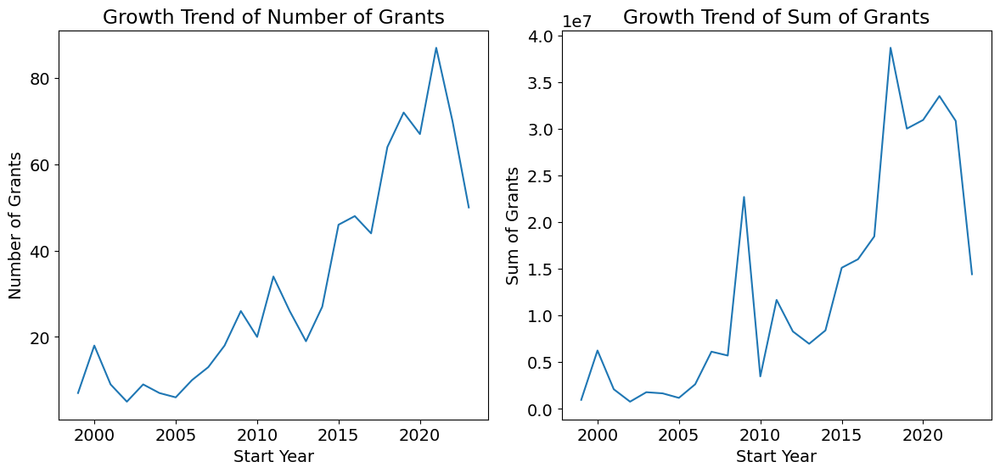

In [ ]:
# Plot the trends
plt.figure(figsize=(12,6))

plt.subplot(1, 2, 1)
plt.plot(result.index, result['Number of Grants'])
plt.title('Growth Trend of Number of Grants')
plt.xlabel('Start Year')
plt.ylabel('Number of Grants')

plt.subplot(1, 2, 2)
plt.plot(result.index, result['Sum of Grants'])
plt.title('Growth Trend of Sum of Grants')
plt.xlabel('Start Year')
plt.ylabel('Sum of Grants')

plt.tight_layout()
plt.show()

In [ ]:
# Then, group by the 'Start date', and calculate the number and sum of grants for each date
result = data_all.groupby('Start Year').agg({'Grant ID': 'count', 'Funding amount': 'sum'})

# Rename the columns
result.columns = ['Number of Grants', 'Sum of Grants']

# Calculate the metrics
n = len(result)

# CAGR
cagr_grants = (result['Number of Grants'].iloc[-1] / result['Number of Grants'].iloc[0])**(1/n) - 1
cagr_funding = (result['Sum of Grants'].iloc[-1] / result['Sum of Grants'].iloc[0])**(1/n) - 1

# YOY Growth
yoy_grants = result['Number of Grants'].pct_change() * 100
yoy_funding = result['Sum of Grants'].pct_change() * 100

# AGR
agr_grants = np.mean(yoy_grants)
agr_funding = np.mean(yoy_funding)

print(f"CAGR for Number of Grants: {cagr_grants*100:.2f}%")
print(f"CAGR for Sum of Grants: {cagr_funding*100:.2f}%")
print(f"AGR for Number of Grants: {agr_grants:.2f}%")
print(f"AGR for Sum of Grants: {agr_funding:.2f}%")
print(f"YOY for Number of Grants: {yoy_grants}%")
print(f"YOY for Sum of Grants: {yoy_funding}%")

CAGR for Number of Grants: 8.18%
CAGR for Sum of Grants: 20.55%
AGR for Number of Grants: 17.64%
AGR for Sum of Grants: 221.24%
YOY for Number of Grants: Start Year
1999           NaN
2000    157.142857
2001    -50.000000
2002    -44.444444
2003     80.000000
2004    -22.222222
2005    -14.285714
2006     66.666667
2007     30.000000
2008     38.461538
2009     44.444444
2010    -23.076923
2011     70.000000
2012    -23.529412
2013    -26.923077
2014     42.105263
2015     70.370370
2016      4.347826
2017     -8.333333
2018     45.454545
2019     12.500000
2020     -6.944444
2021     29.850746
2022    -19.540230
2023    -28.571429
Name: Number of Grants, dtype: float64%
YOY for Sum of Grants: Start Year
1999            NaN
2000    1132.510635
2001      71.555622
2002     -94.082626
2003    2798.699375
2004     -77.228631
2005     -12.583107
2006      74.336322
2007     -25.029856
2008     305.652606
2009     -11.131991
2010     -22.790774
2011     129.141549
2012       9.193610
2013  

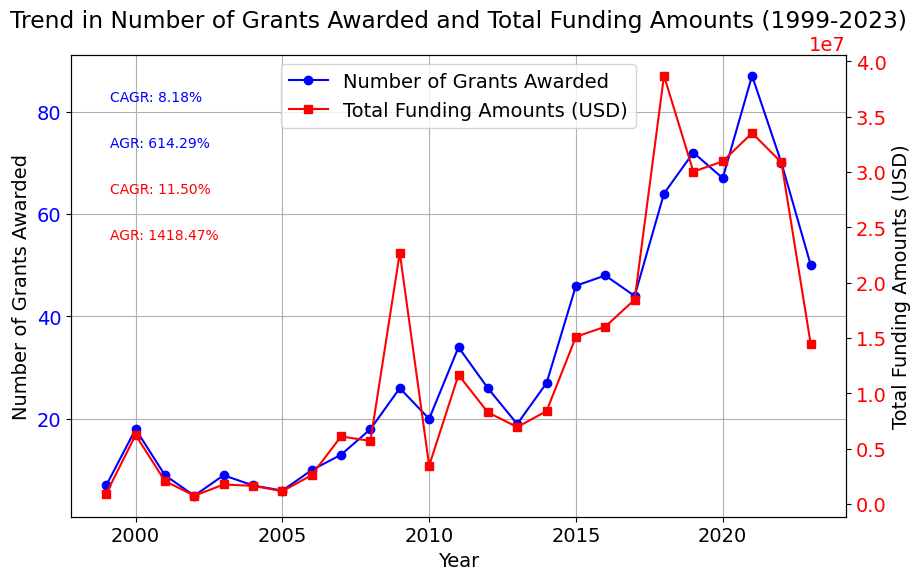

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# # Data for the number of grants awarded each year
# years = result.index
# number_of_grants = result['Number of Grants'].to_list()

# # Data for the total funding amounts each year
# total_funding_amounts = result['Sum of Grants'].to_list()

# Data for the number of grants awarded each year
years = list(range(1999, 2024))
number_of_grants = [7, 18, 9, 5, 9, 7, 6, 10, 13, 18, 26, 20, 34, 26, 19, 27, 46, 48, 44, 64, 72, 67, 87, 70, 50]

# Data for the total funding amounts each year
total_funding_amounts = [949604, 6243211, 2087564, 756756, 1771284, 1648193, 1163751, 2620833, 6116765, 5702423,
                         22700889, 3467946, 11666924, 8285317, 6961718, 8396583, 15112784, 16025320, 18473089,
                         38694993, 30028586, 30958387, 33520570, 30859254, 14419416]


# Calculate compound annual growth rate (CAGR)
def calculate_cagr(data):
    return ((data[-1] / data[0]) ** (1/len(data))) - 1

# Calculate annual growth rate (AGR)
def calculate_agr(data):
    return ((data[-1] - data[0]) / data[0]) * 100

cagr_number_of_grants = calculate_cagr(number_of_grants)
agr_number_of_grants = calculate_agr(number_of_grants)

cagr_total_funding_amounts = calculate_cagr(total_funding_amounts)
agr_total_funding_amounts = calculate_agr(total_funding_amounts)

# Create figure and axes objects
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plotting the number of grants on the first y-axis
ax1.plot(years, number_of_grants, marker='o', color='b', linestyle='-', label='Number of Grants Awarded')
ax1.set_xlabel('Year')
ax1.set_ylabel('Number of Grants Awarded')
ax1.tick_params(axis='y', labelcolor='b')

# Creating a secondary y-axis for total funding amounts
ax2 = ax1.twinx()
ax2.plot(years, total_funding_amounts, marker='s', color='r', linestyle='-', label='Total Funding Amounts (USD)')
ax2.set_ylabel('Total Funding Amounts (USD)')
ax2.tick_params(axis='y', labelcolor='r')

# Adding legends
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax2.legend(lines + lines2, labels + labels2, loc='upper center')

# Annotate CAGR and AGR for the number of grants
ax1.annotate(f'CAGR: {cagr_number_of_grants:.2%}', xy=(0.05, 0.9), xycoords='axes fraction', fontsize=10, color='b')
ax1.annotate(f'AGR: {agr_number_of_grants:.2f}%', xy=(0.05, 0.8), xycoords='axes fraction', fontsize=10, color='b')

# Annotate CAGR and AGR for total funding amounts
ax2.annotate(f'CAGR: {cagr_total_funding_amounts:.2%}', xy=(0.05, 0.7), xycoords='axes fraction', fontsize=10, color='r')
ax2.annotate(f'AGR: {agr_total_funding_amounts:.2f}%', xy=(0.05, 0.6), xycoords='axes fraction', fontsize=10, color='r')

# Title
plt.title('Trend in Number of Grants Awarded and Total Funding Amounts (1999-2023)')

# Gridlines for better readability
ax1.grid(True)

# Show the plot
plt.show()


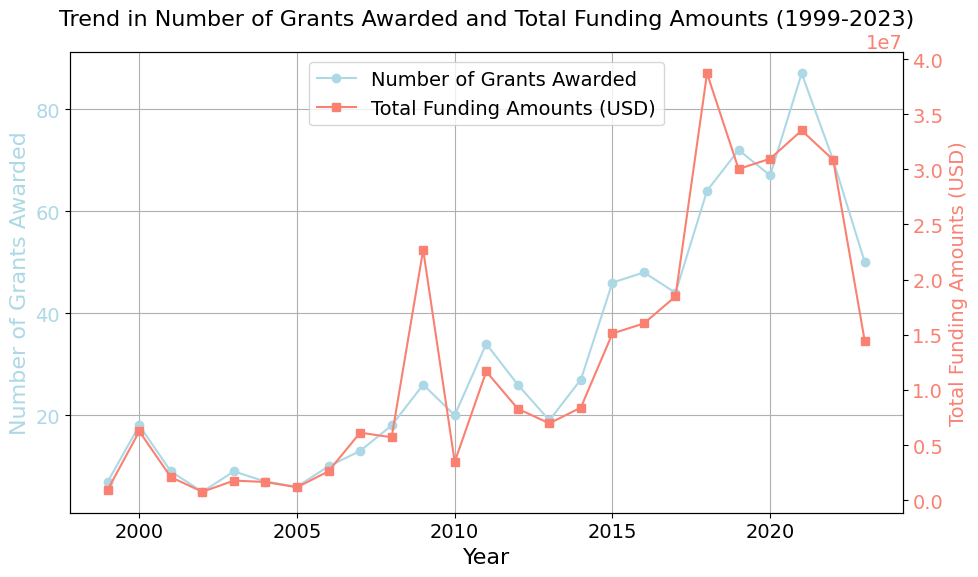

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Prepare data for visualization
years = list(range(1999, 2024))  # Years from 1999 to 2023
# Number of grants awarded each year
number_of_grants = [7, 18, 9, 5, 9, 7, 6, 10, 13, 18, 26, 20, 34, 26, 19, 27, 46, 48, 44, 64, 72, 67, 87, 70, 50]
# Total funding amounts in USD for each year
total_funding_amounts = [949604, 6243211, 2087564, 756756, 1771284, 1648193, 1163751, 2620833, 6116765, 5702423,
                         22700889, 3467946, 11666924, 8285317, 6961718, 8396583, 15112784, 16025320, 18473089,
                         38694993, 30028586, 30958387, 33520570, 30859254, 14419416]

# Functions to calculate growth rates
def calculate_cagr(data):
    """Calculate the Compound Annual Growth Rate (CAGR)"""
    return ((data[-1] / data[0]) ** (1/len(data))) - 1

def calculate_agr(data):
    """Calculate the Annual Growth Rate (AGR)"""
    return ((data[-1] - data[0]) / data[0]) * 100

# Calculate CAGR and AGR for number of grants and total funding amounts
cagr_number_of_grants = calculate_cagr(number_of_grants)
agr_number_of_grants = calculate_agr(number_of_grants)

cagr_total_funding_amounts = calculate_cagr(total_funding_amounts)
agr_total_funding_amounts = calculate_agr(total_funding_amounts)

# Create figure and axes objects for the plot
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plotting the number of grants
ax1.plot(years, number_of_grants, marker='o', color='lightblue', linestyle='-', label='Number of Grants Awarded')
ax1.set_xlabel('Year', fontsize=16)
ax1.set_ylabel('Number of Grants Awarded', fontsize=16, color='lightblue')
ax1.tick_params(axis='y', labelcolor='lightblue', labelsize = 14)
ax1.tick_params(axis='x', labelsize=14)  # Increase font size for x-axis tick labels

# Creating a secondary y-axis for total funding amounts
ax2 = ax1.twinx()
ax2.plot(years, total_funding_amounts, marker='s', color='salmon', linestyle='-', label='Total Funding Amounts (USD)')
ax2.set_ylabel('Total Funding Amounts (USD)', fontsize=14, color='salmon')
ax2.tick_params(axis='y', labelcolor='salmon', labelsize = 14)

# Adding legends and adjusting layout for clarity
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax2.legend(lines + lines2, labels + labels2, loc='upper center')

# # Annotating CAGR and AGR on the plot for clarity
# ax1.annotate(f'CAGR: {cagr_number_of_grants:.2%}', xy=(0.05, 0.95), xycoords='axes fraction', fontsize=10, color='blue')
# ax1.annotate(f'AGR: {agr_number_of_grants:.2f}%', xy=(0.05, 0.90), xycoords='axes fraction', fontsize=10, color='blue')
# ax2.annotate(f'CAGR: {cagr_total_funding_amounts:.2%}', xy=(0.05, 0.85), xycoords='axes fraction', fontsize=10, color='red')
# ax2.annotate(f'AGR: {agr_total_funding_amounts:.2f}%', xy=(0.05, 0.80), xycoords='axes fraction', fontsize=10, color='red')

# Title and gridlines for readability
plt.title('Trend in Number of Grants Awarded and Total Funding Amounts (1999-2023)', fontsize=16)
ax1.grid(True)

# Show the plot with improved formatting for scientific communication
plt.tight_layout()  # Adjust layout to make room for the elements
plt.show()


In [ ]:
# import matplotlib.pyplot as plt
# import numpy as np

# # Data for the number of grants awarded each year
# years = list(range(1999, 2024))
# number_of_grants = [7, 18, 9, 5, 9, 7, 6, 10, 13, 18, 26, 20, 34, 26, 19, 27, 46, 48, 44, 64, 72, 67, 87, 70, 50]

# # Data for the total funding amounts each year
# total_funding_amounts = [949604, 6243211, 2087564, 756756, 1771284, 1648193, 1163751, 2620833, 6116765, 5702423,
#                          22700889, 3467946, 11666924, 8285317, 6961718, 8396583, 15112784, 16025320, 18473089,
#                          38694993, 30028586, 30958387, 33520570, 30859254, 14419416]

# # Calculate compound annual growth rate (CAGR) for the number of grants
# def calculate_cagr(data):
#     return ((data[-1] / data[0]) ** (1/len(data))) - 1

# cagr_number_of_grants = calculate_cagr(number_of_grants)

# # Calculate annual growth rate (AGR) for the number of grants
# agr_number_of_grants = ((number_of_grants[-1] - number_of_grants[0]) / number_of_grants[0]) * 100

# # Create figure and axes objects
# fig, ax1 = plt.subplots(figsize=(10, 6))

# # Plotting the number of grants on the first y-axis
# ax1.plot(years, number_of_grants, marker='o', color='b', linestyle='-', label='Number of Grants Awarded')
# ax1.set_xlabel('Year')
# ax1.set_ylabel('Number of Grants Awarded')
# ax1.tick_params(axis='y', labelcolor='b')

# # Creating a secondary y-axis for total funding amounts
# ax2 = ax1.twinx()
# ax2.plot(years, total_funding_amounts, marker='s', color='r', linestyle='-', label='Total Funding Amounts (USD)')
# ax2.set_ylabel('Total Funding Amounts (USD)')
# ax2.tick_params(axis='y', labelcolor='r')

# # Adding legends
# lines, labels = ax1.get_legend_handles_labels()
# lines2, labels2 = ax2.get_legend_handles_labels()
# ax2.legend(lines + lines2, labels + labels2, loc='upper left')

# # # Annotate CAGR for the number of grants
# # ax1.annotate(f'CAGR: {cagr_number_of_grants:.2%}', xy=(0.05, 0.7), xycoords='axes fraction', fontsize=10, color='b')

# # # Annotate AGR for the number of grants
# # ax1.annotate(f'AGR: {agr_number_of_grants:.2f}%', xy=(0.05, 0.8), xycoords='axes fraction', fontsize=10, color='b')

# # Title
# plt.title('Trend in Number of Grants Awarded and Total Funding Amounts (1999-2023)')

# # Gridlines for better readability
# ax1.grid(True)

# # Show the plot
# plt.show()


### Integration of LDA Topic Modeling

In [ ]:
# Then, group by the 'Start Year', and calculate the number and sum of grants for each Year
result = data_all.groupby('Topic N°').agg({'Grant ID': 'count', 'Funding amount in USD': 'sum'})
result['Mean of Grants'] = result['Funding amount in USD']/result['Grant ID']
# Rename the columns
result.columns = ['Number of Grants', 'Sum of Grants', 'Mean of Grants']

result

,Number of Grants,Sum of Grants,Mean of Grants
Topic N°,,,
Antibiotic Resistance and Therapeutic Strategies,150,70874937,472499.580000
Bacterial Genetics and Mechanisms,230,90319019,392691.386957
Bacteriophage Therapy and Infectious Disease Control,272,112882105,415007.738971
Immunotherapy and Targeted Treatments,132,40521269,306979.310606
Not Class.,18,4034830,224157.222222


In [ ]:
pivot_table = data_all.pivot_table(values='Grant ID', index='Start Year', columns='Topic N°', aggfunc='count')
pivot_table.columns = ['Number of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Number of Grants - Antibiotic Resistance and Therapeutic Strategies,Number of Grants - Bacterial Genetics and Mechanisms,Number of Grants - Bacteriophage Therapy and Infectious Disease Control,Number of Grants - Immunotherapy and Targeted Treatments,Number of Grants - Not Class.
Start Year,,,,,
1999,1.0,1.0,NaN,3.0,2.0
2000,NaN,3.0,6.0,9.0,NaN
2001,NaN,3.0,1.0,4.0,1.0
2002,NaN,2.0,NaN,3.0,NaN
2003,1.0,4.0,1.0,3.0,NaN
2004,2.0,NaN,3.0,2.0,NaN
2005,NaN,2.0,2.0,2.0,NaN
2006,3.0,1.0,4.0,2.0,NaN
2007,NaN,2.0,6.0,4.0,1.0


In [ ]:
pivot_table = data_all.pivot_table(values='Funding amount in USD', index='Start Year', columns='Topic N°', aggfunc='sum')
pivot_table.columns = ['Sum of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Sum of Grants - Antibiotic Resistance and Therapeutic Strategies,Sum of Grants - Bacterial Genetics and Mechanisms,Sum of Grants - Bacteriophage Therapy and Infectious Disease Control,Sum of Grants - Immunotherapy and Targeted Treatments,Sum of Grants - Not Class.
Start Year,,,,,
1999,222292.0,48127.0,NaN,650939.0,28246.0
2000,NaN,606815.0,1288066.0,4348330.0,NaN
2001,NaN,899308.0,16214.0,1146215.0,25827.0
2002,NaN,507367.0,NaN,249389.0,NaN
2003,29483.0,1292042.0,30378.0,419381.0,NaN
2004,159073.0,NaN,984254.0,504866.0,NaN
2005,NaN,88469.0,1027934.0,47348.0,NaN
2006,1358459.0,446734.0,719725.0,95915.0,NaN
2007,NaN,1144903.0,2325620.0,2626696.0,19546.0


In [ ]:
pivot_table = data_all.pivot_table(values='Funding amount in USD', index='Start Year', columns='Topic N°', aggfunc='median')
pivot_table.columns = ['Mean of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Mean of Grants - Antibiotic Resistance and Therapeutic Strategies,Mean of Grants - Bacterial Genetics and Mechanisms,Mean of Grants - Bacteriophage Therapy and Infectious Disease Control,Mean of Grants - Immunotherapy and Targeted Treatments,Mean of Grants - Not Class.
Start Year,,,,,
1999,222292.0,48127.0,NaN,100000.0,14123.0
2000,NaN,10818.0,183681.0,258706.0,NaN
2001,NaN,240000.0,16214.0,251185.5,25827.0
2002,NaN,253683.5,NaN,22945.0,NaN
2003,29483.0,238170.0,30378.0,143860.0,NaN
2004,79536.5,NaN,182525.0,252433.0,NaN
2005,NaN,44234.5,513967.0,23674.0,NaN
2006,29424.0,446734.0,201612.0,47957.5,NaN
2007,NaN,572451.5,200316.5,335562.5,19546.0


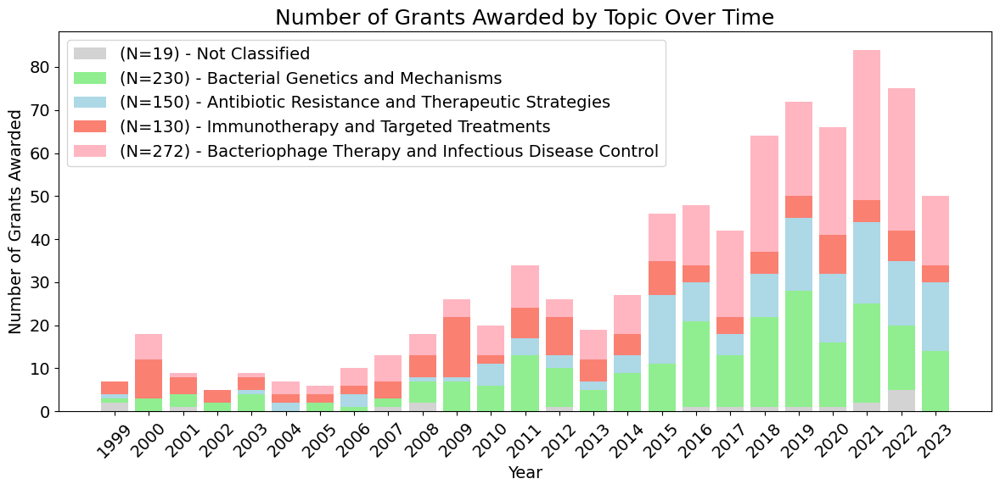

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Sample data (replace with your actual data)
data = {
    'Year': ['1999', '2000', '2001', '2002', '2003', '2004', '2005', '2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023'],
    'Number of Grants - Not Classified': [2, 0, 1, 0, 0, 0, 0, 0, 1, 2, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 2, 5, 0],
    'Number of Grants - Topic 0': [1, 3, 3, 2, 4, 0, 2, 1, 2, 5, 7, 6, 13, 9, 5, 9, 11, 20, 12, 21, 27, 15, 23, 15, 14],
    'Number of Grants - Topic 1': [1, 0, 0, 0, 1, 2, 0, 3, 0, 1, 1, 5, 4, 3, 2, 4, 16, 9, 5, 10, 17, 16, 19, 15, 16],
    'Number of Grants - Topic 2': [3, 9, 4, 3, 3, 2, 2, 2, 4, 5, 14, 2, 7, 9, 5, 5, 8, 4, 4, 5, 5, 9, 5, 7, 4],
    'Number of Grants - Topic 4': [None, 6, 1, None, 1, 3, 2, 4, 6, 5, 4, 7, 10, 4, 7, 9, 11, 14, 20, 27, 22, 25, 35, 33, 16]
}

# Convert data to DataFrame
df = pd.DataFrame(data)

# Set Year column as index
df.set_index('Year', inplace=True)

# Define a list of native matplotlib colors for plotting
colors = ['lightgray', 'lightgreen', 'lightblue', 'salmon', 'lightpink']

# Plotting
plt.figure(figsize=(12, 6))

# Number of Grants
plt.bar(df.index, df['Number of Grants - Not Classified'], label='(N='+str(int(df['Number of Grants - Not Classified'].sum()))+')' + ' - '+'Not Classified', color=colors[0]) #width=0.2,
plt.bar(df.index, df['Number of Grants - Topic 0'], label='(N='+str(int(df['Number of Grants - Topic 0'].sum()))+')' + ' - '+'Bacterial Genetics and Mechanisms', bottom=df['Number of Grants - Not Classified'], color=colors[1])
plt.bar(df.index, df['Number of Grants - Topic 1'], label='(N='+str(int(df['Number of Grants - Topic 1'].sum()))+')' + ' - '+'Antibiotic Resistance and Therapeutic Strategies', bottom=df['Number of Grants - Not Classified'] + df['Number of Grants - Topic 0'], color=colors[2])
plt.bar(df.index, df['Number of Grants - Topic 2'], label='(N='+str(int(df['Number of Grants - Topic 2'].sum()))+')' + ' - '+'Immunotherapy and Targeted Treatments', bottom=df['Number of Grants - Not Classified'] + df['Number of Grants - Topic 0'] + df['Number of Grants - Topic 1'], color=colors[3])
plt.bar(df.index, df['Number of Grants - Topic 4'], label='(N='+str(int(df['Number of Grants - Topic 4'].sum()))+')' + ' - '+'Bacteriophage Therapy and Infectious Disease Control', bottom=df['Number of Grants - Not Classified'] + df['Number of Grants - Topic 0'] + df['Number of Grants - Topic 1'] + df['Number of Grants - Topic 2'], color=colors[4])

# Adding labels and title
plt.xlabel('Year', fontsize=14)
plt.ylabel('Number of Grants Awarded', fontsize=14)
plt.title('Number of Grants Awarded by Topic Over Time', fontsize=18)
plt.legend()

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Show plot
plt.tight_layout()
plt.show()


In [ ]:
# df['Number of Grants - Topic 0'].sum()

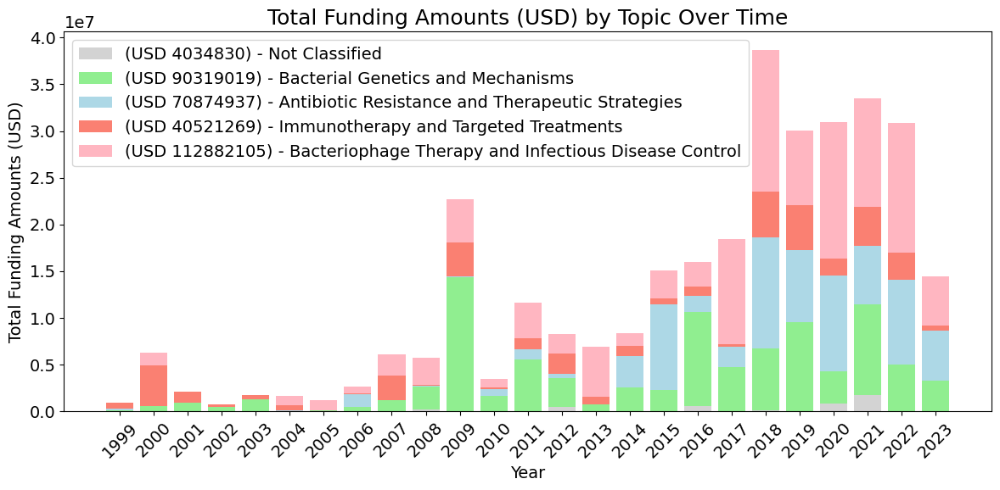

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import colorsys

# Sample data (replace with your actual data)
data = {
    'Year': ['1999', '2000', '2001', '2002', '2003', '2004', '2005', '2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023'],
    'Not Classified': [28246, 0, 25827, 0, 0, 0, 0, 0, 19546, 207065, 0, 0, 0, 494821, 0, 0, 0, 599838, 26956, 81746, 26376, 814714, 1709695, 0, 0],
    'Topic 0': [48127, 606815, 899308, 507367, 1292042, 0, 88469, 446734, 1144903, 2452764, 14389338, 1690424, 5597094, 3060379, 754150, 2606472, 2268031, 10007639, 4702984, 6623843, 9543348, 3464074, 9752294, 5059710, 3312710],
    'Topic 1': [222292, 0, 0, 0, 29483, 159073, 0, 1358459, 0, 49504, 100000, 667415, 1038703, 480476, 7900, 3331144, 9148915, 1776550, 2192440, 11899905, 7652322, 10215307, 6219888, 9017465, 5307696],
    'Topic 2': [650939, 4348330, 1146215, 249389, 419381, 504866, 47348, 95915, 2626696, 158016, 3600483, 240478, 1204820, 2203036, 804461, 1049113, 672557, 994504, 295647, 4895038, 4805190, 1854045, 4242379, 2883292, 529131],
    'Topic 4': [None, 1288066, 16214, None, 30378, 984254, 1027934, 719725, 2325620, 2835074, 4611068, 869629, 3826307, 2046605, 5395207, 1409854, 3023281, 2646789, 11255062, 15194461, 8001350, 14610247, 11596314, 13898787, 5269879]
}

# Convert data to DataFrame
df = pd.DataFrame(data)

# Set Year column as index
df.set_index('Year', inplace=True)
# Define a list of native matplotlib colors for plotting
colors = ['lightgray', 'lightgreen', 'lightblue', 'salmon', 'lightpink']
# colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f']

# Plotting
plt.figure(figsize=(12, 6))

# Stacked bar chart for Number of Grants
plt.bar(df.index, df['Not Classified'], label='(USD '+str(int(df['Not Classified'].sum()))+')' + ' - '+'Not Classified', color=colors[0])
plt.bar(df.index, df['Topic 0'], bottom=df['Not Classified'], label='(USD '+str(int(df['Topic 0'].sum()))+')' + ' - '+'Bacterial Genetics and Mechanisms', color=colors[1])
plt.bar(df.index, df['Topic 1'], bottom=df['Not Classified'] + df['Topic 0'], label='(USD '+str(int(df['Topic 1'].sum()))+')' + ' - '+'Antibiotic Resistance and Therapeutic Strategies', color=colors[2])
plt.bar(df.index, df['Topic 2'], bottom=df['Not Classified'] + df['Topic 0'] + df['Topic 1'], label='(USD '+str(int(df['Topic 2'].sum()))+')' + ' - '+'Immunotherapy and Targeted Treatments', color=colors[3])
plt.bar(df.index, df['Topic 4'], bottom=df['Not Classified'] + df['Topic 0'] + df['Topic 1'] + df['Topic 2'], label='(USD '+str(int(df['Topic 4'].sum()))+')' + ' - '+'Bacteriophage Therapy and Infectious Disease Control', color=colors[4])

# Adding labels and title
plt.xlabel('Year', fontsize=14)
plt.ylabel('Total Funding Amounts (USD)', fontsize=14)
plt.title('Total Funding Amounts (USD) by Topic Over Time', fontsize=18)
plt.legend()

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Show plot
plt.tight_layout()
plt.show()


### Gender Considerations in Funding Trends

In [ ]:
gender_data.count()

Researchers    1092
gender_bon     1091
dtype: int64

In [ ]:
gender_data['gender_bon'].value_counts()

gender_bon
Male      715
Female    376
Name: count, dtype: int64

In [ ]:
# Then, group by the 'Start Year', and calculate the number and sum of grants for each Year
result = data_all.groupby('Gender').agg({'Grant ID': 'count', 'Funding amount in USD': 'sum'})
result['Mean of Grants'] = result['Funding amount in USD']/result['Grant ID']
# Rename the columns
result.columns = ['Number of Grants', 'Sum of Grants', 'Mean of Grants']

result

,Number of Grants,Sum of Grants,Mean of Grants
Gender,,,
Female,201,57355268,285349.592040
Female;Male,96,42455901,442248.968750
Male,446,179041946,401439.340807


In [ ]:
# import matplotlib.pyplot as plt

# # Data
# grants = ['Number of Grants', 'Sum of Grants', 'Mean of Grants']
# female_values = [201, 57355268, 285349.592040]
# female_male_values = [96, 42455901, 442248.968750]
# male_values = [446, 179041946, 401439.340807]

# # Define colors
# colors = ['lightpink', 'salmon', 'lightblue']

# # Create subplots
# fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# # Pie chart for Number of Grants
# axs[0].pie([female_values[0], female_male_values[0], male_values[0]], labels=['Female', 'Female+Male', 'Male'], autopct='%1.1f%%', startangle=90, colors=colors)
# axs[0].set_title('Number of Grants')

# # Pie chart for Sum of Grants
# axs[1].pie([female_values[1], female_male_values[1], male_values[1]], labels=['Female', 'Female+Male', 'Male'], autopct='%1.1f%%', startangle=90, colors=colors)
# axs[1].set_title('Total Grant Amounts USD')

# # Bar chart for Mean of Grants
# axs[2].bar(['Female', 'Female+Male', 'Male'], [female_values[2], female_male_values[2], male_values[2]], color=colors)
# axs[2].set_title('Mean Grants Amounts')

# # Adjust layout
# plt.tight_layout()

# # Show plots
# plt.show()


In [ ]:
# import matplotlib.pyplot as plt
# import numpy as np

# # Data
# categories = ['Female', 'Female+Male', 'Male']
# grants = ['Number of Grants', 'Sum of Grants (USD)', 'Mean Grant Amount (USD)']
# female_values = np.array([201, 5.7355268e7, 285349.59])
# female_male_values = np.array([96, 4.2455901e7, 442248.97])
# male_values = np.array([446, 1.79041946e8, 401439.34])
# data = np.array([female_values, female_male_values, male_values])

# # Define colors
# colors = ['#ff9999', '#66b3ff', '#99ff99']

# # Create subplots
# fig, axs = plt.subplots(1, 3, figsize=(18, 6))

# # Custom function for autopct to use absolute values
# def absolute_value(val, total):
#     absolute = int(np.round(val/100.*total))
#     return f"{absolute}\n({val:.1f}%)"

# # Pie chart for Number of Grants
# total_grants = data[:,0].sum()
# axs[0].pie(data[:,0], labels=categories, autopct=lambda val: absolute_value(val, total_grants), startangle=90, colors=colors)
# axs[0].set_title('Distribution of Number of Grants')

# # Pie chart for Sum of Grants
# total_sum_grants = data[:,1].sum()
# axs[1].pie(data[:,1], labels=categories, autopct=lambda val: absolute_value(val, total_sum_grants), startangle=90, colors=colors)
# axs[1].set_title('Total Grant Amounts (USD, in Scientific Notation)')

# # Bar chart for Mean of Grants
# axs[2].bar(categories, data[:,2], color=colors)
# axs[2].set_title('Average Grant Amount per Category (USD)')
# axs[2].ticklabel_format(style='plain', axis='y')  # Avoid scientific notation here for clarity

# # Improve layout for better readability
# plt.tight_layout(pad=2.0)

# # Enhance for accessibility
# plt.setp(axs, xticks=[], yticks=[])
# for ax in axs:
#     ax.legend(categories, title="Categories", loc="upper left")

# # Show plots
# plt.show()


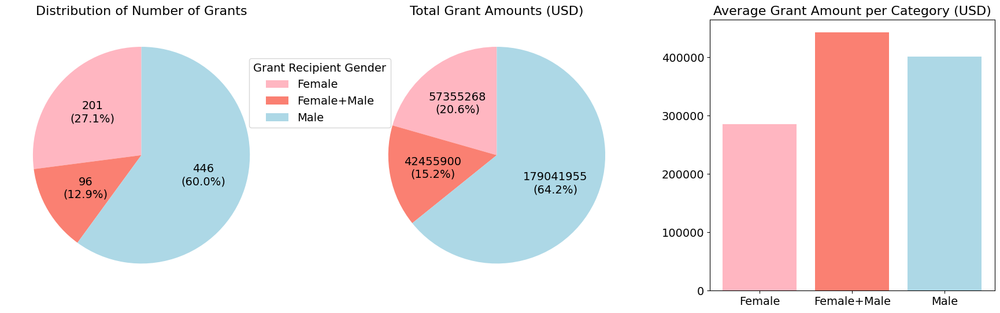

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Set global font size
plt.rc('font', size=14)  # Adjusts all text sizes

# Data
categories = ['Female', 'Female+Male', 'Male']
grants = ['Number of Grants', 'Sum of Grants (USD)', 'Mean Grant Amount (USD)']
female_values = np.array([201, 5.7355268e7, 285349.59])
female_male_values = np.array([96, 4.2455901e7, 442248.97])
male_values = np.array([446, 1.79041946e8, 401439.34])
data = np.array([female_values, female_male_values, male_values])

# Define colors
colors = ['lightpink', 'salmon', 'lightblue']

# Create subplots
fig, axs = plt.subplots(1, 3, figsize=(18, 6))

# Custom function for autopct to use absolute values
def absolute_value(val, total):
    absolute = int(np.round(val/100.*total))
    return f"{absolute}\n({val:.1f}%)"

# Pie chart for Number of Grants
total_grants = data[:,0].sum()
axs[0].pie(data[:,0],  autopct=lambda val: absolute_value(val, total_grants), startangle=90, colors=colors) #labels=categories,
axs[0].set_title('Distribution of Number of Grants', fontsize=16)

# Pie chart for Sum of Grants
total_sum_grants = data[:,1].sum()
axs[1].pie(data[:,1], autopct=lambda val: absolute_value(val, total_sum_grants), startangle=90, colors=colors)  #labels=categories,
axs[1].set_title('Total Grant Amounts (USD)', fontsize=16)

# Bar chart for Mean of Grants
axs[2].bar(categories, data[:,2],  color=colors)
axs[2].set_title('Average Grant Amount per Category (USD)', fontsize=16)
axs[2].ticklabel_format(style='plain', axis='y')  # Avoid scientific notation here for clarity

# Adding a unified legend for the figure, not the axs
fig.legend(categories, title="Grant Recipient Gender", title_fontsize=14, fontsize=14, loc="upper center", bbox_to_anchor=(0.33, 0.8))

# Improve layout for better readability
plt.tight_layout(pad=2.0)

# # Enhance for accessibility
# plt.setp(axs, xticks=[], yticks=[])
# for ax in axs:
#     ax.legend(categories, title="Categories", title_fontsize=12, fontsize=12, loc="upper left")

# Show plots
plt.show()


In [ ]:
# Split the 'Gender' column into separate rows
data_all_split = data_all.assign(Gender=data_all['Gender'].str.split(';')).explode('Gender')

# Then, group by the 'Gender', and calculate the number and sum of grants for each Gender
result_split = data_all_split.groupby('Gender').agg({'Grant ID': 'count', 'Funding amount in USD': 'sum'})
result_split['Mean of Grants'] = result_split['Funding amount in USD']/result_split['Grant ID']

# Rename the columns
result_split.columns = ['Number of Grants', 'Sum of Grants', 'Mean of Grants']

result_split


,Number of Grants,Sum of Grants,Mean of Grants
Gender,,,
Female,297,99811169,336064.542088
Male,542,221497847,408667.614391


In [ ]:
pivot_table = data_all.pivot_table(values='Grant ID', index='Start Year', columns='Gender', aggfunc='count')
pivot_table.columns = ['Number of Grants - {}'.format(col) for col in pivot_table.columns]
# pivot_table['gender_ratio'] = pivot_table['Number of Grants - Female']/pivot_table['Number of Grants - Male']
pivot_table


,Number of Grants - Female,Number of Grants - Female;Male,Number of Grants - Male
Start Year,,,
1999,2.0,NaN,4.0
2000,4.0,NaN,12.0
2001,2.0,2.0,5.0
2002,1.0,NaN,4.0
2003,NaN,NaN,9.0
2004,NaN,1.0,3.0
2005,1.0,NaN,4.0
2006,1.0,2.0,6.0
2007,3.0,1.0,9.0


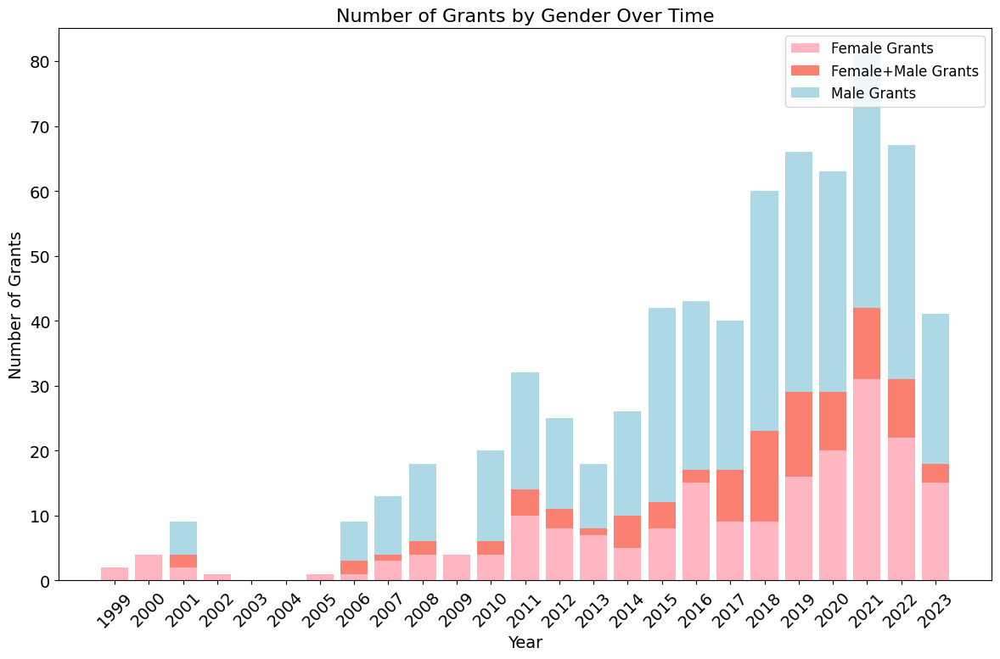

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Data
years = ['1999', '2000', '2001', '2002', '2003', '2004', '2005', '2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023']
female_grants = [2.0, 4.0, 2.0, 1.0, np.nan, np.nan, 1.0, 1.0, 3.0, 4.0, 4.0, 4.0, 10.0, 8.0, 7.0, 5.0, 8.0, 15.0, 9.0, 9.0, 16.0, 20.0, 31.0, 22.0, 15.0]
female_male_grants = [np.nan, np.nan, 2.0, np.nan, np.nan, 1.0, np.nan, 2.0, 1.0, 2.0, np.nan, 2.0, 4.0, 3.0, 1.0, 5.0, 4.0, 2.0, 8.0, 14.0, 13.0, 9.0, 11.0, 9.0, 3.0]
male_grants = [4.0, 12.0, 5.0, 4.0, 9.0, 3.0, 4.0, 6.0, 9.0, 12.0, 21.0, 14.0, 18.0, 14.0, 10.0, 16.0, 30.0, 26.0, 23.0, 37.0, 37.0, 34.0, 39.0, 36.0, 23.0]

# Plotting
x = np.arange(len(years))
fig, ax = plt.subplots(figsize=(12, 8))

# Bar widths
width = 0.35

# Plot bars
bars1 = ax.bar(years, female_grants, label='Female Grants', color='lightpink') #width,
bars2 = ax.bar(years, female_male_grants, bottom=female_grants, label='Female+Male Grants', color='salmon')
bars3 = ax.bar(years, male_grants, bottom=np.array(female_grants) + np.array(female_male_grants), label='Male Grants', color='lightblue')

# Adding labels and title
ax.set_ylabel('Number of Grants', fontsize=14)
ax.set_xlabel('Year', fontsize=14)
ax.set_title('Number of Grants by Gender Over Time', fontsize=16)
ax.legend(fontsize=12)

# Show plot
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


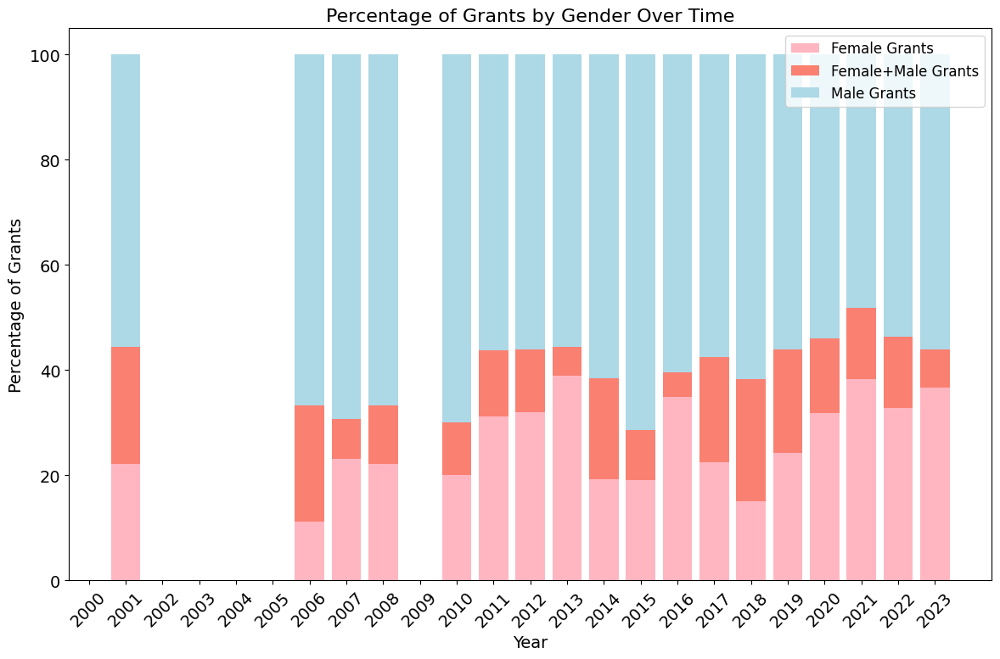

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Data
years = ['1999', '2000', '2001', '2002', '2003', '2004', '2005', '2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023']
female_grants = [2.0, 4.0, 2.0, 1.0, np.nan, np.nan, 1.0, 1.0, 3.0, 4.0, 4.0, 4.0, 10.0, 8.0, 7.0, 5.0, 8.0, 15.0, 9.0, 9.0, 16.0, 20.0, 31.0, 22.0, 15.0]
female_male_grants = [np.nan, np.nan, 2.0, np.nan, np.nan, 1.0, np.nan, 2.0, 1.0, 2.0, np.nan, 2.0, 4.0, 3.0, 1.0, 5.0, 4.0, 2.0, 8.0, 14.0, 13.0, 9.0, 11.0, 9.0, 3.0]
male_grants = [4.0, 12.0, 5.0, 4.0, 9.0, 3.0, 4.0, 6.0, 9.0, 12.0, 21.0, 14.0, 18.0, 14.0, 10.0, 16.0, 30.0, 26.0, 23.0, 37.0, 37.0, 34.0, 39.0, 36.0, 23.0]

# Convert to numpy arrays
female_grants = np.array(female_grants)
female_male_grants = np.array(female_male_grants)
male_grants = np.array(male_grants)

# Calculate total grants for each year
total_grants = female_grants + female_male_grants + male_grants

# Calculate percentages
female_percent = (female_grants / total_grants) * 100
female_male_percent = (female_male_grants / total_grants) * 100
male_percent = (male_grants / total_grants) * 100

# Plotting
x = np.arange(len(years))
fig, ax = plt.subplots(figsize=(12, 8))

# Bar widths
width = 0.35

# Plot bars
bars1 = ax.bar(years, female_percent, label='Female Grants', color='lightpink')
bars2 = ax.bar(years, female_male_percent, bottom=female_percent, label='Female+Male Grants', color='salmon')
bars3 = ax.bar(years, male_percent, bottom=female_percent + female_male_percent, label='Male Grants', color='lightblue')

# Adding labels and title
ax.set_ylabel('Percentage of Grants', fontsize=14)
ax.set_xlabel('Year', fontsize=14)
ax.set_title('Percentage of Grants by Gender Over Time', fontsize=16)
ax.legend(fontsize=12)

# Show plot
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [ ]:
# import matplotlib.pyplot as plt
# import numpy as np

# # Data
# years = ['1999', '2000', '2001', '2002', '2003', '2004', '2005', '2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023']
# female_grants = [2.0, 4.0, 2.0, 1.0, np.nan, np.nan, 1.0, 1.0, 3.0, 4.0, 4.0, 4.0, 10.0, 8.0, 7.0, 5.0, 8.0, 15.0, 9.0, 9.0, 16.0, 20.0, 31.0, 22.0, 15.0]
# female_male_grants = [np.nan, np.nan, 2.0, np.nan, np.nan, 1.0, np.nan, 2.0, 1.0, 2.0, np.nan, 2.0, 4.0, 3.0, 1.0, 5.0, 4.0, 2.0, 8.0, 14.0, 13.0, 9.0, 11.0, 9.0, 3.0]
# male_grants = [4.0, 12.0, 5.0, 4.0, 9.0, 3.0, 4.0, 6.0, 9.0, 12.0, 21.0, 14.0, 18.0, 14.0, 10.0, 16.0, 30.0, 26.0, 23.0, 37.0, 37.0, 34.0, 39.0, 36.0, 23.0]
# # gender_ratios = [0.5, 0.333333, 0.4, 0.25, np.nan, np.nan, 0.25, 0.166667, 0.333333, 0.333333, 0.190476, 0.285714, 0.555556, 0.571429, 0.7, 0.3125, 0.266667, 0.576923, 0.391304, 0.243243, 0.432432, 0.588235, 0.794872, 0.611111, 0.652174]

# # Plotting
# x = np.arange(len(years))
# fig, ax1 = plt.subplots(figsize=(12, 8))

# # Bar widths
# width = 0.35

# # Plot bars
# bars1 = ax1.bar(x, female_grants, width, label='Female Grants', color='lightpink')
# bars2 = ax1.bar(x, female_male_grants, width, bottom=female_grants, label='Female+Male Grants', color='salmon')
# bars3 = ax1.bar(x, male_grants, width, bottom=np.array(female_grants) + np.array(female_male_grants), label='Male Grants', color='lightblue')

# # # Twin the x-axis for gender ratio
# # ax2 = ax1.twinx()
# # ax2.plot(x, gender_ratios, color='orange', marker='o', linestyle='-', linewidth=2, label='Gender Ratio')

# # Set labels and title
# ax1.set_xlabel('Year', fontsize=14)
# ax1.set_ylabel('Number of Grants', fontsize=14)
# # ax2.set_ylabel('Gender Ratio', fontsize=14)
# ax1.set_title('Number of Grants and Gender Ratio Over Time', fontsize=16)

# # Set x-axis ticks and labels
# ax1.set_xticks(x)
# ax1.set_xticklabels(years, rotation=45)

# # Add legends
# # bars = bars1 + bars2 + bars3
# # labels = [bar.get_label() for bar in bars]
# # ax1.legend(bars, labels, loc='upper left')
# # ax2.legend(loc='upper right')

# # Show plot
# plt.tight_layout()
# plt.show()


In [ ]:
# import matplotlib.pyplot as plt

# # Data
# years = list(range(1999, 2024))
# female_grants = [2.0, 4.0, 2.0, 1.0, None, None, 1.0, 1.0, 3.0, 4.0, 4.0, 4.0, 10.0, 8.0, 7.0, 5.0, 8.0, 15.0, 9.0, 9.0, 16.0, 20.0, 31.0, 22.0, 15.0]
# female_male_grants = [None, None, 2.0, None, None, 1.0, None, 2.0, 1.0, 2.0, None, 2.0, 4.0, 3.0, 1.0, 5.0, 4.0, 2.0, 14.0, 13.0, 9.0, 11.0, 9.0, 9.0, 3.0]
# male_grants = [4.0, 12.0, 5.0, 4.0, 9.0, 3.0, 4.0, 6.0, 9.0, 12.0, 21.0, 14.0, 18.0, 14.0, 10.0, 16.0, 30.0, 26.0, 23.0, 37.0, 37.0, 34.0, 39.0, 36.0, 23.0]
# gender_ratio = [0.5, 0.333333, 0.4, 0.25, None, None, 0.25, 0.166667, 0.333333, 0.333333, 0.190476, 0.285714, 0.555556, 0.571429, 0.7, 0.3125, 0.266667, 0.576923, 0.391304, 0.243243, 0.432432, 0.588235, 0.794872, 0.611111, 0.652174]

# # Plotting
# plt.figure(figsize=(12, 6))

# plt.plot(years, female_grants, marker='o', label='Female Grants', linestyle='-')
# plt.plot(years, female_male_grants, marker='o', label='Female+Male Grants', linestyle='--')
# plt.plot(years, male_grants, marker='o', label='Male Grants', linestyle='-.')

# # Adding labels and title
# plt.xlabel('Year')
# plt.ylabel('Number of Grants')
# plt.title('Number of Grants by Gender Over Time')
# plt.xticks(years, rotation=45)
# plt.grid(True)
# plt.legend()

# # Show plot
# plt.tight_layout()
# plt.show()


In [ ]:
pivot_table = data_all.pivot_table(values='Funding amount in USD', index='Start Year', columns='Gender', aggfunc='sum')
pivot_table.columns = ['Sum of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Sum of Grants - Female,Sum of Grants - Female;Male,Sum of Grants - Male
Start Year,,,
1999,111418.0,NaN,790059.0
2000,2791751.0,NaN,2566994.0
2001,502371.0,1151731.0,433462.0
2002,22945.0,NaN,733811.0
2003,NaN,NaN,1771284.0
2004,NaN,30241.0,536936.0
2005,25253.0,NaN,238869.0
2006,18511.0,684140.0,1752364.0
2007,2147746.0,111153.0,3857866.0


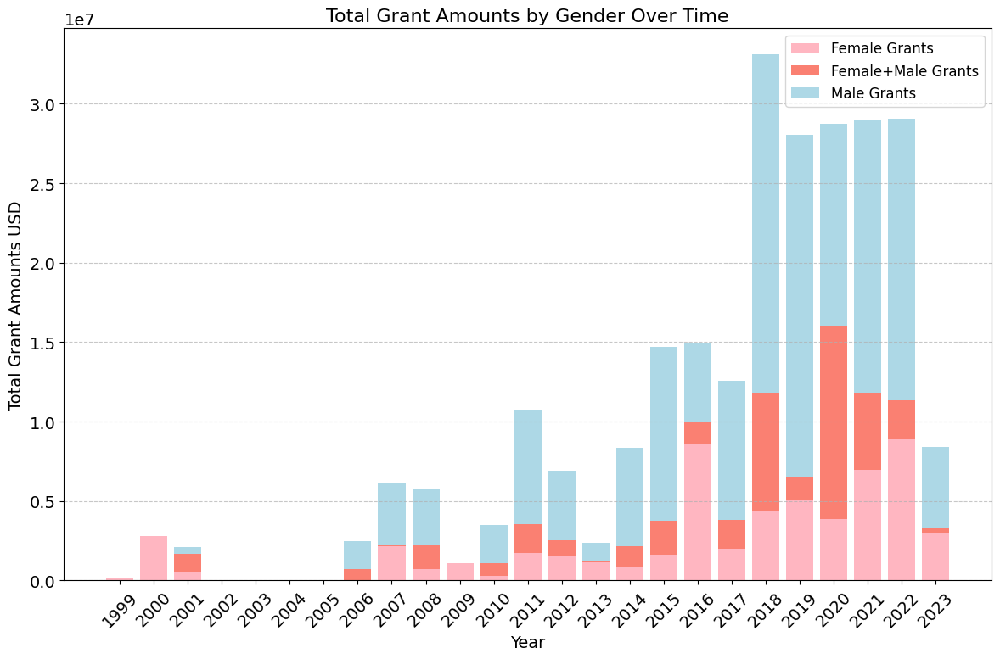

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Data
years = ['1999', '2000', '2001', '2002', '2003', '2004', '2005', '2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023']
sum_grants_female = [111418.0, 2791751.0, 502371.0, 22945.0, np.nan, np.nan, 25253.0, 18511.0, 2147746.0, 702208.0, 1069321.0, 304815.0, 1749968.0, 1540842.0, 1159153.0, 835044.0, 1616023.0, 8546596.0, 2014383.0, 4406281.0, 5074138.0, 3869617.0, 6931423.0, 8895399.0, 3020062.0]
sum_grants_female_male = [np.nan, np.nan, 1151731.0, np.nan, np.nan, 30241.0, np.nan, 684140.0, 111153.0, 1499606.0, np.nan, 780413.0, 1803558.0, 1003018.0, 66345.0, 1301841.0, 2135978.0, 1445019.0, 1805602.0, 7428628.0, 1394170.0, 12177285.0, 4897705.0, 2466289.0, 273179.0]
sum_grants_male = [790059.0, 2566994.0, 433462.0, 733811.0, 1771284.0, 536936.0, 238869.0, 1752364.0, 3857866.0, 3500609.0, 21445923.0, 2382718.0, 7130000.0, 4384327.0, 1124083.0, 6201217.0, 10962021.0, 4970736.0, 8739273.0, 21268094.0, 21606368.0, 12711959.0, 17119022.0, 17702177.0, 5111774.0]

# Plotting
x = np.arange(len(years))
fig, ax = plt.subplots(figsize=(12, 8))

# Use different colors for each bar
bar1 = ax.bar(years, sum_grants_female, label='Female Grants', color='lightpink')
bar2 = ax.bar(years, sum_grants_female_male, bottom=sum_grants_female, label='Female+Male Grants', color='salmon')
bar3 = ax.bar(years, sum_grants_male, bottom=np.array(sum_grants_female) + np.array(sum_grants_female_male), label='Male Grants', color='lightblue')

# Adding labels and title
ax.set_ylabel('Total Grant Amounts USD', fontsize=14)
ax.set_xlabel('Year', fontsize=14)
ax.set_title('Total Grant Amounts by Gender Over Time', fontsize=16)
ax.legend(fontsize=12)

# Show gridlines for better comparison
ax.grid(axis='y', linestyle='--', alpha=0.7)

# Show plot
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [ ]:
# import matplotlib.pyplot as plt
# import numpy as np

# # Data
# years = ['1999', '2000', '2001', '2002', '2003', '2004', '2005', '2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023']
# sum_grants_female = [111418.0, 2791751.0, 502371.0, 22945.0, np.nan, np.nan, 25253.0, 18511.0, 2147746.0, 702208.0, 1069321.0, 304815.0, 1749968.0, 1540842.0, 1159153.0, 835044.0, 1616023.0, 8546596.0, 2014383.0, 4406281.0, 5074138.0, 3869617.0, 6931423.0, 8895399.0, 3020062.0]
# sum_grants_female_male = [np.nan, np.nan, 1151731.0, np.nan, np.nan, 30241.0, np.nan, 684140.0, 111153.0, 1499606.0, np.nan, 780413.0, 1803558.0, 1003018.0, 66345.0, 1301841.0, 2135978.0, 1445019.0, 1805602.0, 7428628.0, 1394170.0, 12177285.0, 4897705.0, 2466289.0, 273179.0]
# sum_grants_male = [790059.0, 2566994.0, 433462.0, 733811.0, 1771284.0, 536936.0, 238869.0, 1752364.0, 3857866.0, 3500609.0, 21445923.0, 2382718.0, 7130000.0, 4384327.0, 1124083.0, 6201217.0, 10962021.0, 4970736.0, 8739273.0, 21268094.0, 21606368.0, 12711959.0, 17119022.0, 17702177.0, 5111774.0]

# # Calculate percentages
# total_grants = np.array(sum_grants_female) + np.array(sum_grants_female_male) + np.array(sum_grants_male)
# percentage_female = [female / total * 100 if total != 0 else 0 for female, total in zip(sum_grants_female, total_grants)]
# percentage_female_male = [female_male / total * 100 if total != 0 else 0 for female_male, total in zip(sum_grants_female_male, total_grants)]
# percentage_male = [male / total * 100 if total != 0 else 0 for male, total in zip(sum_grants_male, total_grants)]

# # Plotting
# x = np.arange(len(years))
# fig, ax = plt.subplots(figsize=(12, 8))

# ax.bar(years, percentage_female, label='Female Grants')
# ax.bar(years, percentage_female_male, bottom=percentage_female, label='Female+Male Grants')
# ax.bar(years, percentage_male, bottom=np.array(percentage_female)+np.array(percentage_female_male), label='Male Grants')

# # Adding labels and title
# ax.set_ylabel('Percentage of Total Grant Amounts')
# ax.set_xlabel('Year')
# ax.set_title('Percentage of Total Grant Amounts by Gender Over Time')
# ax.legend()

# # Show plot
# plt.xticks(rotation=45)
# plt.tight_layout()
# plt.show()


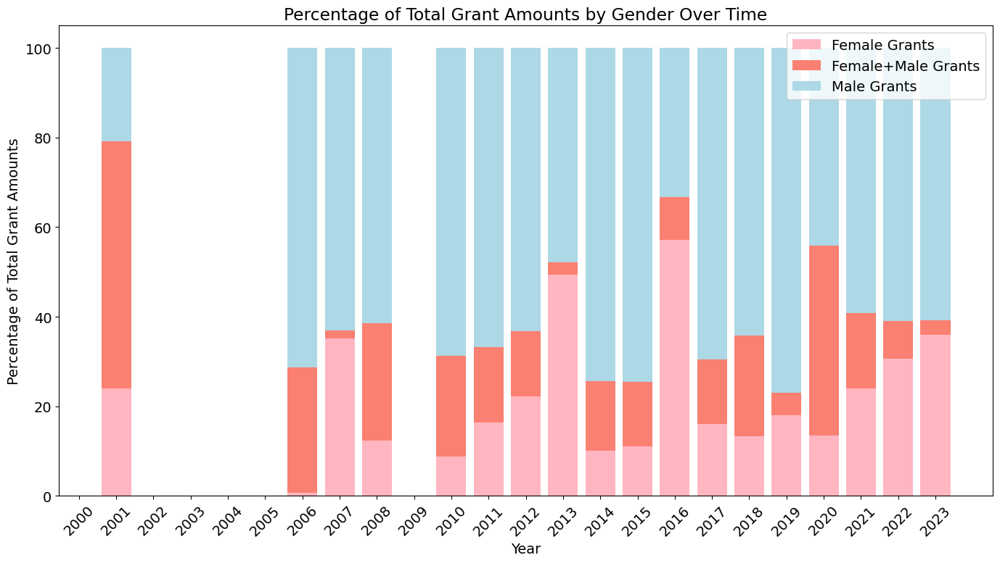

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Data
years = ['1999', '2000', '2001', '2002', '2003', '2004', '2005', '2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023']
sum_grants_female = [111418.0, 2791751.0, 502371.0, 22945.0, np.nan, np.nan, 25253.0, 18511.0, 2147746.0, 702208.0, 1069321.0, 304815.0, 1749968.0, 1540842.0, 1159153.0, 835044.0, 1616023.0, 8546596.0, 2014383.0, 4406281.0, 5074138.0, 3869617.0, 6931423.0, 8895399.0, 3020062.0]
sum_grants_female_male = [np.nan, np.nan, 1151731.0, np.nan, np.nan, 30241.0, np.nan, 684140.0, 111153.0, 1499606.0, np.nan, 780413.0, 1803558.0, 1003018.0, 66345.0, 1301841.0, 2135978.0, 1445019.0, 1805602.0, 7428628.0, 1394170.0, 12177285.0, 4897705.0, 2466289.0, 273179.0]
sum_grants_male = [790059.0, 2566994.0, 433462.0, 733811.0, 1771284.0, 536936.0, 238869.0, 1752364.0, 3857866.0, 3500609.0, 21445923.0, 2382718.0, 7130000.0, 4384327.0, 1124083.0, 6201217.0, 10962021.0, 4970736.0, 8739273.0, 21268094.0, 21606368.0, 12711959.0, 17119022.0, 17702177.0, 5111774.0]

# Calculate percentages
total_grants = np.array(sum_grants_female) + np.array(sum_grants_female_male) + np.array(sum_grants_male)
percentage_female = [female / total * 100 if total != 0 else 0 for female, total in zip(sum_grants_female, total_grants)]
percentage_female_male = [female_male / total * 100 if total != 0 else 0 for female_male, total in zip(sum_grants_female_male, total_grants)]
percentage_male = [male / total * 100 if total != 0 else 0 for male, total in zip(sum_grants_male, total_grants)]

# Plotting
x = np.arange(len(years))
fig, ax = plt.subplots(figsize=(14, 8))

bar1 = ax.bar(years, percentage_female, color='lightpink', label='Female Grants')
bar2 = ax.bar(years, percentage_female_male, bottom=percentage_female, color='salmon', label='Female+Male Grants')
bar3 = ax.bar(years, percentage_male, bottom=np.array(percentage_female)+np.array(percentage_female_male), color='lightblue', label='Male Grants')

# Adding labels and title
ax.set_ylabel('Percentage of Total Grant Amounts')
ax.set_xlabel('Year')
ax.set_title('Percentage of Total Grant Amounts by Gender Over Time')
ax.legend()

# # Add data labels
# for bar in [bar1, bar2, bar3]:
#     for rect in bar:
#         height = rect.get_height()
#         ax.annotate(f'{height:.1f}%',
#                     xy=(rect.get_x() + rect.get_width() / 2, height),
#                     xytext=(0, 3),
#                     textcoords="offset points",
#                     ha='center', va='bottom', fontsize=8)

# Show plot
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [ ]:
pivot_table = data_all.pivot_table(values='Funding amount in USD', index='Start Year', columns='Gender', aggfunc='median')
pivot_table.columns = ['Mean of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Mean of Grants - Female,Mean of Grants - Female;Male,Mean of Grants - Male
Start Year,,,
1999,55709.0,NaN,148646.0
2000,640657.0,NaN,98964.5
2001,251185.5,575865.5,25827.0
2002,22945.0,NaN,113222.0
2003,NaN,NaN,143860.0
2004,NaN,30241.0,130240.0
2005,25253.0,NaN,44234.5
2006,18511.0,342070.0,48575.5
2007,198945.0,111153.0,269232.0


In [ ]:
# import matplotlib.pyplot as plt

# # Data
# start_year = list(range(1999, 2024))
# mean_grants_female = [55709.0, 640657.0, 251185.5, 22945.0, None, None, 25253.0, 18511.0, 198945.0, 34299.5, 231152.0, 65949.5, 116277.5, 161411.5, 139111.0, 105741.0, 69588.5, 205014.0, 50000.0, 250178.0, 39021.5, 65344.5, 174460.0, 362625.0, 180000.0]
# mean_grants_female_male = [None, None, 575865.5, None, None, 30241.0, None, 342070.0, 111153.0, 749803.0, None, 390206.5, 437048.0, 202620.0, 66345.0, 200685.0, 406676.5, 722509.5, 148367.0, 268478.5, 84524.0, 540249.0, 400825.0, 75406.0, 54021.0]
# mean_grants_male = [148646.0, 98964.5, 25827.0, 113222.0, 143860.0, 130240.0, 44234.5, 48575.5, 269232.0, 47069.0, 111442.0, 103861.0, 203928.5, 284262.0, 81028.5, 175431.0, 133475.5, 118208.5, 217538.0, 169267.0, 269192.0, 191013.0, 310095.0, 315316.0, 47694.0]

# # Plotting
# plt.figure(figsize=(10, 6))
# plt.plot(start_year, mean_grants_female, marker='o', label='Female Grants')
# plt.plot(start_year, mean_grants_female_male, marker='o', label='Female+Male Grants')
# plt.plot(start_year, mean_grants_male, marker='o', label='Male Grants')

# # Adding labels and title
# plt.xlabel('Year')
# plt.ylabel('Mean Grant Amount')
# plt.title('Mean Grant Amounts Over Time')
# plt.legend()

# # Show plot
# plt.grid(True)
# plt.xticks(start_year, rotation=45)
# plt.tight_layout()
# plt.show()


In [ ]:
# import matplotlib.pyplot as plt
# import numpy as np

# # Data
# years = ['1999', '2000', '2001', '2002', '2003', '2004', '2005', '2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023']
# mean_grants_female = [55709.0, 640657.0, 251185.5, 22945.0, np.nan, np.nan, 25253.0, 18511.0, 198945.0, 34299.5, 231152.0, 65949.5, 116277.5, 161411.5, 139111.0, 105741.0, 69588.5, 205014.0, 50000.0, 250178.0, 39021.5, 65344.5, 174460.0, 362625.0, 180000.0]
# mean_grants_female_male = [np.nan, np.nan, 575865.5, np.nan, np.nan, 30241.0, np.nan, 342070.0, 111153.0, 749803.0, np.nan, 390206.5, 437048.0, 202620.0, 66345.0, 200685.0, 406676.5, 722509.5, 148367.0, 268478.5, 84524.0, 540249.0, 400825.0, 75406.0, 54021.0]
# mean_grants_male = [148646.0, 98964.5, 25827.0, 113222.0, 143860.0, 130240.0, 44234.5, 48575.5, 269232.0, 47069.0, 111442.0, 103861.0, 203928.5, 284262.0, 81028.5, 175431.0, 133475.5, 118208.5, 217538.0, 169267.0, 269192.0, 191013.0, 310095.0, 315316.0, 47694.0]

# # Plotting
# x = np.arange(len(years))
# width = 0.25

# fig, ax = plt.subplots(figsize=(12, 8))
# bar1 = ax.bar(x - width, mean_grants_female, width, label='Female Grants')
# bar2 = ax.bar(x, mean_grants_female_male, width, label='Female+Male Grants')
# bar3 = ax.bar(x + width, mean_grants_male, width, label='Male Grants')

# # Adding labels and title
# ax.set_ylabel('Mean Grant Amounts')
# ax.set_xlabel('Year')
# ax.set_title('Mean Grant Amounts by Gender Over Time')
# ax.set_xticks(x)
# ax.set_xticklabels(years)
# ax.legend()

# # Show plot
# plt.xticks(rotation=45)
# plt.tight_layout()
# plt.show()


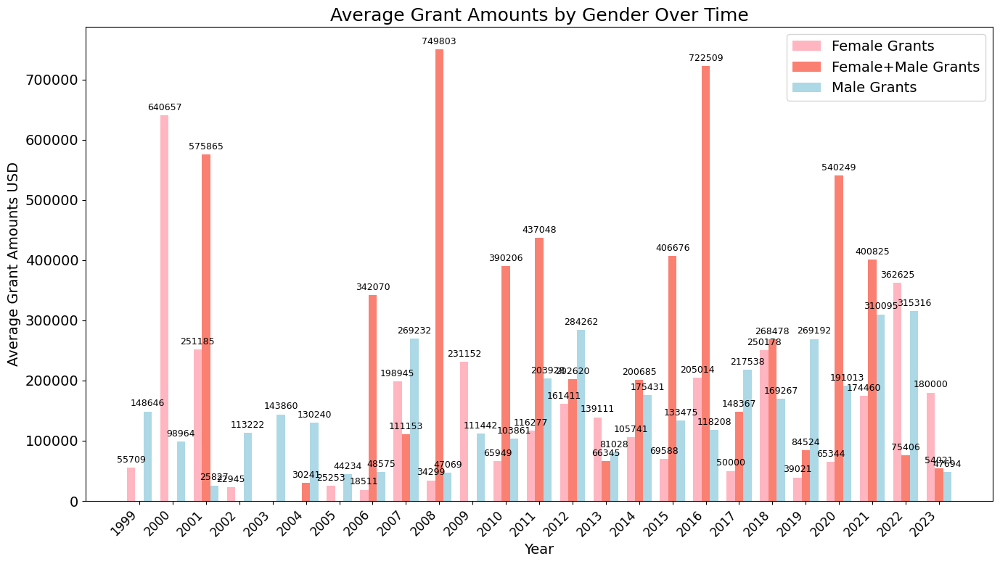

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Data
years = ['1999', '2000', '2001', '2002', '2003', '2004', '2005', '2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023']
mean_grants_female = [55709.0, 640657.0, 251185.5, 22945.0, np.nan, np.nan, 25253.0, 18511.0, 198945.0, 34299.5, 231152.0, 65949.5, 116277.5, 161411.5, 139111.0, 105741.0, 69588.5, 205014.0, 50000.0, 250178.0, 39021.5, 65344.5, 174460.0, 362625.0, 180000.0]
mean_grants_female_male = [np.nan, np.nan, 575865.5, np.nan, np.nan, 30241.0, np.nan, 342070.0, 111153.0, 749803.0, np.nan, 390206.5, 437048.0, 202620.0, 66345.0, 200685.0, 406676.5, 722509.5, 148367.0, 268478.5, 84524.0, 540249.0, 400825.0, 75406.0, 54021.0]
mean_grants_male = [148646.0, 98964.5, 25827.0, 113222.0, 143860.0, 130240.0, 44234.5, 48575.5, 269232.0, 47069.0, 111442.0, 103861.0, 203928.5, 284262.0, 81028.5, 175431.0, 133475.5, 118208.5, 217538.0, 169267.0, 269192.0, 191013.0, 310095.0, 315316.0, 47694.0]

# Plotting
x = np.arange(len(years))
width = 0.25

fig, ax = plt.subplots(figsize=(14, 8))
bar1 = ax.bar(x - width, mean_grants_female, width, label='Female Grants', color='lightpink')
bar2 = ax.bar(x, mean_grants_female_male, width, label='Female+Male Grants', color='salmon')
bar3 = ax.bar(x + width, mean_grants_male, width, label='Male Grants', color='lightblue')

# Adding labels and title
ax.set_ylabel('Average Grant Amounts USD', fontsize=14)
ax.set_xlabel('Year', fontsize=14)
ax.set_title('Average Grant Amounts by Gender Over Time', fontsize=18)
ax.set_xticks(x)
ax.set_xticklabels(years, rotation=45, ha='right', fontsize=12)
ax.legend(fontsize=14)

# Add data labels
def autolabel(bars):
    for bar in bars:
        height = bar.get_height()
        if not np.isnan(height):  # Check for NaN values
            ax.annotate('{}'.format(int(height)),
                        xy=(bar.get_x() + bar.get_width() / 2, height),
                        xytext=(0, 3),
                        textcoords="offset points",
                        ha='center', va='bottom', fontsize=9)

autolabel(bar1)
autolabel(bar2)
autolabel(bar3)

# Show plot
plt.tight_layout()
plt.show()


In [ ]:
pivot_table = data_all_split.pivot_table(values='Grant ID', index='Start Year', columns='Gender', aggfunc='count')
pivot_table.columns = ['Number of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table['gender_ratio'] = pivot_table['Number of Grants - Female']/pivot_table['Number of Grants - Male']
pivot_table

,Number of Grants - Female,Number of Grants - Male,gender_ratio
Start Year,,,
1999,2.0,4.0,0.500000
2000,4.0,12.0,0.333333
2001,4.0,7.0,0.571429
2002,1.0,4.0,0.250000
2003,NaN,9.0,NaN
2004,1.0,4.0,0.250000
2005,1.0,4.0,0.250000
2006,3.0,8.0,0.375000
2007,4.0,10.0,0.400000


In [ ]:
# import matplotlib.pyplot as plt

# # Data
# years = ['1999', '2000', '2001', '2002', '2003', '2004', '2005', '2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023']
# female_grants = [2.0, 4.0, 4.0, 1.0, None, 1.0, 1.0, 3.0, 4.0, 6.0, 4.0, 6.0, 14.0, 11.0, 8.0, 10.0, 12.0, 17.0, 17.0, 23.0, 29.0, 29.0, 42.0, 31.0, 18.0]
# male_grants = [4.0, 12.0, 7.0, 4.0, 9.0, 4.0, 4.0, 8.0, 10.0, 14.0, 21.0, 16.0, 22.0, 17.0, 11.0, 21.0, 34.0, 28.0, 31.0, 51.0, 50.0, 43.0, 50.0, 45.0, 26.0]
# gender_ratio = [0.5, 0.333, 0.571, 0.25, None, 0.25, 0.25, 0.375, 0.4, 0.429, 0.19, 0.375, 0.636, 0.647, 0.727, 0.476, 0.353, 0.607, 0.548, 0.451, 0.58, 0.674, 0.84, 0.689, 0.692]

# # Plotting
# plt.figure(figsize=(10, 6))
# plt.plot(years, gender_ratio, marker='o', color='b', label='Gender Ratio')

# # Adding labels and title
# plt.title('Gender Ratio of Grants Awarded Over Time')
# plt.xlabel('Year')
# plt.ylabel('Gender Ratio (Female Grants / Total Grants)')
# plt.ylim(0, 1)  # Limit y-axis to range [0, 1]
# plt.grid(True)
# plt.legend()

# # Show plot
# plt.xticks(rotation=45)
# plt.tight_layout()
# plt.show()


In [ ]:
pivot_table = data_all_split.pivot_table(values='Funding amount in USD', index='Start Year', columns='Gender', aggfunc='sum')
pivot_table.columns = ['Sum of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table['gender_ratio'] = pivot_table['Sum of Grants - Female']/pivot_table['Sum of Grants - Male']
pivot_table


,Sum of Grants - Female,Sum of Grants - Male,gender_ratio
Start Year,,,
1999,111418.0,790059.0,0.141025
2000,2791751.0,2566994.0,1.087556
2001,1654102.0,1585193.0,1.043470
2002,22945.0,733811.0,0.031268
2003,NaN,1771284.0,NaN
2004,30241.0,567177.0,0.053318
2005,25253.0,238869.0,0.105719
2006,702651.0,2436504.0,0.288385
2007,2258899.0,3969019.0,0.569133


In [ ]:
pivot_table = data_all_split.pivot_table(values='Funding amount in USD', index='Start Year', columns='Gender', aggfunc='median')
pivot_table.columns = ['Mean of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Mean of Grants - Female,Mean of Grants - Male
Start Year,,
1999,55709.0,148646.0
2000,640657.0,98964.5
2001,457935.5,133307.0
2002,22945.0,113222.0
2003,NaN,143860.0
2004,30241.0,81155.0
2005,25253.0,44234.5
2006,237406.0,152566.5
2007,155049.0,200316.5


## Who Supports Bacteriophage Therapy Research?


### Funder generalities

In [ ]:
# number of funder







### Funder Type

In [ ]:
# Then, group by the 'Start Year', and calculate the number and sum of grants for each Year
result = data_all.groupby('Funder Type').agg({'Grant ID': 'count', 'Funding amount in USD': 'sum'})
result['Mean of Grants'] = result['Funding amount in USD']/result['Grant ID']
# Rename the columns
result.columns = ['Number of Grants', 'Sum of Grants', 'Mean of Grants']

result

,Number of Grants,Sum of Grants,Mean of Grants
Funder Type,,,
Facility,157,110566739,7.042467e+05
Government,460,178755621,3.885992e+05
Nonprofit,176,19256061,1.094094e+05
Other,9,10053739,1.117082e+06


In [ ]:
pivot_table = data_all.pivot_table(values='Grant ID', index='Start Year', columns='Funder Type', aggfunc='count')
pivot_table.columns = ['Number of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Number of Grants - Facility,Number of Grants - Government,Number of Grants - Nonprofit,Number of Grants - Other
Start Year,,,,
1999,2.0,5.0,NaN,NaN
2000,6.0,10.0,2.0,NaN
2001,2.0,5.0,2.0,NaN
2002,1.0,4.0,NaN,NaN
2003,NaN,3.0,6.0,NaN
2004,1.0,4.0,2.0,NaN
2005,NaN,3.0,3.0,NaN
2006,1.0,4.0,4.0,1.0
2007,4.0,6.0,3.0,NaN


In [ ]:
pivot_table = data_all.pivot_table(values='Funding amount in USD', index='Start Year', columns='Funder Type', aggfunc='sum')
pivot_table.columns = ['Sum of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Sum of Grants - Facility,Sum of Grants - Government,Sum of Grants - Nonprofit,Sum of Grants - Other
Start Year,,,,
1999,322292.0,627312.0,NaN,NaN
2000,3409776.0,2781805.0,51630.0,NaN
2001,766001.0,1172042.0,149521.0,NaN
2002,501000.0,255756.0,NaN,NaN
2003,NaN,1275963.0,495321.0,NaN
2004,374626.0,1211256.0,62311.0,NaN
2005,NaN,983301.0,180450.0,NaN
2006,1300847.0,770378.0,383790.0,165818.0
2007,2123865.0,3734098.0,258802.0,NaN


In [ ]:
pivot_table = data_all.pivot_table(values='Funding amount in USD', index='Start Year', columns='Funder Type', aggfunc='median')
pivot_table.columns = ['Mean of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Mean of Grants - Facility,Mean of Grants - Government,Mean of Grants - Nonprofit,Mean of Grants - Other
Start Year,,,,
1999,161146.0,48127.0,NaN,NaN
2000,428348.5,178353.0,25815.0,NaN
2001,383000.5,112501.0,74760.5,NaN
2002,501000.0,22945.0,NaN,NaN
2003,NaN,288102.0,29930.5,NaN
2004,374626.0,156382.5,31155.5,NaN
2005,NaN,58419.0,30050.0,NaN
2006,1300847.0,152566.5,28806.0,165818.0
2007,410441.5,165173.0,111153.0,NaN


### Funder Country

In [ ]:
# Then, group by the 'Start Year', and calculate the number and sum of grants for each Year
result = data_all.groupby('Funder Country').agg({'Grant ID': 'count', 'Funding amount in USD': 'sum'})
result['Mean of Grants'] = result['Funding amount in USD']/result['Grant ID']
# Rename the columns
result.columns = ['Number of Grants', 'Sum of Grants', 'Mean of Grants']

result

,Number of Grants,Sum of Grants,Mean of Grants
Funder Country,,,
Australia,18,11013048,6.118360e+05
Belgium,23,18824283,8.184471e+05
Canada,71,11131750,1.567852e+05
China,82,5010522,6.110393e+04
Czechia,17,18580803,1.092988e+06
Denmark,6,2782266,4.637110e+05
Finland,10,3156672,3.156672e+05
France,11,6286519,5.715017e+05
Germany,11,10652885,9.684441e+05


In [ ]:
pivot_table = data_all.pivot_table(values='Grant ID', index='Start Year', columns='Funder Country', aggfunc='count')
pivot_table.columns = ['Number of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Number of Grants - Australia,Number of Grants - Belgium,Number of Grants - Canada,Number of Grants - China,Number of Grants - Czechia,Number of Grants - Denmark,Number of Grants - Finland,Number of Grants - France,Number of Grants - Germany,Number of Grants - India,Number of Grants - Ireland,Number of Grants - Israel,Number of Grants - Japan,Number of Grants - Latvia,Number of Grants - Netherlands,Number of Grants - New Zealand,Number of Grants - Norway,Number of Grants - Poland,Number of Grants - Portugal,Number of Grants - Slovakia,Number of Grants - Spain,Number of Grants - Sweden,Number of Grants - Switzerland,Number of Grants - United Kingdom,Number of Grants - United States
Start Year,,,,,,,,,,,,,,,,,,,,,,,,,
1999,NaN,1.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0
2000,NaN,NaN,3.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,10.0
2001,NaN,NaN,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,4.0
2002,1.0,NaN,1.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
2003,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,2.0
2004,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,2.0
2005,NaN,1.0,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
2006,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,3.0,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,1.0,1.0,2.0
2007,1.0,NaN,2.0,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,6.0


In [ ]:
pivot_table = data_all.pivot_table(values='Funding amount in USD', index='Start Year', columns='Funder Country', aggfunc='sum')
pivot_table.columns = ['Sum of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Sum of Grants - Australia,Sum of Grants - Belgium,Sum of Grants - Canada,Sum of Grants - China,Sum of Grants - Czechia,Sum of Grants - Denmark,Sum of Grants - Finland,Sum of Grants - France,Sum of Grants - Germany,Sum of Grants - India,Sum of Grants - Ireland,Sum of Grants - Israel,Sum of Grants - Japan,Sum of Grants - Latvia,Sum of Grants - Netherlands,Sum of Grants - New Zealand,Sum of Grants - Norway,Sum of Grants - Poland,Sum of Grants - Portugal,Sum of Grants - Slovakia,Sum of Grants - Spain,Sum of Grants - Sweden,Sum of Grants - Switzerland,Sum of Grants - United Kingdom,Sum of Grants - United States
Start Year,,,,,,,,,,,,,,,,,,,,,,,,,
1999,NaN,48127.0,28246.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,873231.0
2000,NaN,NaN,23160.0,13284.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,51630.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,884466.0,5270671.0
2001,NaN,NaN,25827.0,18114.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,149521.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,625730.0,NaN,1268372.0
2002,203499.0,NaN,6367.0,45890.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,501000.0
2003,NaN,NaN,NaN,NaN,288102.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,235321.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,188238.0,1059623.0
2004,NaN,311357.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,62311.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,769659.0,504866.0
2005,NaN,899629.0,58419.0,25253.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,52145.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,128305.0
2006,NaN,NaN,18511.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,297990.0,NaN,85800.0,NaN,NaN,NaN,NaN,NaN,165818.0,NaN,NaN,NaN,237406.0,446734.0,1368574.0
2007,131401.0,NaN,146227.0,NaN,NaN,NaN,198945.0,NaN,NaN,NaN,NaN,NaN,26316.0,NaN,NaN,NaN,NaN,NaN,232486.0,NaN,NaN,NaN,NaN,NaN,5381390.0


In [ ]:
pivot_table = data_all.pivot_table(values='Funding amount in USD', index='Start Year', columns='Funder Country', aggfunc='median')
pivot_table.columns = ['Mean of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Mean of Grants - Australia,Mean of Grants - Belgium,Mean of Grants - Canada,Mean of Grants - China,Mean of Grants - Czechia,Mean of Grants - Denmark,Mean of Grants - Finland,Mean of Grants - France,Mean of Grants - Germany,Mean of Grants - India,Mean of Grants - Ireland,Mean of Grants - Israel,Mean of Grants - Japan,Mean of Grants - Latvia,Mean of Grants - Netherlands,Mean of Grants - New Zealand,Mean of Grants - Norway,Mean of Grants - Poland,Mean of Grants - Portugal,Mean of Grants - Slovakia,Mean of Grants - Spain,Mean of Grants - Sweden,Mean of Grants - Switzerland,Mean of Grants - United Kingdom,Mean of Grants - United States
Start Year,,,,,,,,,,,,,,,,,,,,,,,,,
1999,NaN,48127.0,14123.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,161146.0
2000,NaN,NaN,6733.0,13284.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,25815.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,442233.0,295154.0
2001,NaN,NaN,25827.0,18114.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,74760.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,625730.0,NaN,314935.0
2002,203499.0,NaN,6367.0,22945.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,501000.0
2003,NaN,NaN,NaN,NaN,288102.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,29483.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,188238.0,529811.5
2004,NaN,155678.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,31155.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,769659.0,252433.0
2005,NaN,899629.0,58419.0,25253.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,26072.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,128305.0
2006,NaN,NaN,18511.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,297990.0,NaN,28188.0,NaN,NaN,NaN,NaN,NaN,165818.0,NaN,NaN,NaN,237406.0,446734.0,684287.0
2007,131401.0,NaN,73113.5,NaN,NaN,NaN,198945.0,NaN,NaN,NaN,NaN,NaN,26316.0,NaN,NaN,NaN,NaN,NaN,116243.0,NaN,NaN,NaN,NaN,NaN,752965.0


### Funder Region

In [ ]:
# Then, group by the 'Start Year', and calculate the number and sum of grants for each Year
result = data_all.groupby('Funder Region').agg({'Grant ID': 'count', 'Funding amount in USD': 'sum'})
result['Mean of Grants'] = result['Funding amount in USD']/result['Grant ID']
# Rename the columns
result.columns = ['Number of Grants', 'Sum of Grants', 'Mean of Grants']

result

,Number of Grants,Sum of Grants,Mean of Grants
Funder Region,,,
Asia,204,20468248,100334.549020
Europe,253,124177112,490818.624506
North America,327,162973752,498390.678899
Oceania,18,11013048,611836.000000


In [ ]:
pivot_table = data_all.pivot_table(values='Grant ID', index='Start Year', columns='Funder Region', aggfunc='count')
pivot_table.columns = ['Number of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Number of Grants - Asia,Number of Grants - Europe,Number of Grants - North America,Number of Grants - Oceania
Start Year,,,,
1999,NaN,1.0,6.0,NaN
2000,3.0,2.0,13.0,NaN
2001,3.0,1.0,5.0,NaN
2002,2.0,NaN,2.0,1.0
2003,5.0,2.0,2.0,NaN
2004,2.0,3.0,2.0,NaN
2005,3.0,1.0,2.0,NaN
2006,3.0,4.0,3.0,NaN
2007,1.0,3.0,8.0,1.0


In [ ]:
pivot_table = data_all.pivot_table(values='Funding amount in USD', index='Start Year', columns='Funder Region', aggfunc='sum')
pivot_table.columns = ['Sum of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Sum of Grants - Asia,Sum of Grants - Europe,Sum of Grants - North America,Sum of Grants - Oceania
Start Year,,,,
1999,NaN,48127.0,901477.0,NaN
2000,64914.0,884466.0,5293831.0,NaN
2001,167635.0,625730.0,1294199.0,NaN
2002,45890.0,NaN,507367.0,203499.0
2003,235321.0,476340.0,1059623.0,NaN
2004,62311.0,1081016.0,504866.0,NaN
2005,77398.0,899629.0,186724.0,NaN
2006,85800.0,1147948.0,1387085.0,NaN
2007,26316.0,431431.0,5527617.0,131401.0


In [ ]:
pivot_table = data_all.pivot_table(values='Funding amount in USD', index='Start Year', columns='Funder Region', aggfunc='median')
pivot_table.columns = ['Mean of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Mean of Grants - Asia,Mean of Grants - Europe,Mean of Grants - North America,Mean of Grants - Oceania
Start Year,,,,
1999,NaN,48127.0,87500.0,NaN
2000,21001.0,442233.0,258706.0,NaN
2001,18114.0,625730.0,240000.0,NaN
2002,22945.0,NaN,253683.5,203499.0
2003,29483.0,238170.0,529811.5,NaN
2004,31155.5,182525.0,252433.0,NaN
2005,25253.0,899629.0,93362.0,NaN
2006,28188.0,267698.0,67727.0,NaN
2007,26316.0,121333.0,410441.5,131401.0


### Funder Income group

In [ ]:
# Then, group by the 'Start Year', and calculate the number and sum of grants for each Year
result = data_all.groupby('Funder Income group').agg({'Grant ID': 'count', 'Funding amount in USD': 'sum'})
result['Mean of Grants'] = result['Funding amount in USD']/result['Grant ID']
# Rename the columns
result.columns = ['Number of Grants', 'Sum of Grants', 'Mean of Grants']

result

,Number of Grants,Sum of Grants,Mean of Grants
Funder Income group,,,
High income,711,313060259,440309.787623
Lower middle income,9,561379,62375.444444
Upper middle income,82,5010522,61103.926829


In [ ]:
pivot_table = data_all.pivot_table(values='Grant ID', index='Start Year', columns='Funder Income group', aggfunc='count')
pivot_table.columns = ['Number of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Number of Grants - High income,Number of Grants - Lower middle income,Number of Grants - Upper middle income
Start Year,,,
1999,7.0,NaN,NaN
2000,17.0,NaN,1.0
2001,8.0,NaN,1.0
2002,3.0,NaN,2.0
2003,9.0,NaN,NaN
2004,7.0,NaN,NaN
2005,5.0,NaN,1.0
2006,10.0,NaN,NaN
2007,13.0,NaN,NaN


In [ ]:
pivot_table = data_all.pivot_table(values='Funding amount in USD', index='Start Year', columns='Funder Income group', aggfunc='sum')
pivot_table.columns = ['Sum of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Sum of Grants - High income,Sum of Grants - Lower middle income,Sum of Grants - Upper middle income
Start Year,,,
1999,949604.0,NaN,NaN
2000,6229927.0,NaN,13284.0
2001,2069450.0,NaN,18114.0
2002,710866.0,NaN,45890.0
2003,1771284.0,NaN,NaN
2004,1648193.0,NaN,NaN
2005,1138498.0,NaN,25253.0
2006,2620833.0,NaN,NaN
2007,6116765.0,NaN,NaN


In [ ]:
pivot_table = data_all.pivot_table(values='Funding amount in USD', index='Start Year', columns='Funder Income group', aggfunc='median')
pivot_table.columns = ['Mean of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Mean of Grants - High income,Mean of Grants - Lower middle income,Mean of Grants - Upper middle income
Start Year,,,
1999,75000.0,NaN,NaN
2000,258706.0,NaN,13284.0
2001,186653.5,NaN,18114.0
2002,203499.0,NaN,22945.0
2003,143860.0,NaN,NaN
2004,130240.0,NaN,NaN
2005,58419.0,NaN,25253.0
2006,116772.5,NaN,NaN
2007,198945.0,NaN,NaN


### funder Global north - south

In [ ]:
# Then, group by the 'Start Year', and calculate the number and sum of grants for each Year
result = data_all.groupby('funder Global north - south').agg({'Grant ID': 'count', 'Funding amount in USD': 'sum'})
result['Mean of Grants'] = result['Funding amount in USD']/result['Grant ID']
# Rename the columns
result.columns = ['Number of Grants', 'Sum of Grants', 'Mean of Grants']

result

,Number of Grants,Sum of Grants,Mean of Grants
funder Global north - south,,,
Global North,711,313060259,440309.787623
Global South,91,5571901,61229.681319


In [ ]:
pivot_table = data_all.pivot_table(values='Grant ID', index='Start Year', columns='funder Global north - south', aggfunc='count')
pivot_table.columns = ['Number of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Number of Grants - Global North,Number of Grants - Global South
Start Year,,
1999,7.0,NaN
2000,17.0,1.0
2001,8.0,1.0
2002,3.0,2.0
2003,9.0,NaN
2004,7.0,NaN
2005,5.0,1.0
2006,10.0,NaN
2007,13.0,NaN


In [ ]:
pivot_table = data_all.pivot_table(values='Funding amount in USD', index='Start Year', columns='funder Global north - south', aggfunc='sum')
pivot_table.columns = ['Sum of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Sum of Grants - Global North,Sum of Grants - Global South
Start Year,,
1999,949604.0,NaN
2000,6229927.0,13284.0
2001,2069450.0,18114.0
2002,710866.0,45890.0
2003,1771284.0,NaN
2004,1648193.0,NaN
2005,1138498.0,25253.0
2006,2620833.0,NaN
2007,6116765.0,NaN


In [ ]:
pivot_table = data_all.pivot_table(values='Funding amount in USD', index='Start Year', columns='funder Global north - south', aggfunc='median')
pivot_table.columns = ['Mean of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Mean of Grants - Global North,Mean of Grants - Global South
Start Year,,
1999,75000.0,NaN
2000,258706.0,13284.0
2001,186653.5,18114.0
2002,203499.0,22945.0
2003,143860.0,NaN
2004,130240.0,NaN
2005,58419.0,25253.0
2006,116772.5,NaN
2007,198945.0,NaN


## Who Receives Support for Bacteriophage Therapy Research?

### Receiver - Type of standardized research organization

In [ ]:
data_all_copy = data_all.copy()

In [ ]:
data_all_copy = data_all.copy()
# Then, group by the 'Start Year', and calculate the number and sum of grants for each Year
result = data_all_copy.groupby('Receiver - Type of standardized research organization').agg({'Grant ID': 'count', 'Funding amount in USD': 'sum'})
result['Mean of Grants'] = result['Funding amount in USD']/result['Grant ID']
# Rename the columns
result.columns = ['Number of Grants', 'Sum of Grants', 'Mean of Grants']

result

,Number of Grants,Sum of Grants,Mean of Grants
Receiver - Type of standardized research organization,,,
Archive;Education,2,905560,4.527800e+05
Company,86,56182641,6.532865e+05
Company;Education,27,9923308,3.675299e+05
Company;Education;Facility,2,2572669,1.286334e+06
Company;Education;Nonprofit,1,1720227,1.720227e+06
Company;Facility,1,165818,1.658180e+05
Company;Government;Education,5,1714338,3.428676e+05
Company;Government;Facility,1,717397,7.173970e+05
Company;Healthcare,1,173982,1.739820e+05


In [ ]:
data_all_copy = data_all.copy()
# Split the 'Receiver - Type of standardized research organization' column into lists
data_all_copy['Receiver - Type of standardized research organization'] = data_all_copy['Receiver - Type of standardized research organization'].str.split(';')
# Explode the lists into separate rows
data_all_split = data_all_copy.explode('Receiver - Type of standardized research organization')

# Then, group by the 'Start Year', and calculate the number and sum of grants for each Year
result = data_all_split.groupby('Receiver - Type of standardized research organization').agg({'Grant ID': 'count', 'Funding amount in USD': 'sum'})
result['Mean of Grants'] = result['Funding amount in USD']/result['Grant ID']
# Rename the columns
result.columns = ['Number of Grants', 'Sum of Grants', 'Mean of Grants']

result

,Number of Grants,Sum of Grants,Mean of Grants
Receiver - Type of standardized research organization,,,
Archive,2,905560,452780.000000
Company,132,84562809,640627.340909
Education,603,216519270,359070.099502
Facility,72,28770341,399588.069444
Government,39,27457221,704031.307692
Healthcare,36,19244448,534568.000000
Nonprofit,17,8539947,502349.823529
Other,6,1097993,182998.833333


In [ ]:
pivot_table = data_all_split.pivot_table(values='Grant ID', index='Start Year', columns='Receiver - Type of standardized research organization', aggfunc='count')
pivot_table.columns = ['Number of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Number of Grants - Archive,Number of Grants - Company,Number of Grants - Education,Number of Grants - Facility,Number of Grants - Government,Number of Grants - Healthcare,Number of Grants - Nonprofit,Number of Grants - Other
Start Year,,,,,,,,
1999,NaN,3.0,3.0,1.0,NaN,NaN,NaN,NaN
2000,NaN,7.0,9.0,1.0,1.0,NaN,NaN,NaN
2001,NaN,1.0,7.0,1.0,NaN,NaN,NaN,NaN
2002,NaN,1.0,4.0,NaN,NaN,NaN,NaN,NaN
2003,NaN,1.0,8.0,NaN,1.0,NaN,NaN,NaN
2004,NaN,1.0,5.0,3.0,1.0,NaN,NaN,NaN
2005,NaN,1.0,6.0,1.0,NaN,NaN,NaN,NaN
2006,NaN,1.0,9.0,1.0,NaN,NaN,NaN,NaN
2007,NaN,3.0,10.0,NaN,2.0,NaN,NaN,NaN


In [ ]:
pivot_table = data_all_split.pivot_table(values='Funding amount in USD', index='Start Year', columns='Receiver - Type of standardized research organization', aggfunc='sum')
pivot_table.columns = ['Sum of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Sum of Grants - Archive,Sum of Grants - Company,Sum of Grants - Education,Sum of Grants - Facility,Sum of Grants - Government,Sum of Grants - Healthcare,Sum of Grants - Nonprofit,Sum of Grants - Other
Start Year,,,,,,,,
1999,NaN,128246.0,773231.0,48127.0,NaN,NaN,NaN,NaN
2000,NaN,2904022.0,2914698.0,13284.0,411207.0,NaN,NaN,NaN
2001,NaN,25827.0,2043623.0,18114.0,NaN,NaN,NaN,NaN
2002,NaN,6367.0,750389.0,NaN,NaN,NaN,NaN,NaN
2003,NaN,143860.0,1583046.0,NaN,188238.0,NaN,NaN,NaN
2004,NaN,130240.0,748294.0,1081016.0,128832.0,NaN,NaN,NaN
2005,NaN,899629.0,1163751.0,899629.0,NaN,NaN,NaN,NaN
2006,NaN,165818.0,2455015.0,165818.0,NaN,NaN,NaN,NaN
2007,NaN,1728903.0,4170560.0,NaN,480104.0,NaN,NaN,NaN


In [ ]:
pivot_table = data_all_split.pivot_table(values='Funding amount in USD', index='Start Year', columns='Receiver - Type of standardized research organization', aggfunc='median')
pivot_table.columns = ['Mean of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Mean of Grants - Archive,Mean of Grants - Company,Mean of Grants - Education,Mean of Grants - Facility,Mean of Grants - Government,Mean of Grants - Healthcare,Mean of Grants - Nonprofit,Mean of Grants - Other
Start Year,,,,,,,,
1999,NaN,16828.0,222292.0,48127.0,NaN,NaN,NaN,NaN
2000,NaN,99929.0,267433.0,13284.0,411207.0,NaN,NaN,NaN
2001,NaN,25827.0,240000.0,18114.0,NaN,NaN,NaN,NaN
2002,NaN,6367.0,113222.0,NaN,NaN,NaN,NaN,NaN
2003,NaN,143860.0,87119.0,NaN,188238.0,NaN,NaN,NaN
2004,NaN,130240.0,128832.0,182525.0,128832.0,NaN,NaN,NaN
2005,NaN,899629.0,44234.5,899629.0,NaN,NaN,NaN,NaN
2006,NaN,165818.0,67727.0,165818.0,NaN,NaN,NaN,NaN
2007,NaN,269232.0,129041.0,NaN,240052.0,NaN,NaN,NaN


### Receiver - Country of standardized research organization

In [ ]:
data_all_copy = data_all.copy()
# Then, group by the 'Start Year', and calculate the number and sum of grants for each Year
result = data_all_copy.groupby('Receiver - Country of standardized research organization').agg({'Grant ID': 'count', 'Funding amount in USD': 'sum'})
result['Mean of Grants'] = result['Funding amount in USD']/result['Grant ID']
# Rename the columns
result.columns = ['Number of Grants', 'Sum of Grants', 'Mean of Grants']

result

,Number of Grants,Sum of Grants,Mean of Grants
Receiver - Country of standardized research organization,,,
Australia,19,11419991,601052.157895
Australia;Canada,1,425721,425721.000000
Australia;United Kingdom,1,613919,613919.000000
Australia;United States,1,400825,400825.000000
Austria,1,198385,198385.000000
...,...,...,...
United Kingdom;Hungary;United States,1,397792,397792.000000
United Kingdom;Thailand,2,941974,470987.000000
United States,249,149577670,600713.534137


In [ ]:
data_all_copy = data_all.copy()
# Split the 'Receiver - Country of standardized research organization' column into lists
data_all_copy['Receiver - Country of standardized research organization'] = data_all_copy['Receiver - Country of standardized research organization'].str.split(';')
# Explode the lists into separate rows
data_all_split = data_all_copy.explode('Receiver - Country of standardized research organization')

# Then, group by the 'Receiver - Country of standardized research organization', and calculate the number and sum of grants for each Receiver - Country of standardized research organization
result_split = data_all_split.groupby('Receiver - Country of standardized research organization').agg({'Grant ID': 'count', 'Funding amount in USD': 'sum'})
result_split['Mean of Grants'] = result_split['Funding amount in USD']/result_split['Grant ID']

# Rename the columns
result_split.columns = ['Number of Grants', 'Sum of Grants', 'Mean of Grants']

result_split

,Number of Grants,Sum of Grants,Mean of Grants
Receiver - Country of standardized research organization,,,
Australia,22,12860456,5.845662e+05
Austria,1,198385,1.983850e+05
Belgium,9,8899588,9.888431e+05
Brazil,1,447409,4.474090e+05
Canada,76,12030541,1.582966e+05
China,81,4980934,6.149301e+04
Czechia,17,18580803,1.092988e+06
Denmark,11,4385469,3.986790e+05
Finland,10,3156672,3.156672e+05


In [ ]:
pivot_table = data_all_split.pivot_table(values='Grant ID', index='Start Year', columns='Receiver - Country of standardized research organization', aggfunc='count')
pivot_table.columns = ['Number of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Number of Grants - Australia,Number of Grants - Austria,Number of Grants - Belgium,Number of Grants - Brazil,Number of Grants - Canada,Number of Grants - China,Number of Grants - Czechia,Number of Grants - Denmark,Number of Grants - Finland,Number of Grants - France,Number of Grants - Georgia,Number of Grants - Germany,Number of Grants - Greece,Number of Grants - Hungary,Number of Grants - India,Number of Grants - Ireland,Number of Grants - Israel,Number of Grants - Italy,Number of Grants - Japan,Number of Grants - Latvia,Number of Grants - Netherlands,Number of Grants - New Zealand,Number of Grants - Norway,Number of Grants - Poland,Number of Grants - Portugal,Number of Grants - Russia,Number of Grants - Singapore,Number of Grants - Slovakia,Number of Grants - South Africa,Number of Grants - Spain,Number of Grants - Sweden,Number of Grants - Switzerland,Number of Grants - Taiwan,Number of Grants - Tanzania,Number of Grants - Thailand,Number of Grants - Uganda,Number of Grants - Ukraine,Number of Grants - United Kingdom,Number of Grants - United States
Start Year,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1999,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,4.0
2000,NaN,NaN,NaN,NaN,3.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,10.0
2001,NaN,NaN,NaN,NaN,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,4.0
2002,1.0,NaN,NaN,NaN,1.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
2003,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,2.0
2004,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,2.0,2.0
2005,NaN,NaN,NaN,NaN,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,1.0,1.0,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0
2006,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,3.0,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,1.0,2.0
2007,1.0,NaN,NaN,NaN,2.0,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.0


In [ ]:
pivot_table = data_all_split.pivot_table(values='Funding amount in USD', index='Start Year', columns='Receiver - Country of standardized research organization', aggfunc='sum')
pivot_table.columns = ['Sum of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Sum of Grants - Australia,Sum of Grants - Austria,Sum of Grants - Belgium,Sum of Grants - Brazil,Sum of Grants - Canada,Sum of Grants - China,Sum of Grants - Czechia,Sum of Grants - Denmark,Sum of Grants - Finland,Sum of Grants - France,Sum of Grants - Georgia,Sum of Grants - Germany,Sum of Grants - Greece,Sum of Grants - Hungary,Sum of Grants - India,Sum of Grants - Ireland,Sum of Grants - Israel,Sum of Grants - Italy,Sum of Grants - Japan,Sum of Grants - Latvia,Sum of Grants - Netherlands,Sum of Grants - New Zealand,Sum of Grants - Norway,Sum of Grants - Poland,Sum of Grants - Portugal,Sum of Grants - Russia,Sum of Grants - Singapore,Sum of Grants - Slovakia,Sum of Grants - South Africa,Sum of Grants - Spain,Sum of Grants - Sweden,Sum of Grants - Switzerland,Sum of Grants - Taiwan,Sum of Grants - Tanzania,Sum of Grants - Thailand,Sum of Grants - Uganda,Sum of Grants - Ukraine,Sum of Grants - United Kingdom,Sum of Grants - United States
Start Year,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1999,NaN,NaN,NaN,NaN,28246.0,NaN,NaN,NaN,NaN,NaN,48127.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,48127.0,873231.0
2000,NaN,NaN,NaN,NaN,23160.0,13284.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,51630.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,884466.0,5270671.0
2001,NaN,NaN,NaN,NaN,25827.0,18114.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,149521.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,625730.0,NaN,NaN,NaN,NaN,NaN,NaN,1268372.0
2002,203499.0,NaN,NaN,NaN,6367.0,45890.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,501000.0
2003,NaN,NaN,NaN,NaN,NaN,NaN,288102.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,235321.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,188238.0,1059623.0
2004,NaN,NaN,311357.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,311357.0,128832.0,NaN,NaN,NaN,NaN,NaN,NaN,62311.0,NaN,NaN,NaN,NaN,NaN,NaN,128832.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,182525.0,952184.0,504866.0
2005,NaN,NaN,NaN,NaN,58419.0,25253.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,52145.0,NaN,NaN,NaN,NaN,NaN,899629.0,899629.0,NaN,NaN,NaN,899629.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,899629.0,128305.0
2006,NaN,NaN,NaN,NaN,18511.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,297990.0,NaN,NaN,85800.0,NaN,NaN,NaN,NaN,NaN,165818.0,NaN,NaN,NaN,NaN,NaN,NaN,237406.0,NaN,NaN,NaN,NaN,NaN,446734.0,1368574.0
2007,131401.0,NaN,NaN,NaN,146227.0,NaN,NaN,NaN,198945.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,26316.0,NaN,NaN,NaN,NaN,NaN,232486.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5381390.0


In [ ]:
pivot_table = data_all_split.pivot_table(values='Funding amount in USD', index='Start Year', columns='Receiver - Country of standardized research organization', aggfunc='median')
pivot_table.columns = ['Mean of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Mean of Grants - Australia,Mean of Grants - Austria,Mean of Grants - Belgium,Mean of Grants - Brazil,Mean of Grants - Canada,Mean of Grants - China,Mean of Grants - Czechia,Mean of Grants - Denmark,Mean of Grants - Finland,Mean of Grants - France,Mean of Grants - Georgia,Mean of Grants - Germany,Mean of Grants - Greece,Mean of Grants - Hungary,Mean of Grants - India,Mean of Grants - Ireland,Mean of Grants - Israel,Mean of Grants - Italy,Mean of Grants - Japan,Mean of Grants - Latvia,Mean of Grants - Netherlands,Mean of Grants - New Zealand,Mean of Grants - Norway,Mean of Grants - Poland,Mean of Grants - Portugal,Mean of Grants - Russia,Mean of Grants - Singapore,Mean of Grants - Slovakia,Mean of Grants - South Africa,Mean of Grants - Spain,Mean of Grants - Sweden,Mean of Grants - Switzerland,Mean of Grants - Taiwan,Mean of Grants - Tanzania,Mean of Grants - Thailand,Mean of Grants - Uganda,Mean of Grants - Ukraine,Mean of Grants - United Kingdom,Mean of Grants - United States
Start Year,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1999,NaN,NaN,NaN,NaN,14123.0,NaN,NaN,NaN,NaN,NaN,48127.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,48127.0,161146.0
2000,NaN,NaN,NaN,NaN,6733.0,13284.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,25815.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,442233.0,295154.0
2001,NaN,NaN,NaN,NaN,25827.0,18114.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,74760.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,625730.0,NaN,NaN,NaN,NaN,NaN,NaN,314935.0
2002,203499.0,NaN,NaN,NaN,6367.0,22945.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,501000.0
2003,NaN,NaN,NaN,NaN,NaN,NaN,288102.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,29483.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,188238.0,529811.5
2004,NaN,NaN,155678.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,155678.5,128832.0,NaN,NaN,NaN,NaN,NaN,NaN,31155.5,NaN,NaN,NaN,NaN,NaN,NaN,128832.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,182525.0,476092.0,252433.0
2005,NaN,NaN,NaN,NaN,58419.0,25253.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,26072.5,NaN,NaN,NaN,NaN,NaN,899629.0,899629.0,NaN,NaN,NaN,899629.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,899629.0,128305.0
2006,NaN,NaN,NaN,NaN,18511.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,297990.0,NaN,NaN,28188.0,NaN,NaN,NaN,NaN,NaN,165818.0,NaN,NaN,NaN,NaN,NaN,NaN,237406.0,NaN,NaN,NaN,NaN,NaN,446734.0,684287.0
2007,131401.0,NaN,NaN,NaN,73113.5,NaN,NaN,NaN,198945.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,26316.0,NaN,NaN,NaN,NaN,NaN,116243.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,752965.0


### Receiver - Region of standardized research organization

In [ ]:
data_all_copy = data_all.copy()
# Split the 'Receiver - Country of standardized research organization' column into lists
data_all_copy['Receiver - Region of standardized research organization'] = data_all_copy['Receiver - Region of standardized research organization']#.str.split(';')
# Explode the lists into separate rows
data_all_split = data_all_copy.explode('Receiver - Region of standardized research organization')

# Then, group by the 'Start Year', and calculate the number and sum of grants for each Year
result = data_all_split.groupby('Receiver - Region of standardized research organization').agg({'Grant ID': 'count', 'Funding amount in USD': 'sum'})
result['Mean of Grants'] = result['Funding amount in USD']/result['Grant ID']
# Rename the columns
result.columns = ['Number of Grants', 'Sum of Grants', 'Mean of Grants']

result

,Number of Grants,Sum of Grants,Mean of Grants
Receiver - Region of standardized research organization,,,
Asia,207,21545767,104085.830918
Asia;Europe,2,941974,470987.000000
Asia;North America,2,132696,66348.000000
Europe,235,113580621,483321.791489
Europe;Africa,2,548475,274237.500000
Europe;North America,9,7675278,852808.666667
Europe;Oceania,1,613919,613919.000000
Europe;South America,1,447409,447409.000000
North America,322,160899484,499687.838509


In [ ]:
data_all_copy = data_all.copy()
# Split the 'Receiver - Country of standardized research organization' column into lists
data_all_copy['Receiver - Region of standardized research organization'] = data_all_copy['Receiver - Region of standardized research organization'].str.split(';')#.str.strip()
# Explode the lists into separate rows
data_all_split = data_all_copy.explode('Receiver - Region of standardized research organization')

# Then, group by the 'Start Year', and calculate the number and sum of grants for each Year
result = data_all_split.groupby('Receiver - Region of standardized research organization').agg({'Grant ID': 'count', 'Funding amount in USD': 'sum'})
result['Mean of Grants'] = result['Funding amount in USD']/result['Grant ID']
# Rename the columns
result.columns = ['Number of Grants', 'Sum of Grants', 'Mean of Grants']

result

,Number of Grants,Sum of Grants,Mean of Grants
Receiver - Region of standardized research organization,,,
Africa,2,548475,274237.500000
Asia,211,22620437,107205.862559
Europe,250,123807676,495230.704000
North America,335,169534004,506071.653731
Oceania,22,12860456,584566.181818
South America,1,447409,447409.000000


In [ ]:
pivot_table = data_all_split.pivot_table(values='Grant ID', index='Start Year', columns='Receiver - Region of standardized research organization', aggfunc='count')
pivot_table.columns = ['Number of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Number of Grants - Africa,Number of Grants - Asia,Number of Grants - Europe,Number of Grants - North America,Number of Grants - Oceania,Number of Grants - South America
Start Year,,,,,,
1999,NaN,NaN,1.0,6.0,NaN,NaN
2000,NaN,3.0,2.0,13.0,NaN,NaN
2001,NaN,3.0,1.0,5.0,NaN,NaN
2002,NaN,2.0,NaN,2.0,1.0,NaN
2003,NaN,5.0,2.0,2.0,NaN,NaN
2004,NaN,2.0,3.0,2.0,NaN,NaN
2005,NaN,3.0,1.0,2.0,NaN,NaN
2006,NaN,3.0,4.0,3.0,NaN,NaN
2007,NaN,1.0,3.0,8.0,1.0,NaN


In [ ]:
pivot_table = data_all_split.pivot_table(values='Funding amount in USD', index='Start Year', columns='Receiver - Region of standardized research organization', aggfunc='sum')
pivot_table.columns = ['Sum of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Sum of Grants - Africa,Sum of Grants - Asia,Sum of Grants - Europe,Sum of Grants - North America,Sum of Grants - Oceania,Sum of Grants - South America
Start Year,,,,,,
1999,NaN,NaN,48127.0,901477.0,NaN,NaN
2000,NaN,64914.0,884466.0,5293831.0,NaN,NaN
2001,NaN,167635.0,625730.0,1294199.0,NaN,NaN
2002,NaN,45890.0,NaN,507367.0,203499.0,NaN
2003,NaN,235321.0,476340.0,1059623.0,NaN,NaN
2004,NaN,62311.0,1081016.0,504866.0,NaN,NaN
2005,NaN,77398.0,899629.0,186724.0,NaN,NaN
2006,NaN,85800.0,1147948.0,1387085.0,NaN,NaN
2007,NaN,26316.0,431431.0,5527617.0,131401.0,NaN


In [ ]:
pivot_table = data_all_split.pivot_table(values='Funding amount in USD', index='Start Year', columns='Receiver - Region of standardized research organization', aggfunc='median')
pivot_table.columns = ['Mean of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Mean of Grants - Africa,Mean of Grants - Asia,Mean of Grants - Europe,Mean of Grants - North America,Mean of Grants - Oceania,Mean of Grants - South America
Start Year,,,,,,
1999,NaN,NaN,48127.0,87500.0,NaN,NaN
2000,NaN,21001.0,442233.0,258706.0,NaN,NaN
2001,NaN,18114.0,625730.0,240000.0,NaN,NaN
2002,NaN,22945.0,NaN,253683.5,203499.0,NaN
2003,NaN,29483.0,238170.0,529811.5,NaN,NaN
2004,NaN,31155.5,182525.0,252433.0,NaN,NaN
2005,NaN,25253.0,899629.0,93362.0,NaN,NaN
2006,NaN,28188.0,267698.0,67727.0,NaN,NaN
2007,NaN,26316.0,121333.0,410441.5,131401.0,NaN


### Receiver - Income group

In [ ]:
data_all_copy = data_all.copy()
# Split the 'Receiver - Country of standardized research organization' column into lists
data_all_copy['Receiver - Income group'] = data_all_copy['Receiver - Income group']#.str.split(';')
# Explode the lists into separate rows
data_all_split = data_all_copy.explode('Receiver - Income group')

# Then, group by the 'Start Year', and calculate the number and sum of grants for each Year
result = data_all_split.groupby('Receiver - Income group').agg({'Grant ID': 'count', 'Funding amount in USD': 'sum'})
result['Mean of Grants'] = result['Funding amount in USD']/result['Grant ID']
# Rename the columns
result.columns = ['Number of Grants', 'Sum of Grants', 'Mean of Grants']

result

,Number of Grants,Sum of Grants,Mean of Grants
Receiver - Income group,,,
High income,663,288425605,435031.078431
High income;Low income;Lower middle income,1,291796,291796.000000
High income;Lower middle income;Upper middle income,1,182525,182525.000000
High income;Upper middle income,18,14708831,817157.277778
Lower middle income,10,811379,81137.900000
Upper middle income,109,14212024,130385.541284


In [ ]:
data_all_copy = data_all.copy()
# Split the 'Receiver - Country of standardized research organization' column into lists
data_all_copy['Receiver - Income group'] = data_all_copy['Receiver - Income group'].str.split(';')
# Explode the lists into separate rows
data_all_split = data_all_copy.explode('Receiver - Income group')

# Then, group by the 'Start Year', and calculate the number and sum of grants for each Year
result = data_all_split.groupby('Receiver - Income group').agg({'Grant ID': 'count', 'Funding amount in USD': 'sum'})
result['Mean of Grants'] = result['Funding amount in USD']/result['Grant ID']
# Rename the columns
result.columns = ['Number of Grants', 'Sum of Grants', 'Mean of Grants']

result

,Number of Grants,Sum of Grants,Mean of Grants
Receiver - Income group,,,
High income,683,303608757,444522.338214
Low income,1,291796,291796.000000
Lower middle income,12,1285700,107141.666667
Upper middle income,128,29103380,227370.156250


In [ ]:
pivot_table = data_all_split.pivot_table(values='Grant ID', index='Start Year', columns='Receiver - Income group', aggfunc='count')
pivot_table.columns = ['Number of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Number of Grants - High income,Number of Grants - Low income,Number of Grants - Lower middle income,Number of Grants - Upper middle income
Start Year,,,,
1999,7.0,NaN,NaN,1.0
2000,17.0,NaN,NaN,1.0
2001,7.0,NaN,NaN,2.0
2002,3.0,NaN,NaN,2.0
2003,9.0,NaN,NaN,NaN
2004,7.0,NaN,1.0,2.0
2005,5.0,NaN,NaN,2.0
2006,9.0,NaN,NaN,1.0
2007,13.0,NaN,NaN,NaN


In [ ]:
pivot_table = data_all_split.pivot_table(values='Funding amount in USD', index='Start Year', columns='Receiver - Income group', aggfunc='sum')
pivot_table.columns = ['Sum of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Sum of Grants - High income,Sum of Grants - Low income,Sum of Grants - Lower middle income,Sum of Grants - Upper middle income
Start Year,,,,
1999,949604.0,NaN,NaN,48127.0
2000,6229927.0,NaN,NaN,13284.0
2001,1443720.0,NaN,NaN,643844.0
2002,710866.0,NaN,NaN,45890.0
2003,1771284.0,NaN,NaN,NaN
2004,1648193.0,NaN,182525.0,311357.0
2005,1138498.0,NaN,NaN,924882.0
2006,2383427.0,NaN,NaN,237406.0
2007,6116765.0,NaN,NaN,NaN


In [ ]:
pivot_table = data_all_split.pivot_table(values='Funding amount in USD', index='Start Year', columns='Receiver - Income group', aggfunc='median')
pivot_table.columns = ['Mean of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Mean of Grants - High income,Mean of Grants - Low income,Mean of Grants - Lower middle income,Mean of Grants - Upper middle income
Start Year,,,,
1999,75000.0,NaN,NaN,48127.0
2000,258706.0,NaN,NaN,13284.0
2001,133307.0,NaN,NaN,321922.0
2002,203499.0,NaN,NaN,22945.0
2003,143860.0,NaN,NaN,NaN
2004,130240.0,NaN,182525.0,155678.5
2005,58419.0,NaN,NaN,462441.0
2006,67727.0,NaN,NaN,237406.0
2007,198945.0,NaN,NaN,NaN


### Receiver - Global north - south

In [ ]:
data_all_copy = data_all.copy()
# Split the 'Receiver - Global north - south' column into lists
data_all_copy['Receiver - Global north - south'] = data_all_copy['Receiver - Global north - south']#.str.split(';')
# Explode the lists into separate rows
data_all_split = data_all_copy.explode('Receiver - Global north - south')

# Then, group by the 'Start Year', and calculate the number and sum of grants for each Year
result = data_all_split.groupby('Receiver - Global north - south').agg({'Grant ID': 'count', 'Funding amount in USD': 'sum'})
result['Mean of Grants'] = result['Funding amount in USD']/result['Grant ID']
# Rename the columns
result.columns = ['Number of Grants', 'Sum of Grants', 'Mean of Grants']

result

,Number of Grants,Sum of Grants,Mean of Grants
Receiver - Global north - south,,,
,2,680843,340421.500000
Global North,662,287964553,434991.771903
Global North;Global South,18,14933462,829636.777778
Global South,120,15053302,125444.183333


In [ ]:
data_all_copy = data_all.copy()
# Split the 'Receiver - Global north - south' column into lists
data_all_copy['Receiver - Global north - south'] = data_all_copy['Receiver - Global north - south'].str.split(';').apply(lambda x: [i.strip() for i in x.split(';')] if isinstance(x, str) else x)
# Explode the lists into separate rows
data_all_split = data_all_copy.explode('Receiver - Global north - south')

# Then, group by the 'Start Year', and calculate the number and sum of grants for each Year
result = data_all_split.groupby('Receiver - Global north - south').agg({'Grant ID': 'count', 'Funding amount in USD': 'sum'})
result['Mean of Grants'] = result['Funding amount in USD']/result['Grant ID']
# Rename the columns
result.columns = ['Number of Grants', 'Sum of Grants', 'Mean of Grants']

result

,Number of Grants,Sum of Grants,Mean of Grants
Receiver - Global north - south,,,
,2,680843,340421.500000
Global North,680,302898015,445438.257353
Global South,138,29986764,217295.391304


In [ ]:
pivot_table = data_all_split.pivot_table(values='Grant ID', index='Start Year', columns='Receiver - Global north - south', aggfunc='count')
pivot_table.columns = ['Number of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Number of Grants -,Number of Grants - Global North,Number of Grants - Global South
Start Year,,,
1999,NaN,7.0,NaN
2000,NaN,17.0,1.0
2001,NaN,7.0,2.0
2002,NaN,3.0,2.0
2003,NaN,9.0,NaN
2004,NaN,7.0,NaN
2005,NaN,5.0,2.0
2006,NaN,9.0,1.0
2007,NaN,13.0,NaN


In [ ]:
pivot_table = data_all_split.pivot_table(values='Funding amount in USD', index='Start Year', columns='Receiver - Global north - south', aggfunc='sum')
pivot_table.columns = ['Sum of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Sum of Grants -,Sum of Grants - Global North,Sum of Grants - Global South
Start Year,,,
1999,NaN,949604.0,NaN
2000,NaN,6229927.0,13284.0
2001,NaN,1443720.0,643844.0
2002,NaN,710866.0,45890.0
2003,NaN,1771284.0,NaN
2004,NaN,1648193.0,NaN
2005,NaN,1138498.0,924882.0
2006,NaN,2383427.0,237406.0
2007,NaN,6116765.0,NaN


In [ ]:
pivot_table = data_all_split.pivot_table(values='Funding amount in USD', index='Start Year', columns='Receiver - Global north - south', aggfunc='median')
pivot_table.columns = ['Mean of Grants - {}'.format(col) for col in pivot_table.columns]
pivot_table


,Mean of Grants -,Mean of Grants - Global North,Mean of Grants - Global South
Start Year,,,
1999,NaN,75000.0,NaN
2000,NaN,258706.0,13284.0
2001,NaN,133307.0,321922.0
2002,NaN,203499.0,22945.0
2003,NaN,143860.0,NaN
2004,NaN,130240.0,NaN
2005,NaN,58419.0,462441.0
2006,NaN,67727.0,237406.0
2007,NaN,198945.0,NaN


In [ ]:
data_all.columns

Index(['Rank', 'Grant ID', 'Grant Number(s)', 'Title', 'Title translated',
       'Abstract', 'Abstract translated', 'Keywords', 'Colonne1', 'includes ?',
       'Funding amount', 'Currency', 'Funding amount in USD', 'Start date',
       'Start Year', 'End Date', 'End Year', 'Researchers',
       'Research Organization - original',
       'Research Organization - standardized', 'GRID ID',
       'City of standardized research organization',
       'State of standardized research organization',
       'Country of standardized research organization', 'Funder',
       'Funder Type', 'Funder Group', 'Funder Country', 'Funder Region',
       'Funder Income group', 'funder Global north - south', 'Program',
       'NIH activity code', 'Resulting publications', 'Source Linkout',
       'Dimensions URL', 'Fields of Research (ANZSRC 2020)', 'RCDC Categories',
       'HRCS HC Categories', 'HRCS RAC Categories', 'Cancer Types',
       'CSO Categories', 'Units of Assessment',
       'Sustainable De

In [ ]:
# mmm

# Key Players:
  •	Objective: Recognize leading institutions, companies, or researchers in phage therapy.
  
  o	Research Question: Who are the main assignees of phage therapy patents, and what are their primary focus areas?


In [ ]:
data = data_all.copy()

## Bibliometrics indicators

### function

```
process_Assignee_clean_data : count patents and sum citations per Assignee
```



In [ ]:
import pandas as pd

def process_entities_data(sep, data, col_name, pickle_path=None, csv_path=None):
    """
    Process the given data to count patents and sum citations per entities.

    Parameters:
    - data (pd.DataFrame): The input data containing the relevant fields.
    - pickle_path (str, optional): The path to save the processed data as a pickle file.
    - csv_path (str, optional): The path to save the processed data as a CSV file.

    Returns:
    - grouped (pd.DataFrame): The processed data.
    """

    # Set the index
    entities_data = data.set_index(['Grant ID', 'Funding amount in USD']) #'Start Year',

    #entities_data[col_name] = str(entities_data[col_name])

    # Split and explode the 'entities' field
    #entities_list = entities_data[col_name].str.split(';').explode().str.strip()
    entities_list = entities_data[col_name].astype(str).str.split(sep).explode().str.strip()

    # Count the unique entities names
    unique_entities_count = entities_list.nunique()
    print('The number of unique entities is:', unique_entities_count)

    # Reset the index to re-organize data
    entities_list2 = entities_list.to_frame().reset_index()

    # Group by entities to count patents and sum citations
    grouped = entities_list2.groupby(col_name).agg({
        'Grant ID': 'count',
        'Funding amount in USD': 'sum'
    }).reset_index()

    # Calculate additional metrics
    grouped['%'] = (grouped['Grant ID'] / entities_data[col_name].count()) * 100
    grouped['Average Funding amount in USD'] = grouped['Funding amount in USD'] / grouped['Grant ID']

    # Rename columns for clarity
    grouped.columns = [col_name, 'Grant Count', 'Total Funding amount in USD', 'Percentage of Total Grant', 'Average Funding amount in USD']

    # Save the data if paths are provided
    if pickle_path:
        grouped.to_pickle(pickle_path)
    if csv_path:
        grouped.to_csv(csv_path)

    return grouped

# Example usage:
#grouped_data = process_Assignee_data(data, pickle_path='/path/to/your/directory/Assignee_count_citation_therapy.pkl', csv_path='/path/to/your/directory/Assignee_count_citation_therapy.csv')
#grouped_data#.head(50)


### Research Organization

In [ ]:
Assignee_biblio = process_entities_data(';', data, col_name='Research Organization - standardized')
Assignee_biblio

The number of unique entities is: 525


,Research Organization - standardized,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD
0,Aarhus University,1,317593,0.124688,317593.0
1,Academy Of Military Medical Sciences,2,129668,0.249377,64834.0
2,"Acaduceus Pharmaceutics, Inc.",1,236000,0.124688,236000.0
3,Adam Mickiewicz University In Poznań,1,176418,0.124688,176418.0
4,Agricultural Development Advisory Service (Uni...,1,129231,0.124688,129231.0
...,...,...,...,...,...
520,Zhaw Zurich University Of Applied Sciences,2,1257392,0.249377,628696.0
521,Zhejiang University,1,36318,0.124688,36318.0
522,Zunyi Medical University,2,91956,0.249377,45978.0
523,Åbo Akademi University,1,217538,0.124688,217538.0


In [ ]:
df1 = Assignee_biblio
df2 =  research_org_metadata
# df2['Research Organization - standardized'] = df2['Research Organization - standardized'].str.title()

col_old =  'Research Organization - standardized'
col_clean =  'Receiver - Type of standardized research organization'
col_name = 'Receiver - Type of standardized research organization'

Assignee_biblio = clean_entities(';', df1, df2, col_old, col_clean, col_name)#.reset_index()
Assignee_biblio

,Research Organization - standardized,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD,Receiver - Type of standardized research organization
0,Aarhus University,1,317593,0.124688,317593.0,Education
1,Academy Of Military Medical Sciences,2,129668,0.249377,64834.0,Facility
2,"Acaduceus Pharmaceutics, Inc.",1,236000,0.124688,236000.0,Company
3,Adam Mickiewicz University In Poznań,1,176418,0.124688,176418.0,Education
4,Agricultural Development Advisory Service (Uni...,1,129231,0.124688,129231.0,Company
...,...,...,...,...,...,...
520,Zhaw Zurich University Of Applied Sciences,2,1257392,0.249377,628696.0,Education
521,Zhejiang University,1,36318,0.124688,36318.0,Education
522,Zunyi Medical University,2,91956,0.249377,45978.0,Education
523,Åbo Akademi University,1,217538,0.124688,217538.0,Education


In [ ]:
df1 = Assignee_biblio
df2 =  research_org_metadata
# df2['Research Organization - standardized'] = df2['Research Organization - standardized'].str.title()

col_old =  'Research Organization - standardized'
col_clean =  'Receiver - Country of standardized research organization'
col_name = 'Receiver - Country of standardized research organization'

Assignee_biblio = clean_entities(';', df1, df2, col_old, col_clean, col_name)#.reset_index()
Assignee_biblio

,Research Organization - standardized,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD,Receiver - Type of standardized research organization,Receiver - Country of standardized research organization
0,Aarhus University,1,317593,0.124688,317593.0,Education,Denmark
1,Academy Of Military Medical Sciences,2,129668,0.249377,64834.0,Facility,China
2,"Acaduceus Pharmaceutics, Inc.",1,236000,0.124688,236000.0,Company,United States
3,Adam Mickiewicz University In Poznań,1,176418,0.124688,176418.0,Education,Poland
4,Agricultural Development Advisory Service (Uni...,1,129231,0.124688,129231.0,Company,United Kingdom
...,...,...,...,...,...,...,...
520,Zhaw Zurich University Of Applied Sciences,2,1257392,0.249377,628696.0,Education,Switzerland
521,Zhejiang University,1,36318,0.124688,36318.0,Education,China
522,Zunyi Medical University,2,91956,0.249377,45978.0,Education,China
523,Åbo Akademi University,1,217538,0.124688,217538.0,Education,Finland


In [ ]:
df1 = Assignee_biblio
df2 =  research_org_metadata
# df2['Research Organization - standardized'] = df2['Research Organization - standardized'].str.title()

col_old =  'Research Organization - standardized'
col_clean =  'Receiver - Region of standardized research organization'
col_name = 'Receiver - Region of standardized research organization'

Assignee_biblio = clean_entities(';', df1, df2, col_old, col_clean, col_name)#.reset_index()
Assignee_biblio

,Research Organization - standardized,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD,Receiver - Type of standardized research organization,Receiver - Country of standardized research organization,Receiver - Region of standardized research organization
0,Aarhus University,1,317593,0.124688,317593.0,Education,Denmark,Europe
1,Academy Of Military Medical Sciences,2,129668,0.249377,64834.0,Facility,China,Asia
2,"Acaduceus Pharmaceutics, Inc.",1,236000,0.124688,236000.0,Company,United States,North America
3,Adam Mickiewicz University In Poznań,1,176418,0.124688,176418.0,Education,Poland,Europe
4,Agricultural Development Advisory Service (Uni...,1,129231,0.124688,129231.0,Company,United Kingdom,Europe
...,...,...,...,...,...,...,...,...
520,Zhaw Zurich University Of Applied Sciences,2,1257392,0.249377,628696.0,Education,Switzerland,Europe
521,Zhejiang University,1,36318,0.124688,36318.0,Education,China,Asia
522,Zunyi Medical University,2,91956,0.249377,45978.0,Education,China,Asia
523,Åbo Akademi University,1,217538,0.124688,217538.0,Education,Finland,Europe


In [ ]:
df1 = Assignee_biblio
df2 =  research_org_metadata
col_old =  'Research Organization - standardized'
col_clean =  'Receiver - Income group'
col_name = 'Receiver - Income group'

Assignee_biblio = clean_entities(';', df1, df2, col_old, col_clean, col_name)#.reset_index()
Assignee_biblio

,Research Organization - standardized,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD,Receiver - Type of standardized research organization,Receiver - Country of standardized research organization,Receiver - Region of standardized research organization,Receiver - Income group
0,Aarhus University,1,317593,0.124688,317593.0,Education,Denmark,Europe,High income
1,Academy Of Military Medical Sciences,2,129668,0.249377,64834.0,Facility,China,Asia,Upper middle income
2,"Acaduceus Pharmaceutics, Inc.",1,236000,0.124688,236000.0,Company,United States,North America,High income
3,Adam Mickiewicz University In Poznań,1,176418,0.124688,176418.0,Education,Poland,Europe,High income
4,Agricultural Development Advisory Service (Uni...,1,129231,0.124688,129231.0,Company,United Kingdom,Europe,High income
...,...,...,...,...,...,...,...,...,...
520,Zhaw Zurich University Of Applied Sciences,2,1257392,0.249377,628696.0,Education,Switzerland,Europe,Upper middle income
521,Zhejiang University,1,36318,0.124688,36318.0,Education,China,Asia,Upper middle income
522,Zunyi Medical University,2,91956,0.249377,45978.0,Education,China,Asia,Upper middle income
523,Åbo Akademi University,1,217538,0.124688,217538.0,Education,Finland,Europe,High income


In [ ]:
df1 = Assignee_biblio
df2 =  research_org_metadata
col_old =  'Research Organization - standardized'
col_clean =  'Receiver - Global north - south'
col_name = 'Receiver - Global north - south'

Assignee_biblio = clean_entities(';', df1, df2, col_old, col_clean, col_name)#.reset_index()
Assignee_biblio

,Research Organization - standardized,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD,Receiver - Type of standardized research organization,Receiver - Country of standardized research organization,Receiver - Region of standardized research organization,Receiver - Income group,Receiver - Global north - south
0,Aarhus University,1,317593,0.124688,317593.0,Education,Denmark,Europe,High income,Global North
1,Academy Of Military Medical Sciences,2,129668,0.249377,64834.0,Facility,China,Asia,Upper middle income,Global South
2,"Acaduceus Pharmaceutics, Inc.",1,236000,0.124688,236000.0,Company,United States,North America,High income,Global North
3,Adam Mickiewicz University In Poznań,1,176418,0.124688,176418.0,Education,Poland,Europe,High income,Global North
4,Agricultural Development Advisory Service (Uni...,1,129231,0.124688,129231.0,Company,United Kingdom,Europe,High income,Global North
...,...,...,...,...,...,...,...,...,...,...
520,Zhaw Zurich University Of Applied Sciences,2,1257392,0.249377,628696.0,Education,Switzerland,Europe,Upper middle income,Global South
521,Zhejiang University,1,36318,0.124688,36318.0,Education,China,Asia,Upper middle income,Global South
522,Zunyi Medical University,2,91956,0.249377,45978.0,Education,China,Asia,Upper middle income,Global South
523,Åbo Akademi University,1,217538,0.124688,217538.0,Education,Finland,Europe,High income,Global North


In [ ]:
research_org_metadata.columns

Index(['Research Organization - standardized', 'Receiver - GRID ID',
       'Receiver - City of standardized research organization',
       'Receiver - State of standardized research organization',
       'Receiver - Country of standardized research organization',
       'Receiver - Region of standardized research organization',
       'Receiver - Type of standardized research organization',
       'Receiver - Income group', 'Receiver - Global north - south'],
      dtype='object')

In [ ]:
# count
Assignee_top20_count = Assignee_biblio[['Research Organization - standardized', 'Grant Count']].sort_values(by='Grant Count', ascending=False)
Assignee_top20_count['Research Organization - standardized'] = Assignee_top20_count['Research Organization - standardized'].str.title()
Assignee_top20_count.drop(Assignee_top20_count.loc[Assignee_top20_count['Research Organization - standardized'] == 'Nan'].index, inplace=True)
Assignee_top20_count = Assignee_top20_count.head(20).reset_index().drop('index',axis=1)
# citation
Assignee_top20_citation = Assignee_biblio[['Research Organization - standardized', 'Total Funding amount in USD']].sort_values(by='Total Funding amount in USD', ascending=False)
Assignee_top20_citation['Research Organization - standardized'] = Assignee_top20_citation['Research Organization - standardized'].str.title()
Assignee_top20_citation.drop(Assignee_top20_citation.loc[Assignee_top20_citation['Research Organization - standardized'] == 'Nan'].index, inplace=True)
Assignee_top20_citation = Assignee_top20_citation.head(20).reset_index().drop('index',axis=1)
Assignee_top20_citation

# merge
Assignee_top20_biblio = pd.concat([Assignee_top20_count, Assignee_top20_citation], axis=1)
Assignee_top20_biblio

,Research Organization - standardized,Grant Count,Research Organization - standardized,Total Funding amount in USD
0,University Of Alberta,18,Intralytix (United States),8933833
1,University Of Minho,15,Eth Zurich,8819931
2,Kōchi University,14,Ludwik Hirszfeld Institute Of Immunology And E...,7587110
3,Rakuno Gakuen University,13,Pherecydes Pharma Sa,7423324
4,Ludwik Hirszfeld Institute Of Immunology And E...,12,Division Of Basic Sciences - Nci,7215082
5,Université Laval,10,Purdue University West Lafayette,6898146
6,Kagoshima University,10,Dyntec (Czechia),6746400
7,University Hospital Of Zurich,9,University Of Montana,5756124
8,University Of Copenhagen,9,Fraunhofer Society,5236992
9,Eth Zurich,9,University Of Toronto,5185684


### Receiver - Country of standardized research organization

In [ ]:
Assignee_countries_biblio = process_entities_data(';', data, col_name= 'Receiver - Country of standardized research organization')
Assignee_countries_biblio

The number of unique entities is: 39


,Receiver - Country of standardized research organization,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD
0,Australia,22,12860456,2.743142,5.845662e+05
1,Austria,1,198385,0.124688,1.983850e+05
2,Belgium,9,8899588,1.122195,9.888431e+05
3,Brazil,1,447409,0.124688,4.474090e+05
4,Canada,76,12030541,9.476309,1.582966e+05
5,China,81,4980934,10.099751,6.149301e+04
6,Czechia,17,18580803,2.119701,1.092988e+06
7,Denmark,11,4385469,1.371571,3.986790e+05
8,Finland,10,3156672,1.246883,3.156672e+05
9,France,18,15331515,2.244389,8.517508e+05


In [ ]:
import plotly.express as px
import pandas as pd

# Sample data
receiverCountrydata = {
    'Country': ['Australia', 'Austria', 'Belgium', 'Brazil', 'Canada', 'China', 'Czechia', 'Denmark', 'Finland', 'France', 'Georgia', 'Germany', 'Greece', 'Hungary', 'India', 'Ireland', 'Israel', 'Italy', 'Japan', 'Latvia', 'Netherlands', 'New Zealand', 'Norway', 'Poland', 'Portugal', 'Russia', 'Singapore', 'Slovakia', 'South Africa', 'Spain', 'Sweden', 'Switzerland', 'Taiwan', 'Tanzania', 'Thailand', 'Uganda', 'Ukraine', 'United Kingdom', 'United States'],
    'Grant Count': [22, 1, 9, 1, 76, 81, 17, 11, 10, 18, 5, 17, 1, 1, 10, 5, 3, 2, 111, 1, 5, 3, 5, 35, 35, 2, 2, 5, 1, 7, 5, 28, 2, 1, 2, 1, 1, 61, 259]
}

df = pd.DataFrame(receiverCountrydata)

# Ensure your country data matches Plotly's expected format
# For best results, use ISO Alpha-3 country codes in a 'Country Code' column

# Creating the Choropleth map
fig = px.choropleth(
    data_frame=df,
    locations='Country',
    locationmode='country names',  # This tells Plotly to recognize the country names in the 'Country' column
    color='Grant Count',  # Values that determine the color intensity
    hover_name='Country',  # The text to display when hovering over each country
    color_continuous_scale=px.colors.sequential.Viridis,  # Color scale
    title='Grant Count by Receiver Country'
)

# Show the map
fig.show()


In [ ]:
import plotly.express as px
import pandas as pd

# Sample data including 'Total Funding amount in USD'
receiverCountrydata = {
    'Country': ['Australia', 'Austria', 'Belgium', 'Brazil', 'Canada', 'China', 'Czechia', 'Denmark', 'Finland', 'France', 'Georgia', 'Germany', 'Greece', 'Hungary', 'India', 'Ireland', 'Israel', 'Italy', 'Japan', 'Latvia', 'Netherlands', 'New Zealand', 'Norway', 'Poland', 'Portugal', 'Russia', 'Singapore', 'Slovakia', 'South Africa', 'Spain', 'Sweden', 'Switzerland', 'Taiwan', 'Tanzania', 'Thailand', 'Uganda', 'Ukraine', 'United Kingdom', 'United States'],
    'Total Funding': [12860456, 198385, 8899588, 447409, 12030541, 4980934, 18580803, 4385469, 3156672, 15331515, 669963, 14075523, 473308, 397792, 811379, 5221679, 1603926, 815760, 13461688, 23266, 3585362, 1126789, 689152, 12543436, 6362486, 1028461, 139693, 661905, 256679, 1796707, 1280138, 19040055, 680843, 291796, 941974, 291796, 182525, 28207031, 157503463]
}

df = pd.DataFrame(receiverCountrydata)

# Creating the Choropleth map for Total Funding amount
fig = px.choropleth(
    data_frame=df,
    locations='Country',
    locationmode='country names',  # This tells Plotly to recognize the country names in the 'Country' column
    color='Total Funding',  # Values that determine the color intensity
    hover_name='Country',  # The text to display when hovering over each country
    color_continuous_scale=px.colors.sequential.Viridis,  # Color scale
    title='Total Funding Amount by Receiver Country in USD'
)

# Show the map
fig.show()


In [ ]:
# Assignee_countries_biblio.drop(Assignee_countries_biblio.loc[Assignee_countries_biblio['Receiver - Country of standardized research organization'] == 'nan'].index, inplace=True)
# Assignee_countries_biblio

In [ ]:
# research_org_metadata#.columns

In [ ]:
# research_org_metadata[['Receiver - Country of standardized research organization',
#        'Receiver - Region of standardized research organization',
#        'Receiver - Income group', 'Receiver - Global north - south']].drop_duplicates()

In [ ]:
Assignee_countries_biblio = Assignee_countries_biblio.merge(research_org_metadata[['Receiver - Country of standardized research organization',
       'Receiver - Region of standardized research organization',
       'Receiver - Income group', 'Receiver - Global north - south']].drop_duplicates(),
                                left_on='Receiver - Country of standardized research organization',
                                right_on='Receiver - Country of standardized research organization', how='left').reset_index()
Assignee_countries_biblio

,index,Receiver - Country of standardized research organization,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD,Receiver - Region of standardized research organization,Receiver - Income group,Receiver - Global north - south
0,0,Australia,22,12860456,2.743142,5.845662e+05,Oceania,High income,Global North
1,1,Austria,1,198385,0.124688,1.983850e+05,Europe,High income,Global North
2,2,Belgium,9,8899588,1.122195,9.888431e+05,Europe,High income,Global North
3,3,Brazil,1,447409,0.124688,4.474090e+05,South America,Upper middle income,Global South
4,4,Canada,76,12030541,9.476309,1.582966e+05,North America,High income,Global North
5,5,China,81,4980934,10.099751,6.149301e+04,Asia,Upper middle income,Global South
6,6,Czechia,17,18580803,2.119701,1.092988e+06,Europe,High income,Global North
7,7,Denmark,11,4385469,1.371571,3.986790e+05,Europe,High income,Global North
8,8,Finland,10,3156672,1.246883,3.156672e+05,Europe,High income,Global North
9,9,France,18,15331515,2.244389,8.517508e+05,Europe,High income,Global North


### Receiver - Region of standardized research organization

In [ ]:
Assignee_regions_biblio = process_entities_data(';', data, col_name= 'Receiver - Region of standardized research organization')
Assignee_regions_biblio

The number of unique entities is: 6


,Receiver - Region of standardized research organization,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD
0,Africa,2,548475,0.249377,274237.500000
1,Asia,211,22620437,26.309227,107205.862559
2,Europe,250,123807676,31.172070,495230.704000
3,North America,335,169534004,41.770574,506071.653731
4,Oceania,22,12860456,2.743142,584566.181818
5,South America,1,447409,0.124688,447409.000000


In [ ]:
# Assignee_regions_biblio.drop(Assignee_regions_biblio.loc[Assignee_regions_biblio['Receiver - Income group']].index, inplace=True)
# Assignee_regions_biblio

### Receiver - Income group

In [ ]:
Jurisdiction_name_biblio = process_entities_data(';', data, col_name= 'Receiver - Income group')
Jurisdiction_name_biblio

The number of unique entities is: 4


,Receiver - Income group,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD
0,High income,683,303608757,85.162095,444522.338214
1,Low income,1,291796,0.124688,291796.000000
2,Lower middle income,12,1285700,1.496259,107141.666667
3,Upper middle income,128,29103380,15.960100,227370.156250


In [ ]:
data_all['Receiver - Income group']

0      High income
1      High income
2      High income
3      High income
4      High income
          ...     
797    High income
798    High income
799    High income
800    High income
801    High income
Name: Receiver - Income group, Length: 802, dtype: object

### Receiver - Global north - south

In [ ]:
Jurisdiction_Region_biblio = process_entities_data(';', data, col_name= 'Receiver - Global north - south')
Jurisdiction_Region_biblio

The number of unique entities is: 3


,Receiver - Global north - south,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD
0,,2,680843,0.249377,340421.500000
1,Global North,680,302898015,84.788030,445438.257353
2,Global South,138,29986764,17.206983,217295.391304


### Funder


In [ ]:
Inventors_biblio = process_entities_data(';', data, col_name='Funder')
Inventors_biblio

The number of unique entities is: 105


,Funder,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD
0,Academy of Finland,8,2741699,0.997506,342712.375000
1,Academy of Medical Sciences,2,133611,0.249377,66805.500000
2,Agence Nationale de la Recherche,11,6286519,1.371571,571501.727273
3,Agência Nacional de Inovação,3,2733019,0.374065,911006.333333
4,Alberta Innovates,1,343661,0.124688,343661.000000
...,...,...,...,...,...
100,United States Department of the Army,5,3510927,0.623441,702185.400000
101,United States Food and Drug Administration,1,90000,0.124688,90000.000000
102,United States-Israel Binational Science Founda...,1,199600,0.124688,199600.000000
103,University Grants Committee,3,361528,0.374065,120509.333333


In [ ]:
Inventors_biblio = Inventors_biblio.merge(data[['Funder', 'Funder Type', 'Funder Country', 'Funder Region','Funder Income group', 'funder Global north - south']].drop_duplicates(),
                                left_on='Funder',
                                right_on='Funder', how='left')
Inventors_biblio

,Funder,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD,Funder Type,Funder Country,Funder Region,Funder Income group,funder Global north - south
0,Academy of Finland,8,2741699,0.997506,342712.375000,Government,Finland,Europe,High income,Global North
1,Academy of Medical Sciences,2,133611,0.249377,66805.500000,Nonprofit,United Kingdom,Europe,High income,Global North
2,Agence Nationale de la Recherche,11,6286519,1.371571,571501.727273,Government,France,Europe,High income,Global North
3,Agência Nacional de Inovação,3,2733019,0.374065,911006.333333,Other,Portugal,Europe,High income,Global North
4,Alberta Innovates,1,343661,0.124688,343661.000000,Government,Canada,North America,High income,Global North
...,...,...,...,...,...,...,...,...,...,...
100,United States Department of the Army,5,3510927,0.623441,702185.400000,Government,United States,North America,High income,Global North
101,United States Food and Drug Administration,1,90000,0.124688,90000.000000,Government,United States,North America,High income,Global North
102,United States-Israel Binational Science Founda...,1,199600,0.124688,199600.000000,Government,Israel,Asia,High income,Global North
103,University Grants Committee,3,361528,0.374065,120509.333333,Government,China,Asia,Upper middle income,Global South


In [ ]:
data.columns

Index(['Rank', 'Grant ID', 'Grant Number(s)', 'Title', 'Title translated',
       'Abstract', 'Abstract translated', 'Keywords', 'Colonne1', 'includes ?',
       'Funding amount', 'Currency', 'Funding amount in USD', 'Start date',
       'Start Year', 'End Date', 'End Year', 'Researchers',
       'Research Organization - original',
       'Research Organization - standardized', 'GRID ID',
       'City of standardized research organization',
       'State of standardized research organization',
       'Country of standardized research organization', 'Funder',
       'Funder Type', 'Funder Group', 'Funder Country', 'Funder Region',
       'Funder Income group', 'funder Global north - south', 'Program',
       'NIH activity code', 'Resulting publications', 'Source Linkout',
       'Dimensions URL', 'Fields of Research (ANZSRC 2020)', 'RCDC Categories',
       'HRCS HC Categories', 'HRCS RAC Categories', 'Cancer Types',
       'CSO Categories', 'Units of Assessment',
       'Sustainable De

In [ ]:
# count
Inventors_top20_count = Inventors_biblio[['Funder', 'Grant Count']].sort_values(by='Grant Count', ascending=False)
Inventors_top20_count['Funder'] = Inventors_top20_count['Funder'].str.title()
Inventors_top20_count.drop(Inventors_top20_count.loc[Inventors_top20_count['Funder'] == 'Nan'].index, inplace=True)
Inventors_top20_count = Inventors_top20_count.head(20).reset_index().drop('index',axis=1)
# citation
Inventors_top20_citation = Inventors_biblio[['Funder', 'Total Funding amount in USD']].sort_values(by='Total Funding amount in USD', ascending=False)
Inventors_top20_citation['Funder'] = Inventors_top20_citation['Funder'].str.title()
Inventors_top20_citation.drop(Inventors_top20_citation.loc[Inventors_top20_citation['Funder'] == 'Nan'].index, inplace=True)
Inventors_top20_citation = Inventors_top20_citation.head(20).reset_index().drop('index',axis=1)
Inventors_top20_citation

# merge
Inventors_top20_biblio = pd.concat([Inventors_top20_count, Inventors_top20_citation], axis=1)
Inventors_top20_biblio

,Funder,Grant Count,Funder,Total Funding amount in USD
0,Japan Society For The Promotion Of Science,105,National Institute Of Allergy And Infectious D...,66851382
1,National Institute Of Allergy And Infectious D...,81,National Cancer Institute,15542450
2,National Natural Science Foundation Of China,79,European Commission,14644500
3,Natural Sciences And Engineering Research Council,43,Swiss National Science Foundation,11765144
4,Fundação Para A Ciência E Tecnologia,31,Biotechnology And Biological Sciences Research...,11238728
5,National Science Center,27,Federal Ministry Of Education And Research,10088932
6,Swiss National Science Foundation,26,Congressionally Directed Medical Research Prog...,9202056
7,Biotechnology And Biological Sciences Research...,24,National Institute Of General Medical Sciences,9143630
8,National Institute Of Food And Agriculture,24,Ministry Of Industry And Trade,8464750
9,Congressionally Directed Medical Research Prog...,21,Canadian Institutes Of Health Research,7837107


### Funder Country

In [ ]:
Assignee_categories_biblio = process_entities_data(';', data, col_name= 'Funder Country')
Assignee_categories_biblio

The number of unique entities is: 25


,Funder Country,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD
0,Australia,18,11013048,2.244389,6.118360e+05
1,Belgium,23,18824283,2.867830,8.184471e+05
2,Canada,71,11131750,8.852868,1.567852e+05
3,China,82,5010522,10.224439,6.110393e+04
4,Czechia,17,18580803,2.119701,1.092988e+06
5,Denmark,6,2782266,0.748130,4.637110e+05
6,Finland,10,3156672,1.246883,3.156672e+05
7,France,11,6286519,1.371571,5.715017e+05
8,Germany,11,10652885,1.371571,9.684441e+05
9,India,9,561379,1.122195,6.237544e+04


In [ ]:
import plotly.express as px

# Your data: ISO Alpha-3 country codes and total funding amounts
countries = ['USA', 'GBR', 'BEL', 'CZE', 'JPN', 'POL', 'CHE', 'CAN', 'AUS', 'DEU', 'FRA', 'PRT', 'CHN', 'IRL', 'FIN', 'DNK', 'ISR', 'SWE', 'NZL', 'NLD', 'SVK', 'NOR', 'IND', 'ESP', 'LVA']
funding = [151842002, 25622319, 18824283, 18580803, 13461688, 12543436, 12270544, 11131750, 11013048, 10652885, 6286519, 5462857, 5010522, 3388542, 3156672, 2782266, 1434659, 1127221, 1126789, 881945, 661905, 616762, 561379, 168098, 23266]

# Create the Choropleth map
fig = px.choropleth(
    data_frame={'country': countries, 'funding': funding},
    locations='country',
    color='funding',
    hover_name='country',
    color_continuous_scale=px.colors.sequential.Plasma,
    labels={'funding': 'Total Funding'},
    title='Total Funding Amount by Funding Country in USD'
)

# Show the figure
fig.show()


In [ ]:
import plotly.express as px

# ISO Alpha-3 country codes for the countries in the dataset
countries = [
    "USA", "GBR", "BEL", "CZE", "JPN", "POL", "CHE",
    "CAN", "AUS", "DEU", "FRA", "PRT", "CHN", "IRL",
    "FIN", "DNK", "ISR", "SWE", "NZL", "NLD", "SVK",
    "NOR", "IND", "ESP", "LVA"
]

# Corresponding grant counts for each country
grant_counts = [
    256, 57, 23, 17, 111, 35, 27,
    71, 18, 11, 11, 34, 82, 2,
    10, 6, 2, 4, 3, 1, 5,
    4, 9, 2, 1
]

# Create the Choropleth map for grant counts
fig = px.choropleth(
    data_frame={'country': countries, 'grant_count': grant_counts},
    locations='country',
    color='grant_count',
    hover_name='country',
    color_continuous_scale=px.colors.sequential.Viridis,
    labels={'grant_count': 'Grant Count'},
    title='Grant Count by Funding Country'
)

# Show the figure
fig.show()


In [ ]:
Assignee_categories_biblio = Assignee_categories_biblio.merge(data[['Funder Country', 'Funder Region','Funder Income group', 'funder Global north - south']].drop_duplicates(),
                                left_on='Funder Country',
                                right_on='Funder Country', how='left')
Assignee_categories_biblio

,Funder Country,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD,Funder Region,Funder Income group,funder Global north - south
0,Australia,18,11013048,2.244389,6.118360e+05,Oceania,High income,Global North
1,Belgium,23,18824283,2.867830,8.184471e+05,Europe,High income,Global North
2,Canada,71,11131750,8.852868,1.567852e+05,North America,High income,Global North
3,China,82,5010522,10.224439,6.110393e+04,Asia,Upper middle income,Global South
4,Czechia,17,18580803,2.119701,1.092988e+06,Europe,High income,Global North
5,Denmark,6,2782266,0.748130,4.637110e+05,Europe,High income,Global North
6,Finland,10,3156672,1.246883,3.156672e+05,Europe,High income,Global North
7,France,11,6286519,1.371571,5.715017e+05,Europe,High income,Global North
8,Germany,11,10652885,1.371571,9.684441e+05,Europe,High income,Global North
9,India,9,561379,1.122195,6.237544e+04,Asia,Lower middle income,Global South


### Funder Region

In [ ]:
Assignee_categories_biblio = process_entities_data(';', data, col_name= 'Funder Region')
Assignee_categories_biblio

The number of unique entities is: 4


,Funder Region,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD
0,Asia,204,20468248,25.436409,100334.549020
1,Europe,253,124177112,31.546135,490818.624506
2,North America,327,162973752,40.773067,498390.678899
3,Oceania,18,11013048,2.244389,611836.000000


### Funder Type

In [ ]:
Assignee_categories_biblio = process_entities_data(';', data, col_name= 'Funder Type')
Assignee_categories_biblio

The number of unique entities is: 4


,Funder Type,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD
0,Facility,157,110566739,19.576060,7.042467e+05
1,Government,460,178755621,57.356608,3.885992e+05
2,Nonprofit,176,19256061,21.945137,1.094094e+05
3,Other,9,10053739,1.122195,1.117082e+06


### Funder Income group

In [ ]:
Assignee_categories_biblio = process_entities_data(';', data, col_name= 'Funder Income group')
Assignee_categories_biblio

The number of unique entities is: 3


,Funder Income group,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD
0,High income,711,313060259,88.653367,440309.787623
1,Lower middle income,9,561379,1.122195,62375.444444
2,Upper middle income,82,5010522,10.224439,61103.926829


### funder Global north - south

In [ ]:
Assignee_categories_biblio = process_entities_data(';', data, col_name= 'funder Global north - south')
Assignee_categories_biblio

The number of unique entities is: 2


,funder Global north - south,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD
0,Global North,711,313060259,88.653367,440309.787623
1,Global South,91,5571901,11.346633,61229.681319


### Topics

In [ ]:
Topics_biblio = process_entities_data(';', data, col_name= 'Topic N°')
Topics_biblio

The number of unique entities is: 5


,Topic N°,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD
0,Antibiotic Resistance and Therapeutic Strategies,150,70874937,18.703242,472499.580000
1,Bacterial Genetics and Mechanisms,230,90319019,28.678304,392691.386957
2,Bacteriophage Therapy and Infectious Disease C...,272,112882105,33.915212,415007.738971
3,Immunotherapy and Targeted Treatments,132,40521269,16.458853,306979.310606
4,Not Class.,18,4034830,2.244389,224157.222222


### Fields of Research (ANZSRC 2020)

In [ ]:
IPCR_Sections_biblio = process_entities_data(';', data, col_name= 'Fields of Research (ANZSRC 2020)')
IPCR_Sections_biblio

The number of unique entities is: 65


,Fields of Research (ANZSRC 2020),Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD
0,"30 Agricultural, Veterinary and Food Sciences",73,24206647,9.681698,3.315979e+05
1,3003 Animal Production,9,2391087,1.193634,2.656763e+05
2,3004 Crop and Pasture Production,8,3093525,1.061008,3.866906e+05
3,3005 Fisheries Sciences,17,2594178,2.254642,1.525987e+05
4,3006 Food Sciences,18,4163361,2.387268,2.312978e+05
...,...,...,...,...,...
60,5002 History and Philosophy Of Specific Fields,1,345173,0.132626,3.451730e+05
61,51 Physical Sciences,2,1174835,0.265252,5.874175e+05
62,52 Psychology,1,1728350,0.132626,1.728350e+06
63,5202 Biological Psychology,1,1728350,0.132626,1.728350e+06


### RCDC Categories

In [ ]:
IPCR_Class_biblio = process_entities_data(';', data, col_name= 'RCDC Categories')
IPCR_Class_biblio

The number of unique entities is: 105


,RCDC Categories,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD
0,ALS,1,441701,0.156495,441701.000000
1,Acquired Cognitive Impairment,3,1495232,0.469484,498410.666667
2,Aging,13,4856186,2.034429,373552.769231
3,Allergic Rhinitis (Hay Fever),1,35187,0.156495,35187.000000
4,Alzheimer's Disease,2,1053531,0.312989,526765.500000
...,...,...,...,...,...
100,Tuberculosis,14,4870494,2.190923,347892.428571
101,Urologic Diseases,22,11435849,3.442879,519811.318182
102,Vaccine Related,171,100083902,26.760563,585285.976608
103,Vector-Borne Diseases,9,2509639,1.408451,278848.777778


### HRCS HC Categories

In [ ]:
IPCR_Subclass_biblio = process_entities_data(';', data, col_name= 'HRCS HC Categories')
IPCR_Subclass_biblio

The number of unique entities is: 18


,HRCS HC Categories,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD
0,Cancer,49,26067968,8.626761,5.319993e+05
1,Cardiovascular,4,981785,0.704225,2.454462e+05
2,Congenital,5,2776367,0.880282,5.552734e+05
3,Ear,1,710151,0.176056,7.101510e+05
4,Eye,5,1291813,0.880282,2.583626e+05
5,Generic health relevance,34,16225939,5.985915,4.772335e+05
6,Infection,476,235865183,83.802817,4.955151e+05
7,Inflammatory and immune system,12,4099392,2.112676,3.416160e+05
8,Injuries and accidents,1,1055037,0.176056,1.055037e+06
9,Mental health,1,1572708,0.176056,1.572708e+06


### HRCS RAC Categories

In [ ]:
IPCR_Classifications_biblio = process_entities_data(';', data, col_name= 'HRCS RAC Categories')
IPCR_Classifications_biblio

The number of unique entities is: 14


,HRCS RAC Categories,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD
0,1.1 Normal biological development and functioning,17,7012468,3.142329,4.124981e+05
1,2.1 Biological and endogenous factors,114,49943293,21.072089,4.380991e+05
2,2.2 Factors relating to the physical environment,204,91898760,37.707948,4.504841e+05
3,2.4 Surveillance and distribution,1,178625,0.184843,1.786250e+05
4,2.6 Resources and infrastructure (aetiology),1,375000,0.184843,3.750000e+05
5,3.2 Interventions to alter physical and biolog...,2,1115037,0.369686,5.575185e+05
6,3.4 Vaccines,22,15333952,4.066543,6.969978e+05
7,4.1 Discovery and preclinical testing of marke...,15,3981823,2.772643,2.654549e+05
8,4.2 Evaluation of markers and technologies,2,380857,0.369686,1.904285e+05
9,5.1 Pharmaceuticals,383,189257636,70.794824,4.941453e+05


In [ ]:
data.columns

Index(['Rank', 'Grant ID', 'Grant Number(s)', 'Title', 'Title translated',
       'Abstract', 'Abstract translated', 'Keywords', 'Colonne1', 'includes ?',
       'Funding amount', 'Currency', 'Funding amount in USD', 'Start date',
       'Start Year', 'End Date', 'End Year', 'Researchers',
       'Research Organization - original',
       'Research Organization - standardized', 'GRID ID',
       'City of standardized research organization',
       'State of standardized research organization',
       'Country of standardized research organization', 'Funder',
       'Funder Type', 'Funder Group', 'Funder Country', 'Funder Region',
       'Funder Income group', 'funder Global north - south', 'Program',
       'NIH activity code', 'Resulting publications', 'Source Linkout',
       'Dimensions URL', 'Fields of Research (ANZSRC 2020)', 'RCDC Categories',
       'HRCS HC Categories', 'HRCS RAC Categories', 'Cancer Types',
       'CSO Categories', 'Units of Assessment',
       'Sustainable De

### Cancer Types

In [ ]:
Derwent_Class_Code_biblio = process_entities_data(';', data, col_name= 'Cancer Types')
Derwent_Class_Code_biblio

The number of unique entities is: 21


,Cancer Types,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD
0,Blood Cancer,2,283959,2.325581,1.419795e+05
1,Brain Tumor,3,104725,3.488372,3.490833e+04
2,Breast Cancer,16,9473170,18.604651,5.920731e+05
3,Colon and Rectal Cancer,11,5336756,12.790698,4.851596e+05
4,Gastrointestinal Tract,1,31186,1.162791,3.118600e+04
5,Kidney Cancer,1,49504,1.162791,4.950400e+04
6,Leukemia / Leukaemia,4,256808,4.651163,6.420200e+04
7,Liver Cancer,1,26626,1.162791,2.662600e+04
8,Lung Cancer,8,5192977,9.302326,6.491221e+05
9,Melanoma,2,233857,2.325581,1.169285e+05


### Application Year

In [ ]:
Application_Year_biblio = process_entities_data(';', data, col_name= 'Start Year')
Application_Year_biblio

The number of unique entities is: 25


,Start Year,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD
0,1999,7,949604,0.872818,135657.714286
1,2000,18,6243211,2.244389,346845.055556
2,2001,9,2087564,1.122195,231951.555556
3,2002,5,756756,0.623441,151351.200000
4,2003,9,1771284,1.122195,196809.333333
5,2004,7,1648193,0.872818,235456.142857
6,2005,6,1163751,0.748130,193958.500000
7,2006,10,2620833,1.246883,262083.300000
8,2007,13,6116765,1.620948,470520.384615
9,2008,18,5702423,2.244389,316801.277778


In [ ]:
#

### CSO Categories

In [ ]:
Assignee_Last_Classification_biblio = process_entities_data(';', data, col_name= 'CSO Categories')
Assignee_Last_Classification_biblio

The number of unique entities is: 16


,CSO Categories,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD
0,1.1 Normal Functioning,3,1998087,3.75,6.660290e+05
1,1.3 Cancer Initiation: Oncogenes and Tumor Sup...,1,98000,1.25,9.800000e+04
2,1.4 Cancer Progression and Metastasis,6,1446979,7.50,2.411632e+05
3,1.5 Resources and Infrastructure,1,446734,1.25,4.467340e+05
4,2.1 Exogenous Factors in the Origin and Cause ...,10,3265876,12.50,3.265876e+05
5,2.2 Endogenous Factors in the Origin and Cause...,1,22095,1.25,2.209500e+04
6,2.3 Interactions of Genes and/or Genetic Polym...,2,53281,2.50,2.664050e+04
7,3.4 Vaccines,3,3276751,3.75,1.092250e+06
8,4.1 Technology Development and/or Marker Disco...,19,5970380,23.75,3.142305e+05
9,4.2 Technology and/or Marker Evaluation With R...,3,764325,3.75,2.547750e+05


### Units of Assessment

In [ ]:
Inventors_Last_Classification_biblio = process_entities_data(';', data, col_name= 'Units of Assessment')
Inventors_Last_Classification_biblio

The number of unique entities is: 16


,Units of Assessment,Grant Count,Total Funding amount in USD,Percentage of Total Grant,Average Funding amount in USD
0,A01 Clinical Medicine,134,48094053,19.364162,3.589108e+05
1,"A02 Public Health, Health Services and Primary...",5,4501592,0.722543,9.003184e+05
2,"A03 Allied Health Professions, Dentistry, Nurs...",174,72552892,25.144509,4.169706e+05
3,"A04 Psychology, Psychiatry and Neuroscience",3,682527,0.433526,2.275090e+05
4,A05 Biological Sciences,172,84781580,24.855491,4.929162e+05
5,"A06 Agriculture, Veterinary and Food Science",117,47978502,16.907514,4.100727e+05
6,B07 Earth Systems and Environmental Sciences,19,7268826,2.745665,3.825698e+05
7,B08 Chemistry,7,1778441,1.011561,2.540630e+05
8,B11 Computer Science and Informatics,9,8096390,1.300578,8.995989e+05
9,B12 Engineering,47,12030767,6.791908,2.559738e+05


## Social Network Analysis


```
# Ce texte est au format code
```



#### calculate_centrality_measures function

```
The function calculate_centrality_measures has been successfully executed. It computes four key centrality measures for each entity in your dataset:

    Degree Centrality: Measures the number of connections an entity has to others.
    Betweenness Centrality: Indicates how often an entity appears on the shortest path between other entities.
    Closeness Centrality: Reflects how close an entity is to all other entities in the network.
    Eigenvector Centrality: Accounts for the influence of an entity's connections.

The output DataFrame, centrality_df, lists these measures for each entity.
```



In [ ]:
import pandas as pd
import networkx as nx
import itertools
import numpy as np
from scipy import stats
import matplotlib.pyplot as plt
import networkx as nx
import pandas as pd
from collections import Counter
from itertools import combinations
from matplotlib import cm
import community as community_louvain

def calculate_centrality_measures(dataframe, entity_column):
    # Create a graph from the dataframe
    G = nx.Graph()
    for _, row in dataframe.iterrows():
        entities = str(row[entity_column]).split(';') if pd.notna(row[entity_column]) else []
        for pair in combinations(entities, 2):
            G.add_edge(*pair)

    # Calculate centrality measures
    degree_centrality = nx.degree_centrality(G)
    betweenness_centrality = nx.betweenness_centrality(G)
    closeness_centrality = nx.closeness_centrality(G)

    # Eigenvector Centrality with increased iterations and error handling
    try:
        eigenvector_centrality = nx.eigenvector_centrality(G, max_iter=500)
    except nx.PowerIterationFailedConvergence:
        eigenvector_centrality = {n: 0 for n in G.nodes()}  # Assign 0 if fails to converge

    # Create DataFrames for each centrality measure
    degree_df = pd.DataFrame(degree_centrality.items(), columns=[f'{entity_column}', 'Degree Centrality'])
    betweenness_df = pd.DataFrame(betweenness_centrality.items(), columns=[f'{entity_column}', 'Betweenness Centrality'])
    closeness_df = pd.DataFrame(closeness_centrality.items(), columns=[f'{entity_column}', 'Closeness Centrality'])
    eigenvector_df = pd.DataFrame(eigenvector_centrality.items(), columns=[f'{entity_column}', 'Eigenvector Centrality'])

    # Merge all centrality measures into one DataFrame
    centrality_df = degree_df.merge(betweenness_df, on=f'{entity_column}').merge(closeness_df, on=f'{entity_column}').merge(eigenvector_df, on=f'{entity_column}')

    return centrality_df


##### Research Organization - standardized

In [ ]:
centrality_df = calculate_centrality_measures(data, 'Research Organization - standardized')
centrality_df

,Research Organization - standardized,Degree Centrality,Betweenness Centrality,Closeness Centrality,Eigenvector Centrality
0,The Pirbright Institute,0.004132,0.000000,0.063610,0
1,"George Eliava Institute Of Bacteriophage, Micr...",0.045455,0.039328,0.075909,0
2,Hiroshima University,0.020661,0.002126,0.035257,0
3,University Of Miyazaki,0.004132,0.000000,0.026023,0
4,University Of Bern,0.012397,0.000131,0.071313,0
...,...,...,...,...,...
238,Sorbonne Université,0.004132,0.000000,0.004132,0
239,Centre D'Immunologie Et Des Maladies Infectieuses,0.004132,0.000000,0.004132,0
240,Lnstitut De Recherche Interdisciplinaire De Gr...,0.008264,0.000000,0.008264,0
241,Grenoble Alpes University,0.008264,0.000000,0.008264,0


##### Fields of Research (ANZSRC 2020)

In [ ]:
import pandas as pd
import networkx as nx
import itertools
import numpy as np
from scipy import stats
import matplotlib.pyplot as plt
import networkx as nx
import pandas as pd
from collections import Counter
from itertools import combinations
from matplotlib import cm
import community as community_louvain

def calculate_centrality_measures(dataframe, entity_column):
    # Create a graph from the dataframe
    G = nx.Graph()
    for _, row in dataframe.iterrows():
        entities = str(row[entity_column]).split('; ') if pd.notna(row[entity_column]) else []
        for pair in combinations(entities, 2):
            G.add_edge(*pair)

    # Calculate centrality measures
    degree_centrality = nx.degree_centrality(G)
    betweenness_centrality = nx.betweenness_centrality(G)
    closeness_centrality = nx.closeness_centrality(G)

    # Eigenvector Centrality with increased iterations and error handling
    try:
        eigenvector_centrality = nx.eigenvector_centrality(G, max_iter=500)
    except nx.PowerIterationFailedConvergence:
        eigenvector_centrality = {n: 0 for n in G.nodes()}  # Assign 0 if fails to converge

    # Create DataFrames for each centrality measure
    degree_df = pd.DataFrame(degree_centrality.items(), columns=[f'{entity_column}', 'Degree Centrality'])
    betweenness_df = pd.DataFrame(betweenness_centrality.items(), columns=[f'{entity_column}', 'Betweenness Centrality'])
    closeness_df = pd.DataFrame(closeness_centrality.items(), columns=[f'{entity_column}', 'Closeness Centrality'])
    eigenvector_df = pd.DataFrame(eigenvector_centrality.items(), columns=[f'{entity_column}', 'Eigenvector Centrality'])

    # Merge all centrality measures into one DataFrame
    centrality_df = degree_df.merge(betweenness_df, on=f'{entity_column}').merge(closeness_df, on=f'{entity_column}').merge(eigenvector_df, on=f'{entity_column}')

    return centrality_df


In [ ]:
centrality_df = calculate_centrality_measures(data, 'Fields of Research (ANZSRC 2020)')
centrality_df

,Fields of Research (ANZSRC 2020),Degree Centrality,Betweenness Centrality,Closeness Centrality,Eigenvector Centrality
0,31 Biological Sciences,0.603175,0.282107,0.715909,0.346677
1,3206 Medical Biotechnology,0.174603,0.007389,0.529412,0.148641
2,32 Biomedical and Clinical Sciences,0.650794,0.372544,0.741176,0.346391
3,3209 Neurosciences,0.015873,0.000000,0.428571,0.024724
4,3204 Immunology,0.111111,0.000228,0.488372,0.126182
...,...,...,...,...,...
59,44 Human Society,0.031746,0.000000,0.370588,0.015988
60,3214 Pharmacology and Pharmaceutical Sciences,0.015873,0.000000,0.428571,0.024724
61,5202 Biological Psychology,0.031746,0.000000,0.431507,0.026625
62,52 Psychology,0.031746,0.000000,0.431507,0.026625


##### RCDC Categories

In [ ]:
centrality_df = calculate_centrality_measures(data, 'RCDC Categories')
centrality_df

,RCDC Categories,Degree Centrality,Betweenness Centrality,Closeness Centrality,Eigenvector Centrality
0,Biotechnology,0.902913,0.248094,0.911504,0.253862
1,Neurodegenerative,0.300971,0.010611,0.581921,0.115638
2,Autoimmune Disease,0.281553,0.009146,0.578652,0.120715
3,Brain Disorders,0.368932,0.022226,0.605882,0.124724
4,Multiple Sclerosis,0.048544,0.000000,0.502439,0.024164
...,...,...,...,...,...
99,Duchenne/ Becker Muscular Dystrophy,0.097087,0.000000,0.512438,0.048934
100,Intellectual and Developmental Disabilities (IDD),0.097087,0.000000,0.512438,0.048934
101,Prescription Drug Abuse,0.067961,0.000000,0.502439,0.034793
102,Psoriasis,0.048544,0.000000,0.451754,0.023506


##### HRCS HC Categories

In [ ]:
centrality_df = calculate_centrality_measures(data, 'HRCS HC Categories')
centrality_df

,HRCS HC Categories,Degree Centrality,Betweenness Centrality,Closeness Centrality,Eigenvector Centrality
0,Infection,1.000000,0.900000,1.000000,0.636639
1,Cancer,0.272727,0.009091,0.578947,0.315550
2,Generic health relevance,0.181818,0.000000,0.550000,0.247547
3,Congenital,0.090909,0.000000,0.523810,0.165511
4,Injuries and accidents,0.090909,0.000000,0.523810,0.165511
5,Inflammatory and immune system,0.272727,0.009091,0.578947,0.329582
6,Musculoskeletal,0.090909,0.000000,0.523810,0.165511
7,Metabolic and endocrine,0.272727,0.009091,0.578947,0.315550
8,Skin,0.181818,0.000000,0.550000,0.247547
9,Ear,0.090909,0.000000,0.523810,0.165511


##### HRCS RAC Categories

In [ ]:
centrality_df = calculate_centrality_measures(data, 'HRCS RAC Categories')
centrality_df

,HRCS RAC Categories,Degree Centrality,Betweenness Centrality,Closeness Centrality,Eigenvector Centrality
0,5.2 Cellular and gene therapies,0.545455,0.022727,0.687500,0.391007
1,3.4 Vaccines,0.363636,0.000000,0.578947,0.298130
2,5.1 Pharmaceuticals,0.818182,0.422727,0.846154,0.439353
3,2.2 Factors relating to the physical environment,0.727273,0.259091,0.785714,0.426833
4,2.1 Biological and endogenous factors,0.545455,0.022727,0.687500,0.391007
5,1.1 Normal biological development and functioning,0.363636,0.000000,0.578947,0.298130
6,4.1 Discovery and preclinical testing of marke...,0.454545,0.181818,0.647059,0.308215
7,4.2 Evaluation of markers and technologies,0.090909,0.000000,0.407407,0.055751
8,5.3 Medical devices,0.090909,0.000000,0.478261,0.079472
9,3.2 Interventions to alter physical and biolog...,0.090909,0.000000,0.458333,0.077207


##### Units of Assessment

In [ ]:
centrality_df = calculate_centrality_measures(data, 'Units of Assessment')
centrality_df

,Units of Assessment,Degree Centrality,Betweenness Centrality,Closeness Centrality,Eigenvector Centrality
0,A05 Biological Sciences,0.5,0.0,0.666667,0.500000
1,"A03 Allied Health Professions, Dentistry, Nurs...",1.0,1.0,1.000000,0.707107
2,A01 Clinical Medicine,0.5,0.0,0.666667,0.500000


# extract_first_last_years

In [ ]:
data[['Research Organization - standardized','Start Year']]

,Research Organization - standardized,Start Year
0,The University Of Texas Md Anderson Cancer Center,1999
1,Takeda (United States),1999
2,Novartis (Canada),1999
3,Novartis (Canada),1999
4,University Of Rochester,1999
...,...,...
797,J. Craig Venter Institute,2023
798,"University Of California, Los Angeles",2023
799,Newyork–Presbyterian Hospital,2023
800,Washington University In St. Louis,2023


In [ ]:
import pandas as pd

def extract_first_last_years(dataframe, entity_column, year_column):
    # Initialize a dictionary to hold the first and last year of activity for each entity
    entity_years = {}

    for _, row in dataframe.iterrows():
        entities = str(row[entity_column]).split(';') if pd.notna(row[entity_column]) else []
        year = row[year_column]
        for entity in entities:
            if entity not in entity_years:
                entity_years[entity] = {'first_year': year, 'last_year': year, 'total_patents': 1}
            else:
                entity_years[entity]['first_year'] = min(entity_years[entity]['first_year'], year)
                entity_years[entity]['last_year'] = max(entity_years[entity]['last_year'], year)
                entity_years[entity]['total_patents'] += 1

    # Convert the dictionary to a DataFrame
    result_df = pd.DataFrame.from_dict(entity_years, orient='index').reset_index()
    result_df.columns = [f'{entity_column}', 'First Year', 'Last Year', 'Total Grant']

    # Calculate the duration in years
    result_df['Duration (Years)'] = result_df['Last Year'] - result_df['First Year'] + 1

    # Calculate the mean number of patents per year
    result_df['Mean Grant/Year'] = result_df['Total Grant'] / result_df['Duration (Years)']

    # Calculate the mean number of patents per year
    # result_df['Mean Funding amount in USD/Year'] = result_df['Total Funding amount in USD'] / result_df['Duration (Years)']

    return result_df


#### Research Organization - standardized

In [ ]:
first_last_years_df = extract_first_last_years(data, 'Research Organization - standardized', 'Start Year')
first_last_years_df['Research Organization - standardized'] = first_last_years_df['Research Organization - standardized'].str.title()
first_last_years_df

,Research Organization - standardized,First Year,Last Year,Total Grant,Duration (Years),Mean Grant/Year
0,The University Of Texas Md Anderson Cancer Center,1999,2006,3,8,0.375
1,Takeda (United States),1999,1999,1,1,1.000
2,Novartis (Canada),1999,2002,7,4,1.750
3,University Of Rochester,1999,1999,1,1,1.000
4,The Pirbright Institute,1999,1999,1,1,1.000
...,...,...,...,...,...,...
520,Centre D'Immunologie Et Des Maladies Infectieuses,2023,2023,1,1,1.000
521,University Of Münster,2023,2023,1,1,1.000
522,Lnstitut De Recherche Interdisciplinaire De Gr...,2023,2023,1,1,1.000
523,Grenoble Alpes University,2023,2023,1,1,1.000


In [ ]:
first_last_years_df = first_last_years_df.merge(research_org_metadata[['Research Organization - standardized', 'Receiver - Country of standardized research organization',
       'Receiver - Region of standardized research organization', 'Receiver - Type of standardized research organization',
       'Receiver - Income group', 'Receiver - Global north - south']].drop_duplicates(),
                                left_on='Research Organization - standardized',
                                right_on='Research Organization - standardized', how='left').reset_index()
first_last_years_df

,index,Research Organization - standardized,First Year,Last Year,Total Grant,Duration (Years),Mean Grant/Year,Receiver - Country of standardized research organization,Receiver - Region of standardized research organization,Receiver - Type of standardized research organization,Receiver - Income group,Receiver - Global north - south
0,0,The University Of Texas Md Anderson Cancer Center,1999,2006,3,8,0.375,United States,North America,Education,High income,Global North
1,1,Takeda (United States),1999,1999,1,1,1.000,United States,North America,Company,High income,Global North
2,2,Novartis (Canada),1999,2002,7,4,1.750,Canada,North America,Company,High income,Global North
3,3,University Of Rochester,1999,1999,1,1,1.000,United States,North America,Education,High income,Global North
4,4,The Pirbright Institute,1999,1999,1,1,1.000,United Kingdom,Europe,Facility,High income,Global North
...,...,...,...,...,...,...,...,...,...,...,...,...
520,520,Centre D'Immunologie Et Des Maladies Infectieuses,2023,2023,1,1,1.000,France,Europe,Facility,High income,Global North
521,521,University Of Münster,2023,2023,1,1,1.000,Germany,Europe,Education,High income,Global North
522,522,Lnstitut De Recherche Interdisciplinaire De Gr...,2023,2023,1,1,1.000,France,Europe,Facility,High income,Global North
523,523,Grenoble Alpes University,2023,2023,1,1,1.000,France,Europe,Education,High income,Global North


In [ ]:
research_org_metadata.columns

Index(['Research Organization - standardized', 'Receiver - GRID ID',
       'Receiver - City of standardized research organization',
       'Receiver - State of standardized research organization',
       'Receiver - Country of standardized research organization',
       'Receiver - Region of standardized research organization',
       'Receiver - Type of standardized research organization',
       'Receiver - Income group', 'Receiver - Global north - south'],
      dtype='object')

In [ ]:
first_last_years_df['Duration (Years)'].mean()

3.5276190476190474

In [ ]:
first_last_years_df['Duration (Years)'].std()

4.684481755781229

In [ ]:
first_last_years_df['Duration (Years)'].max()

24

In [ ]:
first_last_years_df['Duration (Years)'].min()

1

In [ ]:
sorted_df = first_last_years_df.sort_values(by='Duration (Years)', ascending=False)
sorted_df['Research Organization - standardized'] = sorted_df['Research Organization - standardized'].str.title()
sorted_df.head(20).reset_index().drop('index', axis=1)

,level_0,Research Organization - standardized,First Year,Last Year,Total Grant,Duration (Years),Mean Grant/Year,Receiver - Country of standardized research organization,Receiver - Region of standardized research organization,Receiver - Type of standardized research organization,Receiver - Income group,Receiver - Global north - south
0,15,University Of Nottingham,2000,2023,9,24,0.375000,United Kingdom,Europe,Education,High income,Global North
1,9,Intralytix (United States),2000,2021,9,22,0.409091,United States,North America,Company,High income,Global North
2,16,"University Of Maryland, Baltimore",2000,2021,2,22,0.090909,United States,North America,Education,High income,Global North
3,11,Hiroshima University,2000,2021,6,22,0.272727,Japan,Asia,Education,High income,Global North
4,7,"University Of California, San Francisco",2000,2021,3,22,0.136364,United States,North America,Education,High income,Global North
5,35,University Of Tokyo,2003,2023,7,21,0.333333,Japan,Asia,Education,High income,Global North
6,25,University Of Zurich,2001,2020,3,20,0.150000,Switzerland,Europe,Education,Upper middle income,Global South
7,33,Kōchi University,2003,2022,14,20,0.700000,Japan,Asia,Education,High income,Global North
8,36,Masaryk University,2003,2022,6,20,0.300000,Czechia,Europe,Education,High income,Global North
9,31,Osaka University,2003,2022,6,20,0.300000,Japan,Asia,Education,High income,Global North


#### Funder

In [ ]:
first_last_years_df = extract_first_last_years(data, 'Funder', 'Start Year')
first_last_years_df['Funder'] = first_last_years_df['Funder'].str.title()
first_last_years_df


,Funder,First Year,Last Year,Total Grant,Duration (Years),Mean Grant/Year
0,Congressionally Directed Medical Research Prog...,1999,2020,21,22,0.954545
1,National Institute Of Neurological Disorders A...,1999,2014,4,16,0.250000
2,Natural Sciences And Engineering Research Council,1999,2022,43,24,1.791667
3,European Commission,1999,2023,19,25,0.760000
4,National Institute Of Diabetes And Digestive A...,1999,2023,8,25,0.320000
...,...,...,...,...,...,...
100,Craig H Neilsen Foundation,2022,2022,1,1,1.000000
101,Department Of Health,2022,2023,2,2,1.000000
102,Danish Agency For Science And Higher Education,2022,2022,1,1,1.000000
103,Academy Of Medical Sciences,2023,2023,2,1,2.000000


In [ ]:
first_last_years_df = first_last_years_df.merge(data[['Funder', 'Funder Type', 'Funder Country', 'Funder Region','Funder Income group', 'funder Global north - south']].drop_duplicates(),
                                left_on='Funder',
                                right_on='Funder', how='left')
first_last_years_df

,Funder,First Year,Last Year,Total Grant,Duration (Years),Mean Grant/Year,Funder Type,Funder Country,Funder Region,Funder Income group,funder Global north - south
0,Congressionally Directed Medical Research Prog...,1999,2020,21,22,0.954545,Government,United States,North America,High income,Global North
1,National Institute Of Neurological Disorders A...,1999,2014,4,16,0.250000,NaN,NaN,NaN,NaN,NaN
2,Natural Sciences And Engineering Research Council,1999,2022,43,24,1.791667,NaN,NaN,NaN,NaN,NaN
3,European Commission,1999,2023,19,25,0.760000,Government,Belgium,Europe,High income,Global North
4,National Institute Of Diabetes And Digestive A...,1999,2023,8,25,0.320000,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
100,Craig H Neilsen Foundation,2022,2022,1,1,1.000000,Nonprofit,United States,North America,High income,Global North
101,Department Of Health,2022,2023,2,2,1.000000,NaN,NaN,NaN,NaN,NaN
102,Danish Agency For Science And Higher Education,2022,2022,1,1,1.000000,NaN,NaN,NaN,NaN,NaN
103,Academy Of Medical Sciences,2023,2023,2,1,2.000000,NaN,NaN,NaN,NaN,NaN


In [ ]:
first_last_years_df['Duration (Years)'].mean()

8.428571428571429

In [ ]:
first_last_years_df['Duration (Years)'].std()

7.8456959573351455

In [ ]:
first_last_years_df['Duration (Years)'].max()

25

In [ ]:
first_last_years_df['Duration (Years)'].min()

1

In [ ]:
sorted_df = first_last_years_df.sort_values(by='Duration (Years)', ascending=False)
sorted_df['Funder'] = sorted_df['Funder'].str.title()
sorted_df.head(20).reset_index().drop('index', axis=1)

,Funder,First Year,Last Year,Total Grant,Duration (Years),Mean Grant/Year,Funder Type,Funder Country,Funder Region,Funder Income group,funder Global north - south
0,European Commission,1999,2023,19,25,0.760000,Government,Belgium,Europe,High income,Global North
1,National Institute Of Diabetes And Digestive A...,1999,2023,8,25,0.320000,NaN,NaN,NaN,NaN,NaN
2,National Institute Of Food And Agriculture,2000,2023,24,24,1.000000,NaN,NaN,NaN,NaN,NaN
3,Natural Sciences And Engineering Research Council,1999,2022,43,24,1.791667,NaN,NaN,NaN,NaN,NaN
4,National Institute Of Allergy And Infectious D...,2000,2023,81,24,3.375000,NaN,NaN,NaN,NaN,NaN
5,Japan Society For The Promotion Of Science,2000,2023,105,24,4.375000,NaN,NaN,NaN,NaN,NaN
6,National Cancer Institute,2000,2022,12,23,0.521739,Government,United States,North America,High income,Global North
7,National Institute Of General Medical Sciences,2001,2023,11,23,0.478261,NaN,NaN,NaN,NaN,NaN
8,Swiss National Science Foundation,2001,2023,26,23,1.130435,Government,Switzerland,Europe,High income,Global North
9,National Institute Of Dental And Craniofacial ...,2000,2022,5,23,0.217391,NaN,NaN,NaN,NaN,NaN


#### Receiver - Country of standardized research organization

In [ ]:
first_last_years_df = extract_first_last_years(data, 'Receiver - Country of standardized research organization', 'Start Year')
first_last_years_df['Receiver - Country of standardized research organization'] = first_last_years_df['Receiver - Country of standardized research organization'].str.title()
first_last_years_df = first_last_years_df[first_last_years_df['Receiver - Country of standardized research organization'] != '']
first_last_years_df

,Receiver - Country of standardized research organization,First Year,Last Year,Total Grant,Duration (Years),Mean Grant/Year
0,United States,1999,2023,259,25,10.360000
1,Canada,1999,2023,76,25,3.040000
2,United Kingdom,1999,2023,61,25,2.440000
3,Georgia,1999,2014,5,16,0.312500
4,Japan,2000,2023,111,24,4.625000
5,China,2000,2023,81,24,3.375000
6,Switzerland,2001,2023,28,23,1.217391
7,Australia,2002,2023,22,22,1.000000
8,Czechia,2003,2023,17,21,0.809524
9,Russia,2004,2005,2,2,1.000000


In [ ]:
first_last_years_df = first_last_years_df.merge(research_org_metadata[['Receiver - Country of standardized research organization',
       'Receiver - Region of standardized research organization',
       'Receiver - Income group', 'Receiver - Global north - south']].drop_duplicates(),
                                left_on='Receiver - Country of standardized research organization',
                                right_on='Receiver - Country of standardized research organization', how='left').reset_index()
first_last_years_df

,index,Receiver - Country of standardized research organization,First Year,Last Year,Total Grant,Duration (Years),Mean Grant/Year,Receiver - Region of standardized research organization,Receiver - Income group,Receiver - Global north - south
0,0,United States,1999,2023,259,25,10.360000,North America,High income,Global North
1,1,Canada,1999,2023,76,25,3.040000,North America,High income,Global North
2,2,United Kingdom,1999,2023,61,25,2.440000,Europe,High income,Global North
3,3,Georgia,1999,2014,5,16,0.312500,Europe,Upper middle income,Global North
4,4,Japan,2000,2023,111,24,4.625000,Asia,High income,Global North
5,5,China,2000,2023,81,24,3.375000,Asia,Upper middle income,Global South
6,6,Switzerland,2001,2023,28,23,1.217391,Europe,Upper middle income,Global South
7,7,Australia,2002,2023,22,22,1.000000,Oceania,High income,Global North
8,8,Czechia,2003,2023,17,21,0.809524,Europe,High income,Global North
9,9,Russia,2004,2005,2,2,1.000000,Europe,Upper middle income,Global North


In [ ]:
first_last_years_df['Duration (Years)'].mean()

11.435897435897436

In [ ]:
first_last_years_df['Duration (Years)'].std()

8.774349194024447

In [ ]:
first_last_years_df['Duration (Years)'].max()

25

In [ ]:
first_last_years_df['Duration (Years)'].min()

1

In [ ]:
sorted_df = first_last_years_df.sort_values(by='Duration (Years)', ascending=False)
sorted_df['Receiver - Country of standardized research organization'] = sorted_df['Receiver - Country of standardized research organization'].str.title()
sorted_df.head(20).reset_index().drop('index', axis=1)

,level_0,Receiver - Country of standardized research organization,First Year,Last Year,Total Grant,Duration (Years),Mean Grant/Year,Receiver - Region of standardized research organization,Receiver - Income group,Receiver - Global north - south
0,0,United States,1999,2023,259,25,10.360000,North America,High income,Global North
1,2,United Kingdom,1999,2023,61,25,2.440000,Europe,High income,Global North
2,1,Canada,1999,2023,76,25,3.040000,North America,High income,Global North
3,4,Japan,2000,2023,111,24,4.625000,Asia,High income,Global North
4,5,China,2000,2023,81,24,3.375000,Asia,Upper middle income,Global South
5,6,Switzerland,2001,2023,28,23,1.217391,Europe,Upper middle income,Global South
6,7,Australia,2002,2023,22,22,1.000000,Oceania,High income,Global North
7,8,Czechia,2003,2023,17,21,0.809524,Europe,High income,Global North
8,10,Germany,2004,2023,17,20,0.850000,Europe,High income,Global North
9,11,Belgium,2004,2023,9,20,0.450000,Europe,High income,Global North


#### Funder Country

In [ ]:
first_last_years_df = extract_first_last_years(data, 'Funder Country', 'Start Year')
first_last_years_df['Funder Country'] = first_last_years_df['Funder Country'].str.title()
first_last_years_df = first_last_years_df[first_last_years_df['Funder Country'] != '']
first_last_years_df

,Funder Country,First Year,Last Year,Total Grant,Duration (Years),Mean Grant/Year
0,United States,1999,2023,256,25,10.240000
1,Canada,1999,2023,71,25,2.840000
2,Belgium,1999,2023,23,25,0.920000
3,Japan,2000,2023,111,24,4.625000
4,China,2000,2023,82,24,3.416667
5,United Kingdom,2000,2023,57,24,2.375000
6,Switzerland,2001,2023,27,23,1.173913
7,Australia,2002,2023,18,22,0.818182
8,Czechia,2003,2023,17,21,0.809524
9,Ireland,2006,2014,2,9,0.222222


In [ ]:
first_last_years_df['Duration (Years)'].mean()

14.88

In [ ]:
first_last_years_df['Duration (Years)'].std()

7.886274997318654

In [ ]:
first_last_years_df['Duration (Years)'].max()

25

In [ ]:
first_last_years_df['Duration (Years)'].min()

1

In [ ]:
sorted_df = first_last_years_df.sort_values(by='Duration (Years)', ascending=False)
sorted_df['Funder Country'] = sorted_df['Funder Country'].str.title()
sorted_df.head(20).reset_index().drop('index', axis=1)

,Funder Country,First Year,Last Year,Total Grant,Duration (Years),Mean Grant/Year
0,United States,1999,2023,256,25,10.240000
1,Belgium,1999,2023,23,25,0.920000
2,Canada,1999,2023,71,25,2.840000
3,Japan,2000,2023,111,24,4.625000
4,China,2000,2023,82,24,3.416667
5,United Kingdom,2000,2023,57,24,2.375000
6,Switzerland,2001,2023,27,23,1.173913
7,Australia,2002,2023,18,22,0.818182
8,Czechia,2003,2023,17,21,0.809524
9,Portugal,2006,2023,34,18,1.888889


# analyze collaborations

In [ ]:
import pandas as pd
import networkx as nx
from itertools import combinations

def analyze_collaborations(dataframe, column_name):
    # Create a graph
    G = nx.Graph()

    # Iterate over rows in the dataframe
    for index, row in dataframe.iterrows():
        # Split the entities in the column
        entities = str(row[column_name]).split(';')
        # Add edges between all combinations of entities
        for entity1, entity2 in combinations(entities, 2):
            if G.has_edge(entity1, entity2):
                G[entity1][entity2]['weight'] += 1  # Increment weight for existing edge
            else:
                G.add_edge(entity1, entity2, weight=1)  # Add new edge with weight 1

    # Calculate metrics
    direct_collaboration_count = nx.get_edge_attributes(G, 'weight')
    shortest_path_length = dict(nx.shortest_path_length(G, weight='weight'))
    edge_betweenness_centrality = nx.edge_betweenness_centrality(G, weight='weight')

    # Prepare the output dataframe
    output_data = []
    for edge, count in direct_collaboration_count.items():
        entity1, entity2 = edge
        indirect_collab = len(set(G[entity1]).intersection(set(G[entity2])))
        shortest_path = shortest_path_length.get(entity1, {}).get(entity2, float('inf'))
        betweenness = edge_betweenness_centrality.get(edge, 0)
        output_data.append([entity1, entity2, count, indirect_collab, shortest_path, betweenness])

    output_df = pd.DataFrame(output_data, columns=['Entity1', 'Entity2', 'Direct Collaboration Count',
                                                   'Indirect Collaboration', 'Shortest Path Length',
                                                   'Edge Betweenness Centrality'])
    output_df['Entity1'] = output_df['Entity1'].str.title()
    output_df['Entity2'] = output_df['Entity2'].str.title()
    return output_df


In [ ]:
collaboration_inv = analyze_collaborations(data, 'Funder')
collaboration_inv

,Entity1,Entity2,Direct Collaboration Count,Indirect Collaboration,Shortest Path Length,Edge Betweenness Centrality


In [ ]:
collaboration_appl = analyze_collaborations(data, 'Funder Country')
collaboration_appl

,Entity1,Entity2,Direct Collaboration Count,Indirect Collaboration,Shortest Path Length,Edge Betweenness Centrality


In [ ]:
collaboration_appl_count = analyze_collaborations(data, 'Funder Region')
collaboration_appl_count

,Entity1,Entity2,Direct Collaboration Count,Indirect Collaboration,Shortest Path Length,Edge Betweenness Centrality


In [ ]:
collaboration_appl_cat = analyze_collaborations(data, 'Funder Type')
collaboration_appl_cat

,Entity1,Entity2,Direct Collaboration Count,Indirect Collaboration,Shortest Path Length,Edge Betweenness Centrality


In [ ]:
collaboration_ipcr_class = analyze_collaborations(data, 'Research Organization - standardized')
collaboration_ipcr_class

,Entity1,Entity2,Direct Collaboration Count,Indirect Collaboration,Shortest Path Length,Edge Betweenness Centrality
0,The Pirbright Institute,"George Eliava Institute Of Bacteriophage, Micr...",1,0,1,0.003197
1,"George Eliava Institute Of Bacteriophage, Micr...",Philipps University Of Marburg,1,2,1,0.004319
2,"George Eliava Institute Of Bacteriophage, Micr...",Russian Academy Of Sciences,1,2,1,0.004319
3,"George Eliava Institute Of Bacteriophage, Micr...",Ghent University,2,5,2,0.001394
4,"George Eliava Institute Of Bacteriophage, Micr...",University Of Brighton,1,3,1,0.018331
...,...,...,...,...,...,...
381,Inserm,Vetophage,1,1,1,0.000034
382,Sorbonne Université,Centre D'Immunologie Et Des Maladies Infectieuses,1,0,1,0.000034
383,Lnstitut De Recherche Interdisciplinaire De Gr...,Grenoble Alpes University,1,1,1,0.000034
384,Lnstitut De Recherche Interdisciplinaire De Gr...,École Polytechnique Fédérale De Lausanne,1,1,1,0.000034


In [ ]:
collaboration_appl_reg = analyze_collaborations(data, 'Receiver - Country of standardized research organization')
collaboration_appl_reg

,Entity1,Entity2,Direct Collaboration Count,Indirect Collaboration,Shortest Path Length,Edge Betweenness Centrality
0,United Kingdom,Georgia,2,6,2,0.008506
1,United Kingdom,Belgium,3,8,2,0.000000
2,United Kingdom,Ukraine,1,2,1,0.077120
3,United Kingdom,Spain,1,3,1,0.053656
4,United Kingdom,Portugal,1,3,1,0.162821
...,...,...,...,...,...,...
56,France,Sweden,1,1,1,0.040883
57,France,Norway,1,1,1,0.054843
58,Canada,China,1,0,1,0.047578
59,Tanzania,Uganda,1,1,1,0.002849


In [ ]:
collaboration_ipcr_section = analyze_collaborations(data, 'Receiver - Region of standardized research organization')
collaboration_ipcr_section

,Entity1,Entity2,Direct Collaboration Count,Indirect Collaboration,Shortest Path Length,Edge Betweenness Centrality
0,Europe,Oceania,1,1,1,0.466667
1,Europe,North America,9,2,3,0.000000
2,Europe,Asia,2,1,2,0.266667
3,Europe,Africa,2,0,2,0.333333
4,Europe,South America,1,0,1,0.333333
5,Oceania,North America,2,1,2,0.266667
6,North America,Asia,2,1,2,0.066667


In [ ]:
collaboration_ipcr_subclass = analyze_collaborations(data, 'Receiver - Global north - south')
collaboration_ipcr_subclass

,Entity1,Entity2,Direct Collaboration Count,Indirect Collaboration,Shortest Path Length,Edge Betweenness Centrality
0,Global North,Global South,18,0,18,1.0


In [ ]:
collaboration_ipcr_classification = analyze_collaborations(data, 'Gender')
collaboration_ipcr_classification

,Entity1,Entity2,Direct Collaboration Count,Indirect Collaboration,Shortest Path Length,Edge Betweenness Centrality
0,Female,Male,96,0,96,1.0


In [ ]:
collaboration_ipcr_classification = analyze_collaborations(data, 'Receiver - Income group')
collaboration_ipcr_classification

,Entity1,Entity2,Direct Collaboration Count,Indirect Collaboration,Shortest Path Length,Edge Betweenness Centrality
0,High Income,Upper Middle Income,19,1,3,0.000000
1,High Income,Lower Middle Income,2,2,2,0.166667
2,High Income,Low Income,1,1,1,0.333333
3,Upper Middle Income,Lower Middle Income,1,1,1,0.500000
4,Lower Middle Income,Low Income,1,1,1,0.500000


In [ ]:
collaboration_ipcr_classification = analyze_collaborations(data, 'Receiver - Type of standardized research organization')
collaboration_ipcr_classification

,Entity1,Entity2,Direct Collaboration Count,Indirect Collaboration,Shortest Path Length,Edge Betweenness Centrality
0,Company,Education,42,5,5,0.000000
1,Company,Facility,6,3,4,0.000000
2,Company,Government,8,5,2,0.000000
3,Company,Other,2,3,2,0.119048
4,Company,Healthcare,5,5,3,0.000000
5,Company,Nonprofit,1,3,1,0.130952
6,Education,Facility,19,3,6,0.000000
7,Education,Government,12,5,4,0.000000
8,Education,Healthcare,14,5,4,0.000000
9,Education,Nonprofit,6,3,5,0.000000


# funder - reciever funding flow

## function

In [ ]:
# data_appl_inv = data[['Grant ID','Funding amount in USD','Funder Country','Receiver - Region of standardized research organization']]#.set_index(['Lens ID','Cited by Patent Count'])
# data_appl_inv

In [ ]:
# import pandas as pd

# def title_names(names, delimiter=';'):
#     """
#     Titles the names in the given string, which are separated by a delimiter.

#     Parameters:
#     - names: A string containing names separated by the specified delimiter.
#     - delimiter: The delimiter used to separate names in the input string.

#     Returns:
#     - A string where each name is titled.
#     """
#     if isinstance(names, str):
#         titled_names = delimiter.join([name.strip().title() for name in names.split(delimiter)])
#         return titled_names
#     else:
#         return names

# def analyze_inventor_contributions(df, funder_col, receiver_col, funder_col_rename, receiver_col_rename):
#     """
#     Analyzes the contributions (number of grant) and impact (sum of Funding amount in USD)
#     of each inventor for each applicant in the provided DataFrame, including titling names.

#     Parameters:
#     - df: A pandas DataFrame with columns funder_col, receiver_col, and 'Funding amount in USD'

#     Returns:
#     - A pandas DataFrame with each row representing an funder-receiver pair and columns for
#       the total contribution count and sum of impact.
#     """
#     # # Apply titling function to funder_col and receiver_col
#     # df[funder_col] = df[funder_col].apply(lambda x: title_names(x))
#     # df[receiver_col] = df[receiver_col].apply(lambda x: title_names(x))

#     # Splitting the funder_col and receiver_col columns into lists
#     df[funder_col] = df[funder_col].str.split(';')#.apply(lambda x: [i.strip() for i in x.split(';')] if isinstance(x, str) else x)
#     df[receiver_col] = df[receiver_col].str.split(';')#.apply(lambda x: [i.strip() for i in x.split(';')] if isinstance(x, str) else x)

#     # Expanding the lists into separate rows
#     df_exploded = df.explode(receiver_col).explode(funder_col)

#     df_exploded[funder_col] = df_exploded[funder_col].str.strip()
#     df_exploded[receiver_col] = df_exploded[receiver_col].str.strip()

#     # Aggregating data by inventor and applicant
#     aggregated_data = df_exploded.groupby([receiver_col, funder_col]).agg(
#         Contribution_Count=('Grant ID', 'count'),  # Count of patents as contribution
#         Impact_Sum=('Funding amount in USD', 'sum')  # Sum of 'Funding amount in USD' as impact
#     ).reset_index()

#     # Renaming the output columns
#     aggregated_data = aggregated_data.rename(columns={
#         receiver_col: receiver_col_rename,
#         funder_col: funder_col_rename,
#         'Contribution_Count': 'Grant Count',
#         'Impact_Sum': 'Total Funding amount in USD'
#     })

#     aggregated_data = aggregated_data.sort_values(by=[receiver_col_rename, 'Grant Count','Total Funding amount in USD'], ascending=[True, False, False])


#     # Sorting the result for better readability
#     #aggregated_data = aggregated_data.sort_values(by=[receiver_col, 'Contribution_Count', 'Impact_Sum'], ascending=[True, False, False])

#     return aggregated_data

# # Usage example:
# # Ensure your DataFrame `df` is loaded with the appropriate data
# # result_df = analyze_inventor_contributions(df)
# # print(result_df)


In [ ]:
import pandas as pd

def get_top_entities(series, top_n=20):
    """
    Identifies the top N entities in a series and maps entities not in the top N to 'Others'.

    Parameters:
    - series: A pandas Series where the index is entity names and the values are the metrics to rank by.
    - top_n: The number of top entities to retain.

    Returns:
    - A dictionary where keys are original entity names and values are either the same name or 'Others'.
    """
    top_entities = series.nlargest(top_n).index
    return series.index.to_series().apply(lambda x: x if x in top_entities else 'Others').to_dict()


def analyze_inventor_contributions(df, funder_col, receiver_col, funder_col_rename, receiver_col_rename):
    df[funder_col] = df[funder_col].str.split(';')
    df[receiver_col] = df[receiver_col].str.split(';')

    df_exploded = df.explode(receiver_col).explode(funder_col)

    df_exploded[funder_col] = df_exploded[funder_col].str.strip()
    df_exploded[receiver_col] = df_exploded[receiver_col].str.strip()

    aggregated_data = df_exploded.groupby([receiver_col, funder_col]).agg(
        Grant_Count=('Grant ID', 'count'),
        Total_Funding_Amount=('Funding amount in USD', 'sum')
    ).reset_index()

    # Generate mappings
    top_funders_by_count_map = get_top_entities(aggregated_data.groupby(funder_col)['Grant_Count'].sum())
    top_receivers_by_count_map = get_top_entities(aggregated_data.groupby(receiver_col)['Grant_Count'].sum())
    top_funders_by_amount_map = get_top_entities(aggregated_data.groupby(funder_col)['Total_Funding_Amount'].sum())
    top_receivers_by_amount_map = get_top_entities(aggregated_data.groupby(receiver_col)['Total_Funding_Amount'].sum())

    # Apply mappings
    aggregated_data[funder_col_rename + ' by Count'] = aggregated_data[funder_col].map(top_funders_by_count_map)
    aggregated_data[receiver_col_rename + ' by Count'] = aggregated_data[receiver_col].map(top_receivers_by_count_map)
    aggregated_data[funder_col_rename + ' by Amount'] = aggregated_data[funder_col].map(top_funders_by_amount_map)
    aggregated_data[receiver_col_rename + ' by Amount'] = aggregated_data[receiver_col].map(top_receivers_by_amount_map)

    aggregated_data = aggregated_data.rename(columns={
        receiver_col: receiver_col_rename,
        funder_col: funder_col_rename,
        'Grant_Count': 'Grant Count',
        'Total_Funding_Amount': 'Total Funding amount in USD'
    })

    aggregated_data = aggregated_data.sort_values(by=[receiver_col_rename, 'Grant Count', 'Total Funding amount in USD'], ascending=[True, False, False])

    return aggregated_data

# Usage example:
# Ensure your DataFrame `df` is loaded with the appropriate data
# result_df = analyze_inventor_contributions(df, 'Funder Names', 'Receiver Names', 'Funder', 'Receiver')
# print(result_df)


In [ ]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Assuming data_appl_inv_process is your DataFrame and already loaded
# And assuming all other necessary variables and data processing has been done as in your snippets
import numpy as np


def generate_distinct_colors(n):
    """Generates n distinct colors using HSL color space."""
    # Generate n distinct hues evenly spaced around the color wheel
    hues = np.linspace(0, 360, n, endpoint=False)

    # Set saturation and lightness to constant values to ensure colors are bright and distinct
    saturation = 0.75  # 75%
    lightness = 0.9  # 50%

    # Convert HSL colors to hex format
    colors2 = [f'hsl({hue}, {saturation*100}%, {lightness*100}%)' for hue in hues]
    return colors2

def create_sankey_diagrams(data, funder_col_rename, receiver_col_rename):
    """
    Creates comparative Sankey diagrams for Grant Counts and Total Funding.

    Parameters:
    - data: DataFrame containing the funding and grants information.
    - funder_col: The name of the column containing funders.
    - receiver_col: The name of the column containing receivers.
    """
    # Creating a unique list of all node names (funders and receivers) without duplicates
    all_nodes = sorted(set(data_appl_inv_process[funder_col_rename].unique().tolist() + data_appl_inv_process[receiver_col_rename].unique().tolist()))

    # Determine the number of unique nodes
    num_unique_nodes = len(all_nodes)  # all_nodes being the list of all unique funders and receivers

    # # Generate distinct colors for each unique node
    colors = generate_distinct_colors(num_unique_nodes)



    # Generating colors for nodes
    # colors = ['#7F3C8D', '#11A579', '#3969AC', '#F2B701', '#E73F74', '#80BA5A', '#E68310', '#008695', '#CF1C90', '#f97b72']

    # Preparing the data for the first Sankey diagram (Grants)
    source_nodes_grants = data_appl_inv_process[funder_col_rename].tolist()
    target_nodes_grants = data_appl_inv_process[receiver_col_rename].tolist()
    grant_values = data_appl_inv_process['Grant Count'].tolist()

    # Creating a color map and node colors for grants
    color_map_grants = {source: colors[i % len(colors)] for i, source in enumerate(source_nodes_grants)}
    node_colors_grants = [color_map_grants[node] for node in source_nodes_grants] + ['#D3D3D3'] * len(target_nodes_grants)

    # Preparing the data for the second Sankey diagram (Total Funding)
    source_nodes_funding = data_appl_inv_process[funder_col_rename].tolist()
    target_nodes_funding = data_appl_inv_process[receiver_col_rename].tolist()
    funding_values = data_appl_inv_process['Total Funding amount in USD'].tolist()

    # Creating a color map and node colors for funding
    color_map_funding = {source: colors[i % len(colors)] for i, source in enumerate(source_nodes_funding)}
    node_colors_funding = [color_map_funding[node] for node in source_nodes_funding] + ['#D3D3D3'] * len(target_nodes_funding)

    # Now you have all the variables needed to create the Sankey diagrams as described.


    # Initialize subplots
    fig = make_subplots(rows=1, cols=2, specs=[[{'type': 'sankey'}, {'type': 'sankey'}]])

    # Add the first Sankey diagram for Grant Counts to the first column
    fig.add_trace(go.Sankey(
        node=dict(
            pad=15,
            thickness=20,
            line=dict(color="black", width=0.5),
            label=source_nodes_grants + target_nodes_grants,
            color=node_colors_grants,
            # font=dict(size=12),  # Adjusting label size here
            hoverinfo='all',
            hovertemplate='Node: %{label}<extra></extra>',
        ),
        link=dict(
            source=[source_nodes_grants.index(receiver) for receiver in source_nodes_grants],
            target=[len(source_nodes_grants) + target_nodes_grants.index(funder) for funder in target_nodes_grants],
            value=grant_values,
            color=[color_map_grants[source_nodes_grants[source]] for source in [source_nodes_grants.index(receiver) for receiver in source_nodes_grants]],  # Link colors
            hoverinfo='all',
            hovertemplate='Grants: %{value}<extra></extra>',
        )), row=1, col=1)

    # Add the second Sankey diagram for Total Funding to the second column
    fig.add_trace(go.Sankey(
        node=dict(
            pad=15,
            thickness=20,
            line=dict(color="black", width=0.5),
            label=source_nodes_funding + target_nodes_funding,
            color=node_colors_funding,
            # width=15,  # Adjusting label size here
            hoverinfo='all',
            hovertemplate='Node: %{label}<extra></extra>',
        ),
        link=dict(
            source=[source_nodes_funding.index(receiver) for receiver in source_nodes_funding],
            target=[len(source_nodes_funding) + target_nodes_funding.index(funder) for funder in target_nodes_funding],
            value=funding_values,
            color=[color_map_funding[source_nodes_funding[source]] for source in [source_nodes_funding.index(receiver) for receiver in source_nodes_funding]],  # Link colors
            hoverinfo='all',
            hovertemplate='Funding: $%{value}<extra></extra>',
        )), row=1, col=2)

    # Update layout to fit both diagrams well
    fig.update_layout(
        title_text="------------------------------------ Number of Grants Awarded                      Total Funding Amount -----------------------------------------------",
        title_x=0.5,  # This centers the title
        font_size=16
    )

    # Optionally, adjust margins and size
    fig.update_layout(
        height=1000,
        width=1400,
        margin=dict(l=20, r=20, t=100, b=20)
    )

    # Adding annotations that act as titles for each Sankey diagram
    annotations = []

    # # Annotations for the left diagram (Grants)
    # annotations.append(dict(xref='x domain', yref='y domain',
    #                         x=0.00, y=1.1, text='Flow of grants from funders (left) to receivers (right).',
    #                         showarrow=False, font=dict(size=14, color='black')))

    # # Annotations for the right diagram (Funding)
    # annotations.append(dict(xref='x domain', yref='y domain',
    #                         x=0.85, y=1.1, text='Flow of funding from funders (left) to receivers (right).',
    #                         showarrow=False, font=dict(size=14, color='black')))

    # Update the figure with these annotations
    fig.update_layout(annotations=annotations)

    # Show the combined figure
    fig.show()
# create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Assuming data_appl_inv_process is your DataFrame and already loaded
# And assuming all other necessary variables and data processing has been done as in your snippets
import numpy as np

def generate_distinct_colors(n):
    """Generates n distinct colors using HSL color space."""
    # Generate n distinct hues evenly spaced around the color wheel
    hues = np.linspace(0, 360, n, endpoint=False)

    # Set saturation and lightness to constant values to ensure colors are bright and distinct
    saturation = 0.75  # 75%
    lightness = 0.9  # 50%

    # Convert HSL colors to hex format
    colors2 = [f'hsl({hue}, {saturation*100}%, {lightness*100}%)' for hue in hues]
    return colors2

def create_sankey_diagrams_top20(data, funder_col_count, receiver_col_count, funder_col_fund, receiver_col_fund):
    """
    Creates comparative Sankey diagrams for Grant Counts and Total Funding.

    Parameters:
    - data: DataFrame containing the funding and grants information.
    - funder_col: The name of the column containing funders.
    - receiver_col: The name of the column containing receivers.
    """
    # Creating a unique list of all node names (funders and receivers) without duplicates
    all_nodes = sorted(set(data_appl_inv_process[funder_col_count].unique().tolist() + data_appl_inv_process[receiver_col_count].unique().tolist()+ data_appl_inv_process[funder_col_fund].unique().tolist() + data_appl_inv_process[receiver_col_fund].unique().tolist()))

    # Determine the number of unique nodes
    num_unique_nodes = len(all_nodes)  # all_nodes being the list of all unique funders and receivers

    # # Generate distinct colors for each unique node
    colors = generate_distinct_colors(num_unique_nodes)



    # Generating colors for nodes
    # colors = ['#7F3C8D', '#11A579', '#3969AC', '#F2B701', '#E73F74', '#80BA5A', '#E68310', '#008695', '#CF1C90', '#f97b72']

    # Preparing the data for the first Sankey diagram (Grants)
    source_nodes_grants = data_appl_inv_process[funder_col_count].tolist()
    target_nodes_grants = data_appl_inv_process[receiver_col_count].tolist()
    grant_values = data_appl_inv_process['Grant Count'].tolist()

    # Creating a color map and node colors for grants
    color_map_grants = {source: colors[i % len(colors)] for i, source in enumerate(source_nodes_grants)}
    node_colors_grants = [color_map_grants[node] for node in source_nodes_grants] + ['#D3D3D3'] * len(target_nodes_grants)

    # Preparing the data for the second Sankey diagram (Total Funding)
    source_nodes_funding = data_appl_inv_process[funder_col_fund].tolist()
    target_nodes_funding = data_appl_inv_process[receiver_col_fund].tolist()
    funding_values = data_appl_inv_process['Total Funding amount in USD'].tolist()

    # Creating a color map and node colors for funding
    color_map_funding = {source: colors[i % len(colors)] for i, source in enumerate(source_nodes_funding)}
    node_colors_funding = [color_map_funding[node] for node in source_nodes_funding] + ['#D3D3D3'] * len(target_nodes_funding)

    # Now you have all the variables needed to create the Sankey diagrams as described.


    # Initialize subplots
    fig = make_subplots(rows=1, cols=2, specs=[[{'type': 'sankey'}, {'type': 'sankey'}]])

    # Add the first Sankey diagram for Grant Counts to the first column
    fig.add_trace(go.Sankey(
        node=dict(
            pad=15,
            thickness=20,
            line=dict(color="black", width=0.5),
            label=source_nodes_grants + target_nodes_grants,
            color=node_colors_grants,
            # font=dict(size=12),  # Adjusting label size here
            hoverinfo='all',
            hovertemplate='Node: %{label}<extra></extra>',
        ),
        link=dict(
            source=[source_nodes_grants.index(receiver) for receiver in source_nodes_grants],
            target=[len(source_nodes_grants) + target_nodes_grants.index(funder) for funder in target_nodes_grants],
            value=grant_values,
            color=[color_map_grants[source_nodes_grants[source]] for source in [source_nodes_grants.index(receiver) for receiver in source_nodes_grants]],  # Link colors
            hoverinfo='all',
            hovertemplate='Grants: %{value}<extra></extra>',
        )), row=1, col=1)

    # Add the second Sankey diagram for Total Funding to the second column
    fig.add_trace(go.Sankey(
        node=dict(
            pad=15,
            thickness=20,
            line=dict(color="black", width=0.5),
            label=source_nodes_funding + target_nodes_funding,
            color=node_colors_funding,
            # width=15,  # Adjusting label size here
            hoverinfo='all',
            hovertemplate='Node: %{label}<extra></extra>',
        ),
        link=dict(
            source=[source_nodes_funding.index(receiver) for receiver in source_nodes_funding],
            target=[len(source_nodes_funding) + target_nodes_funding.index(funder) for funder in target_nodes_funding],
            value=funding_values,
            color=[color_map_funding[source_nodes_funding[source]] for source in [source_nodes_funding.index(receiver) for receiver in source_nodes_funding]],  # Link colors
            hoverinfo='all',
            hovertemplate='Funding: $%{value}<extra></extra>',
        )), row=1, col=2)

    # Update layout to fit both diagrams well
    fig.update_layout(
        title_text="------------------------------------ Number of Grants Awarded                      Total Funding Amount -----------------------------------------------",
        title_x=0.5,  # This centers the title
        font_size=16
    )

    # Optionally, adjust margins and size
    fig.update_layout(
        height=1000,
        width=1400,
        margin=dict(l=20, r=20, t=100, b=20)
    )

    # Adding annotations that act as titles for each Sankey diagram
    annotations = []

    # # Annotations for the left diagram (Grants)
    # annotations.append(dict(xref='x domain', yref='y domain',
    #                         x=0.00, y=1.1, text='Flow of grants from funders (left) to receivers (right).',
    #                         showarrow=False, font=dict(size=14, color='black')))

    # # Annotations for the right diagram (Funding)
    # annotations.append(dict(xref='x domain', yref='y domain',
    #                         x=0.85, y=1.1, text='Flow of funding from funders (left) to receivers (right).',
    #                         showarrow=False, font=dict(size=14, color='black')))

    # Update the figure with these annotations
    fig.update_layout(annotations=annotations)

    # Show the combined figure
    fig.show()
# create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
# create_sankey_diagrams_top20(data_appl_inv_process, funder_col_fund, receiver_col_fund, funder_col_rename, receiver_col_rename)

## funder - reciever

In [ ]:
data1 = data_all.copy()

In [ ]:
# data1

In [ ]:

funder_col = 'Funder'
receiver_col = 'Research Organization - standardized'

funder_col_rename = 'Funder'
receiver_col_rename = 'Research Organization'
data1 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data1, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Research Organization,Funder,Grant Count,Total Funding amount in USD,Funder by Count,Research Organization by Count,Funder by Amount,Research Organization by Amount
0,Aarhus University,The Velux Foundations,1,317593,Others,Others,Others,Others
1,Academy Of Military Medical Sciences,National Natural Science Foundation of China,2,129668,National Natural Science Foundation of China,Others,Others,Others
2,"Acaduceus Pharmaceutics, Inc.",National Cancer Institute,1,236000,National Cancer Institute,Others,National Cancer Institute,Others
3,Adam Mickiewicz University In Poznań,National Science Center,1,176418,National Science Center,Others,National Science Center,Others
4,Agricultural Development Advisory Service (Uni...,"Department for Environment, Food and Rural Aff...",1,129231,Others,Others,Others,Others
...,...,...,...,...,...,...,...,...
673,Zhaw Zurich University Of Applied Sciences,Innosuisse – Swiss Innovation Agency,1,505400,Others,Others,Others,Others
675,Zhejiang University,National Natural Science Foundation of China,1,36318,National Natural Science Foundation of China,Others,Others,Others
676,Zunyi Medical University,National Natural Science Foundation of China,2,91956,National Natural Science Foundation of China,Others,Others,Others
677,Åbo Akademi University,Academy of Finland,1,217538,Others,Others,Others,Others


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Research Organization
Funder,
National Natural Science Foundation of China,62
National Institute of Allergy and Infectious Diseases,52
Japan Society for the Promotion of Science,48
Biotechnology and Biological Sciences Research Council,45
European Commission,36
...,...
Crohn's and Colitis Foundation,1
Department of Science and Technology,1
National Institute on Aging,1


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
# data = data_appl_inv_process
funder_col_count = 'Funder by Count'
receiver_col_count = 'Research Organization by Count'
funder_col_fund = 'Funder by Amount'
receiver_col_fund  = 'Research Organization by Amount'

create_sankey_diagrams_top20(data, funder_col_count, receiver_col_count, funder_col_fund, receiver_col_fund)

In [ ]:
funder_col = 'Funder Country'
receiver_col = 'Receiver - Country of standardized research organization'

funder_col_rename = 'Funder Country'
receiver_col_rename = 'Receiver Country'
data1 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data1, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Receiver Country,Funder Country,Grant Count,Total Funding amount in USD,Funder Country by Count,Receiver Country by Count,Funder Country by Amount,Receiver Country by Amount
0,Australia,Australia,18,11013048,Australia,Australia,Australia,Australia
2,Australia,United States,3,1233489,United States,Australia,United States,Australia
1,Australia,United Kingdom,1,613919,United Kingdom,Australia,United Kingdom,Australia
3,Austria,Belgium,1,198385,Belgium,Others,Belgium,Others
4,Belgium,Belgium,4,6868516,Belgium,Belgium,Belgium,Belgium
...,...,...,...,...,...,...,...,...
79,United States,Switzerland,2,3650156,Switzerland,United States,Switzerland,United States
75,United States,Australia,1,400825,Australia,United States,Australia,United States
76,United States,Belgium,1,275873,Belgium,United States,Belgium,United States
78,United States,France,1,121342,France,United States,France,United States


In [ ]:
funder_col = 'Funder Country'
receiver_col = 'Receiver - Country of standardized research organization'

funder_col_rename = 'Funder Country'
receiver_col_rename = 'Receiver Country'
data1 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data1, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Receiver Country,Funder Country,Grant Count,Total Funding amount in USD,Funder Country by Count,Receiver Country by Count,Funder Country by Amount,Receiver Country by Amount
0,Australia,Australia,18,11013048,Australia,Australia,Australia,Australia
2,Australia,United States,3,1233489,United States,Australia,United States,Australia
1,Australia,United Kingdom,1,613919,United Kingdom,Australia,United Kingdom,Australia
3,Austria,Belgium,1,198385,Belgium,Others,Belgium,Others
4,Belgium,Belgium,4,6868516,Belgium,Belgium,Belgium,Belgium
...,...,...,...,...,...,...,...,...
79,United States,Switzerland,2,3650156,Switzerland,United States,Switzerland,United States
75,United States,Australia,1,400825,Australia,United States,Australia,United States
76,United States,Belgium,1,275873,Belgium,United States,Belgium,United States
78,United States,France,1,121342,France,United States,France,United States


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Receiver Country
Funder Country,
Belgium,19
United Kingdom,16
Switzerland,8
United States,5
France,5
Portugal,5
China,4
Australia,3
Germany,1


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
funder_col = 'Funder Region'
receiver_col = 'Receiver - Region of standardized research organization'

funder_col_rename = 'Funder Region'
receiver_col_rename = 'Receiver Region'

data1 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data1, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Receiver Region,Funder Region,Grant Count,Total Funding amount in USD,Funder Region by Count,Receiver Region by Count,Funder Region by Amount,Receiver Region by Amount
0,Africa,Europe,2,548475,Europe,Africa,Europe,Africa
1,Asia,Asia,204,20468248,Asia,Asia,Asia,Asia
2,Asia,Europe,4,1221346,Europe,Asia,Europe,Asia
3,Asia,North America,3,930843,North America,Asia,North America,Asia
4,Europe,Europe,249,123707676,Europe,Europe,Europe,Europe
5,Europe,North America,1,100000,North America,Europe,North America,Europe
8,North America,North America,320,160709420,North America,North America,North America,North America
7,North America,Europe,11,7865342,Europe,North America,Europe,North America
9,North America,Oceania,2,826546,Oceania,North America,Oceania,North America
6,North America,Asia,2,132696,Asia,North America,Asia,North America


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Receiver Region
Funder Region,
Europe,6
North America,4
Asia,2
Oceania,2


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
funder_col = 'Funder Income group'
receiver_col = 'Receiver - Income group'

funder_col_rename = 'Funder Income group'
receiver_col_rename = 'Receiver Income group'
data1 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data1, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Receiver Income group,Funder Income group,Grant Count,Total Funding amount in USD,Funder Income group by Count,Receiver Income group by Count,Funder Income group by Amount,Receiver Income group by Amount
0,High income,High income,680,303446473,High income,High income,High income,High income
1,High income,Upper middle income,3,162284,Upper middle income,High income,Upper middle income,High income
2,Low income,High income,1,291796,High income,Low income,High income,Low income
4,Lower middle income,Lower middle income,9,561379,Lower middle income,Lower middle income,Lower middle income,Lower middle income
3,Lower middle income,High income,3,724321,High income,Lower middle income,High income,Lower middle income
6,Upper middle income,Upper middle income,81,4980934,Upper middle income,Upper middle income,Upper middle income,Upper middle income
5,Upper middle income,High income,47,24122446,High income,Upper middle income,High income,Upper middle income


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Receiver Income group
Funder Income group,
High income,4
Upper middle income,2
Lower middle income,1


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
funder_col = 'funder Global north - south'
receiver_col = 'Receiver - Global north - south'

funder_col_rename = 'Funder Global North/South'
receiver_col_rename = 'Receiver Global North/South'

# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data1, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Receiver Global North/South,Funder Global North/South,Grant Count,Total Funding amount in USD,Funder Global North/South by Count,Receiver Global North/South by Count,Funder Global North/South by Amount,Receiver Global North/South by Amount
0,,Global North,2,680843,Global North,,Global North,
1,Global North,Global North,678,302765319,Global North,Global North,Global North,Global North
2,Global North,Global South,2,132696,Global South,Global North,Global South,Global North
4,Global South,Global South,91,5571901,Global South,Global South,Global South,Global South
3,Global South,Global North,47,24414863,Global North,Global South,Global North,Global South


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Receiver Global North/South
Funder Global North/South,
Global North,3
Global South,2


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
funder_col = 'Funder Type'
receiver_col = 'Receiver - Type of standardized research organization'

funder_col_rename = 'Funder Type'
receiver_col_rename = 'Receiver Type'
data1 = data.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data1, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Receiver Type,Funder Type,Grant Count,Total Funding amount in USD,Funder Type by Count,Receiver Type by Count,Funder Type by Amount,Receiver Type by Amount
0,Archive,Government,2,905560,Government,Archive,Government,Archive
2,Company,Government,93,52160625,Government,Company,Government,Company
1,Company,Facility,29,22108273,Facility,Company,Facility,Company
4,Company,Other,8,10050051,Other,Company,Other,Company
3,Company,Nonprofit,2,243860,Nonprofit,Company,Nonprofit,Company
6,Education,Government,323,115600822,Government,Education,Government,Education
7,Education,Nonprofit,164,18262041,Nonprofit,Education,Nonprofit,Education
5,Education,Facility,112,79575428,Facility,Education,Facility,Education
8,Education,Other,4,3080979,Other,Education,Other,Education
10,Facility,Government,62,24475956,Government,Facility,Government,Facility


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Receiver Type
Funder Type,
Government,8
Nonprofit,7
Facility,6
Other,4


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

## related to gender

In [ ]:
data2 = data_all.copy()

In [ ]:
funder_col = 'Funder'
receiver_col = 'Gender'

funder_col_rename = 'Funder'
receiver_col_rename = 'Gender'

# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data2, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Gender,Funder,Grant Count,Total Funding amount in USD,Funder by Count,Gender by Count,Funder by Amount,Gender by Amount
49,Female,National Natural Science Foundation of China,39,2506506,National Natural Science Foundation of China,Female,National Natural Science Foundation of China,Female
41,Female,National Institute of Allergy and Infectious D...,26,23321843,National Institute of Allergy and Infectious D...,Female,National Institute of Allergy and Infectious D...,Female
28,Female,Japan Society for the Promotion of Science,23,1059780,Japan Society for the Promotion of Science,Female,Japan Society for the Promotion of Science,Female
21,Female,Fundação para a Ciência e Tecnologia,21,2020856,Fundação para a Ciência e Tecnologia,Female,Others,Female
55,Female,Swiss National Science Foundation,19,9658612,Swiss National Science Foundation,Female,Swiss National Science Foundation,Female
...,...,...,...,...,...,...,...,...
129,Male,North Carolina Biotechnology Center,1,75000,Others,Male,Others,Male
96,Male,Instituto de Salud Carlos III,1,71858,Others,Male,Others,Male
81,Male,Department of Science and Technology,1,48037,Others,Male,Others,Male
86,Male,"Directorate for Social, Behavioral & Economic ...",1,8840,Others,Male,Others,Male


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Gender
Funder,
Academy of Finland,2
Health Research Council of New Zealand,2
National Institute of Allergy and Infectious Diseases,2
National Health and Medical Research Council,2
National Eye Institute,2
...,...
Danish Ministry of Higher Education and Science,1
National Institute of Biomedical Imaging and Bioengineering,1
Danish Agency for Science and Higher Education,1


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
# data = data_appl_inv_process
funder_col_count = 'Funder by Count'
receiver_col_count = 'Gender by Count'
funder_col_fund = 'Funder by Amount'
receiver_col_fund  = 'Gender by Amount'

create_sankey_diagrams_top20(data, funder_col_count, receiver_col_count, funder_col_fund, receiver_col_fund)

### Funder Country

In [ ]:
funder_col = 'Funder Country'
receiver_col = 'Gender'

funder_col_rename = 'Funder Country'
receiver_col_rename = 'Gender'
data3 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data3, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Gender,Funder Country,Grant Count,Total Funding amount in USD,Funder Country by Count,Gender by Count,Funder Country by Amount,Gender by Amount
21,Female,United States,86,52690180,United States,Female,United States,Female
3,Female,China,42,2868034,China,Female,China,Female
20,Female,United Kingdom,25,10331732,United Kingdom,Female,United Kingdom,Female
10,Female,Japan,24,1854798,Japan,Female,Japan,Female
2,Female,Canada,22,2227500,Canada,Female,Canada,Female
14,Female,Poland,21,4619730,Poland,Female,Poland,Female
15,Female,Portugal,21,2020856,Portugal,Female,Portugal,Female
19,Female,Switzerland,20,10164012,Switzerland,Female,Switzerland,Female
0,Female,Australia,8,3135427,Australia,Female,Australia,Female
5,Female,Denmark,5,2495912,Denmark,Female,Denmark,Female


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Gender
Funder Country,
Australia,2
Belgium,2
United Kingdom,2
Switzerland,2
Sweden,2
Spain,2
Slovakia,2
Portugal,2
Poland,2


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
funder_col = 'Funder Region'
receiver_col = 'Gender'

funder_col_rename = 'Funder Region'
receiver_col_rename = 'Gender'
data4 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data4, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Gender,Funder Region,Grant Count,Total Funding amount in USD,Funder Region by Count,Gender by Count,Funder Region by Amount,Gender by Amount
1,Female,Europe,110,35431828,Europe,Female,Europe,Female
2,Female,North America,108,54917680,North America,Female,North America,Female
0,Female,Asia,71,6326234,Asia,Female,Asia,Female
3,Female,Oceania,8,3135427,Oceania,Female,Oceania,Female
6,Male,North America,225,123719764,North America,Male,North America,Male
4,Male,Asia,166,17556548,Asia,Male,Asia,Male
5,Male,Europe,138,72905522,Europe,Male,Europe,Male
7,Male,Oceania,13,7316013,Oceania,Male,Oceania,Male


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Gender
Funder Region,
Asia,2
Europe,2
North America,2
Oceania,2


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
funder_col = 'Funder Income group'
receiver_col = 'Gender'

funder_col_rename = 'Funder Income group'
receiver_col_rename = 'Gender'
data5 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data5, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Gender,Funder Income group,Grant Count,Total Funding amount in USD,Funder Income group by Count,Gender by Count,Funder Income group by Amount,Gender by Amount
0,Female,High income,252,96774392,High income,Female,High income,Female
2,Female,Upper middle income,42,2868034,Upper middle income,Female,Upper middle income,Female
1,Female,Lower middle income,3,168743,Lower middle income,Female,Lower middle income,Female
3,Male,High income,477,217706406,High income,Male,High income,Male
5,Male,Upper middle income,58,3341691,Upper middle income,Male,Upper middle income,Male
4,Male,Lower middle income,7,449750,Lower middle income,Male,Lower middle income,Male


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Gender
Funder Income group,
High income,2
Lower middle income,2
Upper middle income,2


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
funder_col = 'funder Global north - south'
receiver_col = 'Gender'

funder_col_rename = 'Funder Global North/South'
receiver_col_rename = 'Gender'
data6 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data6, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Gender,Funder Global North/South,Grant Count,Total Funding amount in USD,Funder Global North/South by Count,Gender by Count,Funder Global North/South by Amount,Gender by Amount
0,Female,Global North,252,96774392,Global North,Female,Global North,Female
1,Female,Global South,45,3036777,Global South,Female,Global South,Female
2,Male,Global North,477,217706406,Global North,Male,Global North,Male
3,Male,Global South,65,3791441,Global South,Male,Global South,Male


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Gender
Funder Global North/South,
Global North,2
Global South,2


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

## related to topics

In [ ]:
data3 = data_all.copy()

In [ ]:
funder_col = 'Funder'
receiver_col = 'Topic N°'

funder_col_rename = 'Funder'
receiver_col_rename = 'Topic'
data7 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data7, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Topic,Funder,Grant Count,Total Funding amount in USD,Funder by Count,Topic by Count,Funder by Amount,Topic by Amount
25,Antibiotic Resistance and Therapeutic Strategies,National Institute of Allergy and Infectious D...,46,33684647,National Institute of Allergy and Infectious D...,Antibiotic Resistance and Therapeutic Strategies,National Institute of Allergy and Infectious D...,Antibiotic Resistance and Therapeutic Strategies
17,Antibiotic Resistance and Therapeutic Strategies,Japan Society for the Promotion of Science,26,1551524,Japan Society for the Promotion of Science,Antibiotic Resistance and Therapeutic Strategies,Japan Society for the Promotion of Science,Antibiotic Resistance and Therapeutic Strategies
30,Antibiotic Resistance and Therapeutic Strategies,National Natural Science Foundation of China,10,748555,National Natural Science Foundation of China,Antibiotic Resistance and Therapeutic Strategies,National Natural Science Foundation of China,Antibiotic Resistance and Therapeutic Strategies
37,Antibiotic Resistance and Therapeutic Strategies,Swiss National Science Foundation,7,2691481,Swiss National Science Foundation,Antibiotic Resistance and Therapeutic Strategies,Swiss National Science Foundation,Antibiotic Resistance and Therapeutic Strategies
27,Antibiotic Resistance and Therapeutic Strategies,National Institute of Diabetes and Digestive a...,4,2346270,Others,Antibiotic Resistance and Therapeutic Strategies,National Institute of Diabetes and Digestive a...,Antibiotic Resistance and Therapeutic Strategies
...,...,...,...,...,...,...,...,...
209,Not Class.,National Institute of Allergy and Infectious D...,1,506383,National Institute of Allergy and Infectious D...,Not Class.,National Institute of Allergy and Infectious D...,Not Class.
206,Not Class.,Directorate for STEM Education,1,299942,Others,Not Class.,Others,Not Class.
207,Not Class.,Fonds de Recherche du Québec - Santé,1,187375,Others,Not Class.,Others,Not Class.
210,Not Class.,National Natural Science Foundation of China,1,49400,National Natural Science Foundation of China,Not Class.,National Natural Science Foundation of China,Not Class.


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Topic
Funder,
National Natural Science Foundation of China,5
National Institute of Allergy and Infectious Diseases,5
Fundação para a Ciência e Tecnologia,5
Natural Sciences and Engineering Research Council,5
Biotechnology and Biological Sciences Research Council,5
...,...
Department of Science and Technology,1
National Centre for Research and Development,1
National Institute of Biomedical Imaging and Bioengineering,1


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
# data = data_appl_inv_process
funder_col_count = 'Funder by Count'
receiver_col_count = 'Topic by Count'
funder_col_fund = 'Funder by Amount'
receiver_col_fund  = 'Topic by Amount'

create_sankey_diagrams_top20(data, funder_col_count, receiver_col_count, funder_col_fund, receiver_col_fund)

In [ ]:
funder_col = 'Funder Country'
receiver_col = 'Topic N°'

funder_col_rename = 'Funder Country'
receiver_col_rename = 'Topic'
data8 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data8, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Topic,Funder Country,Grant Count,Total Funding amount in USD,Funder Country by Count,Topic by Count,Funder Country by Amount,Topic by Amount
16,Antibiotic Resistance and Therapeutic Strategies,United States,68,44072366,United States,Antibiotic Resistance and Therapeutic Strategies,United States,Antibiotic Resistance and Therapeutic Strategies
8,Antibiotic Resistance and Therapeutic Strategies,Japan,27,2369220,Japan,Antibiotic Resistance and Therapeutic Strategies,Japan,Antibiotic Resistance and Therapeutic Strategies
2,Antibiotic Resistance and Therapeutic Strategies,China,11,884759,China,Antibiotic Resistance and Therapeutic Strategies,China,Antibiotic Resistance and Therapeutic Strategies
14,Antibiotic Resistance and Therapeutic Strategies,Switzerland,7,2691481,Switzerland,Antibiotic Resistance and Therapeutic Strategies,Switzerland,Antibiotic Resistance and Therapeutic Strategies
3,Antibiotic Resistance and Therapeutic Strategies,Czechia,6,10172654,Czechia,Antibiotic Resistance and Therapeutic Strategies,Czechia,Antibiotic Resistance and Therapeutic Strategies
...,...,...,...,...,...,...,...,...
73,Not Class.,Canada,10,443674,Canada,Not Class.,Canada,Not Class.
77,Not Class.,United States,5,2773830,United States,Not Class.,United States,Not Class.
76,Not Class.,United Kingdom,1,765314,United Kingdom,Not Class.,United Kingdom,Not Class.
74,Not Class.,China,1,49400,China,Not Class.,China,Not Class.


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Topic
Funder Country,
United States,5
Canada,5
China,5
United Kingdom,5
Portugal,5
Belgium,4
Switzerland,4
Poland,4
Japan,4


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
funder_col = 'Funder Region'
receiver_col = 'Topic N°'

funder_col_rename = 'Funder Region'
receiver_col_rename = 'Topic'
data9 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data9, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Topic,Funder Region,Grant Count,Total Funding amount in USD,Funder Region by Count,Topic by Count,Funder Region by Amount,Topic by Amount
2,Antibiotic Resistance and Therapeutic Strategies,North America,72,44284374,North America,Antibiotic Resistance and Therapeutic Strategies,North America,Antibiotic Resistance and Therapeutic Strategies
0,Antibiotic Resistance and Therapeutic Strategies,Asia,41,3412280,Asia,Antibiotic Resistance and Therapeutic Strategies,Asia,Antibiotic Resistance and Therapeutic Strategies
1,Antibiotic Resistance and Therapeutic Strategies,Europe,37,23178283,Europe,Antibiotic Resistance and Therapeutic Strategies,Europe,Antibiotic Resistance and Therapeutic Strategies
5,Bacterial Genetics and Mechanisms,North America,86,55391955,North America,Bacterial Genetics and Mechanisms,North America,Bacterial Genetics and Mechanisms
4,Bacterial Genetics and Mechanisms,Europe,83,30375251,Europe,Bacterial Genetics and Mechanisms,Europe,Bacterial Genetics and Mechanisms
3,Bacterial Genetics and Mechanisms,Asia,61,4551813,Asia,Bacterial Genetics and Mechanisms,Asia,Bacterial Genetics and Mechanisms
7,Bacteriophage Therapy and Infectious Disease C...,Europe,113,63427317,Europe,Bacteriophage Therapy and Infectious Disease C...,Europe,Bacteriophage Therapy and Infectious Disease C...
8,Bacteriophage Therapy and Infectious Disease C...,North America,94,33026084,North America,Bacteriophage Therapy and Infectious Disease C...,North America,Bacteriophage Therapy and Infectious Disease C...
6,Bacteriophage Therapy and Infectious Disease C...,Asia,49,6024967,Asia,Bacteriophage Therapy and Infectious Disease C...,Asia,Bacteriophage Therapy and Infectious Disease C...
9,Bacteriophage Therapy and Infectious Disease C...,Oceania,16,10403737,Oceania,Bacteriophage Therapy and Infectious Disease C...,Oceania,Bacteriophage Therapy and Infectious Disease C...


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Topic
Funder Region,
Asia,5
Europe,5
North America,5
Oceania,2


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
funder_col = 'Funder Income group'
receiver_col = 'Topic N°'

funder_col_rename = 'Funder Income group'
receiver_col_rename = 'Topic'
data10 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data10, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Topic,Funder Income group,Grant Count,Total Funding amount in USD,Funder Income group by Count,Topic by Count,Funder Income group by Amount,Topic by Amount
0,Antibiotic Resistance and Therapeutic Strategies,High income,136,69831877,High income,Antibiotic Resistance and Therapeutic Strategies,High income,Antibiotic Resistance and Therapeutic Strategies
2,Antibiotic Resistance and Therapeutic Strategies,Upper middle income,11,884759,Upper middle income,Antibiotic Resistance and Therapeutic Strategies,Upper middle income,Antibiotic Resistance and Therapeutic Strategies
1,Antibiotic Resistance and Therapeutic Strategies,Lower middle income,3,158301,Lower middle income,Antibiotic Resistance and Therapeutic Strategies,Lower middle income,Antibiotic Resistance and Therapeutic Strategies
3,Bacterial Genetics and Mechanisms,High income,199,87978746,High income,Bacterial Genetics and Mechanisms,High income,Bacterial Genetics and Mechanisms
4,Bacterial Genetics and Mechanisms,Upper middle income,31,2340273,Upper middle income,Bacterial Genetics and Mechanisms,Upper middle income,Bacterial Genetics and Mechanisms
5,Bacteriophage Therapy and Infectious Disease C...,High income,262,112263368,High income,Bacteriophage Therapy and Infectious Disease C...,High income,Bacteriophage Therapy and Infectious Disease C...
6,Bacteriophage Therapy and Infectious Disease C...,Lower middle income,5,310116,Lower middle income,Bacteriophage Therapy and Infectious Disease C...,Lower middle income,Bacteriophage Therapy and Infectious Disease C...
7,Bacteriophage Therapy and Infectious Disease C...,Upper middle income,5,308621,Upper middle income,Bacteriophage Therapy and Infectious Disease C...,Upper middle income,Bacteriophage Therapy and Infectious Disease C...
8,Immunotherapy and Targeted Treatments,High income,97,39000838,High income,Immunotherapy and Targeted Treatments,High income,Immunotherapy and Targeted Treatments
10,Immunotherapy and Targeted Treatments,Upper middle income,34,1427469,Upper middle income,Immunotherapy and Targeted Treatments,Upper middle income,Immunotherapy and Targeted Treatments


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Topic
Funder Income group,
High income,5
Upper middle income,5
Lower middle income,3


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
funder_col = 'funder Global north - south'
receiver_col = 'Topic N°'

funder_col_rename = 'Funder Global North/South'
receiver_col_rename = 'Topic'
data11 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data11, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Topic,Funder Global North/South,Grant Count,Total Funding amount in USD,Funder Global North/South by Count,Topic by Count,Funder Global North/South by Amount,Topic by Amount
0,Antibiotic Resistance and Therapeutic Strategies,Global North,136,69831877,Global North,Antibiotic Resistance and Therapeutic Strategies,Global North,Antibiotic Resistance and Therapeutic Strategies
1,Antibiotic Resistance and Therapeutic Strategies,Global South,14,1043060,Global South,Antibiotic Resistance and Therapeutic Strategies,Global South,Antibiotic Resistance and Therapeutic Strategies
2,Bacterial Genetics and Mechanisms,Global North,199,87978746,Global North,Bacterial Genetics and Mechanisms,Global North,Bacterial Genetics and Mechanisms
3,Bacterial Genetics and Mechanisms,Global South,31,2340273,Global South,Bacterial Genetics and Mechanisms,Global South,Bacterial Genetics and Mechanisms
4,Bacteriophage Therapy and Infectious Disease C...,Global North,262,112263368,Global North,Bacteriophage Therapy and Infectious Disease C...,Global North,Bacteriophage Therapy and Infectious Disease C...
5,Bacteriophage Therapy and Infectious Disease C...,Global South,10,618737,Global South,Bacteriophage Therapy and Infectious Disease C...,Global South,Bacteriophage Therapy and Infectious Disease C...
6,Immunotherapy and Targeted Treatments,Global North,97,39000838,Global North,Immunotherapy and Targeted Treatments,Global North,Immunotherapy and Targeted Treatments
7,Immunotherapy and Targeted Treatments,Global South,35,1520431,Global South,Immunotherapy and Targeted Treatments,Global South,Immunotherapy and Targeted Treatments
8,Not Class.,Global North,17,3985430,Global North,Not Class.,Global North,Not Class.
9,Not Class.,Global South,1,49400,Global South,Not Class.,Global South,Not Class.


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Topic
Funder Global North/South,
Global North,5
Global South,5


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
data.columns

Index(['Rank', 'Grant ID', 'Grant Number(s)', 'Title', 'Title translated',
       'Abstract', 'Abstract translated', 'Keywords', 'Colonne1', 'includes ?',
       'Funding amount', 'Currency', 'Funding amount in USD', 'Start date',
       'Start Year', 'End Date', 'End Year', 'Researchers',
       'Research Organization - original',
       'Research Organization - standardized', 'GRID ID',
       'City of standardized research organization',
       'State of standardized research organization',
       'Country of standardized research organization', 'Funder',
       'Funder Type', 'Funder Group', 'Funder Country', 'Funder Region',
       'Funder Income group', 'funder Global north - south', 'Program',
       'NIH activity code', 'Resulting publications', 'Source Linkout',
       'Dimensions URL', 'Fields of Research (ANZSRC 2020)', 'RCDC Categories',
       'HRCS HC Categories', 'HRCS RAC Categories', 'Cancer Types',
       'CSO Categories', 'Units of Assessment',
       'Sustainable De

In [ ]:
funder_col = 'Funder Type'
receiver_col = 'Topic N°'

funder_col_rename = 'Funder Type'
receiver_col_rename = 'Topic'
data11 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data11, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Topic,Funder Type,Grant Count,Total Funding amount in USD,Funder Type by Count,Topic by Count,Funder Type by Amount,Topic by Amount
0,Antibiotic Resistance and Therapeutic Strategies,Facility,58,41581507,Facility,Antibiotic Resistance and Therapeutic Strategies,Facility,Antibiotic Resistance and Therapeutic Strategies
1,Antibiotic Resistance and Therapeutic Strategies,Government,50,18385742,Government,Antibiotic Resistance and Therapeutic Strategies,Government,Antibiotic Resistance and Therapeutic Strategies
2,Antibiotic Resistance and Therapeutic Strategies,Nonprofit,40,6017904,Nonprofit,Antibiotic Resistance and Therapeutic Strategies,Nonprofit,Antibiotic Resistance and Therapeutic Strategies
3,Antibiotic Resistance and Therapeutic Strategies,Other,2,4889784,Other,Antibiotic Resistance and Therapeutic Strategies,Other,Antibiotic Resistance and Therapeutic Strategies
5,Bacterial Genetics and Mechanisms,Government,139,48340665,Government,Bacterial Genetics and Mechanisms,Government,Bacterial Genetics and Mechanisms
4,Bacterial Genetics and Mechanisms,Facility,47,37060309,Facility,Bacterial Genetics and Mechanisms,Facility,Bacterial Genetics and Mechanisms
6,Bacterial Genetics and Mechanisms,Nonprofit,43,4407955,Nonprofit,Bacterial Genetics and Mechanisms,Nonprofit,Bacterial Genetics and Mechanisms
7,Bacterial Genetics and Mechanisms,Other,1,510090,Other,Bacterial Genetics and Mechanisms,Other,Bacterial Genetics and Mechanisms
9,Bacteriophage Therapy and Infectious Disease C...,Government,168,85110634,Government,Bacteriophage Therapy and Infectious Disease C...,Government,Bacteriophage Therapy and Infectious Disease C...
10,Bacteriophage Therapy and Infectious Disease C...,Nonprofit,68,6994210,Nonprofit,Bacteriophage Therapy and Infectious Disease C...,Nonprofit,Bacteriophage Therapy and Infectious Disease C...


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Topic
Funder Type,
Facility,5
Government,5
Nonprofit,5
Other,3


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

## research organization ---- related to topics

In [ ]:
data3 = data.copy()

In [ ]:
funder_col = 'Research Organization - standardized'
receiver_col = 'Topic N°'

funder_col_rename = 'Research Organization'
receiver_col_rename = 'Topic'
data7 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data7, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Topic,Research Organization,Grant Count,Total Funding amount in USD,Research Organization by Count,Topic by Count,Research Organization by Amount,Topic by Amount
50,Antibiotic Resistance and Therapeutic Strategies,Kōchi University,9,319441,Kōchi University,Antibiotic Resistance and Therapeutic Strategies,Others,Antibiotic Resistance and Therapeutic Strategies
90,Antibiotic Resistance and Therapeutic Strategies,Stanford University,5,2926836,Stanford University,Antibiotic Resistance and Therapeutic Strategies,Stanford University,Antibiotic Resistance and Therapeutic Strategies
103,Antibiotic Resistance and Therapeutic Strategies,University Hospital Of Zurich,5,2260599,University Hospital Of Zurich,Antibiotic Resistance and Therapeutic Strategies,Others,Antibiotic Resistance and Therapeutic Strategies
62,Antibiotic Resistance and Therapeutic Strategies,National Institute Of Allergy And Infectious D...,5,1937000,Others,Antibiotic Resistance and Therapeutic Strategies,Others,Antibiotic Resistance and Therapeutic Strategies
94,Antibiotic Resistance and Therapeutic Strategies,Texas A&M University,4,3223392,Others,Antibiotic Resistance and Therapeutic Strategies,Others,Antibiotic Resistance and Therapeutic Strategies
...,...,...,...,...,...,...,...,...
696,Not Class.,Shaw University,1,299942,Others,Not Class.,Others,Not Class.
701,Not Class.,Université De Sherbrooke,1,187375,Others,Not Class.,Others,Not Class.
692,Not Class.,Jiangsu Academy Of Agricultural Sciences,1,49400,Others,Not Class.,Others,Not Class.
702,Not Class.,Université Laval,1,26956,Université Laval,Not Class.,Others,Not Class.


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Topic
Research Organization,
Eth Zurich,4
University Of Minho,4
University Of Nottingham,4
Azabu University,4
Kōchi University,4
...,...
Kumamoto University,1
Kochi Gakuen College,1
King'S University College,1


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
# data = data_appl_inv_process
funder_col_count = 'Research Organization by Count'
receiver_col_count = 'Topic by Count'
funder_col_fund = 'Research Organization by Amount'
receiver_col_fund  = 'Topic by Amount'

create_sankey_diagrams_top20(data, funder_col_count, receiver_col_count, funder_col_fund, receiver_col_fund)

In [ ]:
funder_col = 'Receiver - Country of standardized research organization'
receiver_col = 'Topic N°'

funder_col_rename = 'Receiver Country'
receiver_col_rename = 'Topic'
data8 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data8, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Topic,Receiver Country,Grant Count,Total Funding amount in USD,Receiver Country by Count,Topic by Count,Receiver Country by Amount,Topic by Amount
23,Antibiotic Resistance and Therapeutic Strategies,United States,68,43861361,United States,Antibiotic Resistance and Therapeutic Strategies,United States,Antibiotic Resistance and Therapeutic Strategies
10,Antibiotic Resistance and Therapeutic Strategies,Japan,27,2369220,Japan,Antibiotic Resistance and Therapeutic Strategies,Japan,Antibiotic Resistance and Therapeutic Strategies
3,Antibiotic Resistance and Therapeutic Strategies,China,11,884759,China,Antibiotic Resistance and Therapeutic Strategies,China,Antibiotic Resistance and Therapeutic Strategies
19,Antibiotic Resistance and Therapeutic Strategies,Switzerland,7,2691481,Switzerland,Antibiotic Resistance and Therapeutic Strategies,Switzerland,Antibiotic Resistance and Therapeutic Strategies
4,Antibiotic Resistance and Therapeutic Strategies,Czechia,6,10172654,Czechia,Antibiotic Resistance and Therapeutic Strategies,Czechia,Antibiotic Resistance and Therapeutic Strategies
...,...,...,...,...,...,...,...,...
103,Not Class.,United States,4,2267447,United States,Not Class.,United States,Not Class.
102,Not Class.,United Kingdom,1,765314,United Kingdom,Not Class.,United Kingdom,Not Class.
101,Not Class.,Taiwan,1,506383,Others,Not Class.,Others,Not Class.
99,Not Class.,China,1,49400,China,Not Class.,China,Not Class.


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Topic
Receiver Country,
United States,5
United Kingdom,5
Canada,5
China,5
Portugal,5
France,4
Switzerland,4
Poland,4
Japan,4


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
funder_col = 'Receiver - Region of standardized research organization'
receiver_col = 'Topic N°'

funder_col_rename = 'Receiver Region'
receiver_col_rename = 'Topic'
data9 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data9, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Topic,Receiver Region,Grant Count,Total Funding amount in USD,Receiver Region by Count,Topic by Count,Receiver Region by Amount,Topic by Amount
3,Antibiotic Resistance and Therapeutic Strategies,North America,72,44073369,North America,Antibiotic Resistance and Therapeutic Strategies,North America,Antibiotic Resistance and Therapeutic Strategies
1,Antibiotic Resistance and Therapeutic Strategies,Asia,43,4301300,Asia,Antibiotic Resistance and Therapeutic Strategies,Asia,Antibiotic Resistance and Therapeutic Strategies
2,Antibiotic Resistance and Therapeutic Strategies,Europe,37,23178283,Europe,Antibiotic Resistance and Therapeutic Strategies,Europe,Antibiotic Resistance and Therapeutic Strategies
4,Antibiotic Resistance and Therapeutic Strategies,Oceania,1,347980,Oceania,Antibiotic Resistance and Therapeutic Strategies,Oceania,Antibiotic Resistance and Therapeutic Strategies
0,Antibiotic Resistance and Therapeutic Strategies,Africa,1,256679,Africa,Antibiotic Resistance and Therapeutic Strategies,Africa,Antibiotic Resistance and Therapeutic Strategies
7,Bacterial Genetics and Mechanisms,North America,91,58476773,North America,Bacterial Genetics and Mechanisms,North America,Bacterial Genetics and Mechanisms
6,Bacterial Genetics and Mechanisms,Europe,82,30285187,Europe,Bacterial Genetics and Mechanisms,Europe,Bacterial Genetics and Mechanisms
5,Bacterial Genetics and Mechanisms,Asia,61,4551813,Asia,Bacterial Genetics and Mechanisms,Asia,Bacterial Genetics and Mechanisms
8,Bacterial Genetics and Mechanisms,Oceania,1,613919,Oceania,Bacterial Genetics and Mechanisms,Oceania,Bacterial Genetics and Mechanisms
9,Bacterial Genetics and Mechanisms,South America,1,447409,South America,Bacterial Genetics and Mechanisms,South America,Bacterial Genetics and Mechanisms


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Topic
Receiver Region,
Asia,5
Europe,5
North America,5
Oceania,4
Africa,2
South America,1


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
funder_col = 'Receiver - Income group'
receiver_col = 'Topic N°'

funder_col_rename = 'Receiver Income group'
receiver_col_rename = 'Topic'
data10 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data10, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Topic,Receiver Income group,Grant Count,Total Funding amount in USD,Receiver Income group by Count,Topic by Count,Receiver Income group by Amount,Topic by Amount
0,Antibiotic Resistance and Therapeutic Strategies,High income,130,67237664,High income,Antibiotic Resistance and Therapeutic Strategies,High income,Antibiotic Resistance and Therapeutic Strategies
2,Antibiotic Resistance and Therapeutic Strategies,Upper middle income,23,5194447,Upper middle income,Antibiotic Resistance and Therapeutic Strategies,Upper middle income,Antibiotic Resistance and Therapeutic Strategies
1,Antibiotic Resistance and Therapeutic Strategies,Lower middle income,3,158301,Lower middle income,Antibiotic Resistance and Therapeutic Strategies,Lower middle income,Antibiotic Resistance and Therapeutic Strategies
3,Bacterial Genetics and Mechanisms,High income,190,85085713,High income,Bacterial Genetics and Mechanisms,High income,Bacterial Genetics and Mechanisms
4,Bacterial Genetics and Mechanisms,Upper middle income,45,8600941,Upper middle income,Bacterial Genetics and Mechanisms,Upper middle income,Bacterial Genetics and Mechanisms
5,Bacteriophage Therapy and Infectious Disease C...,High income,251,109334012,High income,Bacteriophage Therapy and Infectious Disease C...,High income,Bacteriophage Therapy and Infectious Disease C...
8,Bacteriophage Therapy and Infectious Disease C...,Upper middle income,21,12415892,Upper middle income,Bacteriophage Therapy and Infectious Disease C...,Upper middle income,Bacteriophage Therapy and Infectious Disease C...
7,Bacteriophage Therapy and Infectious Disease C...,Lower middle income,8,1034437,Lower middle income,Bacteriophage Therapy and Infectious Disease C...,Lower middle income,Bacteriophage Therapy and Infectious Disease C...
6,Bacteriophage Therapy and Infectious Disease C...,Low income,1,291796,Low income,Bacteriophage Therapy and Infectious Disease C...,Low income,Bacteriophage Therapy and Infectious Disease C...
9,Immunotherapy and Targeted Treatments,High income,95,37965938,High income,Immunotherapy and Targeted Treatments,High income,Immunotherapy and Targeted Treatments


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Topic
Receiver Income group,
High income,5
Upper middle income,5
Lower middle income,3
Low income,1


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
funder_col = 'Receiver - Global north - south'
receiver_col = 'Topic N°'

funder_col_rename = 'Receiver Global North/South'
receiver_col_rename = 'Topic'
data11 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data11, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Topic,Receiver Global North/South,Grant Count,Total Funding amount in USD,Receiver Global North/South by Count,Topic by Count,Receiver Global North/South by Amount,Topic by Amount
1,Antibiotic Resistance and Therapeutic Strategies,Global North,130,67172998,Global North,Antibiotic Resistance and Therapeutic Strategies,Global North,Antibiotic Resistance and Therapeutic Strategies
2,Antibiotic Resistance and Therapeutic Strategies,Global South,25,5223916,Global South,Antibiotic Resistance and Therapeutic Strategies,Global South,Antibiotic Resistance and Therapeutic Strategies
0,Antibiotic Resistance and Therapeutic Strategies,,1,174460,,Antibiotic Resistance and Therapeutic Strategies,,Antibiotic Resistance and Therapeutic Strategies
3,Bacterial Genetics and Mechanisms,Global North,190,85085713,Global North,Bacterial Genetics and Mechanisms,Global North,Bacterial Genetics and Mechanisms
4,Bacterial Genetics and Mechanisms,Global South,44,8552814,Global South,Bacterial Genetics and Mechanisms,Global South,Bacterial Genetics and Mechanisms
5,Bacteriophage Therapy and Infectious Disease C...,Global North,250,109223907,Global North,Bacteriophage Therapy and Infectious Disease C...,Global North,Bacteriophage Therapy and Infectious Disease C...
6,Bacteriophage Therapy and Infectious Disease C...,Global South,28,13195384,Global South,Bacteriophage Therapy and Infectious Disease C...,Global South,Bacteriophage Therapy and Infectious Disease C...
7,Immunotherapy and Targeted Treatments,Global North,94,37936350,Global North,Immunotherapy and Targeted Treatments,Global North,Immunotherapy and Targeted Treatments
8,Immunotherapy and Targeted Treatments,Global South,40,2965250,Global South,Immunotherapy and Targeted Treatments,Global South,Immunotherapy and Targeted Treatments
10,Not Class.,Global North,16,3479047,Global North,Not Class.,Global North,Not Class.


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Topic
Receiver Global North/South,
Global North,5
Global South,5
,2


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
data.columns

Index(['Rank', 'Grant ID', 'Grant Number(s)', 'Title', 'Title translated',
       'Abstract', 'Abstract translated', 'Keywords', 'Colonne1', 'includes ?',
       'Funding amount', 'Currency', 'Funding amount in USD', 'Start date',
       'Start Year', 'End Date', 'End Year', 'Researchers',
       'Research Organization - original',
       'Research Organization - standardized', 'GRID ID',
       'City of standardized research organization',
       'State of standardized research organization',
       'Country of standardized research organization', 'Funder',
       'Funder Type', 'Funder Group', 'Funder Country', 'Funder Region',
       'Funder Income group', 'funder Global north - south', 'Program',
       'NIH activity code', 'Resulting publications', 'Source Linkout',
       'Dimensions URL', 'Fields of Research (ANZSRC 2020)', 'RCDC Categories',
       'HRCS HC Categories', 'HRCS RAC Categories', 'Cancer Types',
       'CSO Categories', 'Units of Assessment',
       'Sustainable De

In [ ]:
funder_col = 'Receiver - Type of standardized research organization'
receiver_col = 'Topic N°'

funder_col_rename = 'Receiver Type'
receiver_col_rename = 'Topic'
data11 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data11, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Topic,Receiver Type,Grant Count,Total Funding amount in USD,Receiver Type by Count,Topic by Count,Receiver Type by Amount,Topic by Amount
1,Antibiotic Resistance and Therapeutic Strategies,Education,113,42948852,Education,Antibiotic Resistance and Therapeutic Strategies,Education,Antibiotic Resistance and Therapeutic Strategies
0,Antibiotic Resistance and Therapeutic Strategies,Company,23,22052056,Company,Antibiotic Resistance and Therapeutic Strategies,Company,Antibiotic Resistance and Therapeutic Strategies
2,Antibiotic Resistance and Therapeutic Strategies,Facility,13,4857713,Facility,Antibiotic Resistance and Therapeutic Strategies,Facility,Antibiotic Resistance and Therapeutic Strategies
4,Antibiotic Resistance and Therapeutic Strategies,Healthcare,12,4491300,Healthcare,Antibiotic Resistance and Therapeutic Strategies,Healthcare,Antibiotic Resistance and Therapeutic Strategies
5,Antibiotic Resistance and Therapeutic Strategies,Nonprofit,4,2059457,Nonprofit,Antibiotic Resistance and Therapeutic Strategies,Nonprofit,Antibiotic Resistance and Therapeutic Strategies
3,Antibiotic Resistance and Therapeutic Strategies,Government,3,1406890,Government,Antibiotic Resistance and Therapeutic Strategies,Government,Antibiotic Resistance and Therapeutic Strategies
6,Antibiotic Resistance and Therapeutic Strategies,Other,2,203377,Other,Antibiotic Resistance and Therapeutic Strategies,Other,Antibiotic Resistance and Therapeutic Strategies
8,Bacterial Genetics and Mechanisms,Education,183,72125299,Education,Bacterial Genetics and Mechanisms,Education,Bacterial Genetics and Mechanisms
9,Bacterial Genetics and Mechanisms,Facility,25,7953776,Facility,Bacterial Genetics and Mechanisms,Facility,Bacterial Genetics and Mechanisms
7,Bacterial Genetics and Mechanisms,Company,15,4810037,Company,Bacterial Genetics and Mechanisms,Company,Bacterial Genetics and Mechanisms


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Topic
Receiver Type,
Company,5
Education,5
Government,5
Nonprofit,5
Facility,4
Healthcare,4
Other,4
Archive,1


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

## related to Fields of Research (ANZSRC 2020)

In [ ]:
data3 = data.copy()

In [ ]:
funder_col = 'Funder'
receiver_col = 'Fields of Research (ANZSRC 2020)'

funder_col_rename = 'Funder'
receiver_col_rename = 'Fields of Research (ANZSRC 2020)'
data7 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data7, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Fields of Research (ANZSRC 2020),Funder,Grant Count,Total Funding amount in USD,Funder by Count,Fields of Research (ANZSRC 2020) by Count,Funder by Amount,Fields of Research (ANZSRC 2020) by Amount
17,"30 Agricultural, Veterinary and Food Sciences",National Institute of Food and Agriculture,13,4167455,National Institute of Food and Agriculture,"30 Agricultural, Veterinary and Food Sciences",National Institute of Food and Agriculture,"30 Agricultural, Veterinary and Food Sciences"
11,"30 Agricultural, Veterinary and Food Sciences",Japan Society for the Promotion of Science,9,393832,Japan Society for the Promotion of Science,"30 Agricultural, Veterinary and Food Sciences",Japan Society for the Promotion of Science,"30 Agricultural, Veterinary and Food Sciences"
19,"30 Agricultural, Veterinary and Food Sciences",Natural Sciences and Engineering Research Council,8,156478,Natural Sciences and Engineering Research Council,"30 Agricultural, Veterinary and Food Sciences",Others,"30 Agricultural, Veterinary and Food Sciences"
10,"30 Agricultural, Veterinary and Food Sciences",Innovate UK,6,1711464,Others,"30 Agricultural, Veterinary and Food Sciences",Others,"30 Agricultural, Veterinary and Food Sciences"
2,"30 Agricultural, Veterinary and Food Sciences",Biotechnology and Biological Sciences Research...,5,1770620,Biotechnology and Biological Sciences Research...,"30 Agricultural, Veterinary and Food Sciences",Biotechnology and Biological Sciences Research...,"30 Agricultural, Veterinary and Food Sciences"
...,...,...,...,...,...,...,...,...
637,5002 History and Philosophy Of Specific Fields,National Science Center,1,345173,National Science Center,Others,National Science Center,Others
639,51 Physical Sciences,Technology Agency of the Czech Republic,1,820525,Others,Others,Technology Agency of the Czech Republic,Others
638,51 Physical Sciences,National Cancer Institute,1,354310,National Cancer Institute,Others,National Cancer Institute,Others
640,52 Psychology,Agence Nationale de la Recherche,1,1728350,Agence Nationale de la Recherche,Others,Agence Nationale de la Recherche,Others


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Fields of Research (ANZSRC 2020)
Funder,
Japan Society for the Promotion of Science,26
National Natural Science Foundation of China,25
Natural Sciences and Engineering Research Council,20
Fundação para a Ciência e Tecnologia,19
Biotechnology and Biological Sciences Research Council,16
...,...
Alberta Innovates,2
National Oceanic and Atmospheric Administration,2
Cure Alzheimer’s Fund,2


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
# data = data_appl_inv_process
funder_col_count = 'Funder by Count'
receiver_col_count = 'Fields of Research (ANZSRC 2020) by Count'
funder_col_fund = 'Funder by Amount'
receiver_col_fund  = 'Fields of Research (ANZSRC 2020) by Amount'

create_sankey_diagrams_top20(data, funder_col_count, receiver_col_count, funder_col_fund, receiver_col_fund)

In [ ]:
funder_col = 'Funder Country'
receiver_col = 'Fields of Research (ANZSRC 2020)'

funder_col_rename = 'Funder Country'
receiver_col_rename = 'Fields of Research (ANZSRC 2020)'
data8 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data8, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Fields of Research (ANZSRC 2020),Funder Country,Grant Count,Total Funding amount in USD,Funder Country by Count,Fields of Research (ANZSRC 2020) by Count,Funder Country by Amount,Fields of Research (ANZSRC 2020) by Amount
13,"30 Agricultural, Veterinary and Food Sciences",United States,15,5720725,United States,"30 Agricultural, Veterinary and Food Sciences",United States,"30 Agricultural, Veterinary and Food Sciences"
12,"30 Agricultural, Veterinary and Food Sciences",United Kingdom,14,4854233,United Kingdom,"30 Agricultural, Veterinary and Food Sciences",United Kingdom,"30 Agricultural, Veterinary and Food Sciences"
1,"30 Agricultural, Veterinary and Food Sciences",Canada,10,274796,Canada,"30 Agricultural, Veterinary and Food Sciences",Canada,"30 Agricultural, Veterinary and Food Sciences"
6,"30 Agricultural, Veterinary and Food Sciences",Japan,9,393832,Japan,"30 Agricultural, Veterinary and Food Sciences",Japan,"30 Agricultural, Veterinary and Food Sciences"
10,"30 Agricultural, Veterinary and Food Sciences",Portugal,6,706022,Portugal,"30 Agricultural, Veterinary and Food Sciences",Portugal,"30 Agricultural, Veterinary and Food Sciences"
...,...,...,...,...,...,...,...,...
304,5002 History and Philosophy Of Specific Fields,Poland,1,345173,Poland,Others,Poland,Others
305,51 Physical Sciences,Czechia,1,820525,Czechia,Others,Czechia,Others
306,51 Physical Sciences,United States,1,354310,United States,Others,United States,Others
307,52 Psychology,France,1,1728350,France,Others,France,Others


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Fields of Research (ANZSRC 2020)
Funder Country,
United States,40
Japan,27
United Kingdom,26
China,25
Canada,24
Portugal,19
Belgium,18
Czechia,16
Poland,16


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
# data = data_appl_inv_process
funder_col_count = funder_col_rename
receiver_col_count = 'Fields of Research (ANZSRC 2020) by Count'
funder_col_fund = funder_col_rename
receiver_col_fund  = 'Fields of Research (ANZSRC 2020) by Amount'

create_sankey_diagrams_top20(data, funder_col_count, receiver_col_count, funder_col_fund, receiver_col_fund)

In [ ]:
funder_col = 'Funder Region'
receiver_col = 'Fields of Research (ANZSRC 2020)'

funder_col_rename = 'Funder Region'
receiver_col_rename = 'Fields of Research (ANZSRC 2020)'
data9 = data.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data9, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Fields of Research (ANZSRC 2020),Funder Region,Grant Count,Total Funding amount in USD,Funder Region by Count,Fields of Research (ANZSRC 2020) by Count,Funder Region by Amount,Fields of Research (ANZSRC 2020) by Amount
1,"30 Agricultural, Veterinary and Food Sciences",Europe,35,17543212,Europe,"30 Agricultural, Veterinary and Food Sciences",Europe,"30 Agricultural, Veterinary and Food Sciences"
2,"30 Agricultural, Veterinary and Food Sciences",North America,25,5995521,North America,"30 Agricultural, Veterinary and Food Sciences",North America,"30 Agricultural, Veterinary and Food Sciences"
0,"30 Agricultural, Veterinary and Food Sciences",Asia,13,667914,Asia,"30 Agricultural, Veterinary and Food Sciences",Asia,"30 Agricultural, Veterinary and Food Sciences"
5,3003 Animal Production,North America,5,1439449,North America,3003 Animal Production,North America,3003 Animal Production
4,3003 Animal Production,Europe,3,911443,Europe,3003 Animal Production,Europe,3003 Animal Production
...,...,...,...,...,...,...,...,...
125,5002 History and Philosophy Of Specific Fields,Europe,1,345173,Europe,Others,Europe,Others
126,51 Physical Sciences,Europe,1,820525,Europe,Others,Europe,Others
127,51 Physical Sciences,North America,1,354310,North America,Others,North America,Others
128,52 Psychology,Europe,1,1728350,Europe,Others,Europe,Others


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Fields of Research (ANZSRC 2020)
Funder Region,
North America,43
Europe,41
Asia,34
Oceania,12


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
# data = data_appl_inv_process
funder_col_count = funder_col_rename
receiver_col_count = 'Fields of Research (ANZSRC 2020) by Count'
funder_col_fund = funder_col_rename
receiver_col_fund  = 'Fields of Research (ANZSRC 2020) by Amount'

create_sankey_diagrams_top20(data, funder_col_count, receiver_col_count, funder_col_fund, receiver_col_fund)

In [ ]:
funder_col = 'Funder Income group'
receiver_col = 'Fields of Research (ANZSRC 2020)'

funder_col_rename = 'Funder Income group'
receiver_col_rename = 'Fields of Research (ANZSRC 2020)'
data10 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data10, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Fields of Research (ANZSRC 2020),Funder Income group,Grant Count,Total Funding amount in USD,Funder Income group by Count,Fields of Research (ANZSRC 2020) by Count,Funder Income group by Amount,Fields of Research (ANZSRC 2020) by Amount
0,"30 Agricultural, Veterinary and Food Sciences",High income,69,23932565,High income,"30 Agricultural, Veterinary and Food Sciences",High income,"30 Agricultural, Veterinary and Food Sciences"
1,"30 Agricultural, Veterinary and Food Sciences",Lower middle income,2,200653,Lower middle income,"30 Agricultural, Veterinary and Food Sciences",Lower middle income,"30 Agricultural, Veterinary and Food Sciences"
2,"30 Agricultural, Veterinary and Food Sciences",Upper middle income,2,73429,Upper middle income,"30 Agricultural, Veterinary and Food Sciences",Upper middle income,"30 Agricultural, Veterinary and Food Sciences"
3,3003 Animal Production,High income,9,2391087,High income,3003 Animal Production,High income,3003 Animal Production
4,3004 Crop and Pasture Production,High income,8,3093525,High income,Others,High income,3004 Crop and Pasture Production
...,...,...,...,...,...,...,...,...
88,50 Philosophy and Religious Studies,High income,1,345173,High income,Others,High income,Others
89,5002 History and Philosophy Of Specific Fields,High income,1,345173,High income,Others,High income,Others
90,51 Physical Sciences,High income,2,1174835,High income,Others,High income,Others
91,52 Psychology,High income,1,1728350,High income,Others,High income,Others


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Fields of Research (ANZSRC 2020)
Funder Income group,
High income,60
Upper middle income,25
Lower middle income,8


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
# data = data_appl_inv_process
funder_col_count = funder_col_rename
receiver_col_count = 'Fields of Research (ANZSRC 2020) by Count'
funder_col_fund = funder_col_rename
receiver_col_fund  = 'Fields of Research (ANZSRC 2020) by Amount'

create_sankey_diagrams_top20(data, funder_col_count, receiver_col_count, funder_col_fund, receiver_col_fund)

In [ ]:
funder_col = 'funder Global north - south'
receiver_col = 'Fields of Research (ANZSRC 2020)'

funder_col_rename = 'Funder Global North/South'
receiver_col_rename = 'Fields of Research (ANZSRC 2020)'
data11 = data_all.copy()
# Ensure your DataFrame `df` is loaded with the appropriate data
data_appl_inv_process = analyze_inventor_contributions(data11, funder_col, receiver_col, funder_col_rename, receiver_col_rename)
data_appl_inv_process

,Fields of Research (ANZSRC 2020),Funder Global North/South,Grant Count,Total Funding amount in USD,Funder Global North/South by Count,Fields of Research (ANZSRC 2020) by Count,Funder Global North/South by Amount,Fields of Research (ANZSRC 2020) by Amount
0,"30 Agricultural, Veterinary and Food Sciences",Global North,69,23932565,Global North,"30 Agricultural, Veterinary and Food Sciences",Global North,"30 Agricultural, Veterinary and Food Sciences"
1,"30 Agricultural, Veterinary and Food Sciences",Global South,4,274082,Global South,"30 Agricultural, Veterinary and Food Sciences",Global South,"30 Agricultural, Veterinary and Food Sciences"
2,3003 Animal Production,Global North,9,2391087,Global North,3003 Animal Production,Global North,3003 Animal Production
3,3004 Crop and Pasture Production,Global North,8,3093525,Global North,Others,Global North,3004 Crop and Pasture Production
4,3005 Fisheries Sciences,Global North,15,2393525,Global North,3005 Fisheries Sciences,Global North,3005 Fisheries Sciences
...,...,...,...,...,...,...,...,...
82,50 Philosophy and Religious Studies,Global North,1,345173,Global North,Others,Global North,Others
83,5002 History and Philosophy Of Specific Fields,Global North,1,345173,Global North,Others,Global North,Others
84,51 Physical Sciences,Global North,2,1174835,Global North,Others,Global North,Others
85,52 Psychology,Global North,1,1728350,Global North,Others,Global North,Others


In [ ]:
# count the number of receiver countries for each funder country
data_appl_inv_process.groupby(funder_col_rename)[receiver_col_rename].nunique().to_frame().sort_values(receiver_col_rename, ascending=False)

,Fields of Research (ANZSRC 2020)
Funder Global North/South,
Global North,60
Global South,27


In [ ]:
create_sankey_diagrams(data_appl_inv_process, funder_col_rename, receiver_col_rename)

In [ ]:
# data = data_appl_inv_process
funder_col_count = funder_col_rename
receiver_col_count = 'Fields of Research (ANZSRC 2020) by Count'
funder_col_fund = funder_col_rename
receiver_col_fund  = 'Fields of Research (ANZSRC 2020) by Amount'

create_sankey_diagrams_top20(data, funder_col_count, receiver_col_count, funder_col_fund, receiver_col_fund)

# Heatmap graph trend

## functions

In [ ]:
import pandas as pd

def group_and_pivot_Assignee(col_name, Assignee_list2: pd.DataFrame) -> pd.DataFrame:
    """
    Group patent data by 'Start Year' and 'Funder' and then pivot the result.

    Parameters:
    - Assignee_list2 (pd.DataFrame): DataFrame containing patent data.

    Returns:
    - pd.DataFrame: Pivoted DataFrame with metrics as multi-level columns and years as sub-columns.
    """
    # Set the index
    Assignee_data = data.set_index(['Grant ID', 'Start Year', 'Funding amount in USD'])

    # Split and explode the 'Funder' field
    Assignee_list = Assignee_data[col_name].str.split(';').explode().str.strip()

    # Count the unique Assignee names
    unique_Assignee_count = Assignee_list.nunique()
    print('The number of unique Assignee is:', unique_Assignee_count)

    # Reset the index to re-organize data
    Assignee_list2 = Assignee_list.to_frame().reset_index()

    # Convert 'Start Year' to integer type if it's not
    Assignee_list2['Start Year'] = Assignee_list2['Start Year'].astype(int)

    # Group by 'Start Year' and 'Funder', count number of patents
    # and sum citations within each group
    grouped = Assignee_list2.groupby(['Start Year', col_name]).agg({
        'Grant ID': 'count',
        'Funding amount in USD': 'sum'
    }).reset_index()

    # Calculate the average citation count
    grouped['Average Funding amount in USD'] = grouped['Funding amount in USD'] / grouped['Grant ID']

    # Rename columns for clarity
    grouped.columns = ['Start Year', col_name, 'Total Grant', 'Total Funding amount in USD', 'Average Funding amount in USD']

    # Pivot the DataFrame to have metrics as multi-level columns and years as sub-columns
    pivot_df = grouped.pivot_table(index=col_name, columns='Start Year', values=['Total Grant', 'Total Funding amount in USD', 'Average Funding amount in USD'], aggfunc='sum')
    if '' in pivot_df.index:
      pivot_df.drop('', inplace=True)

    pivot_df = pivot_df.replace(0.0, np.nan)

    return pivot_df

# Usage
#pivot_df = group_and_pivot_Assignee('Receiver - Country of standardized research organization',data)

# You might want to fill them with a value or drop them, depending on your needs
#pivot_df.fillna(0, inplace=True)  # Replace NaNs with 0, or use `df.dropna()` to remove

# Convert all columns to integers
#pivot_df = pivot_df.astype(int)

# Round the numbers and convert to integer
#pivot_df = pivot_df.round(0).astype(int)
#pivot_df


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def plot_top_50_heatmap(col_name, pivot_df, metric, xlabel, ylabel,n_largest,figsize):
    """
    Plot a heatmap for the given metric for top 50 companies based on Publication Count.

    Args:
    - pivot_df (pd.DataFrame): The pivoted DataFrame with metrics for each Assignee over different application years.
    - metric (str): The metric based on which the top 50 companies are determined. Default is 'Total Grant'.

    Returns:
    None
    """
    #pivot_df = group_and_pivot_Assignee(data)
    # Determine the top 50 companies based on the given metric
    top_50_Assignee = pivot_df[metric].sum(axis=1).nlargest(n_largest).index

    # Filter pivot_df to only include these top 50 companies
    top_50_data = pivot_df.loc[top_50_Assignee]

    # Ensure the index is properly formatted
    top_50_data.index = top_50_data.index.to_series().str.title()

    # Round the values and convert to integer
    #top_50_data = np.round(top_50_data).astype(int)

    def convert_to_int(x):
      return int(x) if not pd.isna(x) else np.nan

    for col in top_50_data :
      top_50_data[col] = top_50_data[col].apply(convert_to_int)

    plt.figure(figsize=figsize)

    # Extract data for the given metric
    data_to_plot = top_50_data[metric].reset_index()

    # Wrapping title with year and Assignee name
    data_to_plot[col_name] = data_to_plot.apply(lambda row: f"{row[col_name].title()}", axis=1)

    # Set the Assignee column as the index
    data_to_plot = data_to_plot.set_index(col_name)

    # Create the heatmap
    sns.heatmap(data_to_plot, annot=True, fmt=".0f", cmap='YlGnBu', linewidths=.5, cbar_kws={"orientation": "vertical"})

    plt.xticks(fontsize=14, fontweight='bold')
    plt.yticks(fontsize=14, fontweight='bold')
    #plt.title(f"Heatmap of {metric} by Application Year for Top 50 Assignee", fontsize=18, fontweight='bold')
    plt.xlabel(xlabel, fontsize=16, fontweight='bold')
    plt.ylabel(ylabel, fontsize=16, fontweight='bold')
    plt.grid( linestyle='--', alpha=0.7) #axis='x',
    plt.show()

# Example Usage:
# Assuming 'pivot_df' is your DataFrame with the required metrics.
#plot_top_50_heatmap(pivot_df, 'Total Grant')
#plot_top_50_heatmap(pivot_df, 'Total Funding amount in USD')
#plot_top_50_heatmap(pivot_df, 'Average Funding amount in USD')


In [ ]:
# import textwrap

# def wrap_text(text, width=5):
#     """Wrap text to the specified width."""
#     lines = textwrap.wrap(text, width=width)
#     return '\n'.join(lines)
# wrap_text('1st phage genome seqenced')

In [ ]:
# # Define the text you want to modify
# text = 'This is a long text that needs to be modified.'

# # Wrap the text using the wrap_text() function
# wrapped_text = wrap_text(text, width=10)

# # Print the modified text
# print(wrapped_text)


In [ ]:
# def plot_elt_counts_by_year(col_name, data, n_largest):
#     pivot_df = group_and_pivot_Assignee(col_name, data)
#     top_50_Assignee = pivot_df['Total Grant'].sum(axis=1).nlargest(n_largest).index
#     top_50_data = pivot_df.loc[top_50_Assignee]
#     top_50_data.index = top_50_data.index.to_series().str.title()

#     def convert_to_int(x):
#         return int(x) if not pd.isna(x) else np.nan

#     for col in top_50_data:
#         top_50_data[col] = top_50_data[col].apply(convert_to_int)

#     topic_counts_by_year = top_50_data['Total Grant'].T
#     n_topics = len(topic_counts_by_year.columns)
#     n_rows = (n_topics + 4) // 5
#     fig, axes = plt.subplots(n_rows, 5, figsize=(20, n_rows * 3.5), sharex=True)
#     axes_flat = axes.flatten()

#     for i, topic in enumerate(topic_counts_by_year.columns):
#         axes_flat[i].plot(
#             topic_counts_by_year.index,
#             topic_counts_by_year[topic]
#         )
#         axes_flat[i].set_title(f'{topic}', fontsize=18, fontweight='bold')
#         axes_flat[i].grid(True, which='both', linestyle='--', linewidth=0.5)

#         if i // 5 == n_rows - 1:
#             axes_flat[i].set_xlabel('Year', fontsize=17, fontweight='bold')
#         if i % 5 == 0:
#             axes_flat[i].set_ylabel('Frequency', fontsize=17, fontweight='bold')

#         for tick in axes_flat[i].xaxis.get_major_ticks():
#             tick.label.set_fontsize(16)
#             tick.label.set_fontweight('bold')
#             tick.label.set_rotation(90)
#         for tick in axes_flat[i].yaxis.get_major_ticks():
#             tick.label.set_fontsize(16)
#             tick.label.set_fontweight('bold')

#     for i in range(n_topics, len(axes_flat)):
#         fig.delaxes(axes_flat[i])

#     plt.tight_layout(rect=[0, 0, 1, 0.96])
#     plt.show()


## Receiver - Country of standardized research organization

The number of unique Assignee is: 39


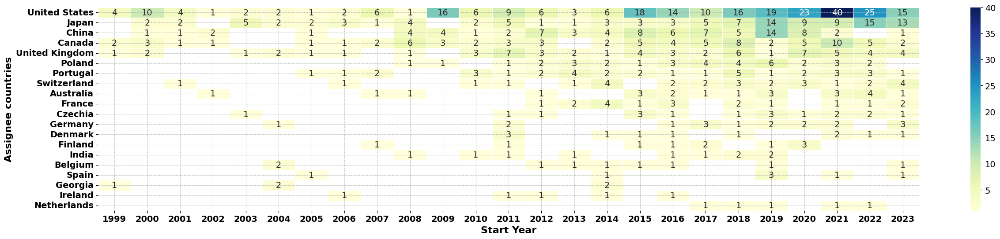

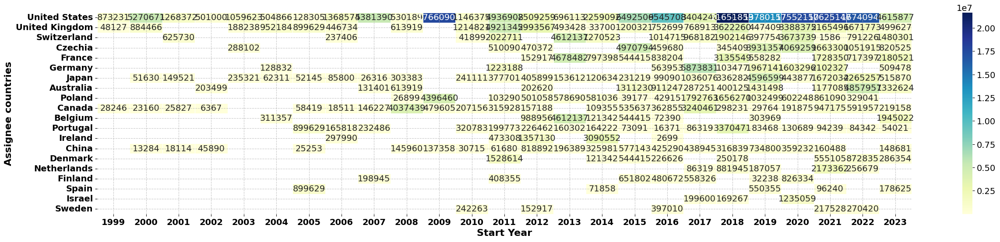

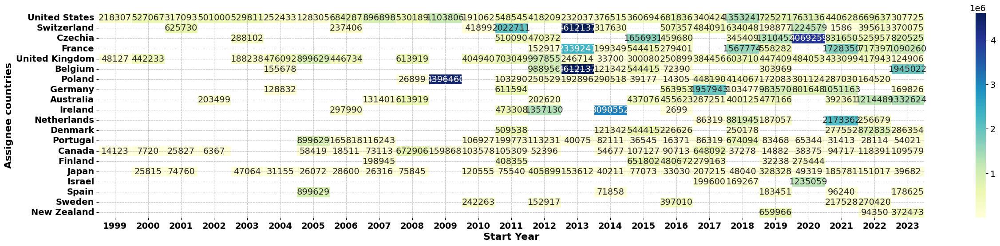

In [ ]:
col_name = 'Receiver - Country of standardized research organization'
xlabel = 'Start Year'
ylabel = 'Assignee countries'
pivot_df = group_and_pivot_Assignee(col_name,data)
figsize=(30, 6)
n_largest = 20

plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df

Average Funding amount in USD  \
Start Year                                                                  1999   
Receiver - Country of standardized research org...                                 
Australia                                                                    NaN   
Austria                                                                      NaN   
Belgium                                                                      NaN   
Brazil                                                                       NaN   
Canada                                                                  14123.00   
China                                                                        NaN   
Czechia                                                                      NaN   
Denmark                                                                      NaN   
Finland                                                                      NaN   
France                                                                       NaN   
Georgia                                                                 48127.00   
Germany                                                                      NaN   
Greece                                                                       NaN   
Hungary                                                                      NaN   
India                                                                        NaN   
Ireland                                                                      NaN   
Israel                                                                       NaN   
Italy                                                                        NaN   
Japan                                                                        NaN   
Latvia                                                                       NaN   
Netherlands                                                                  NaN   
New Zealand                                                                  NaN   
Norway                                                                       NaN   
Poland                                                                       NaN   
Portugal                                                                     NaN   
Russia                                                                       NaN   
Singapore                                                                    NaN   
Slovakia                                                                     NaN   
South Africa                                                                 NaN   
Spain                                                                        NaN   
Sweden                                                                       NaN   
Switzerland                                                                  NaN   
Taiwan                                                                       NaN   
Tanzania                                                                     NaN   
Thailand                                                                     NaN   
Uganda                                                                       NaN   
Ukraine                                                                      NaN   
United Kingdom                                                          48127.00   
United States                                                          218307.75   

                                                                        \
Start Year                                              2000      2001   
Receiver - Country of standardized research org...                       
Australia                                                NaN       NaN   
Austria                                                  NaN       NaN   
Belgium                                                  NaN       NaN   
Brazil                                                   NaN       NaN   
Cana

In [ ]:
pivot_df['Total Grant'].sum(axis=1).nlargest(200)

Receiver - Country of standardized research organization
United States     259.0
Japan             111.0
China              81.0
Canada             76.0
United Kingdom     61.0
Portugal           35.0
Poland             35.0
Switzerland        28.0
Australia          22.0
France             18.0
Germany            17.0
Czechia            17.0
Denmark            11.0
India              10.0
Finland            10.0
Belgium             9.0
Spain               7.0
Norway              5.0
Slovakia            5.0
Ireland             5.0
Netherlands         5.0
Sweden              5.0
Georgia             5.0
Israel              3.0
New Zealand         3.0
Thailand            2.0
Russia              2.0
Singapore           2.0
Italy               2.0
Taiwan              2.0
Uganda              1.0
Ukraine             1.0
Tanzania            1.0
Greece              1.0
Brazil              1.0
South Africa        1.0
Hungary             1.0
Austria             1.0
Latvia              1.0
dtype: 

In [ ]:
top10entities = pivot_df['Total Grant'].sum(axis=1).nlargest(5).index
top10entities

Index(['United States', 'Japan', 'China', 'Canada', 'United Kingdom'], dtype='object', name='Receiver - Country of standardized research organization')

In [ ]:
entities_data_to_plot = pivot_df['Total Grant'].T[top10entities]
entities_data_to_plot

Receiver - Country of standardized research organization,United States,Japan,China,Canada,United Kingdom
Start Year,,,,,
1999,4.0,NaN,NaN,2.0,1.0
2000,10.0,2.0,1.0,3.0,2.0
2001,4.0,2.0,1.0,1.0,NaN
2002,1.0,NaN,2.0,1.0,NaN
2003,2.0,5.0,NaN,NaN,1.0
2004,2.0,2.0,NaN,NaN,2.0
2005,1.0,2.0,1.0,1.0,1.0
2006,2.0,3.0,NaN,1.0,1.0
2007,6.0,1.0,NaN,2.0,NaN


In [ ]:
# import matplotlib.pyplot as plt
# import pandas as pd

# # Assuming your data is in a CSV file called 'patent_data.csv'
# data_trend = entities_data_to_plot.reset_index()

# # Rename your columns for easier access
# data_trend.columns = ['Start Year', 'United States', 'China', 'South Korea', 'Japan', 'United Kingdom']

# # Sort data by Year for proper plotting
# data_trend2 = data_trend.sort_values('Start Year')

# # Define the x (Year) values
# x = data_trend2['Start Year'].astype(float).values

# # Plotting each category individually
# plt.figure(figsize=(7, 4))  # Increased figure size

# # Choosing distinct and appropriate colors for each category
# # Increasing the linewidth for all plots to make them bold
# plt.plot(x, data_trend2['United States'], label='United States (228 patents)', color='mediumseagreen', linewidth=2.)
# plt.plot(x, data_trend2['China'], label='China (170 patents)', color='darkblue', linewidth=2.)
# plt.plot(x, data_trend2['South Korea'], label='South Korea (34 patents)', color='lightpink', linewidth=2)
# plt.plot(x, data_trend2['Japan'], label='Japan (18 patents)', color='linen', linewidth=2.5)
# plt.plot(x, data_trend2['United Kingdom'], label='United Kingdom (16 patents)', color='silver', linewidth=2)

# # Add title and labels with increased font sizes
# #plt.title('Patent Activity by Category in Phage Therapy (1955-2023)', fontsize=18)
# plt.xlabel('Start Year', fontsize=16, fontweight='bold')
# plt.ylabel('N° of Patents Families', fontsize=16, fontweight='bold')

# # Increase legend and tick font size
# plt.legend(title='Assignee countries',loc='upper left', fontsize=13)
# plt.xticks(fontsize=14, fontweight='bold')
# plt.yticks(fontsize=14, fontweight='bold')

# # Display the plot
# plt.xticks(rotation=90)
# plt.tight_layout()  # Adjust the layout to prevent clipping
# plt.show()


In [ ]:
# #col_name = 'IPC Subclass'
# n_largest = 10
# plot_elt_counts_by_year(col_name, data, n_largest)

## Receiver - Region of standardized research organization

The number of unique Assignee is: 6


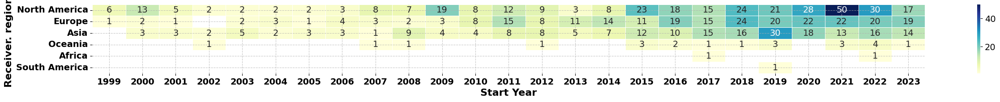

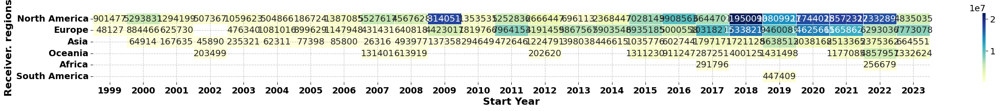

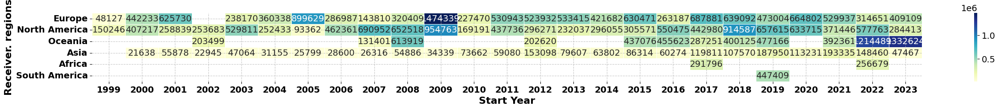

In [ ]:
col_name = 'Receiver - Region of standardized research organization'
xlabel = 'Start Year'
ylabel = 'Receiver. regions'
pivot_df = group_and_pivot_Assignee(col_name,data)
n_largest = 6
figsize=(30, 2)

plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df['Total Grant'].sum(axis=1).nlargest(200)

Receiver - Region of standardized research organization
North America    335.0
Europe           250.0
Asia             211.0
Oceania           22.0
Africa             2.0
South America      1.0
dtype: float64

In [ ]:
top10entities = pivot_df['Total Grant'].sum(axis=1).nlargest(5).index
top10entities

Index(['North America', 'Europe', 'Asia', 'Oceania', 'Africa'], dtype='object', name='Receiver - Region of standardized research organization')

In [ ]:
entities_data_to_plot = pivot_df['Total Grant'].T[top10entities]
entities_data_to_plot

Receiver - Region of standardized research organization,North America,Europe,Asia,Oceania,Africa
Start Year,,,,,
1999,6.0,1.0,NaN,NaN,NaN
2000,13.0,2.0,3.0,NaN,NaN
2001,5.0,1.0,3.0,NaN,NaN
2002,2.0,NaN,2.0,1.0,NaN
2003,2.0,2.0,5.0,NaN,NaN
2004,2.0,3.0,2.0,NaN,NaN
2005,2.0,1.0,3.0,NaN,NaN
2006,3.0,4.0,3.0,NaN,NaN
2007,8.0,3.0,1.0,1.0,NaN


In [ ]:
# import matplotlib.pyplot as plt
# import pandas as pd

# # Assuming your data is in a CSV file called 'patent_data.csv'
# data_trend = entities_data_to_plot.reset_index()

# # Rename your columns for easier access
# data_trend.columns = ['Start Year', 'Asia', 'North America', 'Europe', 'Oceania', 'South America']

# # Sort data by Year for proper plotting
# data_trend2 = data_trend.sort_values('Start Year')

# # Define the x (Year) values
# x = data_trend2['Start Year'].astype(float).values

# # Plotting each category individually
# plt.figure(figsize=(7, 4))  # Increased figure size

# # Choosing distinct and appropriate colors for each category
# # Increasing the linewidth for all plots to make them bold
# plt.plot(x, data_trend2['Asia'], label='Asia (260 patents)', color='mediumseagreen', linewidth=2.)
# plt.plot(x, data_trend2['North America'], label='North America (233 patents)', color='darkblue', linewidth=2.)
# plt.plot(x, data_trend2['Europe'], label='Europe (65 patents)', color='lightpink', linewidth=2)
# plt.plot(x, data_trend2['Oceania'], label='Oceania (5 patents)', color='linen', linewidth=2.5)
# plt.plot(x, data_trend2['South America'], label='South America (2 patents)', color='silver', linewidth=2)

# # Add title and labels with increased font sizes
# #plt.title('Patent Activity by Category in Phage Therapy (1955-2023)', fontsize=18)
# plt.xlabel('Start Year', fontsize=16, fontweight='bold')
# plt.ylabel('N° of Patents Families', fontsize=16, fontweight='bold')

# # Increase legend and tick font size
# plt.legend(title='Assignee regions',loc='upper left', fontsize=16)
# plt.xticks(fontsize=14, fontweight='bold')
# plt.yticks(fontsize=14, fontweight='bold')

# # Display the plot
# plt.xticks(rotation=90)
# plt.tight_layout()  # Adjust the layout to prevent clipping
# plt.show()


In [ ]:
# #col_name = 'IPC Subclass'
# n_largest = 10
# plot_elt_counts_by_year(col_name, data, n_largest)

## Research Organization - standardized

The number of unique Assignee is: 525


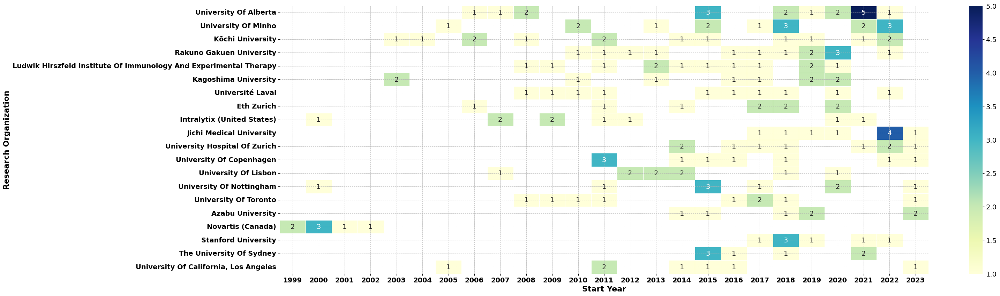

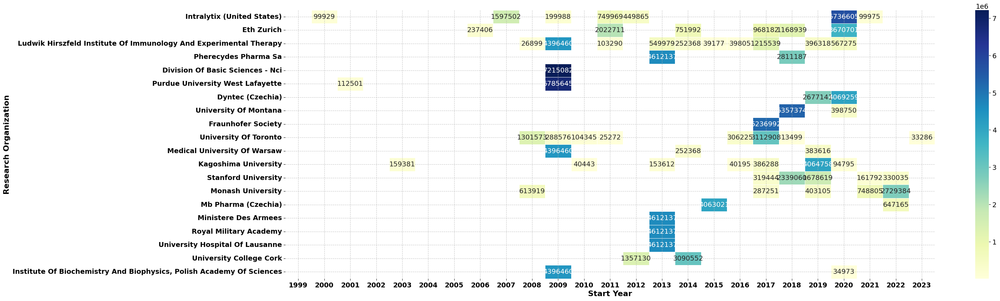

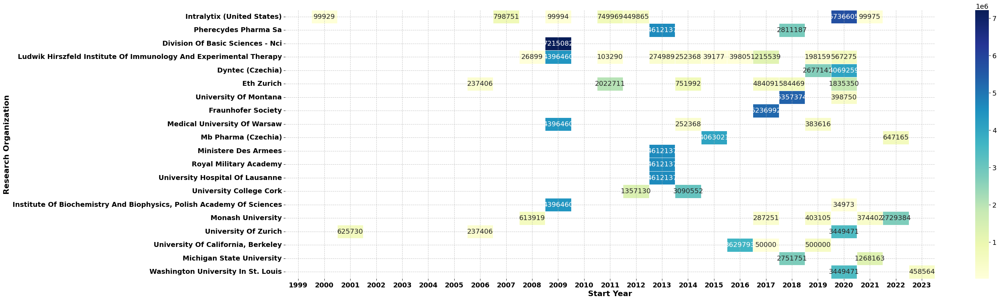

In [ ]:
col_name = 'Research Organization - standardized'
xlabel = 'Start Year'
ylabel = 'Research Organization'
pivot_df = group_and_pivot_Assignee(col_name,data)
figsize=(30, 10)
n_largest = 20

plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

In [ ]:
# #col_name = 'IPC Subclass'
# n_largest = 10
# plot_elt_counts_by_year(col_name, data, n_largest)

## Funder

The number of unique Assignee is: 105


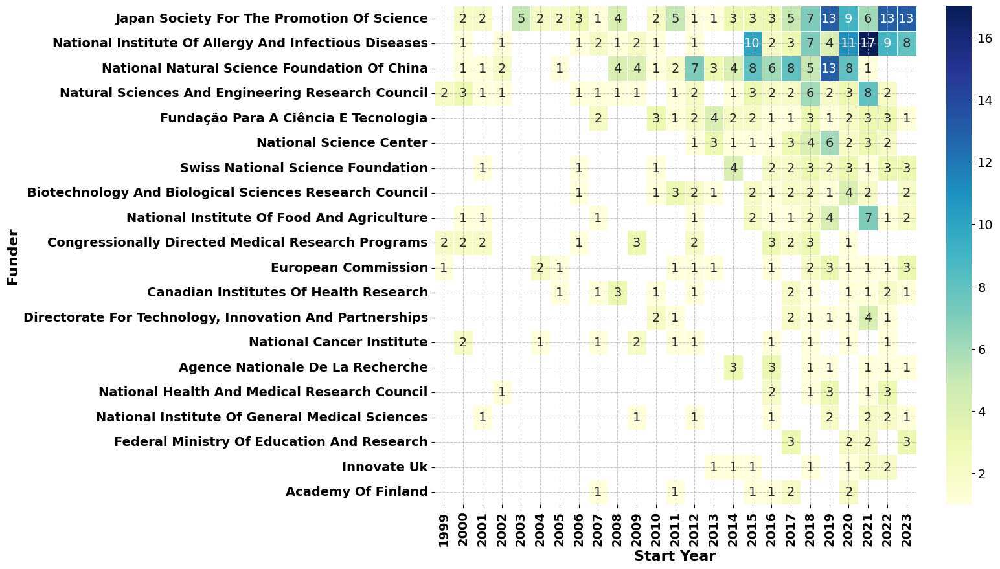

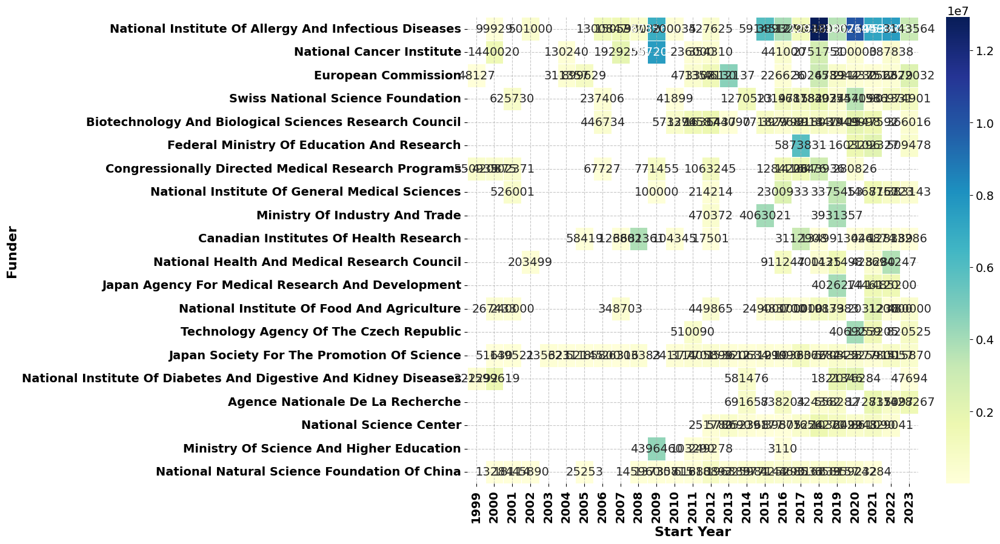

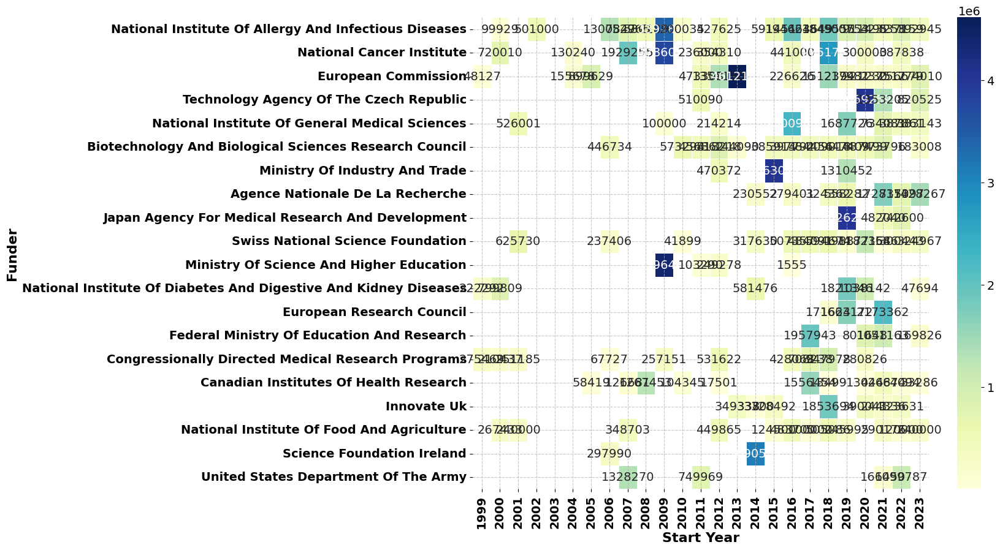

In [ ]:
col_name = 'Funder'
xlabel = 'Start Year'
ylabel = 'Funder'
pivot_df = group_and_pivot_Assignee(col_name,data)
figsize=(12, 10)
n_largest = 20

plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

In [ ]:
#col_name = 'IPC Subclass'
# n_largest = 10
# plot_elt_counts_by_year(col_name, data, n_largest)

## Funder Country

The number of unique Assignee is: 25


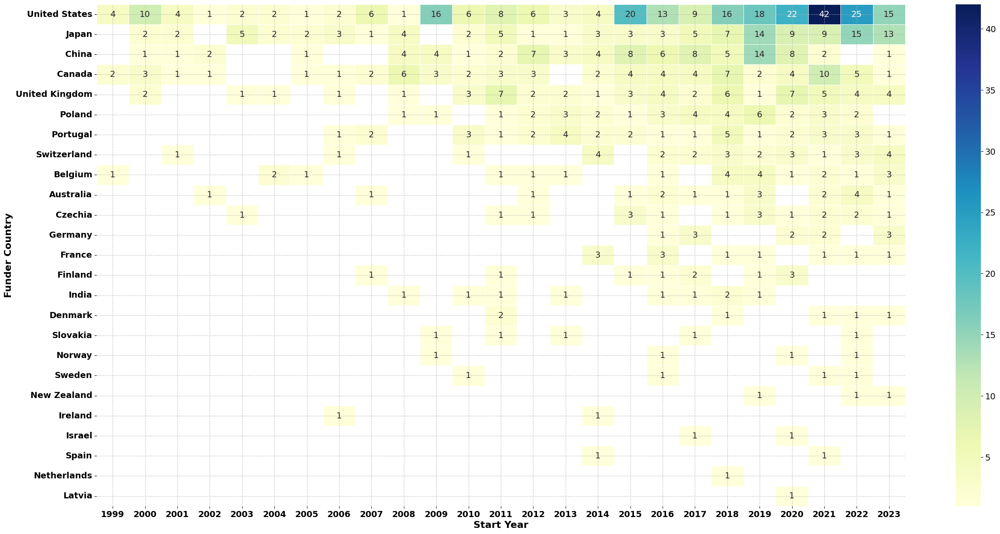

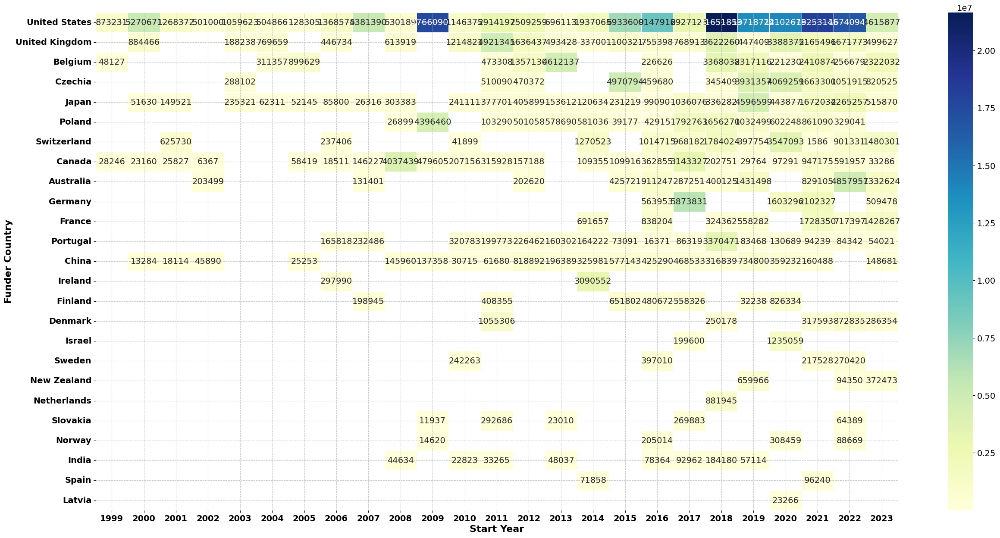

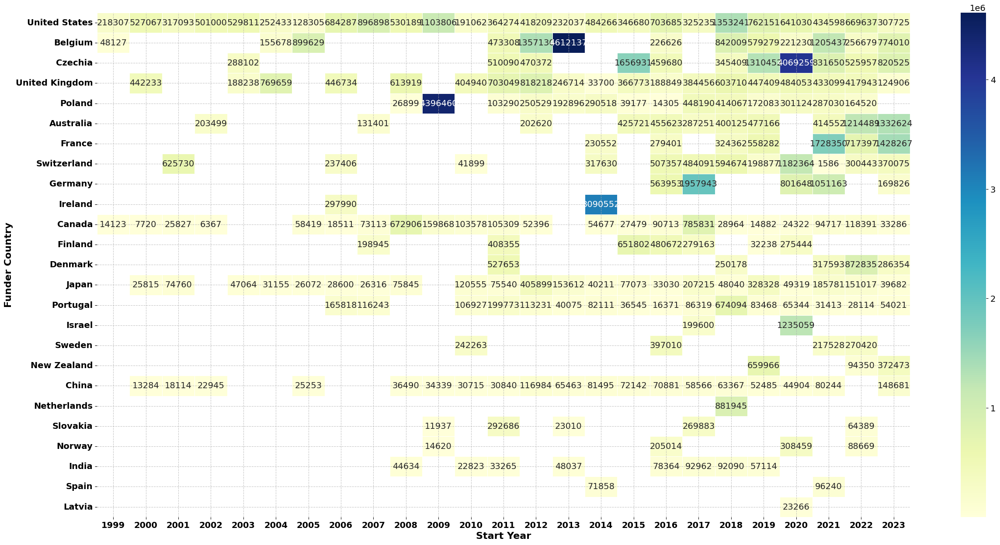

In [ ]:
col_name = 'Funder Country'
xlabel = 'Start Year'
ylabel = 'Funder Country'
pivot_df = group_and_pivot_Assignee(col_name,data)
n_largest = 32
figsize=(30, 15)

plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df['Total Grant'].sum(axis=1).nlargest(200)

Funder Country
United States     256.0
Japan             111.0
China              82.0
Canada             71.0
United Kingdom     57.0
Poland             35.0
Portugal           34.0
Switzerland        27.0
Belgium            23.0
Australia          18.0
Czechia            17.0
Germany            11.0
France             11.0
Finland            10.0
India               9.0
Denmark             6.0
Slovakia            5.0
Norway              4.0
Sweden              4.0
New Zealand         3.0
Ireland             2.0
Israel              2.0
Spain               2.0
Netherlands         1.0
Latvia              1.0
dtype: float64

In [ ]:
top10entities = pivot_df['Total Grant'].sum(axis=1).nlargest(5).index
top10entities

Index(['United States', 'Japan', 'China', 'Canada', 'United Kingdom'], dtype='object', name='Funder Country')

In [ ]:
entities_data_to_plot = pivot_df['Total Grant'].T[top10entities]
entities_data_to_plot

Funder Country,United States,Japan,China,Canada,United Kingdom
Start Year,,,,,
1999,4.0,NaN,NaN,2.0,NaN
2000,10.0,2.0,1.0,3.0,2.0
2001,4.0,2.0,1.0,1.0,NaN
2002,1.0,NaN,2.0,1.0,NaN
2003,2.0,5.0,NaN,NaN,1.0
2004,2.0,2.0,NaN,NaN,1.0
2005,1.0,2.0,1.0,1.0,NaN
2006,2.0,3.0,NaN,1.0,1.0
2007,6.0,1.0,NaN,2.0,NaN


In [ ]:
# import matplotlib.pyplot as plt
# import pandas as pd

# # Assuming your data is in a CSV file called 'patent_data.csv'
# data_trend = entities_data_to_plot.reset_index()

# # Rename your columns for easier access
# data_trend.columns = ['Start Year', 'United States', 'WIPO', 'China', 'EPO', 'Japan']

# # Sort data by Year for proper plotting
# data_trend2 = data_trend.sort_values('Start Year')

# # Define the x (Year) values
# x = data_trend2['Start Year'].astype(float).values

# # Plotting each category individually
# plt.figure(figsize=(7, 4))  # Increased figure size

# # Choosing distinct and appropriate colors for each category
# # Increasing the linewidth for all plots to make them bold
# plt.plot(x, data_trend2['United States'], label='United States (250 patents)', color='mediumseagreen', linewidth=2.)
# plt.plot(x, data_trend2['WIPO'], label='WIPO (247 patents)', color='darkblue', linewidth=2.)
# plt.plot(x, data_trend2['China'], label='China (232 patents)', color='lightpink', linewidth=2)
# plt.plot(x, data_trend2['EPO'], label='EPO (110 patents)', color='linen', linewidth=2.5)
# plt.plot(x, data_trend2['Japan'], label='Japan (70 patents)', color='BLACK', linewidth=2)

# # Add title and labels with increased font sizes
# #plt.title('Patent Activity by Category in Phage Therapy (1955-2023)', fontsize=18)
# plt.xlabel('Start Year', fontsize=16, fontweight='bold')
# plt.ylabel('N° of Patents Families', fontsize=16, fontweight='bold')

# # Increase legend and tick font size
# plt.legend(title='Jurisdictions',loc='upper left', fontsize=13)
# plt.xticks(fontsize=14, fontweight='bold')
# plt.yticks(fontsize=14, fontweight='bold')

# # Display the plot
# plt.xticks(rotation=90)
# plt.tight_layout()  # Adjust the layout to prevent clipping
# plt.show()


In [ ]:
# #col_name = 'IPC Subclass'
# n_largest = 10
# plot_elt_counts_by_year(col_name, data, n_largest)

## Funder Type

The number of unique Assignee is: 4


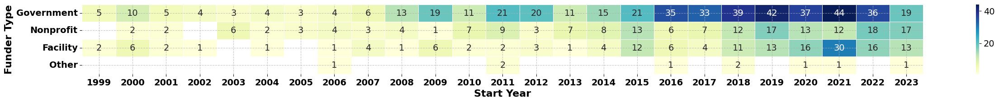

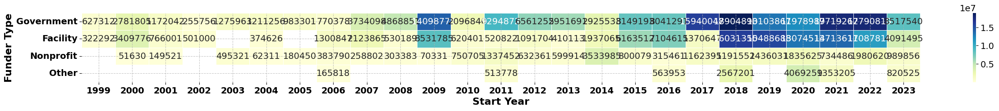

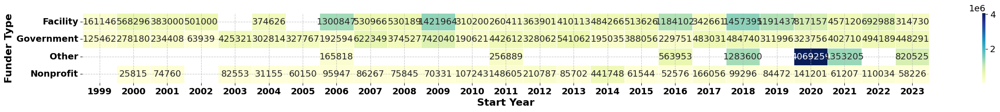

In [ ]:
col_name = 'Funder Type'
xlabel = 'Start Year'
ylabel = 'Funder Type'
pivot_df = group_and_pivot_Assignee(col_name,data)
n_largest = 10
figsize=(30, 2)

plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df['Total Grant'].sum(axis=1).nlargest(200)

Funder Type
Government    460.0
Nonprofit     176.0
Facility      157.0
Other           9.0
dtype: float64

In [ ]:
top10entities = pivot_df['Total Grant'].sum(axis=1).nlargest(5).index
top10entities

Index(['Government', 'Nonprofit', 'Facility', 'Other'], dtype='object', name='Funder Type')

In [ ]:
entities_data_to_plot = pivot_df['Total Grant'].T[top10entities]
entities_data_to_plot

Funder Type,Government,Nonprofit,Facility,Other
Start Year,,,,
1999,5.0,NaN,2.0,NaN
2000,10.0,2.0,6.0,NaN
2001,5.0,2.0,2.0,NaN
2002,4.0,NaN,1.0,NaN
2003,3.0,6.0,NaN,NaN
2004,4.0,2.0,1.0,NaN
2005,3.0,3.0,NaN,NaN
2006,4.0,4.0,1.0,1.0
2007,6.0,3.0,4.0,NaN


In [ ]:
# import matplotlib.pyplot as plt
# import pandas as pd

# # Assuming your data is in a CSV file called 'patent_data.csv'
# data_trend = entities_data_to_plot.reset_index()

# # Rename your columns for easier access
# data_trend.columns = ['Start Year', 'Commercial', 'Academic', 'Individual', 'Governmental']

# # Sort data by Year for proper plotting
# data_trend2 = data_trend.sort_values('Start Year')

# # Define the x (Year) values
# x = data_trend2['Start Year'].astype(float).values

# # Plotting each category individually
# plt.figure(figsize=(7, 4))  # Increased figure size

# # Choosing distinct and appropriate colors for each category
# # Increasing the linewidth for all plots to make them bold
# plt.plot(x, data_trend2['Commercial'], label='Commercial (347 patents)', color='mediumseagreen', linewidth=2.)
# plt.plot(x, data_trend2['Academic'], label='Academic (222 patents)', color='darkblue', linewidth=2.)
# plt.plot(x, data_trend2['Individual'], label='Individual (93 patents)', color='lightpink', linewidth=2)
# plt.plot(x, data_trend2['Governmental'], label='Governmental (6 patents)', color='linen', linewidth=2.5)
# #plt.plot(x, data_trend2['Russia'], label='Russia (81 patents)', color='silver', linewidth=2)

# # Add title and labels with increased font sizes
# #plt.title('Patent Activity by Category in Phage Therapy (1955-2023)', fontsize=18)
# plt.xlabel('Start Year', fontsize=16, fontweight='bold')
# plt.ylabel('N° of Patents Families', fontsize=16, fontweight='bold')

# # Increase legend and tick font size
# plt.legend(title='Assignee types',loc='upper left', fontsize=16)
# plt.xticks(fontsize=14, fontweight='bold')
# plt.yticks(fontsize=14, fontweight='bold')

# # Display the plot
# plt.xticks(rotation=90)
# plt.tight_layout()  # Adjust the layout to prevent clipping
# plt.show()


In [ ]:
# col_name = 'Receiver - Type of standardized research organization'
# n_largest = 4
# plot_elt_counts_by_year(col_name, data, n_largest)

## Receiver - Type of standardized research organization

The number of unique Assignee is: 8


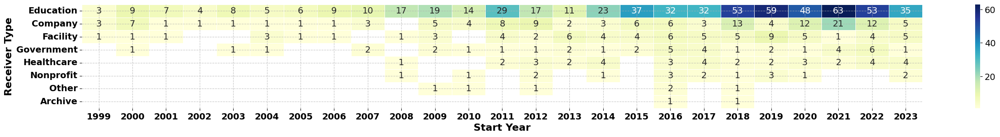

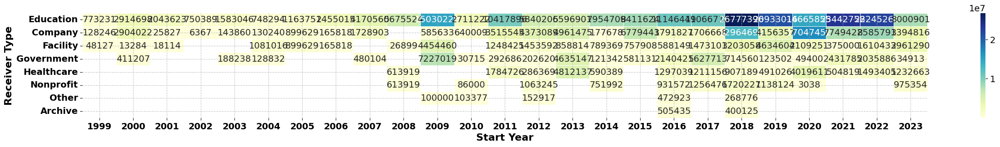

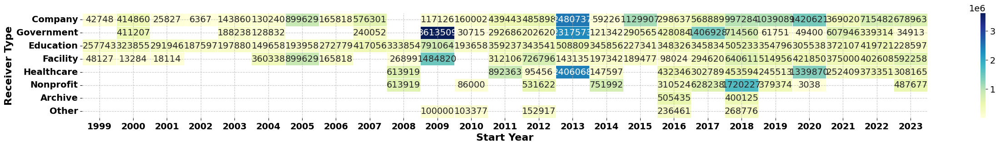

In [ ]:
col_name = 'Receiver - Type of standardized research organization'
xlabel = 'Start Year'
ylabel = 'Receiver Type'
pivot_df = group_and_pivot_Assignee(col_name,data)
n_largest = 10
figsize=(30, 3)

plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

## Topics

The number of unique Assignee is: 5


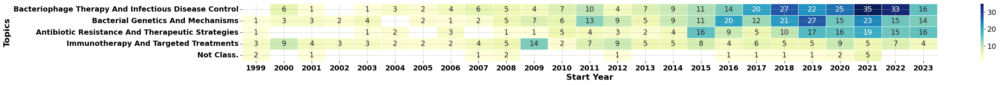

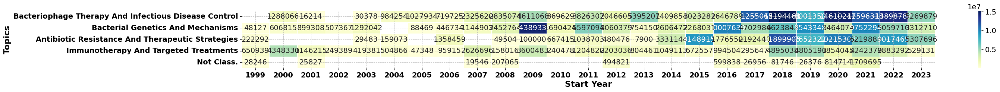

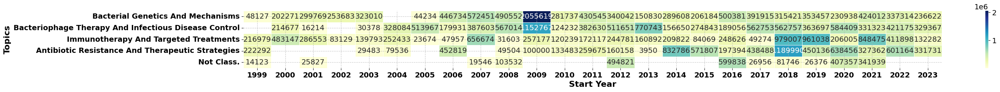

In [ ]:
col_name = 'Topic N°'
xlabel = 'Start Year'
ylabel = 'Topics'
pivot_df = group_and_pivot_Assignee(col_name,data)
n_largest = 10
figsize=(30, 2)

plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df['Total Grant'].sum(axis=1).nlargest(200)

Topic N°
Bacteriophage Therapy and Infectious Disease Control    272.0
Bacterial Genetics and Mechanisms                       230.0
Antibiotic Resistance and Therapeutic Strategies        150.0
Immunotherapy and Targeted Treatments                   132.0
Not Class.                                               18.0
dtype: float64

In [ ]:
top10entities = pivot_df['Total Grant'].sum(axis=1).index
top10entities

Index(['Antibiotic Resistance and Therapeutic Strategies',
       'Bacterial Genetics and Mechanisms',
       'Bacteriophage Therapy and Infectious Disease Control',
       'Immunotherapy and Targeted Treatments', 'Not Class.'],
      dtype='object', name='Topic N°')

In [ ]:
entities_data_to_plot = pivot_df['Total Grant'].T[top10entities]
entities_data_to_plot

Topic N°,Antibiotic Resistance and Therapeutic Strategies,Bacterial Genetics and Mechanisms,Bacteriophage Therapy and Infectious Disease Control,Immunotherapy and Targeted Treatments,Not Class.
Start Year,,,,,
1999,1.0,1.0,NaN,3.0,2.0
2000,NaN,3.0,6.0,9.0,NaN
2001,NaN,3.0,1.0,4.0,1.0
2002,NaN,2.0,NaN,3.0,NaN
2003,1.0,4.0,1.0,3.0,NaN
2004,2.0,NaN,3.0,2.0,NaN
2005,NaN,2.0,2.0,2.0,NaN
2006,3.0,1.0,4.0,2.0,NaN
2007,NaN,2.0,6.0,4.0,1.0


In [ ]:
# import matplotlib.pyplot as plt
# import pandas as pd

# # Assuming your data is in a CSV file called 'patent_data.csv'
# data_trend = entities_data_to_plot.reset_index()

# # Rename your columns for easier access
# data_trend.columns = ['Start Year', 'Topic 0', 'Topic 1', 'Topic 2', 'Topic 3', 'Topic 4']
# # , 'Topic 5',
#       #  'Topic 6', 'Topic 7', 'Topic 8', 'Topic 9']

# # Sort data by Year for proper plotting
# data_trend2 = data_trend.sort_values('Start Year')

# # Define the x (Year) values
# x = data_trend2['Start Year'].astype(float).values

# # Plotting each category individually
# plt.figure(figsize=(12, 8))  # Increased figure size

# # Choosing distinct and appropriate colors for each category
# # Increasing the linewidth for all plots to make them bold
# plt.plot(x, data_trend2['Topic 3'], label=wrap_text('(214) Topic 3', width=75), color='darkgreen', linewidth=3)
# # plt.plot(x, data_trend2['Topic 7'], label=wrap_text('(441) Topic 7: Antibody Discovery and Cancer Treatment via Phage Display', width=75), color='black', linewidth=3)
# # plt.plot(x, data_trend2['Topic 8'], label=wrap_text('(406) Topic 8: Broad-Spectrum Applications of Bacteriophages in Medicine', width=75), color='red', linewidth=4)
# plt.plot(x, data_trend2['Topic 2'], label=wrap_text('(120) Topic 2', width=75), color='slategray', linewidth=2)
# # plt.plot(x, data_trend2['Topic 9'], label=wrap_text('(176) Topic 9: Peptide-Based Vaccines and Therapeutics via Phage Display', width=75), color='magenta', linewidth=1)
# plt.plot(x, data_trend2['Topic 1'], label=wrap_text('(89) Topic 1', width=75), color='chocolate', linewidth=1.)
# plt.plot(x, data_trend2['Topic 4'], label=wrap_text('(53) Topic 4', width=75), color='orchid', linewidth=4)
# # plt.plot(x, data_trend2['Topic 6'], label=wrap_text('(67) Topic 6: Phage Applications in Food Safety and Microbial Detection', width=75), color='lightcoral', linewidth=1.)
# # plt.plot(x, data_trend2['Topic 5'], label=wrap_text('(46) Topic 5: Antimicrobial Activity of Bacteriophages', width=75), color='goldenrod', linewidth=1.)
# plt.plot(x, data_trend2['Topic 0'], label=wrap_text('(119) Topic 0', width=75), color='darkolivegreen', linewidth=1.)

# # Add title and labels with increased font sizes
# #plt.title('Patent Activity by Category in Phage Therapy (1955-2023)', fontsize=18)
# plt.xlabel('Start Year', fontsize=16, fontweight='bold')
# plt.ylabel('N° of Patents Families', fontsize=16, fontweight='bold')

# # Increase legend and tick font size
# plt.legend(loc='upper left', fontsize=14)
# plt.xticks(fontsize=14, fontweight='bold')
# plt.yticks(fontsize=14, fontweight='bold')

# # Display the plot
# plt.xticks(rotation=90)
# plt.tight_layout()  # Adjust the layout to prevent clipping
# plt.show()


In [ ]:
# #col_name = 'IPC Subclass'
# n_largest = 5
# plot_elt_counts_by_year(col_name, data, n_largest)

# Heatmap graph Research Organization

In [ ]:
from operator import index
def process_data(data, index_cols, split_col, top_n_index, top_n_col):
  # Set the index
  Assignee_data = data.set_index(['Grant ID', index_cols])

  # top_n_index_split_col
  top_n_index_split_col = data[split_col].str.split(';').explode().str.strip().str.title().to_frame()
  top_n_index_split_col = top_n_index_split_col.reset_index()
  top_n_index_split_col = top_n_index_split_col[top_n_index_split_col[split_col] != '']
  top_n_index_split_col = top_n_index_split_col[split_col].value_counts().head(top_n_index).index.to_list()

  # top_n_index_split_col
  top_n_col_index_cols = data[index_cols].str.split(';').explode().str.strip().str.title().to_frame()
  top_n_col_index_cols = top_n_col_index_cols.reset_index()
  top_n_col_index_cols = top_n_col_index_cols[top_n_col_index_cols[index_cols] != '']
  top_n_col_index_cols = top_n_col_index_cols[index_cols].value_counts().head(top_n_col).index.to_list()

  # Split and explode the 'Funder' field
  Assignee_list = Assignee_data[split_col].str.split(';').explode().str.strip().to_frame()
      # Reset the index to re-organize data
  Assignee_list2 = Assignee_list.reset_index()
  Assignee_list2[split_col] = Assignee_list2[split_col].str.title()
  #Assignee_list2 = Assignee_list2[Assignee_list2[index_cols] != '']
  #Assignee_list2 = Assignee_list2[Assignee_list2[split_col] != '']

  # Set the index
  Assignee_list3 = Assignee_list2.set_index(['Grant ID', split_col])

  # Split and explode the 'Funder' field
  Assignee_list4 = Assignee_list3[index_cols].str.split(';').explode().str.strip().to_frame()
      # Reset the index to re-organize data
  Assignee_list4 = Assignee_list4.reset_index()
  Assignee_list4[index_cols] = Assignee_list4[index_cols].str.title()
  #Assignee_list4 = Assignee_list4[Assignee_list4[index_cols] != '']
  #Assignee_list4 = Assignee_list4[Assignee_list4[split_col] != '']

  grouped = Assignee_list4.groupby([index_cols, split_col]).agg({
      'Grant ID': 'count'
  }).reset_index()

  pivot_df = grouped.pivot_table(index=split_col, columns=index_cols, values=['Grant ID'], aggfunc='sum')['Grant ID']
  #pivot_df2 = pivot_df[top_n_col_index_cols].T
  pivot_df2 = pd.DataFrame()
  missing_values = [value for value in top_n_col_index_cols if value not in pivot_df.columns]
  if missing_values:
      print(f"These values are missing in the index: {missing_values}")
  else:
      pivot_df2 = pivot_df[top_n_col_index_cols].T
  pivot_df2

  #pivot_df3 = pivot_df2[top_n_index_split_col].T
  pivot_df3 = pd.DataFrame()
  missing_values = [value for value in top_n_index_split_col if value not in pivot_df2.columns]
  if missing_values:
      print(f"These values are missing in the index: {missing_values}")
  else:
      pivot_df3 = pivot_df2[top_n_index_split_col].T
  pivot_df3
  return pivot_df3


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def plot_top_50_heatmap(pivot_df, split_col, top_n_index, figsize, xlabel, ylabel):
    """
    Plot a heatmap for the given metric for top 50 companies based on Publication Count.

    Args:
    - pivot_df (pd.DataFrame): The pivoted DataFrame with metrics for each Assignee over different application years.
    - metric (str): The metric based on which the top 50 companies are determined. Default is 'Total Grant'.

    Returns:
    None
    """

    # Ensure the index is properly formatted
    pivot_df.index = pivot_df.index.to_series().str.title()

    # Round the values and convert to integer
    pivot_df = pivot_df.fillna(0)
    pivot_df = np.round(pivot_df).astype('int64')
    pivot_df = pivot_df.replace(0, np.nan)

    def convert_to_int(x):
      return int(x) if not pd.isna(x) else np.nan

    for col in pivot_df :
      pivot_df[col] = pivot_df[col].apply(convert_to_int)

    plt.figure(figsize=figsize)

    # Extract data for the given metric
    data_to_plot = pivot_df.reset_index()

    # Wrapping title with year and Assignee name
    #data_to_plot['Receiver - Type of standardized research organization'] = data_to_plot.apply(lambda row: f"{row['Receiver - Type of standardized research organization'].title()}", axis=1)
    data_to_plot[split_col] = data_to_plot.apply(lambda row: f"{row[split_col].title()}", axis=1)

    # Set the Assignee column as the index
    data_to_plot = data_to_plot.set_index(split_col)

    # Create the heatmap
    if data_to_plot.empty:
        print("The DataFrame is empty.")
    else:
        sns.heatmap(data_to_plot, annot=True, fmt=".0f", cmap='YlGnBu', linewidths=.5, cbar_kws={"orientation": "vertical"})

    plt.xticks(fontsize=14, fontweight='bold')
    plt.yticks(fontsize=14, fontweight='bold')
    #plt.title(f"Heatmap of Top 50 Assignee and the Top 25 IPCR Subclass", fontsize=18, fontweight='bold')
    plt.xlabel(xlabel, fontsize=16, fontweight='bold')
    plt.ylabel(ylabel, fontsize=16, fontweight='bold')
    plt.grid( linestyle='--', alpha=0.7) #axis='x',
    plt.show()


## topics

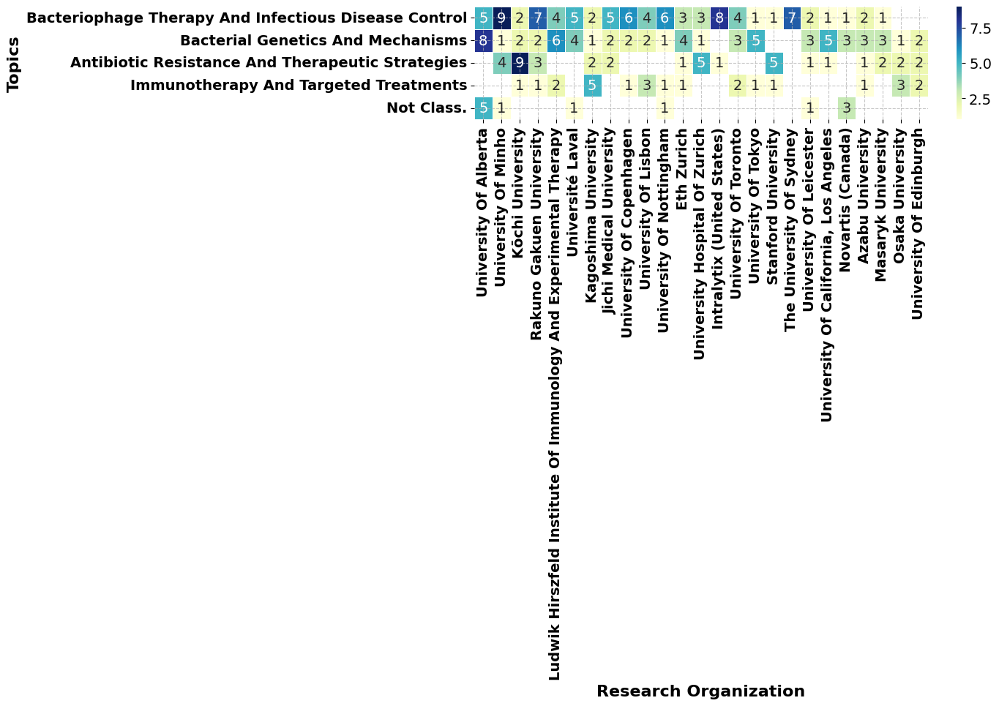

In [ ]:
index_cols = 'Research Organization - standardized'
split_col = 'Topic N°'
top_n_col = 25
top_n_index = 20
figsize=(10, 2)
xlabel = 'Research Organization'
ylabel = "Topics"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

In [ ]:
df

Research Organization - standardized,University Of Alberta,University Of Minho,Kōchi University,Rakuno Gakuen University,Ludwik Hirszfeld Institute Of Immunology And Experimental Therapy,Université Laval,Kagoshima University,Jichi Medical University,University Of Copenhagen,University Of Lisbon,University Of Nottingham,Eth Zurich,University Hospital Of Zurich,Intralytix (United States),University Of Toronto,University Of Tokyo,Stanford University,The University Of Sydney,University Of Leicester,"University Of California, Los Angeles",Novartis (Canada),Azabu University,Masaryk University,Osaka University,University Of Edinburgh
Topic N°,,,,,,,,,,,,,,,,,,,,,,,,,
Bacteriophage Therapy And Infectious Disease Control,5.0,9.0,2.0,7.0,4.0,5.0,2.0,5.0,6.0,4.0,6.0,3.0,3.0,8.0,4.0,1.0,1.0,7.0,2.0,1.0,1.0,2.0,1.0,NaN,NaN
Bacterial Genetics And Mechanisms,8.0,1.0,2.0,2.0,6.0,4.0,1.0,2.0,2.0,2.0,1.0,4.0,1.0,NaN,3.0,5.0,NaN,NaN,3.0,5.0,3.0,3.0,3.0,1.0,2.0
Antibiotic Resistance And Therapeutic Strategies,NaN,4.0,9.0,3.0,NaN,NaN,2.0,2.0,NaN,NaN,NaN,1.0,5.0,1.0,NaN,NaN,5.0,NaN,1.0,1.0,NaN,1.0,2.0,2.0,2.0
Immunotherapy And Targeted Treatments,NaN,NaN,1.0,1.0,2.0,NaN,5.0,NaN,1.0,3.0,1.0,1.0,NaN,NaN,2.0,1.0,1.0,NaN,NaN,NaN,NaN,1.0,NaN,3.0,2.0
Not Class.,5.0,1.0,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,3.0,NaN,NaN,NaN,NaN


# Heatmap graph Assignee Receiver - Country of standardized research organization

In [ ]:
from operator import index
def process_data(data, index_cols, split_col, top_n_index, top_n_col):
  # Set the index
  Assignee_data = data.set_index(['Grant ID', index_cols])

  # top_n_index_split_col
  top_n_index_split_col = data[split_col].str.split(';').explode().str.strip().str.title().to_frame()
  top_n_index_split_col = top_n_index_split_col.reset_index()
  top_n_index_split_col = top_n_index_split_col[top_n_index_split_col[split_col] != '']
  top_n_index_split_col = top_n_index_split_col[split_col].value_counts().head(top_n_index).index.to_list()

  # top_n_index_split_col
  top_n_col_index_cols = data[index_cols].str.split(';').explode().str.strip().str.title().to_frame()
  top_n_col_index_cols = top_n_col_index_cols.reset_index()
  top_n_col_index_cols = top_n_col_index_cols[top_n_col_index_cols[index_cols] != '']
  top_n_col_index_cols = top_n_col_index_cols[index_cols].value_counts().head(top_n_col).index.to_list()

  # Split and explode the 'Funder' field
  Assignee_list = Assignee_data[split_col].str.split(';').explode().str.strip().to_frame()
      # Reset the index to re-organize data
  Assignee_list2 = Assignee_list.reset_index()
  Assignee_list2[split_col] = Assignee_list2[split_col].str.title()
  #Assignee_list2 = Assignee_list2[Assignee_list2[index_cols] != '']
  #Assignee_list2 = Assignee_list2[Assignee_list2[split_col] != '']

  # Set the index
  Assignee_list3 = Assignee_list2.set_index(['Grant ID', split_col])

  # Split and explode the 'Funder' field
  Assignee_list4 = Assignee_list3[index_cols].str.split(';').explode().str.strip().to_frame()
      # Reset the index to re-organize data
  Assignee_list4 = Assignee_list4.reset_index()
  Assignee_list4[index_cols] = Assignee_list4[index_cols].str.title()
  #Assignee_list4 = Assignee_list4[Assignee_list4[index_cols] != '']
  #Assignee_list4 = Assignee_list4[Assignee_list4[split_col] != '']

  grouped = Assignee_list4.groupby([index_cols, split_col]).agg({
      'Grant ID': 'count'
  }).reset_index()

  pivot_df = grouped.pivot_table(index=split_col, columns=index_cols, values=['Grant ID'], aggfunc='sum')['Grant ID']
  #pivot_df2 = pivot_df[top_n_col_index_cols].T
  pivot_df2 = pd.DataFrame()
  missing_values = [value for value in top_n_col_index_cols if value not in pivot_df.columns]
  if missing_values:
      print(f"These values are missing in the index: {missing_values}")
  else:
      pivot_df2 = pivot_df[top_n_col_index_cols].T
  pivot_df2

  #pivot_df3 = pivot_df2[top_n_index_split_col].T
  pivot_df3 = pd.DataFrame()
  missing_values = [value for value in top_n_index_split_col if value not in pivot_df2.columns]
  if missing_values:
      print(f"These values are missing in the index: {missing_values}")
  else:
      pivot_df3 = pivot_df2[top_n_index_split_col].T
  pivot_df3
  return pivot_df3


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def plot_top_50_heatmap(pivot_df, split_col, top_n_index, figsize, xlabel, ylabel):
    """
    Plot a heatmap for the given metric for top 50 companies based on Publication Count.

    Args:
    - pivot_df (pd.DataFrame): The pivoted DataFrame with metrics for each Assignee over different application years.
    - metric (str): The metric based on which the top 50 companies are determined. Default is 'Total Grant'.

    Returns:
    None
    """

    # Ensure the index is properly formatted
    pivot_df.index = pivot_df.index.to_series().str.title()

    # Round the values and convert to integer
    pivot_df = pivot_df.fillna(0)
    pivot_df = np.round(pivot_df).astype('int64')
    pivot_df = pivot_df.replace(0, np.nan)

    def convert_to_int(x):
      return int(x) if not pd.isna(x) else np.nan

    for col in pivot_df :
      pivot_df[col] = pivot_df[col].apply(convert_to_int)

    plt.figure(figsize=figsize)

    # Extract data for the given metric
    data_to_plot = pivot_df.reset_index()

    # Wrapping title with year and Assignee name
    #data_to_plot['Receiver - Type of standardized research organization'] = data_to_plot.apply(lambda row: f"{row['Receiver - Type of standardized research organization'].title()}", axis=1)
    data_to_plot[split_col] = data_to_plot.apply(lambda row: f"{row[split_col].title()}", axis=1)

    # Set the Assignee column as the index
    data_to_plot = data_to_plot.set_index(split_col)

    # Create the heatmap
    if data_to_plot.empty:
        print("The DataFrame is empty.")
    else:
        sns.heatmap(data_to_plot, annot=True, fmt=".0f", cmap='YlGnBu', linewidths=.5, cbar_kws={"orientation": "vertical"})

    plt.xticks(fontsize=14, fontweight='bold')
    plt.yticks(fontsize=14, fontweight='bold')
    #plt.title(f"Heatmap of Top 50 Assignee and the Top 25 IPCR Subclass", fontsize=18, fontweight='bold')
    plt.xlabel(xlabel, fontsize=16, fontweight='bold')
    plt.ylabel(ylabel, fontsize=16, fontweight='bold')
    plt.grid( linestyle='--', alpha=0.7) #axis='x',
    plt.show()


## topics

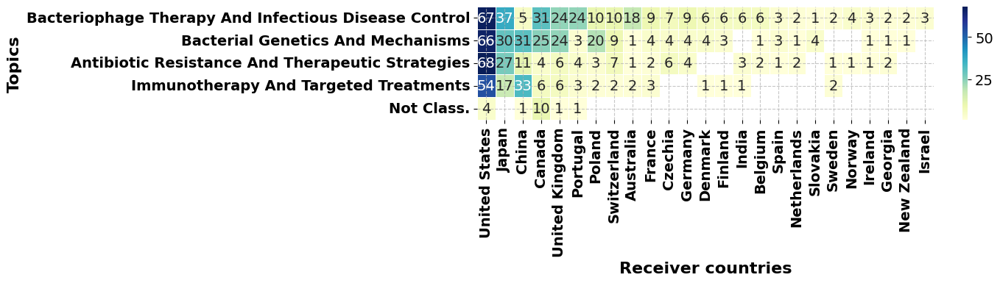

In [ ]:
index_cols = 'Receiver - Country of standardized research organization'
split_col = 'Topic N°'
top_n_col = 25
top_n_index = 20
figsize=(10, 2)
xlabel = "Receiver countries"
ylabel = "Topics"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

In [ ]:
df

Receiver - Country of standardized research organization,United States,Japan,China,Canada,United Kingdom,Portugal,Poland,Switzerland,Australia,France,Czechia,Germany,Denmark,Finland,India,Belgium,Spain,Netherlands,Slovakia,Sweden,Norway,Ireland,Georgia,New Zealand,Israel
Topic N°,,,,,,,,,,,,,,,,,,,,,,,,,
Bacteriophage Therapy And Infectious Disease Control,67.0,37.0,5.0,31.0,24.0,24.0,10.0,10.0,18.0,9.0,7.0,9.0,6.0,6.0,6.0,6.0,3.0,2.0,1.0,2.0,4.0,3.0,2.0,2.0,3.0
Bacterial Genetics And Mechanisms,66.0,30.0,31.0,25.0,24.0,3.0,20.0,9.0,1.0,4.0,4.0,4.0,4.0,3.0,NaN,1.0,3.0,1.0,4.0,NaN,NaN,1.0,1.0,1.0,NaN
Antibiotic Resistance And Therapeutic Strategies,68.0,27.0,11.0,4.0,6.0,4.0,3.0,7.0,1.0,2.0,6.0,4.0,NaN,NaN,3.0,2.0,1.0,2.0,NaN,1.0,1.0,1.0,2.0,NaN,NaN
Immunotherapy And Targeted Treatments,54.0,17.0,33.0,6.0,6.0,3.0,2.0,2.0,2.0,3.0,NaN,NaN,1.0,1.0,1.0,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN
Not Class.,4.0,NaN,1.0,10.0,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Heatmap graph Receiver - Region

In [ ]:
from operator import index
def process_data(data, index_cols, split_col, top_n_index, top_n_col):
  # Set the index
  Assignee_data = data.set_index(['Grant ID', index_cols])

  # top_n_index_split_col
  top_n_index_split_col = data[split_col].str.split(';').explode().str.strip().str.title().to_frame()
  top_n_index_split_col = top_n_index_split_col.reset_index()
  top_n_index_split_col = top_n_index_split_col[top_n_index_split_col[split_col] != '']
  top_n_index_split_col = top_n_index_split_col[split_col].value_counts().head(top_n_index).index.to_list()

  # top_n_index_split_col
  top_n_col_index_cols = data[index_cols].str.split(';').explode().str.strip().str.title().to_frame()
  top_n_col_index_cols = top_n_col_index_cols.reset_index()
  top_n_col_index_cols = top_n_col_index_cols[top_n_col_index_cols[index_cols] != '']
  top_n_col_index_cols = top_n_col_index_cols[index_cols].value_counts().head(top_n_col).index.to_list()

  # Split and explode the 'Funder' field
  Assignee_list = Assignee_data[split_col].str.split(';').explode().str.strip().to_frame()
      # Reset the index to re-organize data
  Assignee_list2 = Assignee_list.reset_index()
  Assignee_list2[split_col] = Assignee_list2[split_col].str.title()
  #Assignee_list2 = Assignee_list2[Assignee_list2[index_cols] != '']
  #Assignee_list2 = Assignee_list2[Assignee_list2[split_col] != '']

  # Set the index
  Assignee_list3 = Assignee_list2.set_index(['Grant ID', split_col])

  # Split and explode the 'Funder' field
  Assignee_list4 = Assignee_list3[index_cols].str.split(';').explode().str.strip().to_frame()
      # Reset the index to re-organize data
  Assignee_list4 = Assignee_list4.reset_index()
  Assignee_list4[index_cols] = Assignee_list4[index_cols].str.title()
  #Assignee_list4 = Assignee_list4[Assignee_list4[index_cols] != '']
  #Assignee_list4 = Assignee_list4[Assignee_list4[split_col] != '']

  grouped = Assignee_list4.groupby([index_cols, split_col]).agg({
      'Grant ID': 'count'
  }).reset_index()

  pivot_df = grouped.pivot_table(index=split_col, columns=index_cols, values=['Grant ID'], aggfunc='sum')['Grant ID']
  #pivot_df2 = pivot_df[top_n_col_index_cols].T
  pivot_df2 = pd.DataFrame()
  missing_values = [value for value in top_n_col_index_cols if value not in pivot_df.columns]
  if missing_values:
      print(f"These values are missing in the index: {missing_values}")
  else:
      pivot_df2 = pivot_df[top_n_col_index_cols].T
  pivot_df2

  #pivot_df3 = pivot_df2[top_n_index_split_col].T
  pivot_df3 = pd.DataFrame()
  missing_values = [value for value in top_n_index_split_col if value not in pivot_df2.columns]
  if missing_values:
      print(f"These values are missing in the index: {missing_values}")
  else:
      pivot_df3 = pivot_df2[top_n_index_split_col].T
  pivot_df3
  return pivot_df3


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def plot_top_50_heatmap(pivot_df, split_col, top_n_index, figsize, xlabel, ylabel):
    """
    Plot a heatmap for the given metric for top 50 companies based on Publication Count.

    Args:
    - pivot_df (pd.DataFrame): The pivoted DataFrame with metrics for each Assignee over different application years.
    - metric (str): The metric based on which the top 50 companies are determined. Default is 'Total Grant'.

    Returns:
    None
    """

    # Ensure the index is properly formatted
    pivot_df.index = pivot_df.index.to_series().str.title()

    # Round the values and convert to integer
    pivot_df = pivot_df.fillna(0)
    pivot_df = np.round(pivot_df).astype('int64')
    pivot_df = pivot_df.replace(0, np.nan)

    def convert_to_int(x):
      return int(x) if not pd.isna(x) else np.nan

    for col in pivot_df :
      pivot_df[col] = pivot_df[col].apply(convert_to_int)

    plt.figure(figsize=figsize)

    # Extract data for the given metric
    data_to_plot = pivot_df.reset_index()

    # Wrapping title with year and Assignee name
    #data_to_plot['Receiver - Type of standardized research organization'] = data_to_plot.apply(lambda row: f"{row['Receiver - Type of standardized research organization'].title()}", axis=1)
    data_to_plot[split_col] = data_to_plot.apply(lambda row: f"{row[split_col].title()}", axis=1)

    # Set the Assignee column as the index
    data_to_plot = data_to_plot.set_index(split_col)

    # Create the heatmap
    if data_to_plot.empty:
        print("The DataFrame is empty.")
    else:
        sns.heatmap(data_to_plot, annot=True, fmt=".0f", cmap='YlGnBu', linewidths=.5, cbar_kws={"orientation": "vertical"})

    plt.xticks(fontsize=14, fontweight='bold')
    plt.yticks(fontsize=14, fontweight='bold')
    #plt.title(f"Heatmap of Top 50 Assignee and the Top 25 IPCR Subclass", fontsize=18, fontweight='bold')
    plt.xlabel(xlabel, fontsize=16, fontweight='bold')
    plt.ylabel(ylabel, fontsize=16, fontweight='bold')
    plt.grid( linestyle='--', alpha=0.7) #axis='x',
    plt.show()


## topics

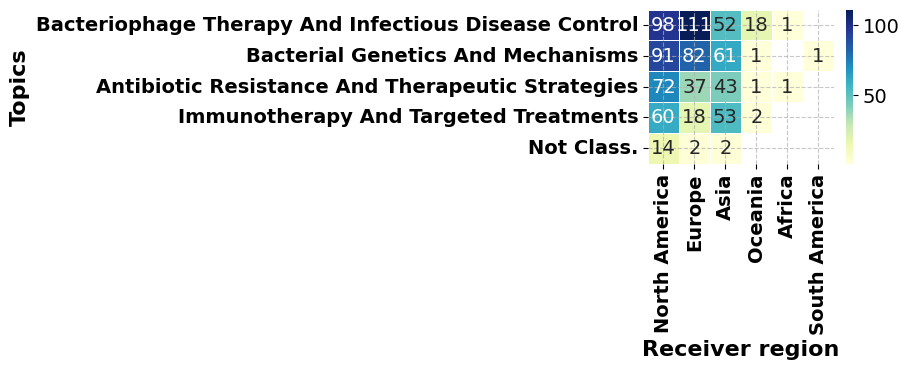

In [ ]:
index_cols = 'Receiver - Region of standardized research organization'
split_col = 'Topic N°'
top_n_col = 25
top_n_index = 20
figsize=(3, 2)
xlabel = "Receiver region"
ylabel = "Topics"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

# Heatmap graph TOPICS

In [ ]:
# from operator import index
# def process_data(data, index_cols, split_col, top_n_index, top_n_col):
#   # Set the index
#   Assignee_data = data.set_index(['Grant ID', 'Funding amount in USD', index_cols])

#   # top_n_index_split_col
#   top_n_index_split_col = data[split_col].str.split(';').explode().str.strip().str.title().to_frame()
#   top_n_index_split_col = top_n_index_split_col.reset_index()
#   top_n_index_split_col = top_n_index_split_col[top_n_index_split_col[split_col] != '']
#   top_n_index_split_col = top_n_index_split_col[split_col].value_counts().head(top_n_index).index.to_list()

#   # top_n_index_split_col
#   top_n_col_index_cols = data[index_cols].str.split(';').explode().str.strip().str.title().to_frame()
#   top_n_col_index_cols = top_n_col_index_cols.reset_index()
#   top_n_col_index_cols = top_n_col_index_cols[top_n_col_index_cols[index_cols] != '']
#   top_n_col_index_cols = top_n_col_index_cols[index_cols].value_counts().head(top_n_col).index.to_list()

#   # Split and explode the 'Funder' field
#   Assignee_list = Assignee_data[split_col].str.split(';').explode().str.strip().to_frame()
#       # Reset the index to re-organize data
#   Assignee_list2 = Assignee_list.reset_index()
#   Assignee_list2[split_col] = Assignee_list2[split_col].str.title()
#   #Assignee_list2 = Assignee_list2[Assignee_list2[index_cols] != '']
#   #Assignee_list2 = Assignee_list2[Assignee_list2[split_col] != '']

#   # Set the index
#   Assignee_list3 = Assignee_list2.set_index(['Grant ID', 'Funding amount in USD', split_col])

#   # Split and explode the 'Funder' field
#   Assignee_list4 = Assignee_list3[index_cols].str.split(';').explode().str.strip().to_frame()
#       # Reset the index to re-organize data
#   Assignee_list4 = Assignee_list4.reset_index()
#   Assignee_list4[index_cols] = Assignee_list4[index_cols].str.title()
#   #Assignee_list4 = Assignee_list4[Assignee_list4[index_cols] != '']
#   #Assignee_list4 = Assignee_list4[Assignee_list4[split_col] != '']

#   grouped = Assignee_list4.groupby([index_cols, split_col]).agg({
#         'Grant ID': 'count',
#         'Funding amount in USD': 'sum'
#   }).reset_index()

#   pivot_df = grouped.pivot_table(index=split_col, columns=index_cols, values=['Grant ID'], aggfunc='sum')['Grant ID']
#   #pivot_df2 = pivot_df[top_n_col_index_cols].T
#   pivot_df2 = pd.DataFrame()
#   missing_values = [value for value in top_n_col_index_cols if value not in pivot_df.columns]
#   if missing_values:
#       print(f"These values are missing in the index: {missing_values}")
#   else:
#       pivot_df2 = pivot_df[top_n_col_index_cols].T
#   pivot_df2

#   #pivot_df3 = pivot_df2[top_n_index_split_col].T
#   pivot_df3 = pd.DataFrame()
#   missing_values = [value for value in top_n_index_split_col if value not in pivot_df2.columns]
#   if missing_values:
#       print(f"These values are missing in the index: {missing_values}")
#   else:
#       pivot_df3 = pivot_df2[top_n_index_split_col].T
#   pivot_df3
#   return pivot_df3


In [ ]:
# import seaborn as sns
# import matplotlib.pyplot as plt
# import numpy as np

# def plot_top_50_heatmap(pivot_df, split_col, top_n_index, figsize, xlabel, ylabel):
#     """
#     Plot a heatmap for the given metric for top 50 companies based on Publication Count.

#     Args:
#     - pivot_df (pd.DataFrame): The pivoted DataFrame with metrics for each Assignee over different application years.
#     - metric (str): The metric based on which the top 50 companies are determined. Default is 'Total Grant'.

#     Returns:
#     None
#     """

#     # Ensure the index is properly formatted
#     pivot_df.index = pivot_df.index.to_series().str.title()

#     # Round the values and convert to integer
#     pivot_df = pivot_df.fillna(0)
#     pivot_df = np.round(pivot_df).astype('int64')
#     pivot_df = pivot_df.replace(0, np.nan)

#     def convert_to_int(x):
#       return int(x) if not pd.isna(x) else np.nan

#     for col in pivot_df :
#       pivot_df[col] = pivot_df[col].apply(convert_to_int)

#     plt.figure(figsize=figsize)

#     # Extract data for the given metric
#     data_to_plot = pivot_df.reset_index()

#     # Wrapping title with year and Assignee name
#     #data_to_plot['Receiver - Type of standardized research organization'] = data_to_plot.apply(lambda row: f"{row['Receiver - Type of standardized research organization'].title()}", axis=1)
#     data_to_plot[split_col] = data_to_plot.apply(lambda row: f"{row[split_col].title()}", axis=1)

#     # Set the Assignee column as the index
#     data_to_plot = data_to_plot.set_index(split_col)

#     # Create the heatmap
#     if data_to_plot.empty:
#         print("The DataFrame is empty.")
#     else:
#         sns.heatmap(data_to_plot, annot=True, fmt=".0f", cmap='YlGnBu', linewidths=.5, cbar_kws={"orientation": "vertical"})

#     plt.xticks(fontsize=14, fontweight='bold')
#     plt.yticks(fontsize=14, fontweight='bold')
#     #plt.title(f"Heatmap of Top 50 Assignee and the Top 25 IPCR Subclass", fontsize=18, fontweight='bold')
#     plt.xlabel(xlabel, fontsize=16, fontweight='bold')
#     plt.ylabel(ylabel, fontsize=16, fontweight='bold')
#     plt.grid( linestyle='--', alpha=0.7) #axis='x',
#     plt.show()


In [ ]:
import pandas as pd

def group_and_pivot_Assignee(col_name, Assignee_list2: pd.DataFrame) -> pd.DataFrame:
    """
    Group patent data by 'Start Year' and 'Funder' and then pivot the result.

    Parameters:
    - Assignee_list2 (pd.DataFrame): DataFrame containing patent data.

    Returns:
    - pd.DataFrame: Pivoted DataFrame with metrics as multi-level columns and years as sub-columns.
    """
    # Set the index
    Assignee_data = data.set_index(['Grant ID', 'Topic N°', 'Funding amount in USD'])

    # Split and explode the 'Funder' field
    Assignee_list = Assignee_data[col_name].str.split(';').explode().str.strip()

    # Count the unique Assignee names
    unique_Assignee_count = Assignee_list.nunique()
    print('The number of unique Assignee is:', unique_Assignee_count)

    # Reset the index to re-organize data
    Assignee_list2 = Assignee_list.to_frame().reset_index()

    # Convert 'Start Year' to integer type if it's not
    Assignee_list2['Topic N°'] = Assignee_list2['Topic N°'].astype(str)

    # Group by 'Start Year' and 'Funder', count number of patents
    # and sum citations within each group
    grouped = Assignee_list2.groupby(['Topic N°', col_name]).agg({
        'Grant ID': 'count',
        'Funding amount in USD': 'sum'
    }).reset_index()

    # Calculate the average citation count
    grouped['Average Funding amount in USD'] = grouped['Funding amount in USD'] / grouped['Grant ID']

    # Rename columns for clarity
    grouped.columns = ['Topic N°', col_name, 'Total Grant', 'Total Funding amount in USD', 'Average Funding amount in USD']

    # Pivot the DataFrame to have metrics as multi-level columns and years as sub-columns
    pivot_df = grouped.pivot_table(index=col_name, columns='Topic N°', values=['Total Grant', 'Total Funding amount in USD', 'Average Funding amount in USD'], aggfunc='sum')
    if '' in pivot_df.index:
      pivot_df.drop('', inplace=True)

    pivot_df = pivot_df.replace(0.0, np.nan)

    return pivot_df

# Usage
#pivot_df = group_and_pivot_Assignee('Receiver - Country of standardized research organization',data)

# You might want to fill them with a value or drop them, depending on your needs
#pivot_df.fillna(0, inplace=True)  # Replace NaNs with 0, or use `df.dropna()` to remove

# Convert all columns to integers
#pivot_df = pivot_df.astype(int)

# Round the numbers and convert to integer
#pivot_df = pivot_df.round(0).astype(int)
#pivot_df


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def plot_top_50_heatmap(col_name, pivot_df, metric, xlabel, ylabel,n_largest,figsize):
    """
    Plot a heatmap for the given metric for top 50 companies based on Publication Count.

    Args:
    - pivot_df (pd.DataFrame): The pivoted DataFrame with metrics for each Assignee over different application years.
    - metric (str): The metric based on which the top 50 companies are determined. Default is 'Total Grant'.

    Returns:
    None
    """
    #pivot_df = group_and_pivot_Assignee(data)
    # Determine the top 50 companies based on the given metric
    top_50_Assignee = pivot_df[metric].sum(axis=1).nlargest(n_largest).index

    # Filter pivot_df to only include these top 50 companies
    top_50_data = pivot_df.loc[top_50_Assignee]

    # Ensure the index is properly formatted
    top_50_data.index = top_50_data.index.to_series().str.title()

    # Round the values and convert to integer
    #top_50_data = np.round(top_50_data).astype(int)

    def convert_to_int(x):
      return int(x) if not pd.isna(x) else np.nan

    for col in top_50_data :
      top_50_data[col] = top_50_data[col].apply(convert_to_int)

    plt.figure(figsize=figsize)

    # Extract data for the given metric
    data_to_plot = top_50_data[metric].reset_index()

    # Wrapping title with year and Assignee name
    data_to_plot[col_name] = data_to_plot.apply(lambda row: f"{row[col_name].title()}", axis=1)

    # Set the Assignee column as the index
    data_to_plot = data_to_plot.set_index(col_name)

    # Create the heatmap
    sns.heatmap(data_to_plot, annot=True, fmt=".0f", cmap='YlGnBu', linewidths=.5, cbar_kws={"orientation": "vertical"})

    plt.xticks(fontsize=14, fontweight='bold')
    plt.yticks(fontsize=14, fontweight='bold')
    #plt.title(f"Heatmap of {metric} by Application Year for Top 50 Assignee", fontsize=18, fontweight='bold')
    plt.xlabel(xlabel, fontsize=16, fontweight='bold')
    plt.ylabel(ylabel, fontsize=16, fontweight='bold')
    plt.grid( linestyle='--', alpha=0.7) #axis='x',
    plt.show()

# Example Usage:
# Assuming 'pivot_df' is your DataFrame with the required metrics.
#plot_top_50_heatmap(pivot_df, 'Total Grant')
#plot_top_50_heatmap(pivot_df, 'Total Funding amount in USD')
#plot_top_50_heatmap(pivot_df, 'Average Funding amount in USD')


##  Receiver - Country

The number of unique Assignee is: 39


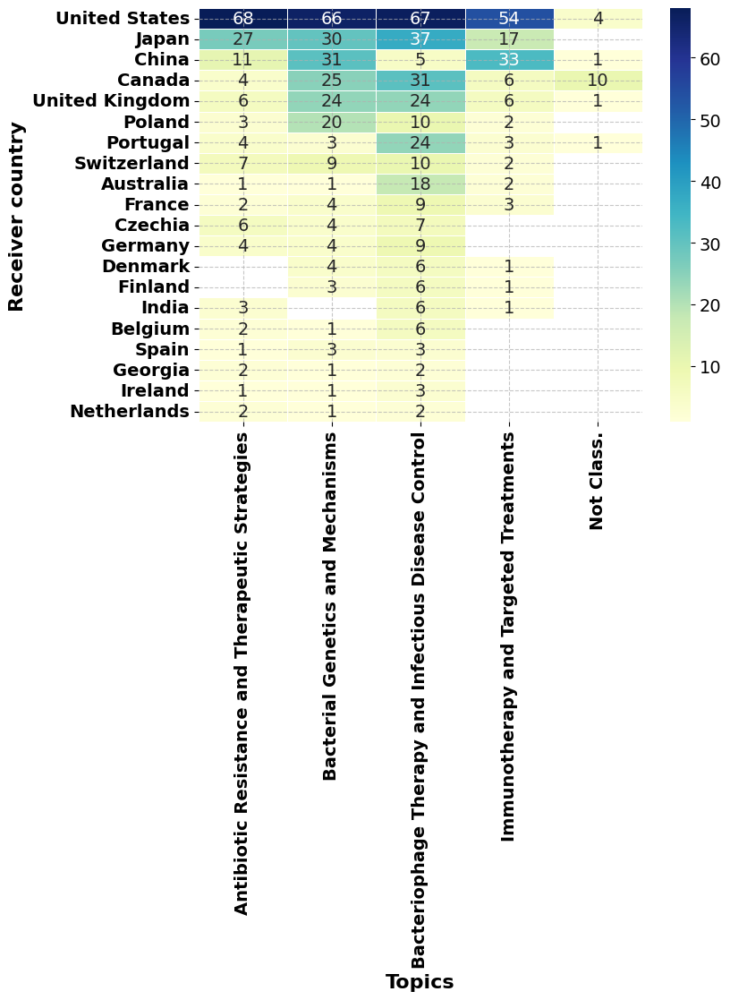

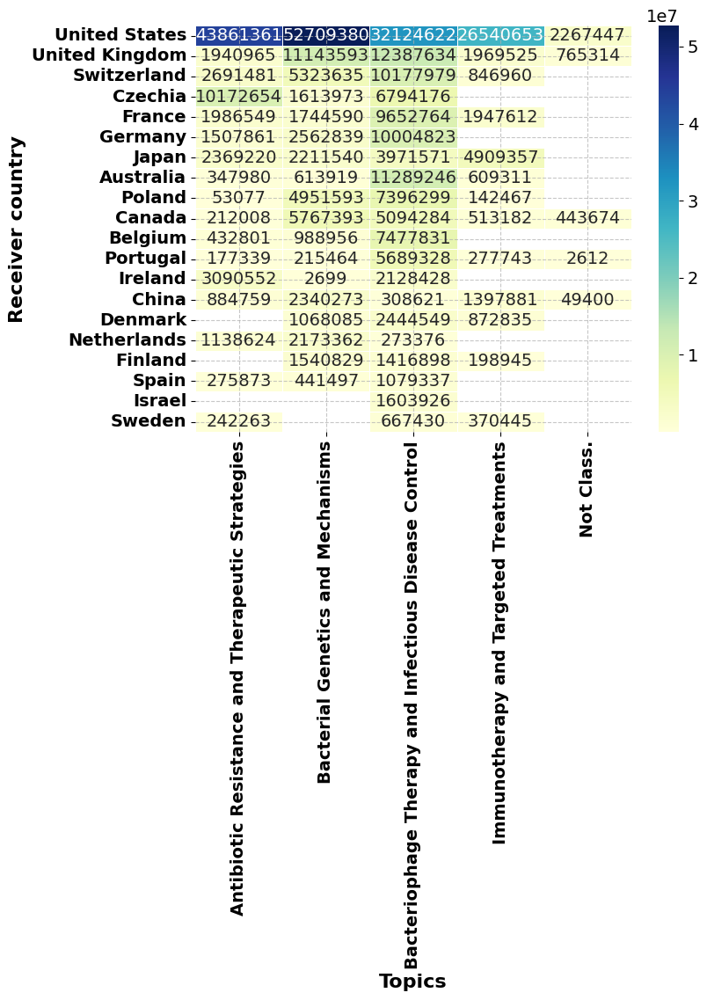

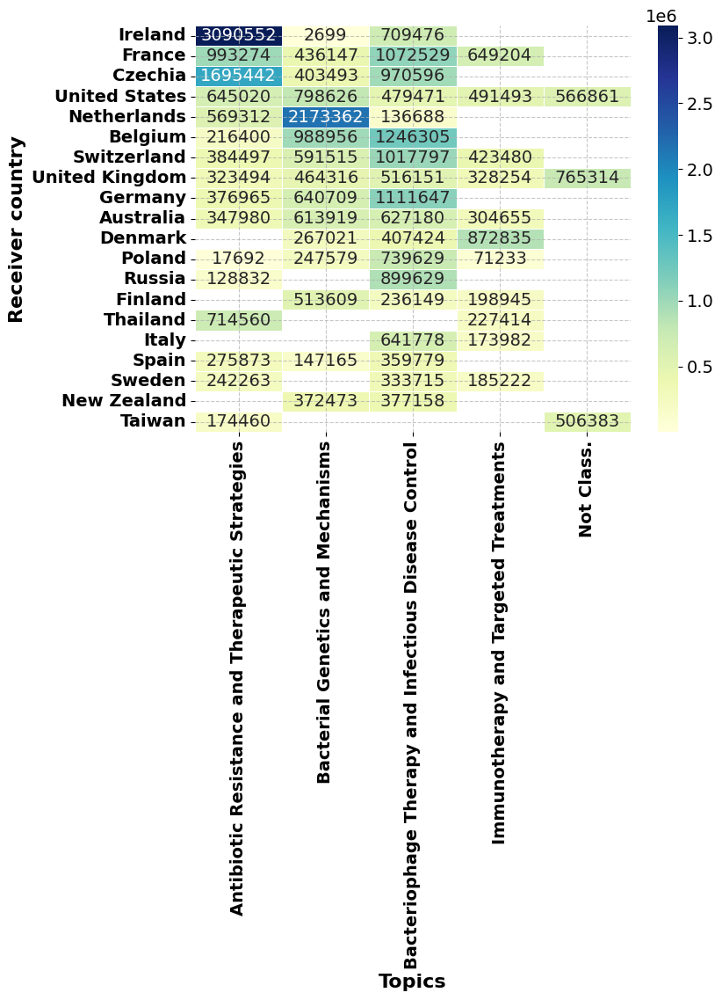

In [ ]:
col_name = 'Receiver - Country of standardized research organization'
xlabel = 'Topics'
ylabel = 'Receiver country'
pivot_df = group_and_pivot_Assignee(col_name,data)
figsize=(8, 6)
n_largest = 20

plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

##  Receiver - Type

The number of unique Assignee is: 8


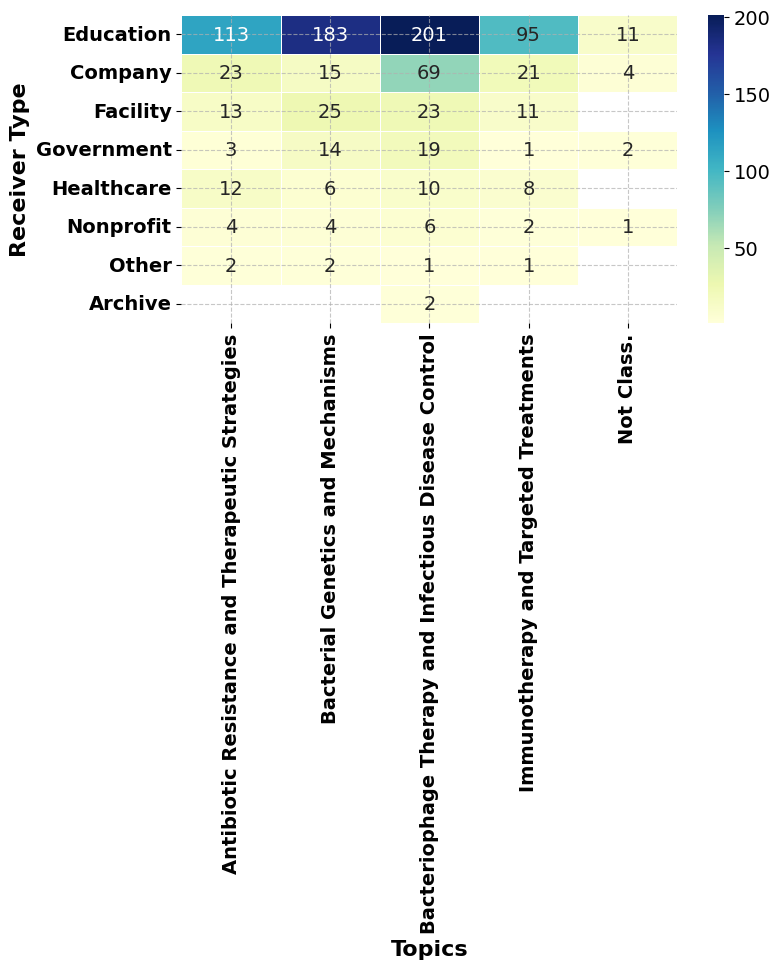

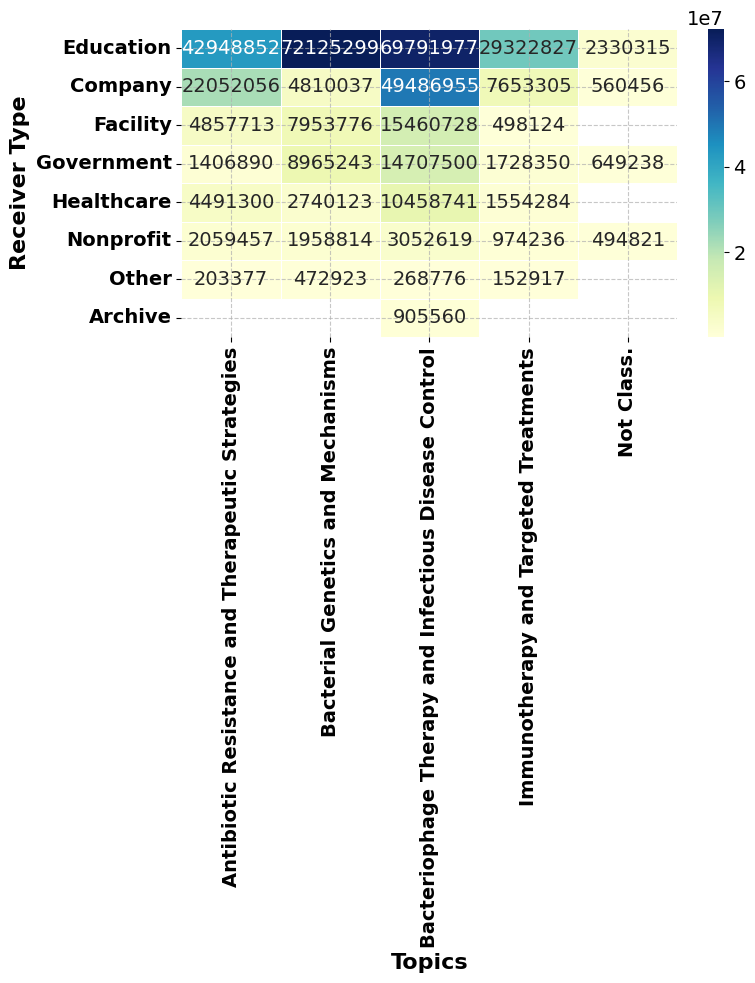

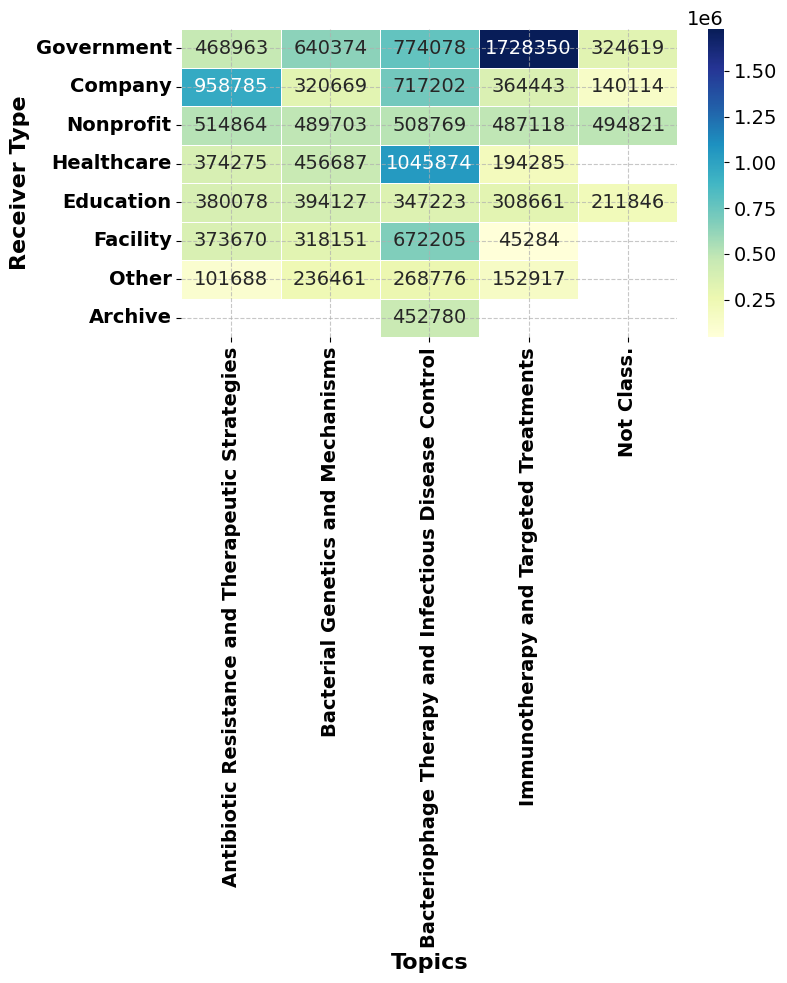

In [ ]:
col_name = 'Receiver - Type of standardized research organization'
xlabel = 'Topics'
ylabel = 'Receiver Type'
pivot_df = group_and_pivot_Assignee(col_name,data)
figsize=(8, 4)
n_largest = 20

plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df

Average Funding amount in USD  \
Topic N°                                           Antibiotic Resistance and Therapeutic Strategies   
Receiver - Type of standardized research organi...                                                    
Archive                                                                                         NaN   
Company                                                                               958785.043478   
Education                                                                             380078.336283   
Facility                                                                              373670.230769   
Government                                                                            468963.333333   
Healthcare                                                                            374275.000000   
Nonprofit                                                                             514864.250000   
Other                                                                                 101688.500000   

                                                                                      \
Topic N°                                           Bacterial Genetics and Mechanisms   
Receiver - Type of standardized research organi...                                     
Archive                                                                          NaN   
Company                                                                320669.133333   
Education                                                              394127.316940   
Facility                                                               318151.040000   
Government                                                             640374.500000   
Healthcare                                                             456687.166667   
Nonprofit                                                              489703.500000   
Other                                                                  236461.500000   

                                                                                                         \
Topic N°                                           Bacteriophage Therapy and Infectious Disease Control   
Receiver - Type of standardized research organi...                                                        
Archive                                                                                  4.527800e+05     
Company                                                                                  7.172022e+05     
Education                                                                                3.472238e+05     
Facility                                                                                 6.722056e+05     
Government                                                                               7.740789e+05     
Healthcare                                                                               1.045874e+06     
Nonprofit                                                                                5.087698e+05     
Other                                                                                    2.687760e+05     

                                                                                          \
Topic N°                                           Immunotherapy and Targeted Treatments   
Receiver - Type of standardized research organi...                                         
Archive                                                                              NaN   
Company                                                                     3.644431e+05   
Education                                                                   3.086613e+05   
Facility                                                                    4.528400e+04   
Government                                                                  1.728350e+06   
Healthcare                                           

##  Research Organization

The number of unique Assignee is: 525


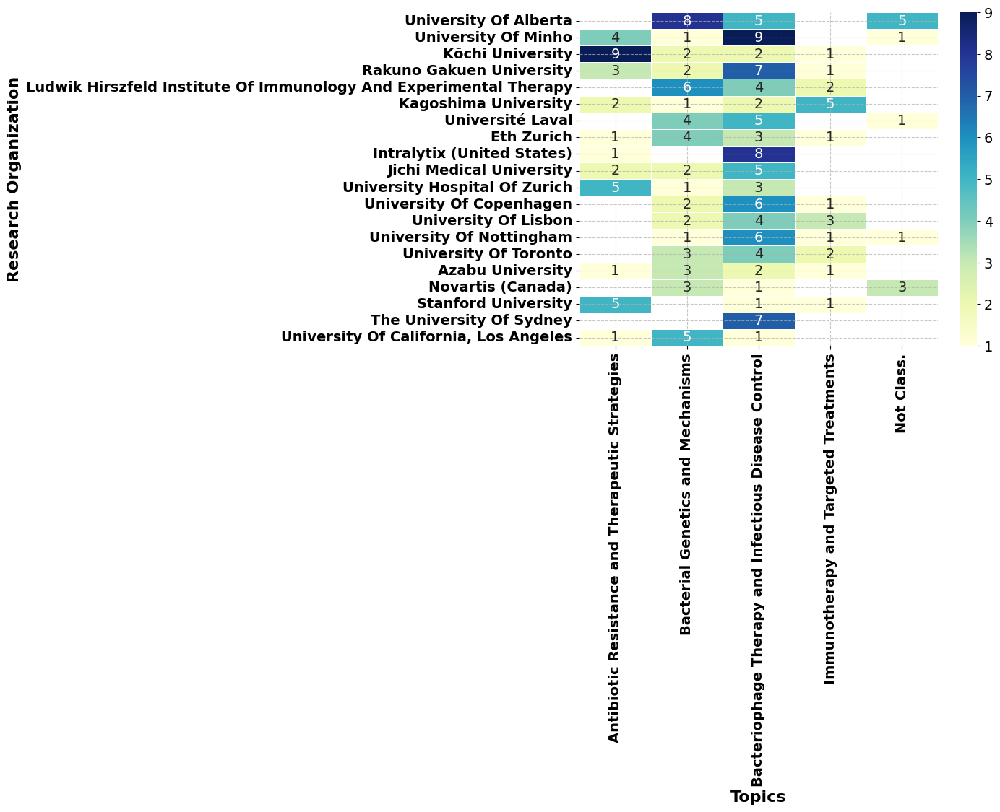

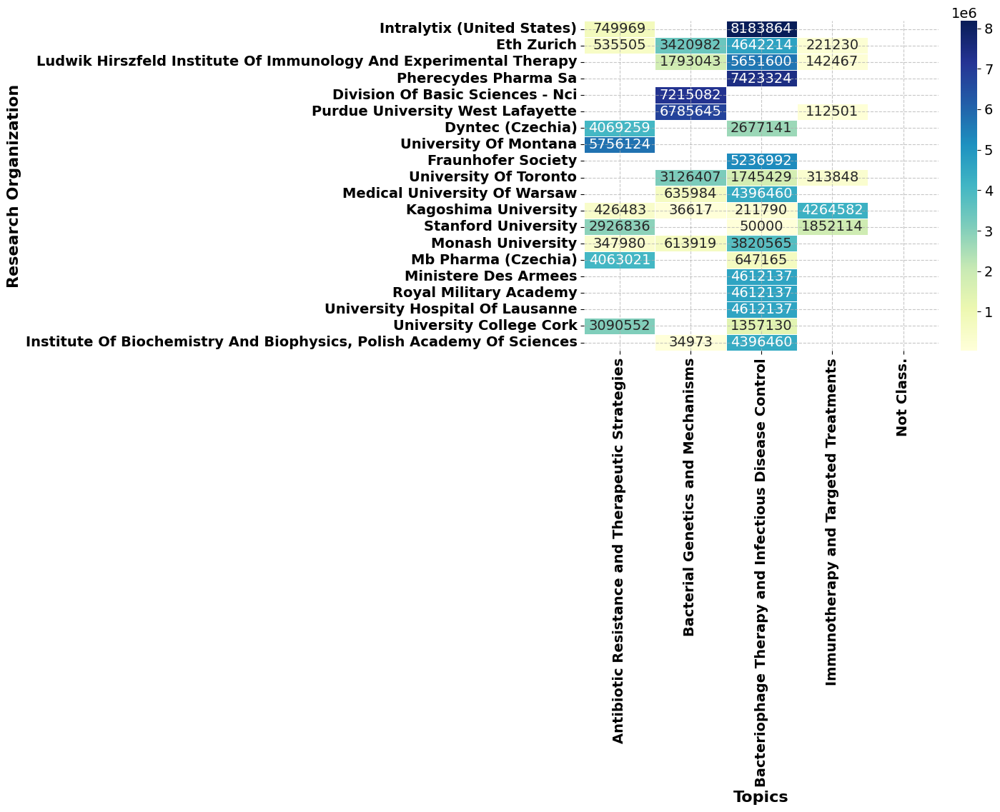

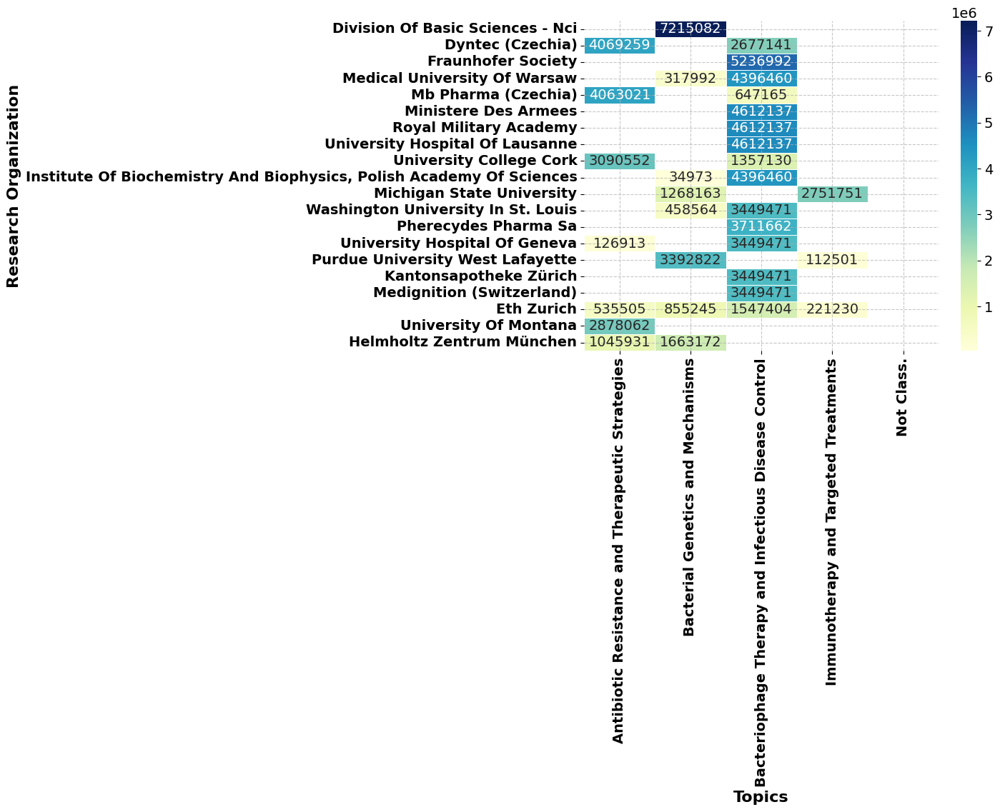

In [ ]:
col_name = 'Research Organization - standardized'
xlabel = 'Topics'
ylabel = 'Research Organization'
pivot_df = group_and_pivot_Assignee(col_name,data)
figsize=(8, 6)
n_largest = 20

plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df

Average Funding amount in USD  \
Topic N°                                           Antibiotic Resistance and Therapeutic Strategies   
Research Organization - standardized                                                                  
Aarhus University                                                                               NaN   
Academy Of Military Medical Sciences                                                            NaN   
Acaduceus Pharmaceutics, Inc.                                                                   NaN   
Adam Mickiewicz University In Poznań                                                            NaN   
Agricultural Development Advisory Service (Unit...                                              NaN   
...                                                                                             ...   
Zhaw Zurich University Of Applied Sciences                                                      NaN   
Zhejiang University                                                                             NaN   
Zunyi Medical University                                                                    32598.0   
Åbo Akademi University                                                                          NaN   
École Polytechnique Fédérale De Lausanne                                                        NaN   

                                                                                      \
Topic N°                                           Bacterial Genetics and Mechanisms   
Research Organization - standardized                                                   
Aarhus University                                                           317593.0   
Academy Of Military Medical Sciences                                         87665.0   
Acaduceus Pharmaceutics, Inc.                                                    NaN   
Adam Mickiewicz University In Poznań                                        176418.0   
Agricultural Development Advisory Service (Unit...                               NaN   
...                                                                              ...   
Zhaw Zurich University Of Applied Sciences                                  751992.0   
Zhejiang University                                                          36318.0   
Zunyi Medical University                                                         NaN   
Åbo Akademi University                                                           NaN   
École Polytechnique Fédérale De Lausanne                                    752254.0   

                                                                                                         \
Topic N°                                           Bacteriophage Therapy and Infectious Disease Control   
Research Organization - standardized                                                                      
Aarhus University                                                                                 NaN     
Academy Of Military Medical Sciences                                                              NaN     
Acaduceus Pharmaceutics, Inc.                                                                     NaN     
Adam Mickiewicz University In Poznań                                                              NaN     
Agricultural Development Advisory Service (Unit...                                                NaN     
...                                                                                               ...     
Zhaw Zurich University Of Applied Sciences                                                   505400.0     
Zhejiang University                                                                               NaN     
Zunyi Medical University                                                                          NaN     
Åbo Akademi University                                                                       217538.0     
Éco

In [ ]:
# index_cols = 'Topic N°'
# split_col = 'Research Organization - standardized'
# top_n_col = 25
# top_n_index = 20
# figsize=(3, 6)
# xlabel = "Topics"
# ylabel = 'Research Organization'

# df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
# plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

##  Funder Country

The number of unique Assignee is: 25


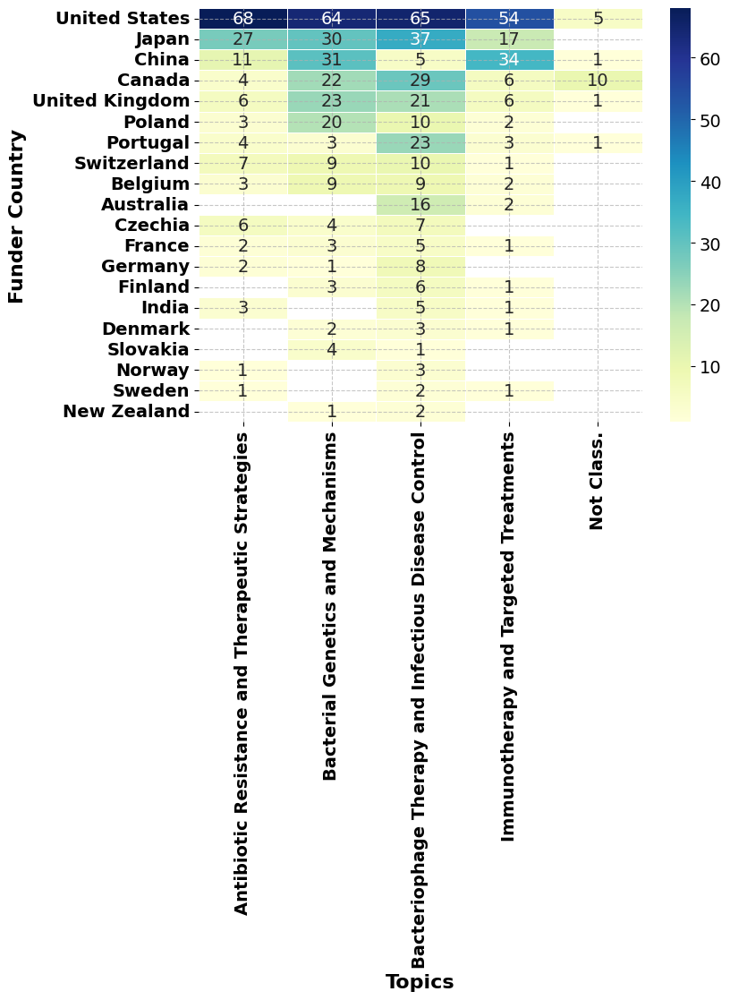

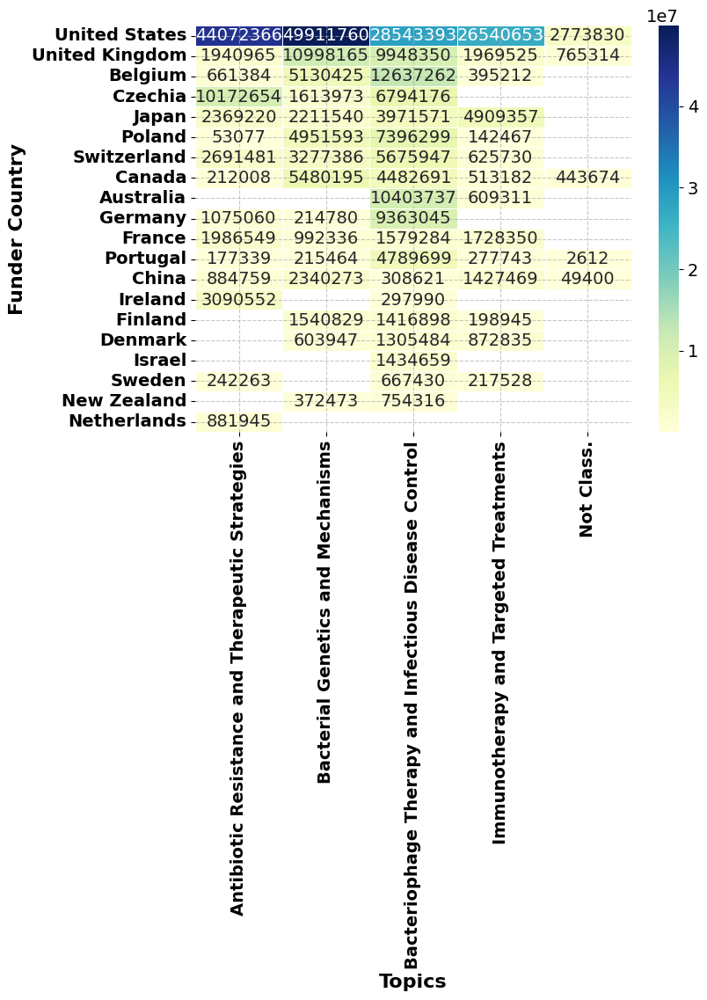

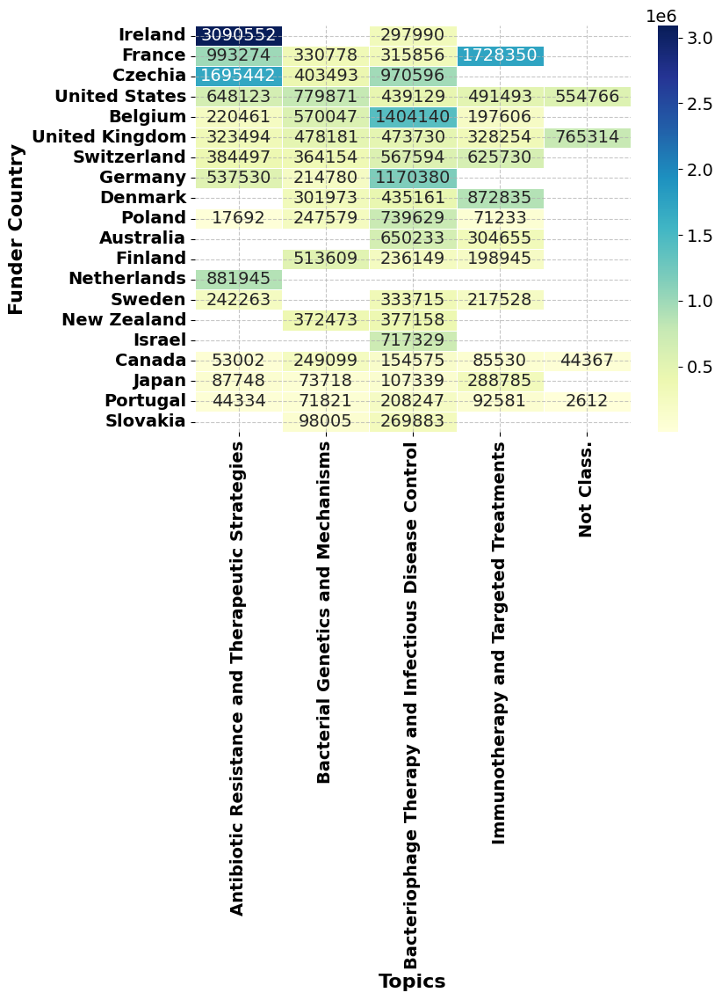

In [ ]:
col_name = 'Funder Country'
xlabel = 'Topics'
ylabel = 'Funder Country'
pivot_df = group_and_pivot_Assignee(col_name,data)
figsize=(8, 6)
n_largest = 20

plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df

Average Funding amount in USD  \
Topic N°       Antibiotic Resistance and Therapeutic Strategies   
Funder Country                                                    
Australia                                                   NaN   
Belgium                                            2.204613e+05   
Canada                                             5.300200e+04   
China                                              8.043264e+04   
Czechia                                            1.695442e+06   
Denmark                                                     NaN   
Finland                                                     NaN   
France                                             9.932745e+05   
Germany                                            5.375300e+05   
India                                              5.276700e+04   
Ireland                                            3.090552e+06   
Israel                                                      NaN   
Japan                                              8.774889e+04   
Latvia                                                      NaN   
Netherlands                                        8.819450e+05   
New Zealand                                                 NaN   
Norway                                             2.050140e+05   
Poland                                             1.769233e+04   
Portugal                                           4.433475e+04   
Slovakia                                                    NaN   
Spain                                                       NaN   
Sweden                                             2.422630e+05   
Switzerland                                        3.844973e+05   
United Kingdom                                     3.234942e+05   
United States                                      6.481230e+05   

                                                  \
Topic N°       Bacterial Genetics and Mechanisms   
Funder Country                                     
Australia                                    NaN   
Belgium                            570047.222222   
Canada                             249099.772727   
China                               75492.677419   
Czechia                            403493.250000   
Denmark                            301973.500000   
Finland                            513609.666667   
France                             330778.666667   
Germany                            214780.000000   
India                                        NaN   
Ireland                                      NaN   
Israel                                       NaN   
Japan                               73718.000000   
Latvia                                       NaN   
Netherlands                                  NaN   
New Zealand                        372473.000000   
Norway                                       NaN   
Poland                             247579.650000   
Portugal                            71821.333333   
Slovakia                            98005.500000   
Spain                               71858.000000   
Sweden                                       NaN   
Switzerland                        364154.000000   
United Kingdom                     478181.086957   
United States                      779871.250000   

                                                                     \
Topic N°       Bacteriophage Therapy and Infectious Disease Control   
Funder Country                                                        
Australia                                            6.502336e+05     
Belgium                                              1.404140e+06     
Canada                                               1.545756e+05     
China                                                6.172420e+04     
Czechia                                              9.705966e+05     
Denmark                                              4.351613e+05     
Finland                                              2.361497

In [ ]:
# index_cols = 'Topic N°'
# split_col = 'Funder Country'
# top_n_col = 25
# top_n_index = 20
# figsize=(3, 6)
# xlabel = "Topics"
# ylabel = "Funder Country"

# pivot_df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
# plot_top_50_heatmap(pivot_df, split_col, top_n_index,  figsize, xlabel, ylabel)
# pivot_df.shape

##  Funder

The number of unique Assignee is: 105


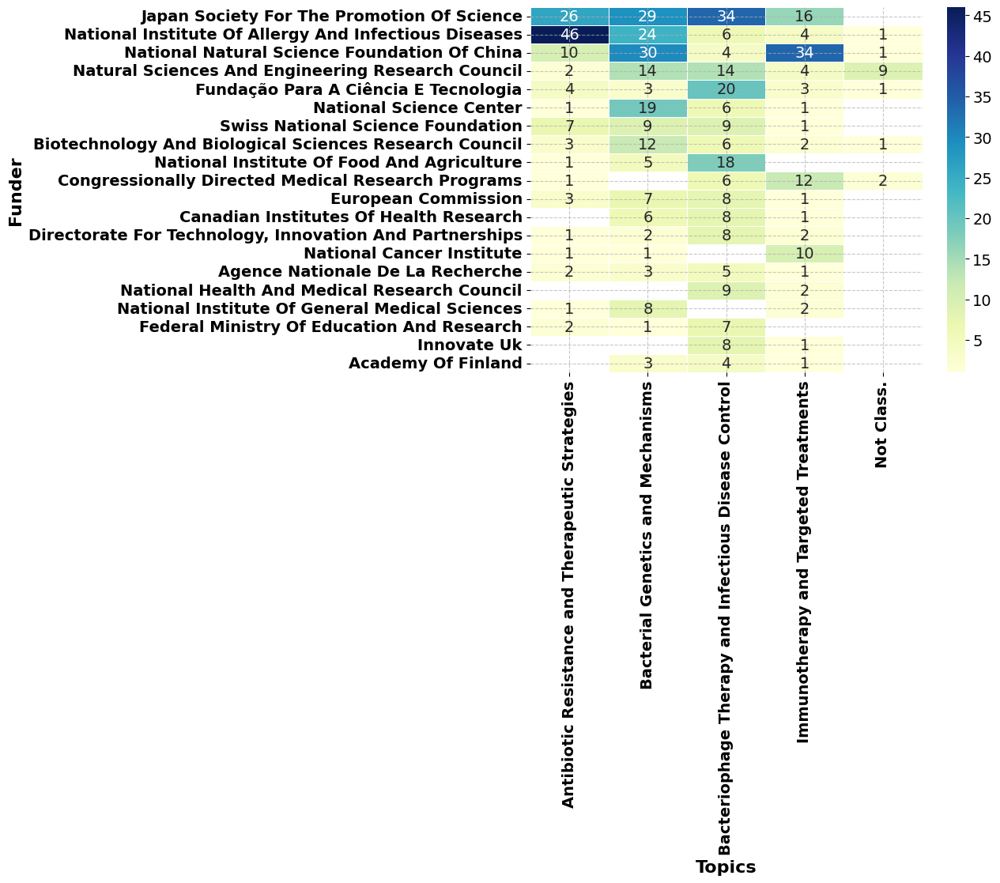

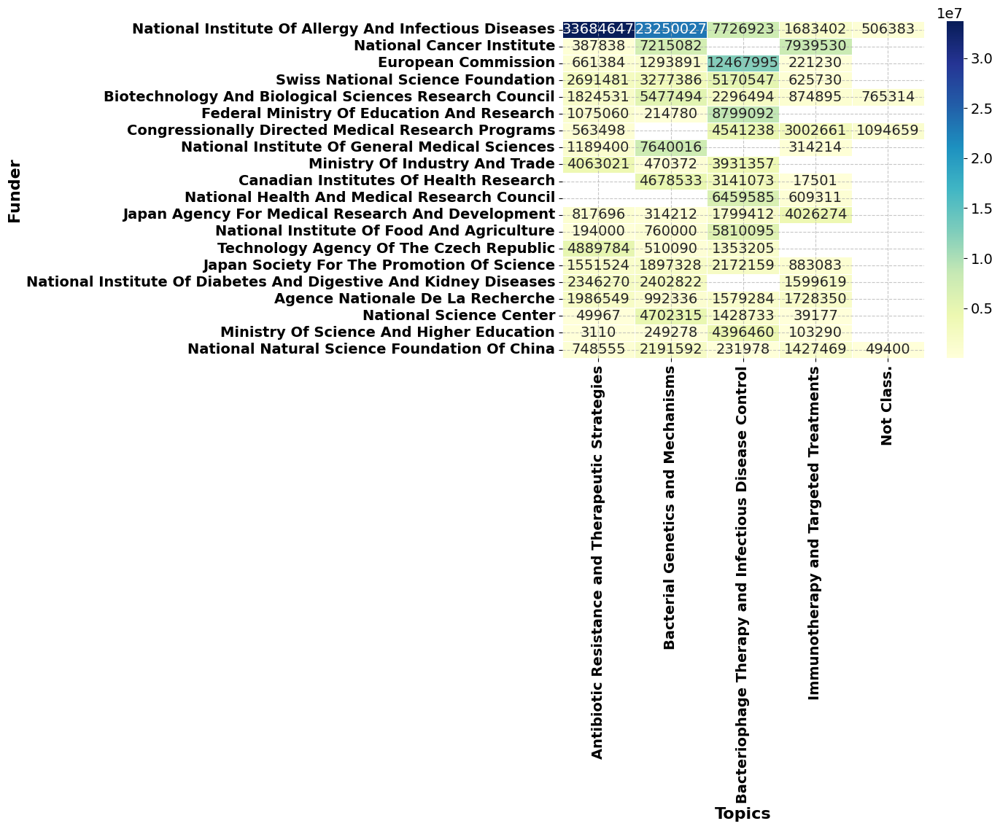

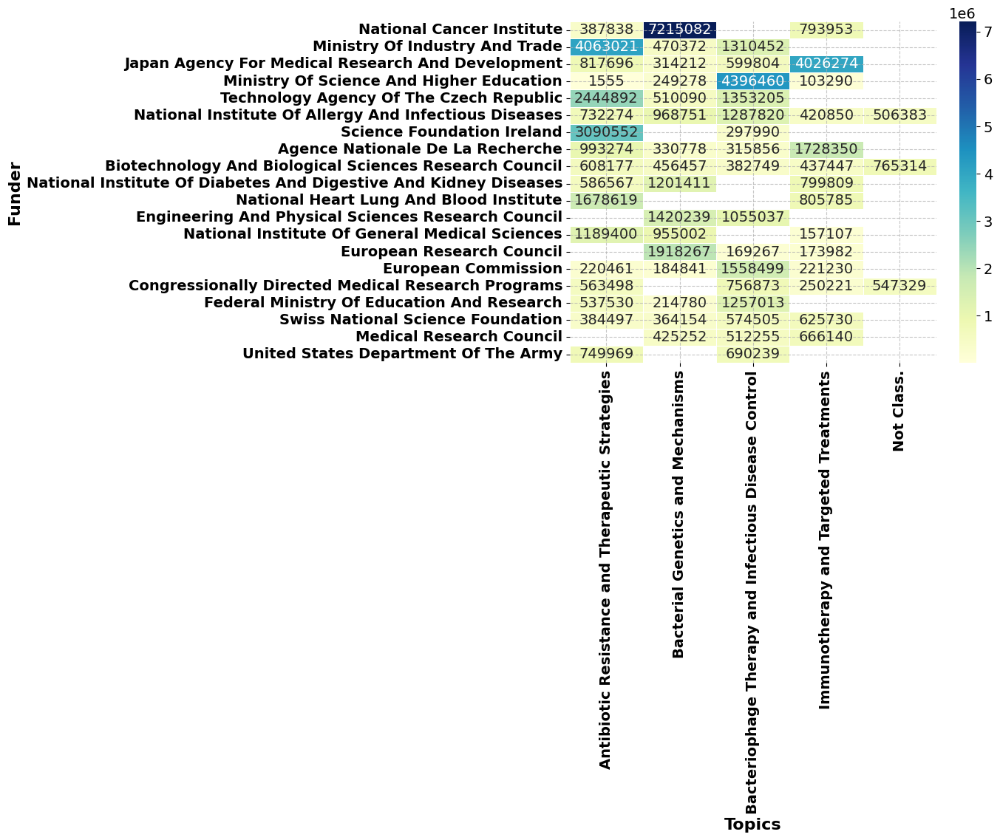

In [ ]:
col_name = 'Funder'
xlabel = 'Topics'
ylabel = 'Funder'
pivot_df = group_and_pivot_Assignee(col_name,data)
figsize=(8, 6)
n_largest = 20

plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df

Average Funding amount in USD  \
Topic N°                                           Antibiotic Resistance and Therapeutic Strategies   
Funder                                                                                                
Academy of Finland                                                                              NaN   
Academy of Medical Sciences                                                                 11057.0   
Agence Nationale de la Recherche                                                           993274.5   
Agência Nacional de Inovação                                                                    NaN   
Alberta Innovates                                                                               NaN   
...                                                                                             ...   
United States Department of the Army                                                       749969.0   
United States Food and Drug Administration                                                      NaN   
United States-Israel Binational Science Foundation                                              NaN   
University Grants Committee                                                                136204.0   
Wellcome Trust                                                                                  NaN   

                                                                                      \
Topic N°                                           Bacterial Genetics and Mechanisms   
Funder                                                                                 
Academy of Finland                                                     513609.666667   
Academy of Medical Sciences                                                      NaN   
Agence Nationale de la Recherche                                       330778.666667   
Agência Nacional de Inovação                                                     NaN   
Alberta Innovates                                                                NaN   
...                                                                              ...   
United States Department of the Army                                             NaN   
United States Food and Drug Administration                                       NaN   
United States-Israel Binational Science Foundation                               NaN   
University Grants Committee                                            148681.000000   
Wellcome Trust                                                         226727.666667   

                                                                                                         \
Topic N°                                           Bacteriophage Therapy and Infectious Disease Control   
Funder                                                                                                    
Academy of Finland                                                                      250481.250000     
Academy of Medical Sciences                                                                       NaN     
Agence Nationale de la Recherche                                                        315856.800000     
Agência Nacional de Inovação                                                            911006.333333     
Alberta Innovates                                                                       343661.000000     
...                                                                                               ...     
United States Department of the Army                                                    690239.500000     
United States Food and Drug Administration                                               90000.000000     
United States-Israel Binational Science Foundation                                      199600.000000     
University Grants Committee                                                              76643.000000     
Wel

In [ ]:
# index_cols = 'Topic N°'
# split_col = 'Funder'
# top_n_col = (20)
# top_n_index = 20
# figsize=(3, 6)
# xlabel = "Topics"
# ylabel = 'Funder'

# df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
# plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

##  Funder Type

The number of unique Assignee is: 4


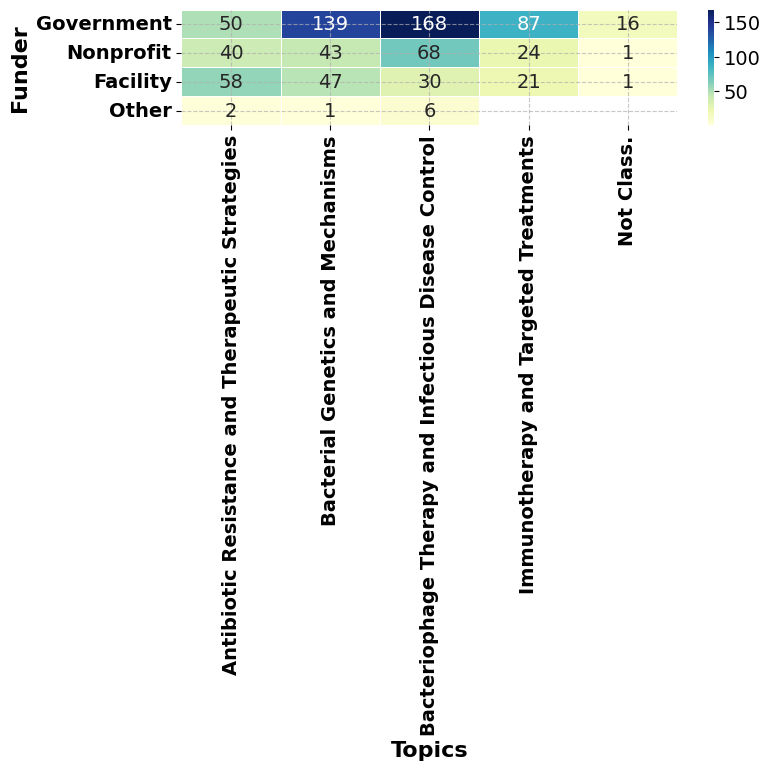

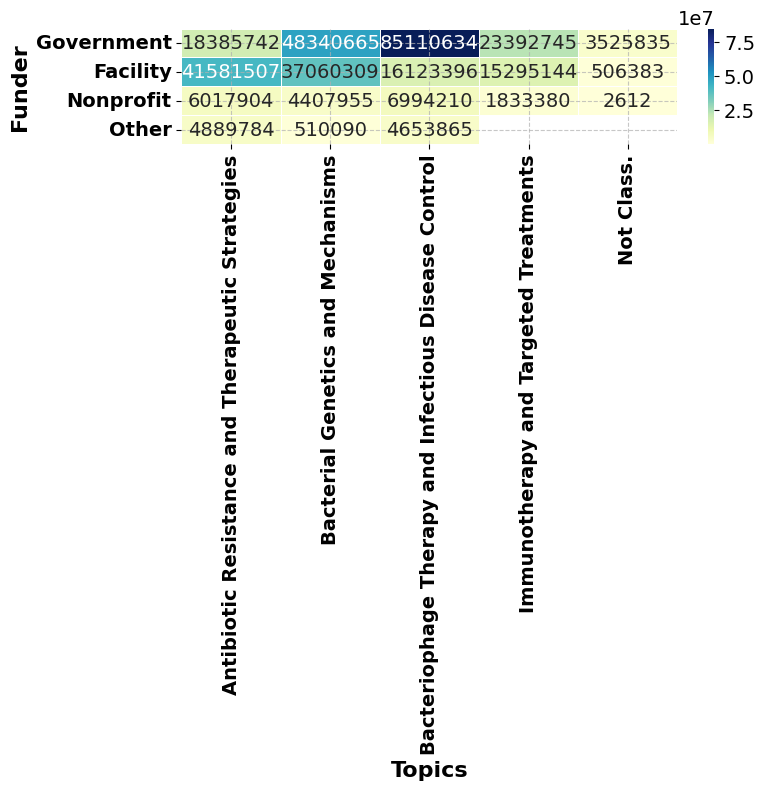

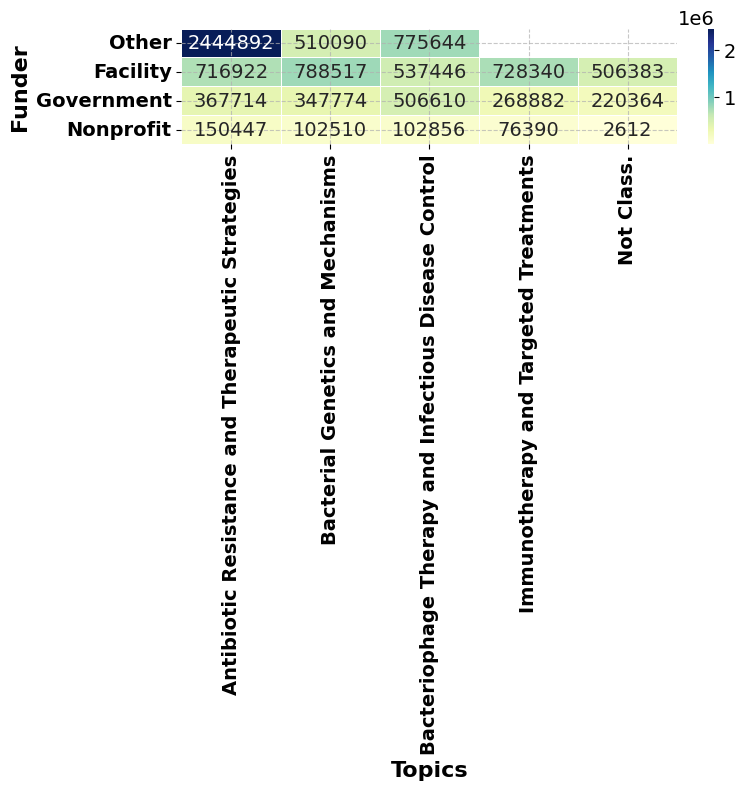

In [ ]:
col_name = 'Funder Type'
xlabel = 'Topics'
ylabel = 'Funder'
pivot_df = group_and_pivot_Assignee(col_name,data)
figsize=(8, 1.5)
n_largest = 20

plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df

Average Funding amount in USD  \
Topic N°    Antibiotic Resistance and Therapeutic Strategies   
Funder Type                                                    
Facility                                        7.169225e+05   
Government                                      3.677148e+05   
Nonprofit                                       1.504476e+05   
Other                                           2.444892e+06   

                                               \
Topic N°    Bacterial Genetics and Mechanisms   
Funder Type                                     
Facility                        788517.212766   
Government                      347774.568345   
Nonprofit                       102510.581395   
Other                           510090.000000   

                                                                  \
Topic N°    Bacteriophage Therapy and Infectious Disease Control   
Funder Type                                                        
Facility                                         537446.533333     
Government                                       506610.916667     
Nonprofit                                        102856.029412     
Other                                            775644.166667     

                                                                \
Topic N°    Immunotherapy and Targeted Treatments   Not Class.   
Funder Type                                                      
Facility                            728340.190476  506383.0000   
Government                          268882.126437  220364.6875   
Nonprofit                            76390.833333    2612.0000   
Other                                         NaN          NaN   

                                 Total Funding amount in USD  \
Topic N°    Antibiotic Resistance and Therapeutic Strategies   
Funder Type                                                    
Facility                                          41581507.0   
Government                                        18385742.0   
Nonprofit                                          6017904.0   
Other                                              4889784.0   

                                               \
Topic N°    Bacterial Genetics and Mechanisms   
Funder Type                                     
Facility                           37060309.0   
Government                         48340665.0   
Nonprofit                           4407955.0   
Other                                510090.0   

                                                                  \
Topic N°    Bacteriophage Therapy and Infectious Disease Control   
Funder Type                                                        
Facility                                            16123396.0     
Government                                          85110634.0     
Nonprofit                                            6994210.0     
Other                                                4653865.0     

                                                              \
Topic N°    Immunotherapy and Targeted Treatments Not Class.   
Funder Type                                                    
Facility                               15295144.0   506383.0   
Government                             23392745.0  3525835.0   
Nonprofit                               1833380.0     2612.0   
Other                                         NaN        NaN   

                                                 Total Grant  \
Topic N°    Antibiotic Resistance and Therapeutic Strategies   
Funder Type                                                    
Facility                                                58.0   
Government                                              50.0   
Nonprofit                                               40.0   
Other                                                    2.0   

                                               \
Topic N°    Bacterial Genetics and Mechanisms   
Funder Type                     

##  Funder Region

The number of unique Assignee is: 4


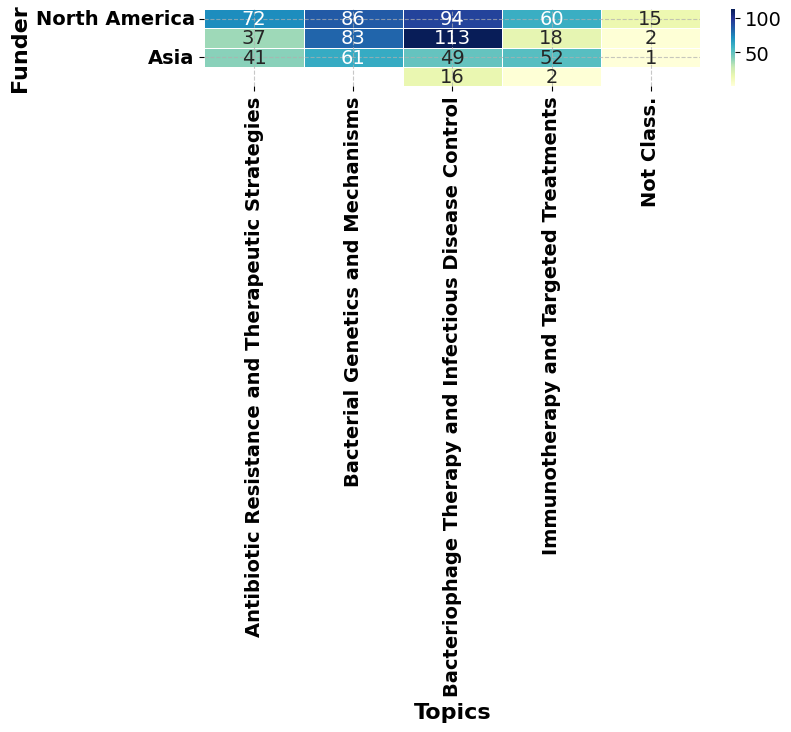

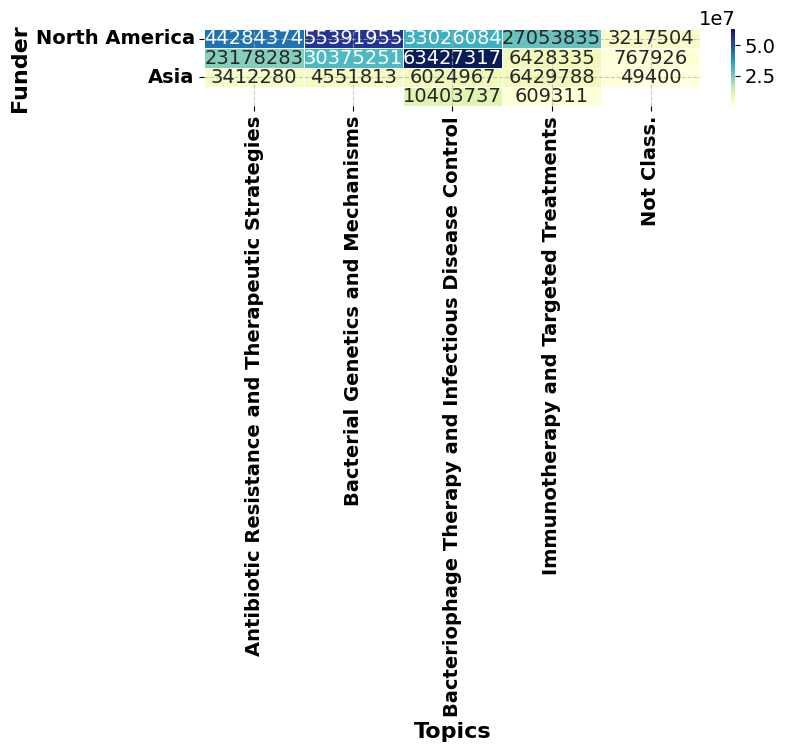

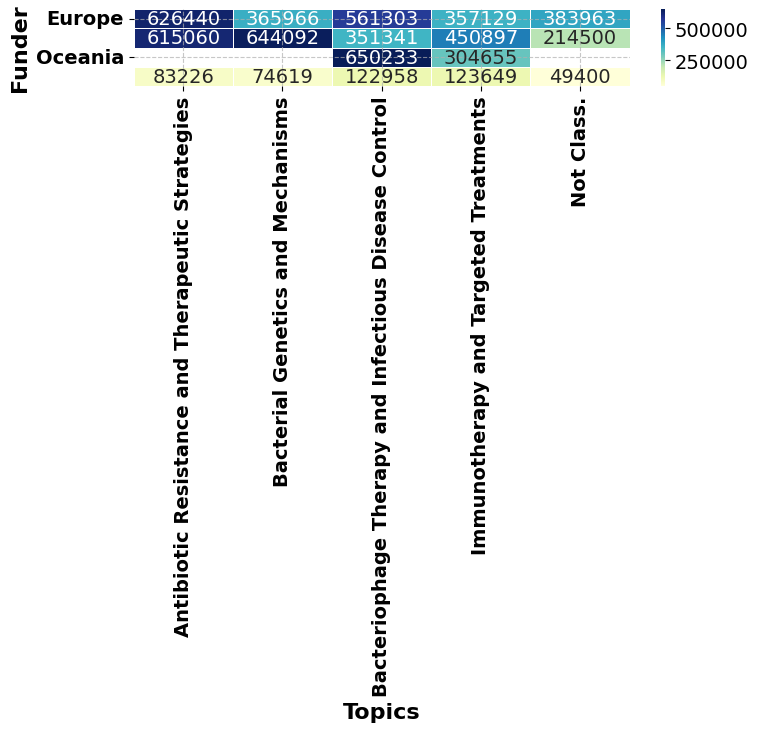

In [ ]:
col_name = 'Funder Region'
xlabel = 'Topics'
ylabel = 'Funder'
pivot_df = group_and_pivot_Assignee(col_name,data)
figsize=(8, 1)
n_largest = 20

plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df

Average Funding amount in USD  \
Topic N°      Antibiotic Resistance and Therapeutic Strategies   
Funder Region                                                    
Asia                                              83226.341463   
Europe                                           626440.081081   
North America                                    615060.750000   
Oceania                                                    NaN   

                                                 \
Topic N°      Bacterial Genetics and Mechanisms   
Funder Region                                     
Asia                               74619.885246   
Europe                            365966.879518   
North America                     644092.500000   
Oceania                                     NaN   

                                                                    \
Topic N°      Bacteriophage Therapy and Infectious Disease Control   
Funder Region                                                        
Asia                                               122958.510204     
Europe                                             561303.690265     
North America                                      351341.319149     
Oceania                                            650233.562500     

                                                                    \
Topic N°      Immunotherapy and Targeted Treatments     Not Class.   
Funder Region                                                        
Asia                                  123649.769231   49400.000000   
Europe                                357129.722222  383963.000000   
North America                         450897.250000  214500.266667   
Oceania                               304655.500000            NaN   

                                   Total Funding amount in USD  \
Topic N°      Antibiotic Resistance and Therapeutic Strategies   
Funder Region                                                    
Asia                                                 3412280.0   
Europe                                              23178283.0   
North America                                       44284374.0   
Oceania                                                    NaN   

                                                 \
Topic N°      Bacterial Genetics and Mechanisms   
Funder Region                                     
Asia                                  4551813.0   
Europe                               30375251.0   
North America                        55391955.0   
Oceania                                     NaN   

                                                                    \
Topic N°      Bacteriophage Therapy and Infectious Disease Control   
Funder Region                                                        
Asia                                                   6024967.0     
Europe                                                63427317.0     
North America                                         33026084.0     
Oceania                                               10403737.0     

                                                                \
Topic N°      Immunotherapy and Targeted Treatments Not Class.   
Funder Region                                                    
Asia                                      6429788.0    49400.0   
Europe                                    6428335.0   767926.0   
North America                            27053835.0  3217504.0   
Oceania                                    609311.0        NaN   

                                                   Total Grant  \
Topic N°      Antibiotic Resistance and Therapeutic Strategies   
Funder Region                                                    
Asia                                                      41.0   
Europe                                                    37.0   
North America                                             72.0   
Oceania                                                    

##  Funder Income group

The number of unique Assignee is: 3


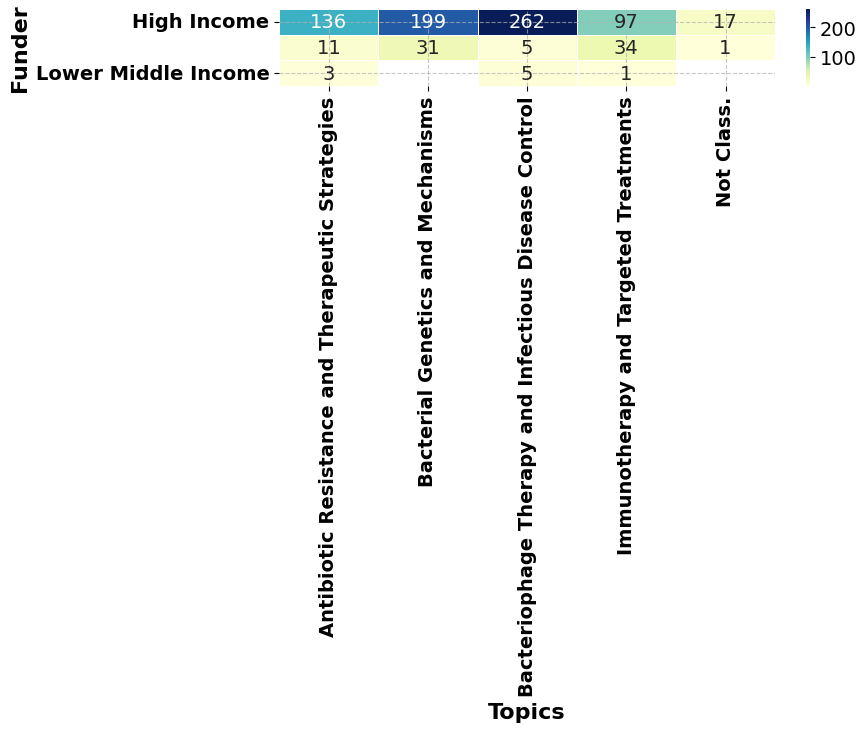

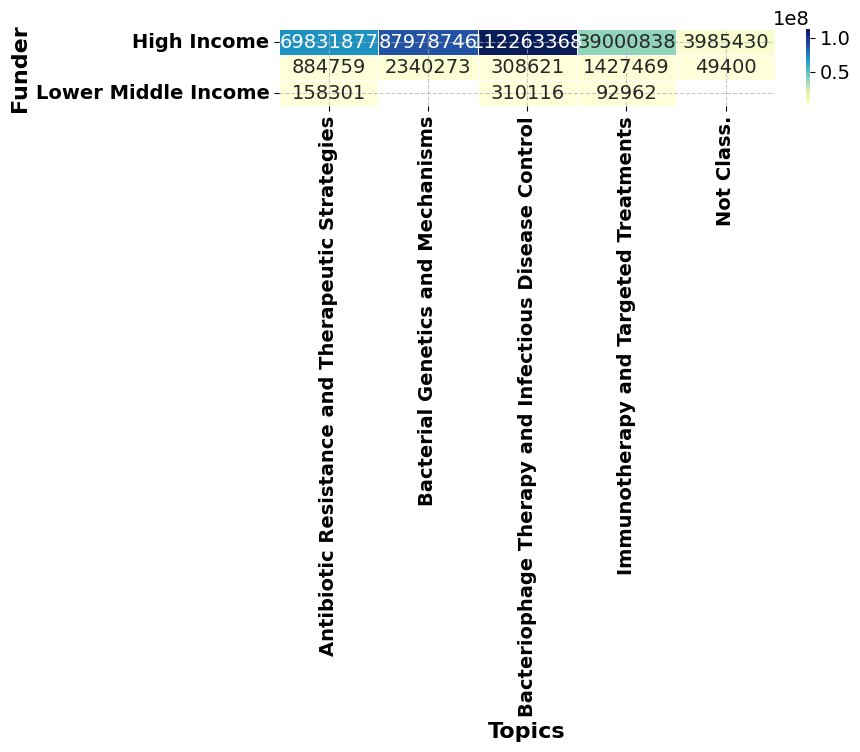

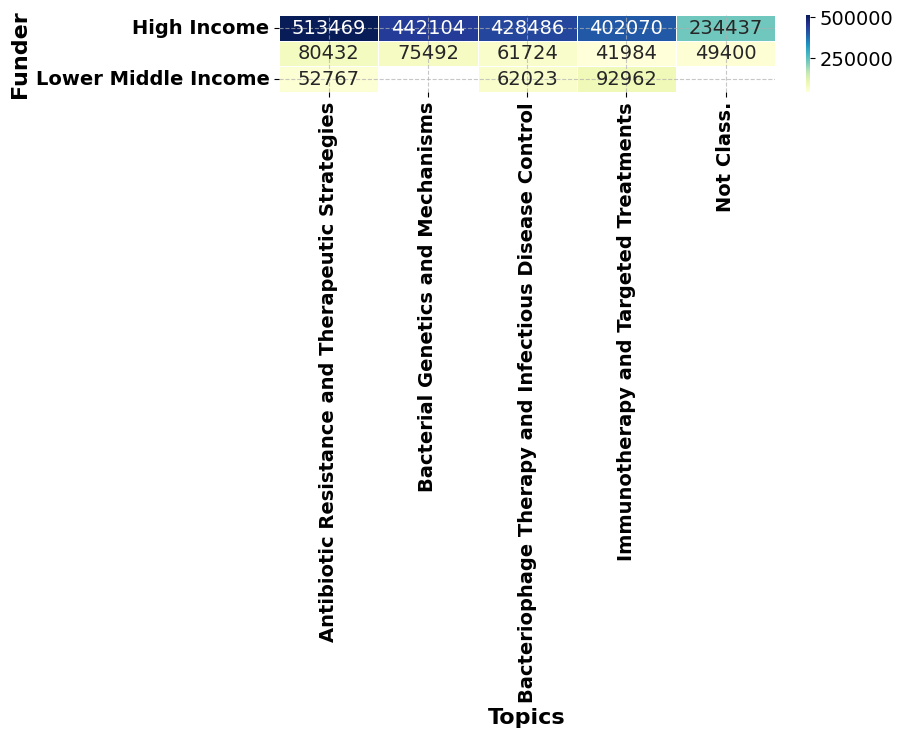

In [ ]:
col_name = 'Funder Income group'
xlabel = 'Topics'
ylabel = 'Funder'
pivot_df = group_and_pivot_Assignee(col_name,data)
figsize=(8, 1)
n_largest = 20

plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df

Average Funding amount in USD  \
Topic N°            Antibiotic Resistance and Therapeutic Strategies   
Funder Income group                                                    
High income                                            513469.683824   
Lower middle income                                     52767.000000   
Upper middle income                                     80432.636364   

                                                       \
Topic N°            Bacterial Genetics and Mechanisms   
Funder Income group                                     
High income                             442104.251256   
Lower middle income                               NaN   
Upper middle income                      75492.677419   

                                                                          \
Topic N°            Bacteriophage Therapy and Infectious Disease Control   
Funder Income group                                                        
High income                                              428486.137405     
Lower middle income                                       62023.200000     
Upper middle income                                       61724.200000     

                                                                          \
Topic N°            Immunotherapy and Targeted Treatments     Not Class.   
Funder Income group                                                        
High income                                 402070.494845  234437.058824   
Lower middle income                          92962.000000            NaN   
Upper middle income                          41984.382353   49400.000000   

                                         Total Funding amount in USD  \
Topic N°            Antibiotic Resistance and Therapeutic Strategies   
Funder Income group                                                    
High income                                               69831877.0   
Lower middle income                                         158301.0   
Upper middle income                                         884759.0   

                                                       \
Topic N°            Bacterial Genetics and Mechanisms   
Funder Income group                                     
High income                                87978746.0   
Lower middle income                               NaN   
Upper middle income                         2340273.0   

                                                                          \
Topic N°            Bacteriophage Therapy and Infectious Disease Control   
Funder Income group                                                        
High income                                                112263368.0     
Lower middle income                                           310116.0     
Upper middle income                                           308621.0     

                                                                      \
Topic N°            Immunotherapy and Targeted Treatments Not Class.   
Funder Income group                                                    
High income                                    39000838.0  3985430.0   
Lower middle income                               92962.0        NaN   
Upper middle income                             1427469.0    49400.0   

                                                         Total Grant  \
Topic N°            Antibiotic Resistance and Therapeutic Strategies   
Funder Income group                                                    
High income                                                    136.0   
Lower middle income                                              3.0   
Upper middle income                                             11.0   

                                                       \
Topic N°            Bacterial Genetics and Mechanisms   
Funder Income group                                     
High income                                     199.0   
Lower middle income   

##  funder Global north - south

The number of unique Assignee is: 2


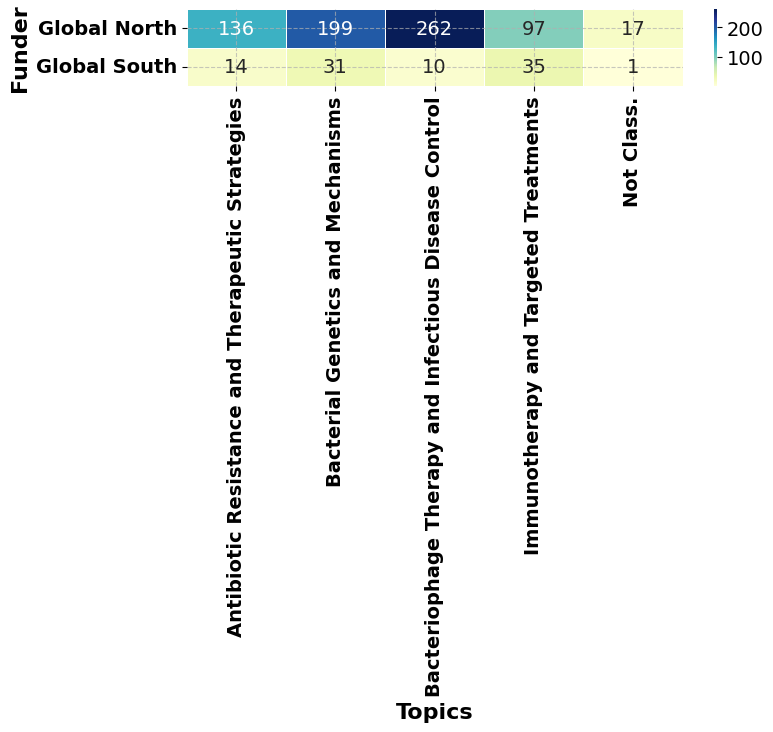

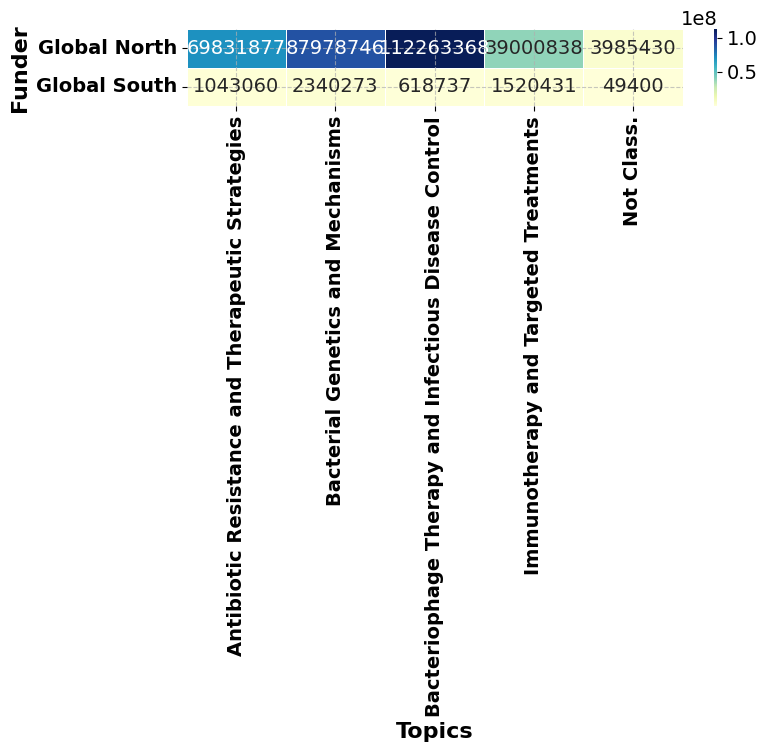

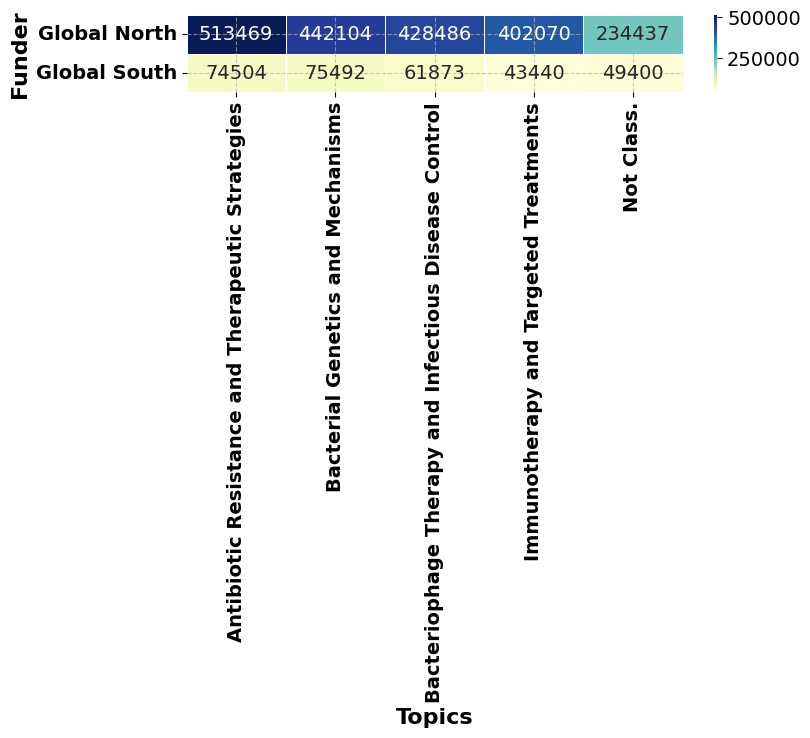

In [ ]:
col_name = 'funder Global north - south'
xlabel = 'Topics'
ylabel = 'Funder'
pivot_df = group_and_pivot_Assignee(col_name,data)
figsize=(8, 1)
n_largest = 20

plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df

Average Funding amount in USD  \
Topic N°                    Antibiotic Resistance and Therapeutic Strategies   
funder Global north - south                                                    
Global North                                                   513469.683824   
Global South                                                    74504.285714   

                                                               \
Topic N°                    Bacterial Genetics and Mechanisms   
funder Global north - south                                     
Global North                                    442104.251256   
Global South                                     75492.677419   

                                                                                  \
Topic N°                    Bacteriophage Therapy and Infectious Disease Control   
funder Global north - south                                                        
Global North                                                     428486.137405     
Global South                                                      61873.700000     

                                                                   \
Topic N°                    Immunotherapy and Targeted Treatments   
funder Global north - south                                         
Global North                                        402070.494845   
Global South                                         43440.885714   

                                            \
Topic N°                        Not Class.   
funder Global north - south                  
Global North                 234437.058824   
Global South                  49400.000000   

                                                 Total Funding amount in USD  \
Topic N°                    Antibiotic Resistance and Therapeutic Strategies   
funder Global north - south                                                    
Global North                                                        69831877   
Global South                                                         1043060   

                                                               \
Topic N°                    Bacterial Genetics and Mechanisms   
funder Global north - south                                     
Global North                                         87978746   
Global South                                          2340273   

                                                                                  \
Topic N°                    Bacteriophage Therapy and Infectious Disease Control   
funder Global north - south                                                        
Global North                                                         112263368     
Global South                                                            618737     

                                                                              \
Topic N°                    Immunotherapy and Targeted Treatments Not Class.   
funder Global north - south                                                    
Global North                                             39000838    3985430   
Global South                                              1520431      49400   

                                                                 Total Grant  \
Topic N°                    Antibiotic Resistance and Therapeutic Strategies   
funder Global north - south                                                    
Global North                                                             136   
Global South                                                              14   

                                                               \
Topic N°                    Bacterial Genetics and Mechanisms   
funder Global north - south                                     
Global North                                              199   
Global South                                               31   

                                              

The number of unique Assignee is: 105


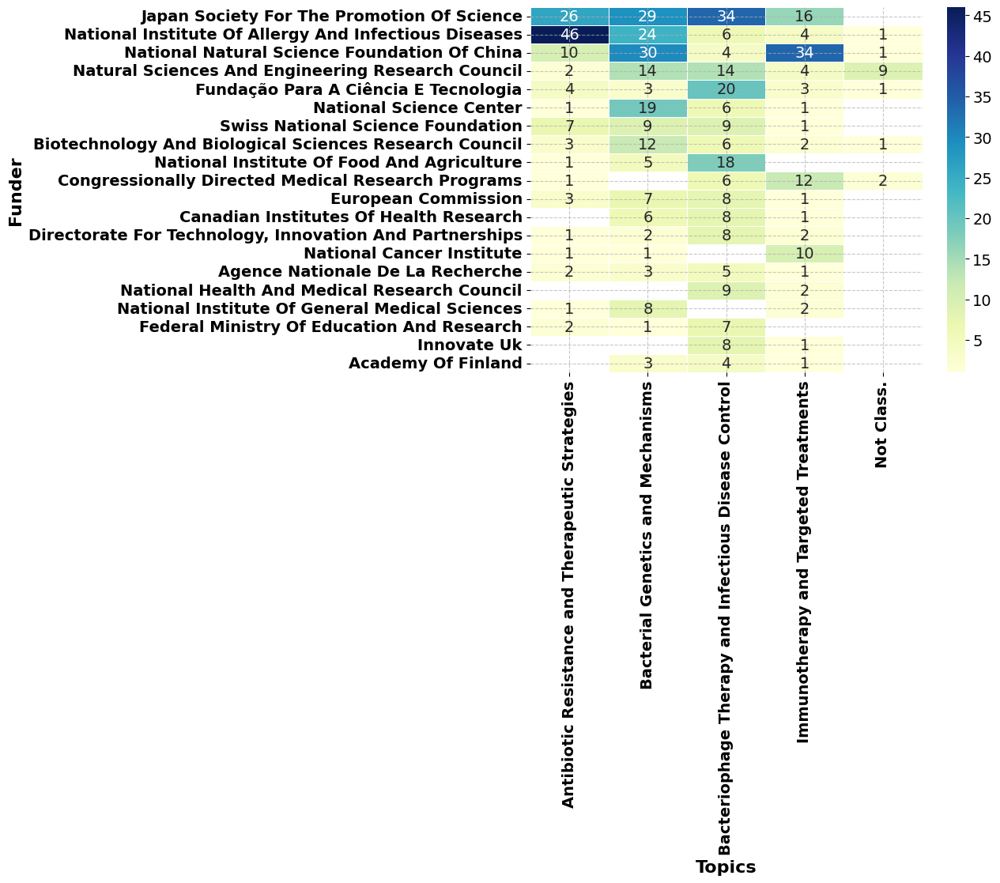

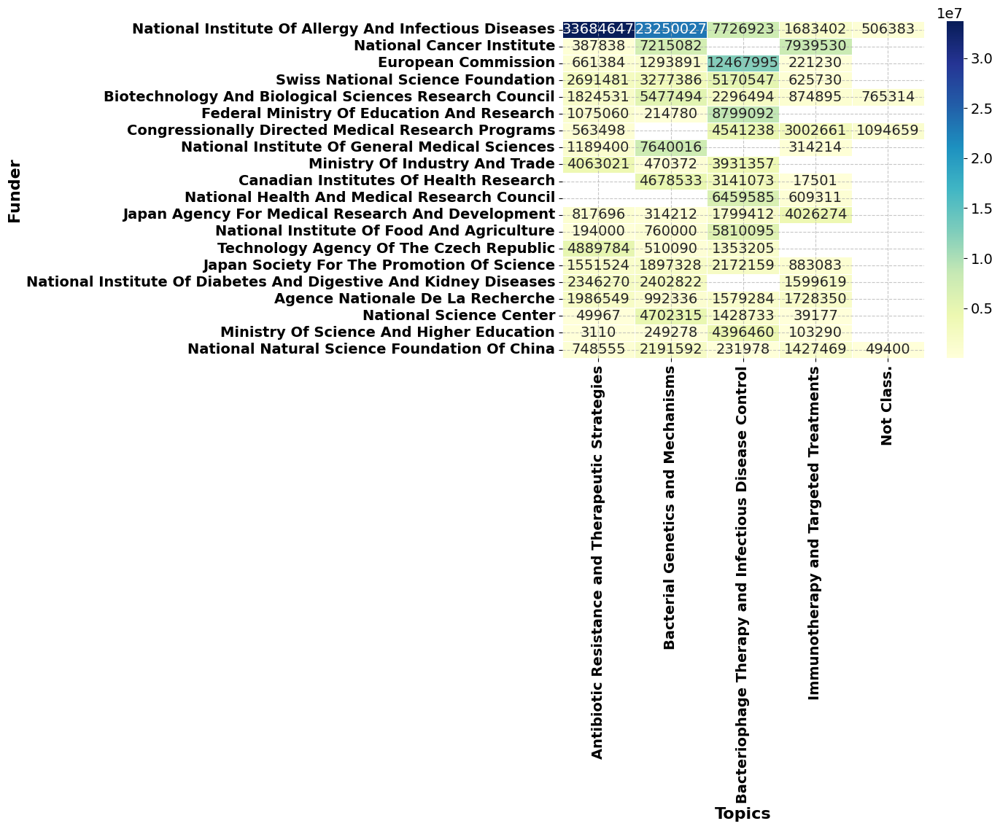

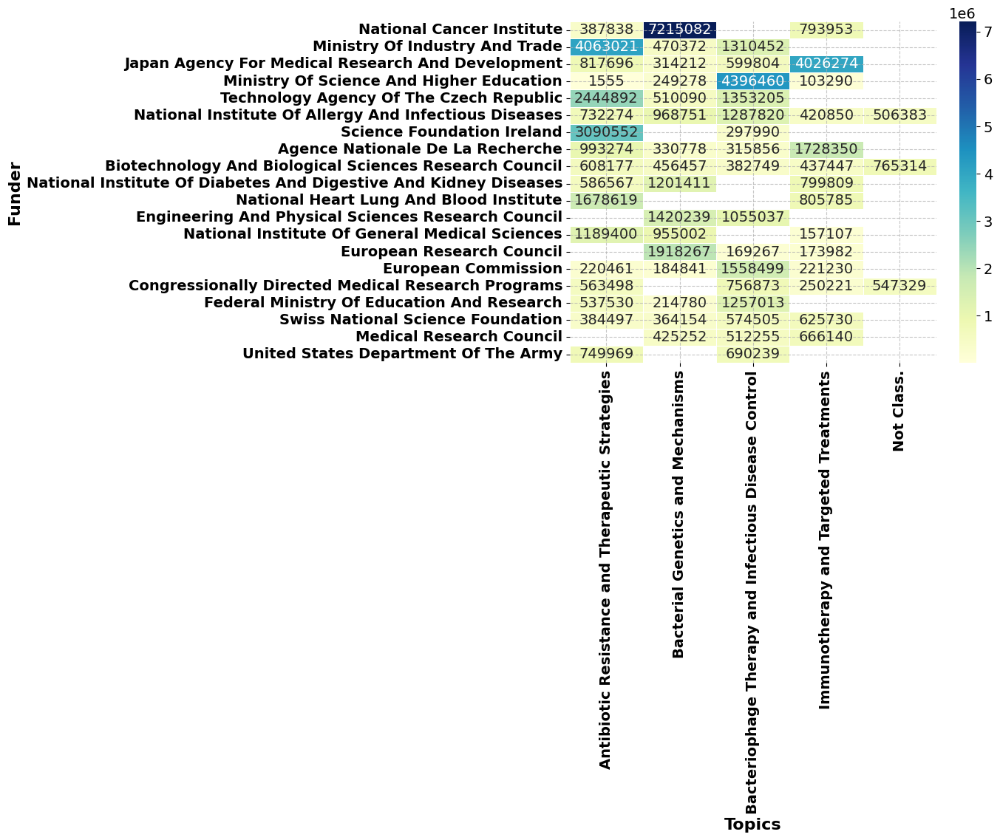

In [ ]:
col_name = 'Funder'
xlabel = 'Topics'
ylabel = 'Funder'
pivot_df = group_and_pivot_Assignee(col_name,data)
figsize=(8, 6)
n_largest = 20

plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

## Receiver - Region of standardized research organization

The number of unique Assignee is: 6


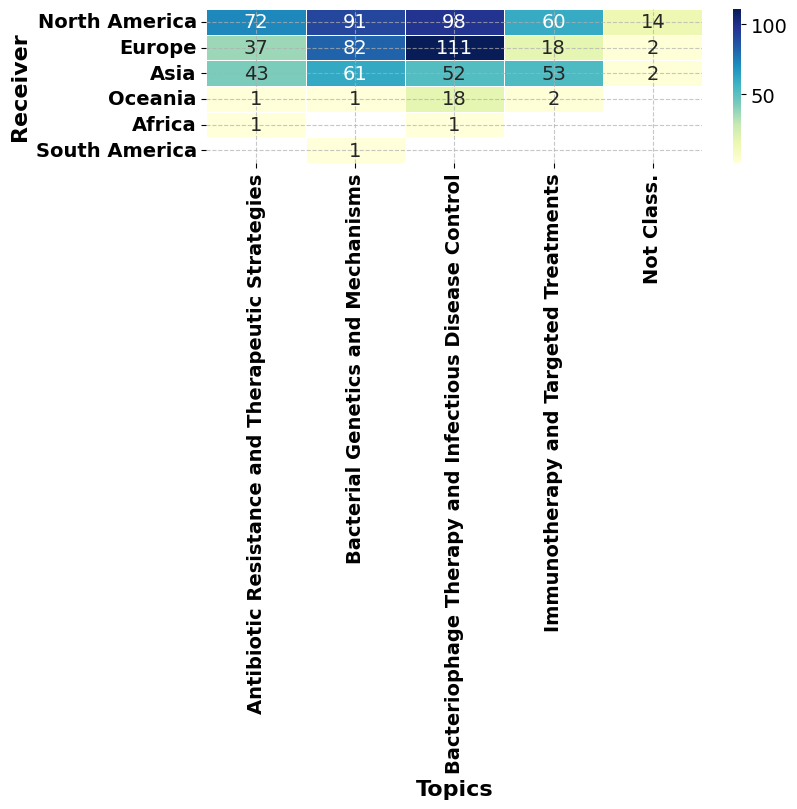

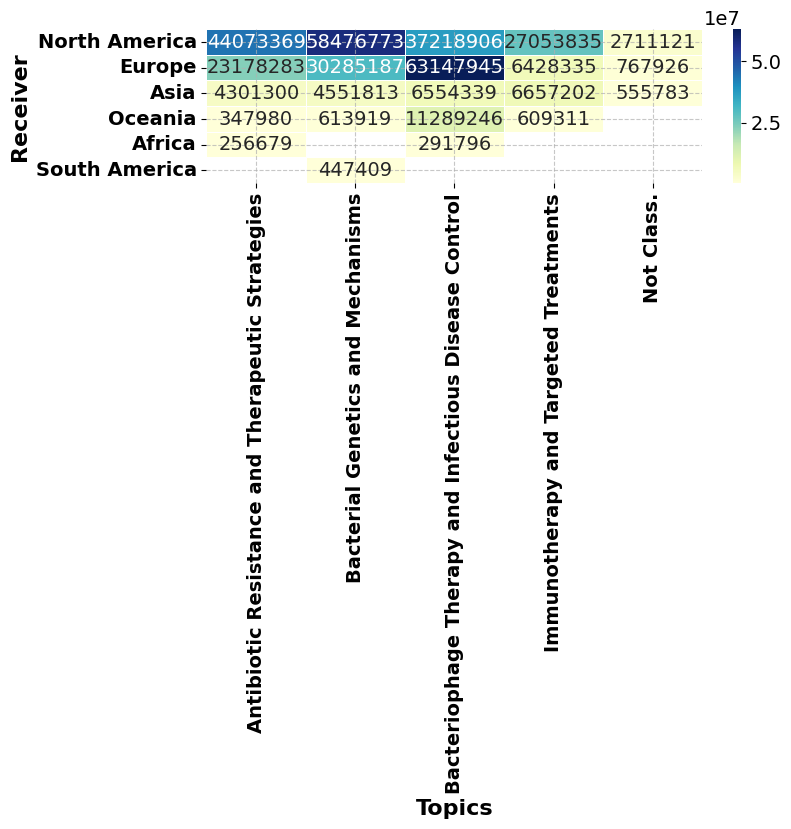

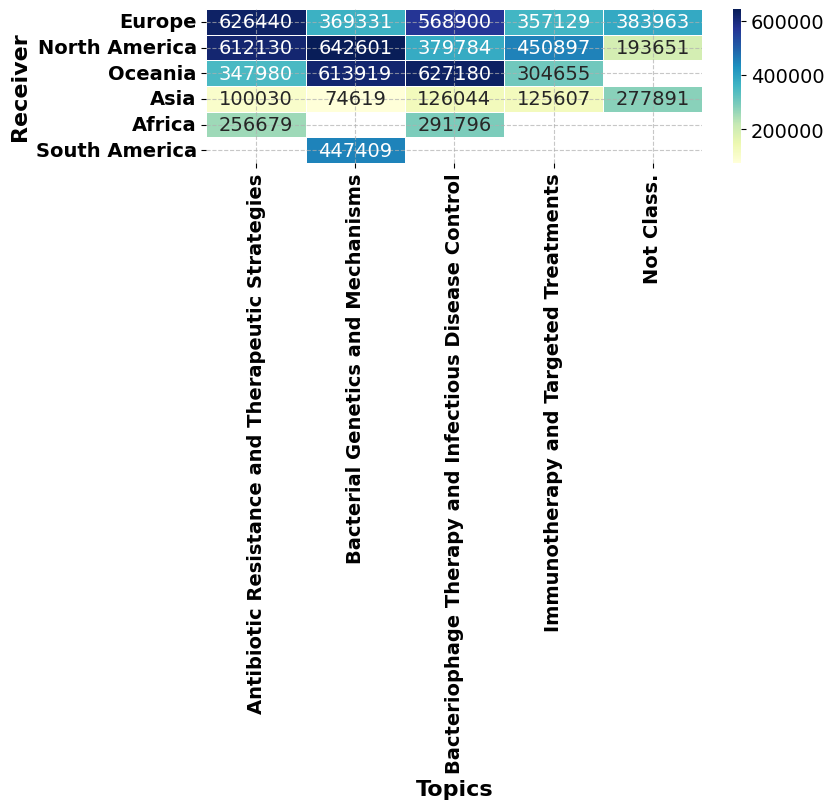

In [ ]:
col_name = 'Receiver - Region of standardized research organization'
xlabel = 'Topics'
ylabel = 'Receiver'
pivot_df = group_and_pivot_Assignee(col_name,data)
figsize=(8, 2)
n_largest = 20

plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df

Average Funding amount in USD  \
Topic N°                                           Antibiotic Resistance and Therapeutic Strategies   
Receiver - Region of standardized research orga...                                                    
Africa                                                                                256679.000000   
Asia                                                                                  100030.232558   
Europe                                                                                626440.081081   
North America                                                                         612130.125000   
Oceania                                                                               347980.000000   
South America                                                                                   NaN   

                                                                                      \
Topic N°                                           Bacterial Genetics and Mechanisms   
Receiver - Region of standardized research orga...                                     
Africa                                                                           NaN   
Asia                                                                    74619.885246   
Europe                                                                 369331.548780   
North America                                                          642601.901099   
Oceania                                                                613919.000000   
South America                                                          447409.000000   

                                                                                                         \
Topic N°                                           Bacteriophage Therapy and Infectious Disease Control   
Receiver - Region of standardized research orga...                                                        
Africa                                                                                  291796.000000     
Asia                                                                                    126044.980769     
Europe                                                                                  568900.405405     
North America                                                                           379784.755102     
Oceania                                                                                 627180.333333     
South America                                                                                     NaN     

                                                                                          \
Topic N°                                           Immunotherapy and Targeted Treatments   
Receiver - Region of standardized research orga...                                         
Africa                                                                               NaN   
Asia                                                                       125607.584906   
Europe                                                                     357129.722222   
North America                                                              450897.250000   
Oceania                                                                    304655.500000   
South America                                                                        NaN   

                                                               \
Topic N°                                           Not Class.   
Receiver - Region of standardized research orga...              
Africa                                                    NaN   
Asia                                                 277891.5   
Europe                                               383963.0   
North America                                        193651.5   
Oceania                                                   NaN   
South America                       

##  Receiver - Income group

The number of unique Assignee is: 4


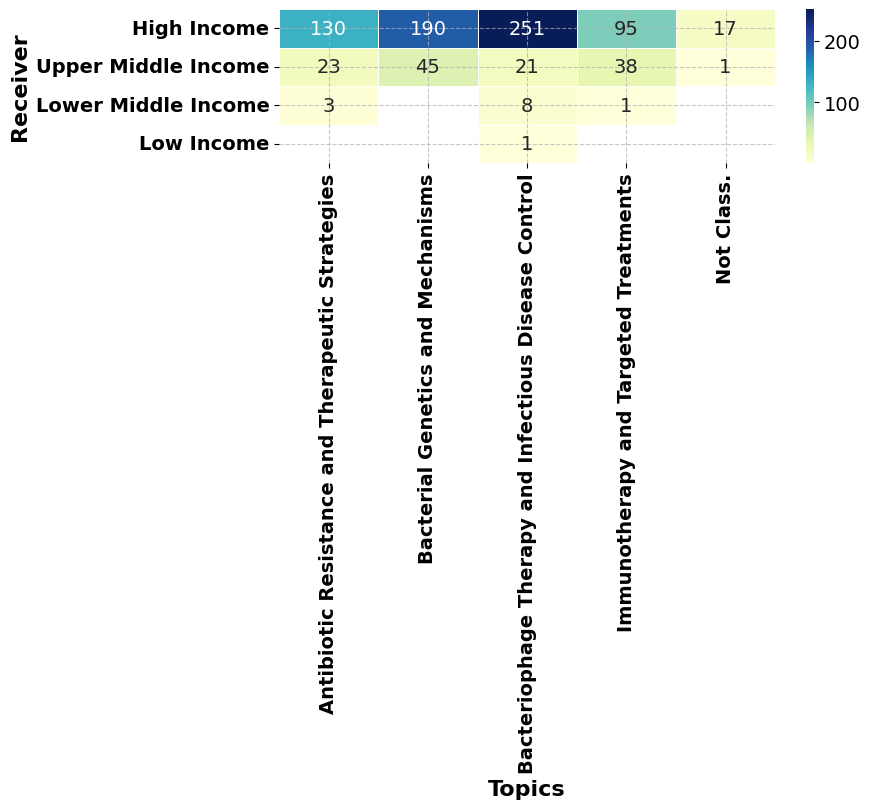

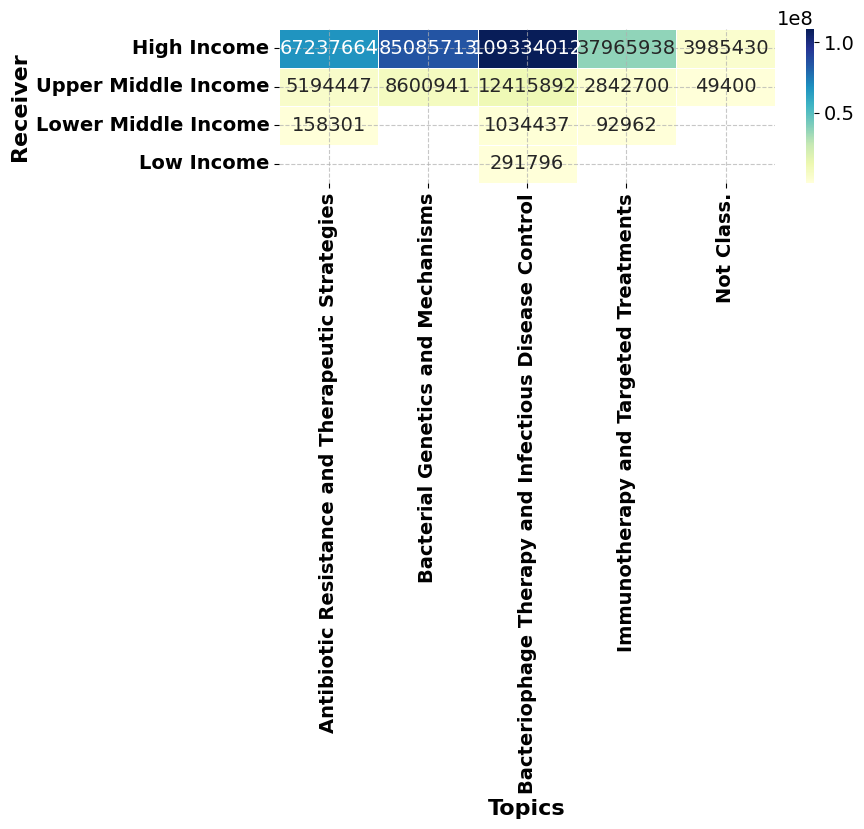

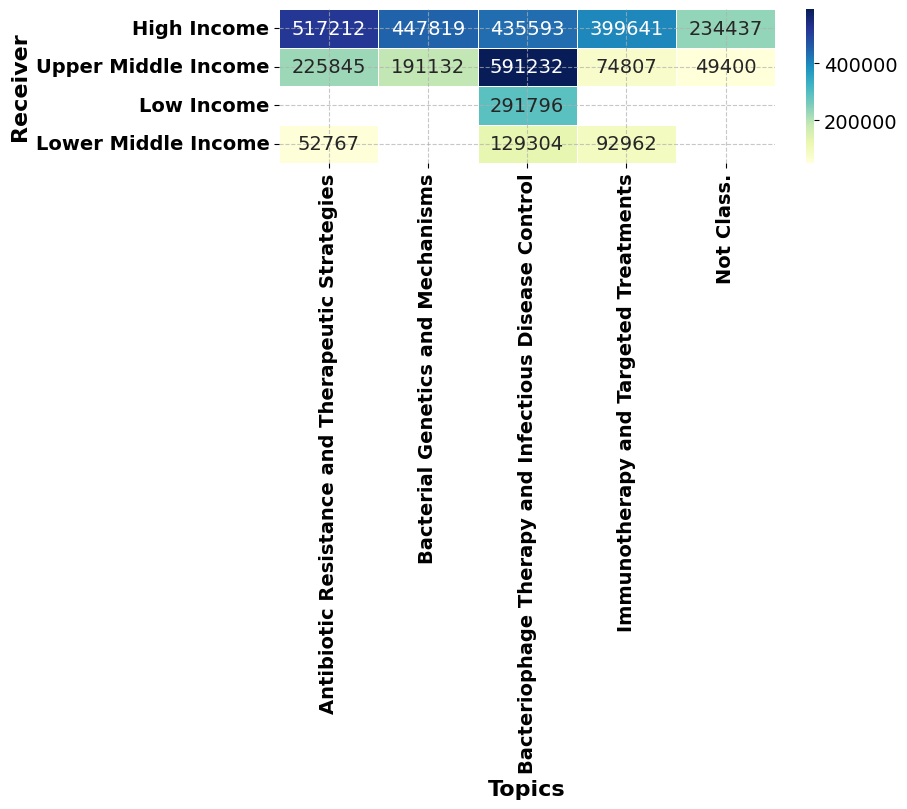

In [ ]:
col_name = 'Receiver - Income group'
xlabel = 'Topics'
ylabel = 'Receiver'
pivot_df = group_and_pivot_Assignee(col_name,data)
figsize=(8, 2)
n_largest = 20

plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df

Average Funding amount in USD  \
Topic N°                Antibiotic Resistance and Therapeutic Strategies   
Receiver - Income group                                                    
High income                                                517212.800000   
Low income                                                           NaN   
Lower middle income                                         52767.000000   
Upper middle income                                        225845.521739   

                                                           \
Topic N°                Bacterial Genetics and Mechanisms   
Receiver - Income group                                     
High income                                 447819.542105   
Low income                                            NaN   
Lower middle income                                   NaN   
Upper middle income                         191132.022222   

                                                                              \
Topic N°                Bacteriophage Therapy and Infectious Disease Control   
Receiver - Income group                                                        
High income                                                  435593.673307     
Low income                                                   291796.000000     
Lower middle income                                          129304.625000     
Upper middle income                                          591232.952381     

                                                                              \
Topic N°                Immunotherapy and Targeted Treatments     Not Class.   
Receiver - Income group                                                        
High income                                     399641.452632  234437.058824   
Low income                                                NaN            NaN   
Lower middle income                              92962.000000            NaN   
Upper middle income                              74807.894737   49400.000000   

                                             Total Funding amount in USD  \
Topic N°                Antibiotic Resistance and Therapeutic Strategies   
Receiver - Income group                                                    
High income                                                   67237664.0   
Low income                                                           NaN   
Lower middle income                                             158301.0   
Upper middle income                                            5194447.0   

                                                           \
Topic N°                Bacterial Genetics and Mechanisms   
Receiver - Income group                                     
High income                                    85085713.0   
Low income                                            NaN   
Lower middle income                                   NaN   
Upper middle income                             8600941.0   

                                                                              \
Topic N°                Bacteriophage Therapy and Infectious Disease Control   
Receiver - Income group                                                        
High income                                                    109334012.0     
Low income                                                        291796.0     
Lower middle income                                              1034437.0     
Upper middle income                                             12415892.0     

                                                                          \
Topic N°                Immunotherapy and Targeted Treatments Not Class.   
Receiver - Income group                                                    
High income                                        37965938.0  3985430.0   
Low income                                                NaN        NaN   
Lower middle income                                   9296

##  Receiver - Global north - south

The number of unique Assignee is: 3


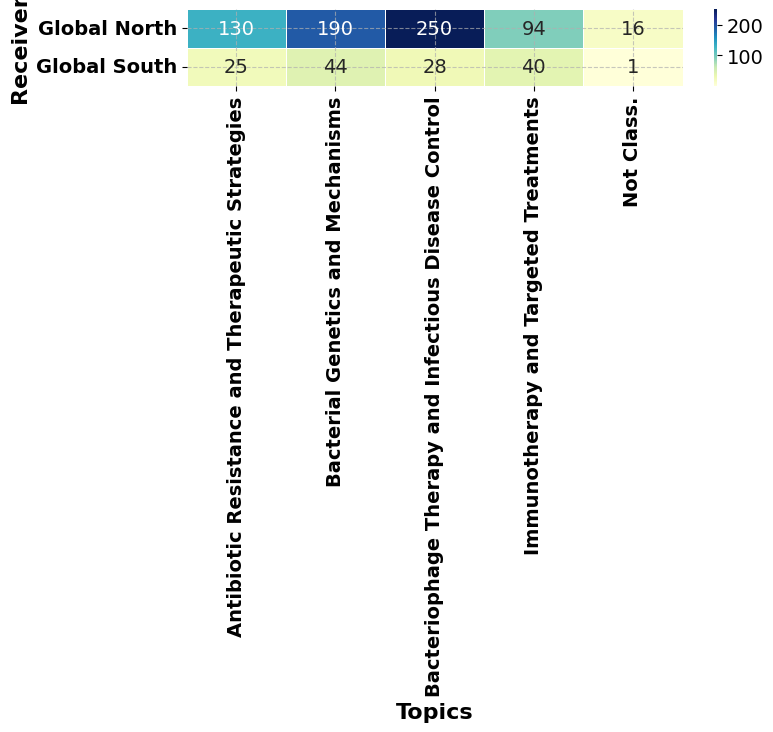

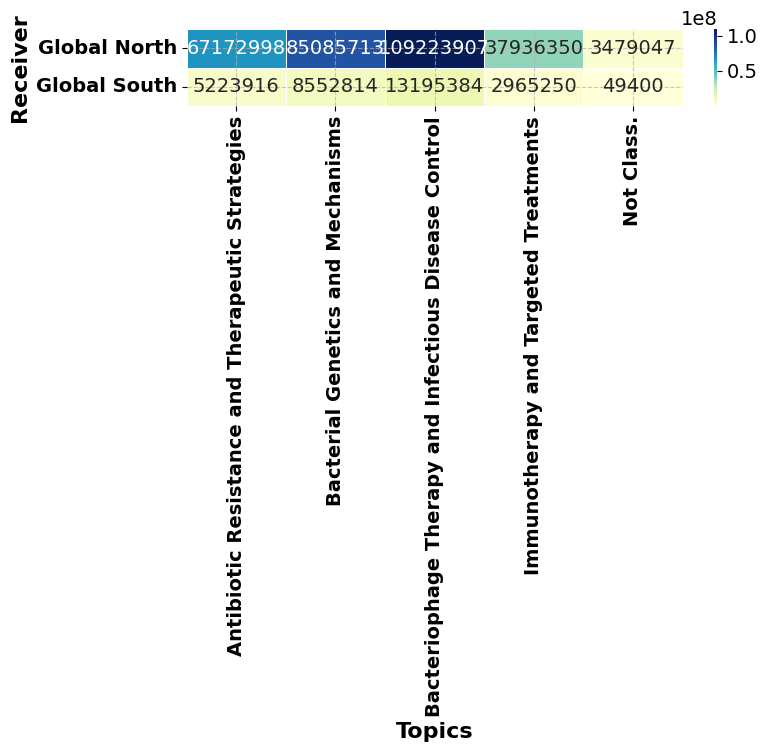

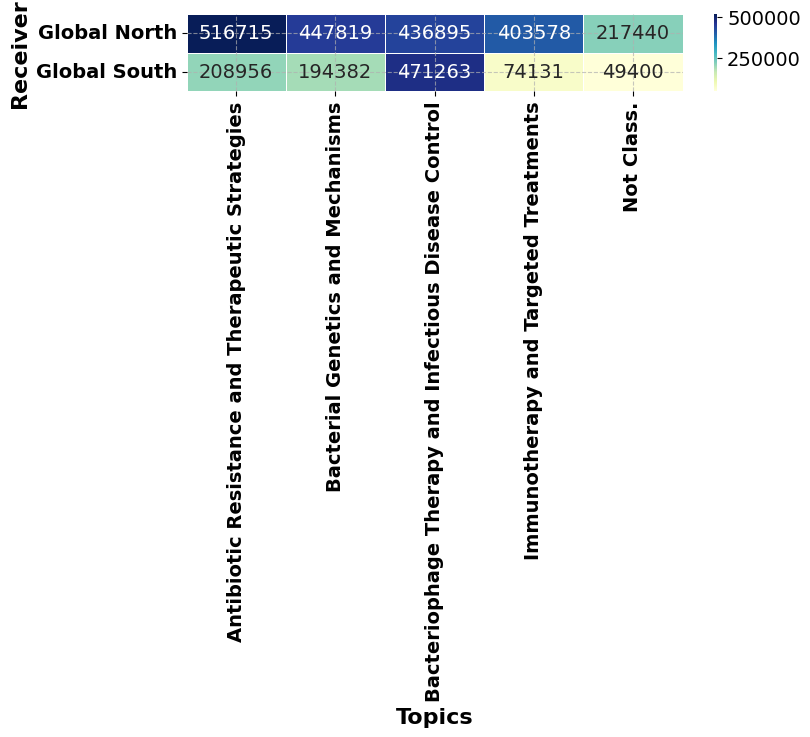

In [ ]:
col_name = 'Receiver - Global north - south'
xlabel = 'Topics'
ylabel = 'Receiver'
pivot_df = group_and_pivot_Assignee(col_name,data)
figsize=(8, 1)
n_largest = 20

plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

##  Gender

The number of unique Assignee is: 2


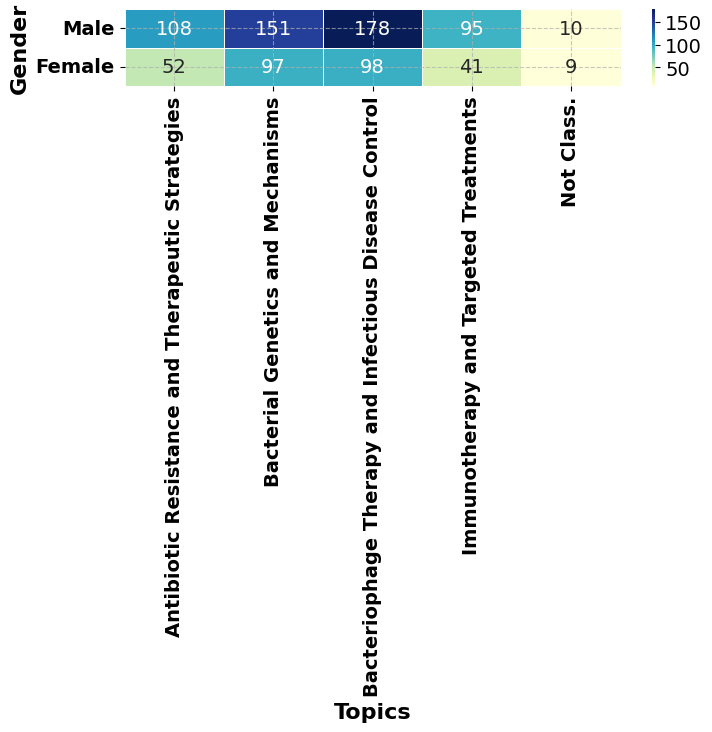

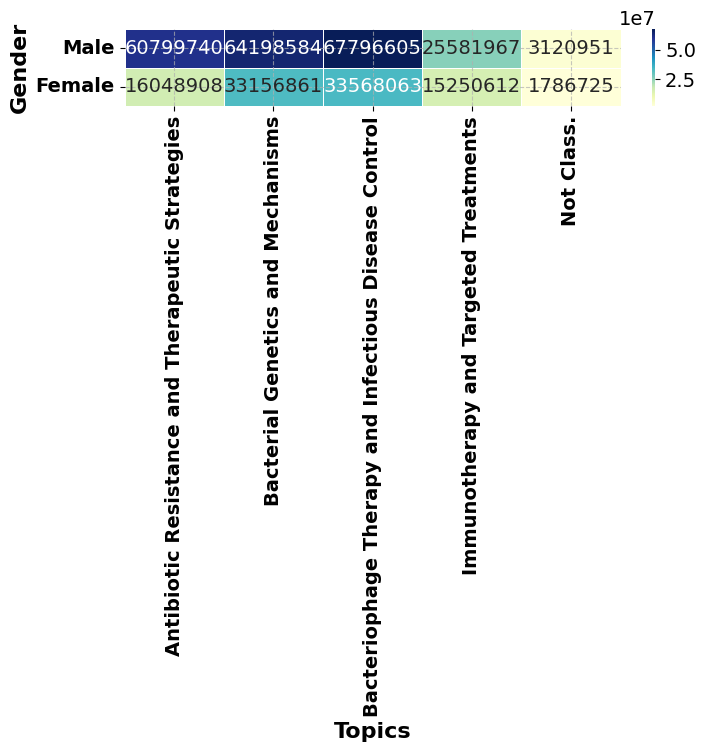

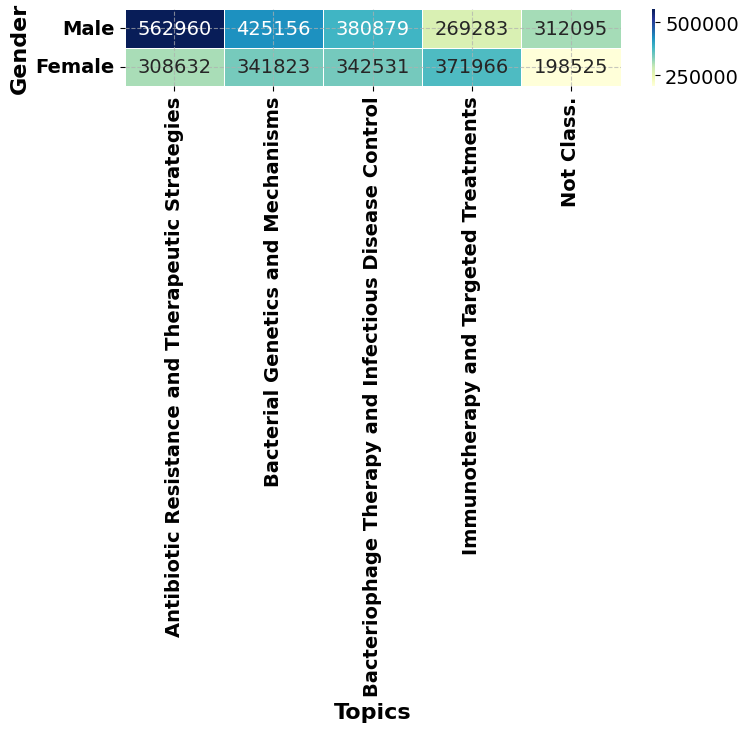

In [ ]:
col_name = 'Gender'
xlabel = 'Topics'
ylabel = 'Gender'
pivot_df = group_and_pivot_Assignee(col_name,data)
figsize=(8, 1)
n_largest = 20

plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

In [ ]:
data.columns

Index(['Rank', 'Grant ID', 'Grant Number(s)', 'Title', 'Title translated',
       'Abstract', 'Abstract translated', 'Keywords', 'Colonne1', 'includes ?',
       'Funding amount', 'Currency', 'Funding amount in USD', 'Start date',
       'Start Year', 'End Date', 'End Year', 'Researchers',
       'Research Organization - original',
       'Research Organization - standardized', 'GRID ID',
       'City of standardized research organization',
       'State of standardized research organization',
       'Country of standardized research organization', 'Funder',
       'Funder Type', 'Funder Group', 'Funder Country', 'Funder Region',
       'Funder Income group', 'funder Global north - south', 'Program',
       'NIH activity code', 'Resulting publications', 'Source Linkout',
       'Dimensions URL', 'Fields of Research (ANZSRC 2020)', 'RCDC Categories',
       'HRCS HC Categories', 'HRCS RAC Categories', 'Cancer Types',
       'CSO Categories', 'Units of Assessment',
       'Sustainable De

##Assignee Region

In [ ]:
# col_name = 'Funder'
# xlabel = 'Topics'
# ylabel = 'Funder'
# pivot_df = group_and_pivot_Assignee(col_name,data)
# figsize=(3, 6)
# n_largest = 20

# plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
# plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
# plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

##  Assignee countries

In [ ]:
# col_name = 'Funder'
# xlabel = 'Topics'
# ylabel = 'Funder'
# pivot_df = group_and_pivot_Assignee(col_name,data)
# figsize=(3, 6)
# n_largest = 20

# plot_top_50_heatmap(col_name, pivot_df, 'Total Grant', xlabel, ylabel,n_largest,figsize)
# plot_top_50_heatmap(col_name, pivot_df, 'Total Funding amount in USD', xlabel, ylabel,n_largest,figsize)
# plot_top_50_heatmap(col_name, pivot_df, 'Average Funding amount in USD', xlabel, ylabel,n_largest,figsize)

# diagram

## draw_chord_diagram

In [ ]:
import pandas as pd

# Example to load data from a CSV file
# df = pd.read_csv('path_to_your_file.csv')

# If your data is already in a Python structure, you can create a DataFrame directly
# Replace the below example with your actual column names and data
data3 = {
    'Funder Country': ['Country A', 'Country B', 'Country A', 'Country C'],
    'Receiver Country': ['Country D', 'Country E', 'Country D', 'Country F'],
    'Funding Amount': [1000, 2000, 1500, 2500]
}

df = pd.DataFrame(data3)
df

,Funder Country,Receiver Country,Funding Amount
0,Country A,Country D,1000
1,Country B,Country E,2000
2,Country A,Country D,1500
3,Country C,Country F,2500


In [ ]:
# Aggregate the data to sum the funding amounts for each unique funder-receiver pair
aggregated_data = df.groupby(['Funder Country', 'Receiver Country']).sum().reset_index()
aggregated_data

,Funder Country,Receiver Country,Funding Amount
0,Country A,Country D,2500
1,Country B,Country E,2000
2,Country C,Country F,2500


In [ ]:
# This is essentially your 'aggregated_data' DataFrame
network_data = aggregated_data.copy()
network_data

,Funder Country,Receiver Country,Funding Amount
0,Country A,Country D,2500
1,Country B,Country E,2000
2,Country C,Country F,2500


In [ ]:
# Create a pivot table to generate the square matrix
chord_matrix = aggregated_data.pivot_table(index='Funder Country', columns='Receiver Country', values='Funding Amount', fill_value=0)

# Optionally, if you need to include all countries as both funders and receivers:
all_countries = pd.Series(list(set(df['Funder Country']) | set(df['Receiver Country'])))
chord_matrix = chord_matrix.reindex(index=all_countries, columns=all_countries, fill_value=0).fillna(0)
chord_matrix

,Country A,Country D,Country F,Country E,Country B,Country C
Country A,0,2500,0,0,0,0
Country D,0,0,0,0,0,0
Country F,0,0,0,0,0,0
Country E,0,0,0,0,0,0
Country B,0,0,0,2000,0,0
Country C,0,0,2500,0,0,0


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.path import Path
from matplotlib.patches import PathPatch


In [ ]:
def draw_chord_diagram(matrix, labels=None, colors=None, ax=None):
    if ax is None:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xlim(-1.1, 1.1)
        ax.set_ylim(-1.1, 1.1)

    n = len(matrix)
    radii = np.sqrt(matrix.sum(axis=1))
    angles = np.pi * 2 * radii / radii.sum()
    points = np.cumsum(np.append([0], angles))[:-1]

    if labels is None:
        labels = [str(i) for i in range(n)]

    if colors is None:
        colors = plt.cm.tab20(np.linspace(0, 1, n))

    # Draw outer circle
    ax.set_axis_off()
    ax.plot(np.cos(np.linspace(0, 2*np.pi, 100)), np.sin(np.linspace(0, 2*np.pi, 100)), lw=2, color='black')

    for i in range(n):
        start_angle = points[i]
        end_angle = points[i] + angles[i]
        arc = Path.arc(start_angle * 180 / np.pi, end_angle * 180 / np.pi)

        path = Path.make_compound_path(
            Path.arc(start_angle * 180 / np.pi, end_angle * 180 / np.pi),
            Path.arc((end_angle - 0.01) * 180 / np.pi, (start_angle + 0.01) * 180 / np.pi, isseghalf=True).transformed(
                plt.Affine2D().rotate_around(0, 0, np.pi).scale(-1, 1)
            )
        )
        patch = PathPatch(path, facecolor=colors[i], edgecolor='black', lw=1.5)
        ax.add_patch(patch)

        # Labels
        ax.text(np.cos((start_angle + angles[i] / 2)) * 1.1,
                np.sin((start_angle + angles[i] / 2)) * 1.1,
                labels[i],
                ha='center',
                va='center')

    # Draw chords
    for i in range(n):
        for j in range(i, n):
            if matrix[i, j] > 0:
                path = Path([np.cos(points[i]) * radii[i] / radii.max(),
                             np.sin(points[i]) * radii[i] / radii.max(),
                             np.cos(points[j]) * radii[j] / radii.max(),
                             np.sin(points[j]) * radii[j] / radii.max()])
                patch = PathPatch(path, lw=2, edgecolor=colors[i], facecolor='none')
                ax.add_patch(patch)


In [ ]:
# # Assuming `chord_matrix` is your DataFrame from previous steps
# matrix = chord_matrix.values  # Convert DataFrame to numpy array
# labels = chord_matrix.index.to_list()  # Assuming your DataFrame index has the country labels

# draw_chord_diagram(matrix, labels)
# plt.show()


In [ ]:
data

,Rank,Grant ID,Grant Number(s),Title,Title translated,Abstract,Abstract translated,Keywords,Colonne1,includes ?,Funding amount,Currency,Funding amount in USD,Start date,Start Year,End Date,End Year,Researchers,Research Organization - original,Research Organization - standardized,GRID ID,City of standardized research organization,State of standardized research organization,Country of standardized research organization,Funder,Funder Type,Funder Group,Funder Country,Funder Region,Funder Income group,funder Global north - south,Program,NIH activity code,Resulting publications,Source Linkout,Dimensions URL,Fields of Research (ANZSRC 2020),RCDC Categories,HRCS HC Categories,HRCS RAC Categories,Cancer Types,CSO Categories,Units of Assessment,Sustainable Development Goals,Topic N°,Gender,Receiver - Country of standardized research organization,Receiver - Region of standardized research organization,Receiver - Type of standardized research organization,Receiver - Income group,Receiver - Global north - south
0,995,grant.7139800,BC996337; DAMD17-01-1-0644,Targeting Bone Marrow in vivo by a novel phage...,Targeting Bone Marrow in vivo by a novel phage...,TECHNICAL ABSTRACT\nUse of the phage display l...,TECHNICAL ABSTRACT\nUse of the phage display l...,NaN,",",1,75000,USD,75000,1999-10-01,1999,2000-09-01,2000.0,Amin Hajitou,"M.D. ANDERSON CANCER CENTER, UNIVERSITY OF TEXAS",The University Of Texas Md Anderson Cancer Center,grid.240145.6,Houston,Texas,United States,Congressionally Directed Medical Research Prog...,Government,DoD - United States Department of Defense; US ...,United States,North America,High income,Global North,BCRP (Program); Concept Award (Funding Mechanism),Not available,pub.1018368931; pub.1030297064; pub.1044312036,NaN,https://app.dimensions.ai/details/grant/grant....,31 Biological Sciences; 3206 Medical Biotechno...,Biotechnology,NaN,NaN,Breast Cancer,4.1 Technology Development and/or Marker Disco...,B11 Computer Science and Informatics,NaN,Immunotherapy and Targeted Treatments,Male,United States,North America,Education,High income,Global North
1,1498,grant.2655618,R43NS037627,DEVELOP MULTIPLE SCLEROSIS TREATMENT USING PHA...,DEVELOP MULTIPLE SCLEROSIS TREATMENT USING PHA...,DESCRIPTION: (Applicant's abstract) Multiple s...,DESCRIPTION: (Applicant's abstract) Multiple s...,bacterial virus; collagenase; enzyme inhibitor...,",",1,100000,USD,100000,1999-08-01,1999,2000-01-31,2000.0,Jasmin Enright,DYAX CORPORATION,Takeda (United States),grid.419849.9,Deerfield,Illinois,United States,National Institute of Neurological Disorders a...,Facility,US Federal Funders; NIH - National Institutes ...,United States,North America,High income,Global North,SBIR/STTR (Funding Mechanism),R43,NaN,http://projectreporter.nih.gov/project_info_de...,https://app.dimensions.ai/details/grant/grant....,32 Biomedical and Clinical Sciences; 3209 Neur...,Biotechnology; Neurodegenerative; Autoimmune D...,Neurological,5.1 Pharmaceuticals,Nervous System,5.3 Systemic Therapies - Discovery and Develop...,"A06 Agriculture, Veterinary and Food Science",NaN,Immunotherapy and Targeted Treatments,Female,United States,North America,Company,High income,Global North
2,1142,grant.2796285,NaN,A Bacteriophage approach for the development o...,A Bacteriophage approach for the development o...,NaN,NaN,NaN,",",1,16967,CAD,11418,1999-04-01,1999,2000-03-31,2000.0,Jing Liu,Targanta Therapeutics Inc.; No Partners,Novartis (Canada),grid.436665.4,Mississauga,Ontario,Canada,Natural Sciences and Engineering Research Council,Government,ICRP - International Cancer Research Partnership,Canada,North America,High income,Global North,Industrial Research Fellowships (Program),Not available,NaN,http://www.nserc-crsng.gc.ca/ase-oro/Details-D...,https://app.dimensions.ai/details/grant/grant....,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Not Class.,Female,Canada,North America,Company,High income,Global North
3,1699,grant.2944505,NaN,A bacteriophage approach for the development o...,A bacteriophage a

In [ ]:
data.columns

Index(['Rank', 'Grant ID', 'Grant Number(s)', 'Title', 'Title translated',
       'Abstract', 'Abstract translated', 'Keywords', 'Colonne1', 'includes ?',
       'Funding amount', 'Currency', 'Funding amount in USD', 'Start date',
       'Start Year', 'End Date', 'End Year', 'Researchers',
       'Research Organization - original',
       'Research Organization - standardized', 'GRID ID',
       'City of standardized research organization',
       'State of standardized research organization',
       'Country of standardized research organization', 'Funder',
       'Funder Type', 'Funder Group', 'Funder Country', 'Funder Region',
       'Funder Income group', 'funder Global north - south', 'Program',
       'NIH activity code', 'Resulting publications', 'Source Linkout',
       'Dimensions URL', 'Fields of Research (ANZSRC 2020)', 'RCDC Categories',
       'HRCS HC Categories', 'HRCS RAC Categories', 'Cancer Types',
       'CSO Categories', 'Units of Assessment',
       'Sustainable De

## sankey diagram

In [ ]:
import plotly.graph_objects as go

# # Example data preparation
# data = {
#     'Funder': ['Country A', 'Country A', 'Country B', 'Country B'],
#     'Receiver': ['Country C', 'Country D', 'Country C', 'Country E'],
#     'Funding': [100, 200, 150, 250]
# }

# # Assuming this is the final form of your data after any necessary preprocessing
df_sankey = data.copy()

# Mapping of nodes to integers
unique_nodes = pd.Index(pd.concat([df_sankey['Funder Income group'],
                                   df_sankey['Receiver - Income group']]).reset_index(drop=True).unique())

# Create a Sankey diagram
fig = go.Figure(data=[go.Sankey(
    node=dict(
      pad=15,
      thickness=20,
      line=dict(color="black", width=0.5),
      label=unique_nodes,
    ),
    link=dict(
      source=[unique_nodes.get_loc(funder) for funder in df_sankey['Funder Income group']],  # indices of the source nodes
      target=[unique_nodes.get_loc(receiver) for receiver in df_sankey['Receiver - Income group']],  # indices of the target nodes
      value=df_sankey['Funding amount in USD'],  # magnitude of the flow between nodes
    ))])

fig.update_layout(title_text="Funding Flows from Funder Countries to Receiver Countries", font_size=10)
fig.show()


In [ ]:
unique_nodes

Index(['High income', 'Upper middle income', 'Lower middle income',
       'High income;Upper middle income',
       'High income;Lower middle income;Upper middle income',
       'High income;Low income;Lower middle income'],
      dtype='object')

In [ ]:
import pandas as pd

data4 = {
    'Funder Country': ['Country A', 'Country B', 'Country A', 'Country C'],
    'Receiver Country': ['Country D', 'Country E', 'Country F', 'Country D'],
    'Funding Amount': [1000, 2000, 1500, 2500]
}

df = pd.DataFrame(data4)


In [ ]:
import plotly.graph_objects as go
df = data.copy()
# Unique labels (all the countries involved as funders and receivers)
labels = pd.concat([df['Funder Income group'], df['Receiver - Income group']]).unique()

# Create a map for the labels to integers
label_to_id = {label: id for id, label in enumerate(labels)}

# Define sources and targets using the mapped integers
sources = df['Funder Income group'].map(label_to_id)
targets = df['Receiver - Income group'].map(label_to_id)
values = df['Funding amount in USD']

# Create the Sankey diagram
fig = go.Figure(data=[go.Sankey(
    node=dict(
      pad=15,  # Padding between nodes
      thickness=20,  # Node thickness
      line=dict(color="black", width=0.5),
      label=labels
    ),
    link=dict(
      source=sources,  # Indices correspond to labels, eg: [0, 1, 0, 2]
      target=targets,  # Indices correspond to labels, eg: [3, 4, 5, 3]
      value=values  # Funding amounts for each flow
    ))])

fig.update_layout(title_text="Funding Flows from Funder to Receiver Countries", font_size=10)
fig.show()


# Topics

In [ ]:
# Step 1: Group data by 'Publication Year' and 'topic', then count occurrences
topic_counts_by_year = data.reset_index().groupby(['Start Year', 'Topic N°']).size().unstack(fill_value=0)

# Step 2: Calculate the total count of each topic
total_counts = topic_counts_by_year.sum()

# Step 3: Sort columns by total count
sorted_columns = total_counts.sort_values(ascending=False).index
topic_counts_by_year = topic_counts_by_year[sorted_columns]

# Step 4: Add a row with the total count of each topic
topic_counts_by_year.loc['Total'] = total_counts.loc[sorted_columns]

# Save the DataFrame to CSV and pickle files
# topic_counts_by_year.to_csv(f'/content/drive/MyDrive/YORKU PROJECT/JUDE/BACTERIOPHAGE/topic_counts_by_year_patent_therapy_23102023_{n_topics}.csv')
# topic_counts_by_year.to_pickle(f'/content/drive/MyDrive/YORKU PROJECT/JUDE/BACTERIOPHAGE/topic_counts_by_year_patent_therapy_23102023_{n_topics}.pkl')

# This will give you a DataFrame where each row is a year (plus a 'Total' row at the bottom),
# and each column is the count of documents associated with a topic for that year (and the total count).

# Display the updated DataFrame
topic_counts_by_year

Topic N°,Bacteriophage Therapy and Infectious Disease Control,Bacterial Genetics and Mechanisms,Antibiotic Resistance and Therapeutic Strategies,Immunotherapy and Targeted Treatments,Not Class.
Start Year,,,,,
1999,0,1,1,3,2
2000,6,3,0,9,0
2001,1,3,0,4,1
2002,0,2,0,3,0
2003,1,4,1,3,0
2004,3,0,2,2,0
2005,2,2,0,2,0
2006,4,1,3,2,0
2007,6,2,0,4,1


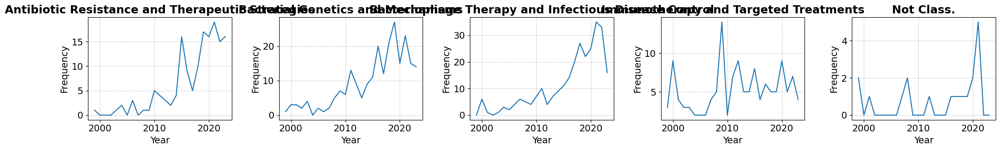

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Read the DataFrame from the CSV file (assuming it's stored as 'topic_counts_by_year.csv')
# Replace this line with your actual data if it's not in a CSV
#topic_counts_by_year = pd.read_csv('topic_counts_by_year.csv', index_col='Publication Year')

# Remove the 'Total' row if it exists
if 'Total' in topic_counts_by_year.index:
    topic_counts_by_year = topic_counts_by_year.drop(index=['Total'])

# Sort columns by topic name
topic_counts_by_year = topic_counts_by_year.sort_index(axis=1)

# Define the number of topics (make sure this matches your data)
n_topics = len(topic_counts_by_year.columns)

# Calculate the number of rows needed for subplots
n_rows = (n_topics + 4) // 5  # +4 for rounding up

# Create a grid of subplots
fig, axes = plt.subplots(n_rows, 5, figsize=(20, n_rows * 3.5))

# Flatten the array to easily iterate over it
axes_flat = axes.flatten()

# Loop through each topic and plot its curve on a separate subplot
for i, topic in enumerate(topic_counts_by_year.columns):
    axes_flat[i].plot(
        topic_counts_by_year.index,
        topic_counts_by_year[topic]
    )
    axes_flat[i].set_title(f'{topic}', fontweight='bold')
    axes_flat[i].set_xlabel('Year')#, fontweight='bold')
    axes_flat[i].set_ylabel('Frequency')#, fontweight='bold')
    axes_flat[i].grid(True, which='both', linestyle='--', linewidth=0.5)

# Remove extra subplots
for i in range(n_topics, len(axes_flat)):
    fig.delaxes(axes_flat[i])

# Add a main title for the entire figure
#fig.suptitle('Evolution Curve for Each Topic', fontsize=16, fontweight='bold')

# Save the figure
plt.tight_layout(rect=[0, 0, 1, 0.96])  # Make room for the main title
# plt.savefig(f'/content/drive/MyDrive/YORKU PROJECT/JUDE/BACTERIOPHAGE/topic_evolution_curves_subplot_ordered_patent_therapy_23102023_{n_topics}.png', dpi=600)

# Show the figure
plt.show()


In [ ]:
# # Save data to CSV and Pickle formats
# data.to_csv(f'/content/drive/Othercomputers/My laptop/D:/PROJECT/YORK UNIVERSITY/The Future of Laboratory Medecine/PATENT DATA/final_data_ai_lab_medicine.csv', index=False)
# data.to_pickle(f'/content/drive/Othercomputers/My laptop/D:/PROJECT/YORK UNIVERSITY/The Future of Laboratory Medecine/PATENT DATA/final_data_ai_lab_medicine.pkl')
# data.to_excel(f'/content/drive/Othercomputers/My laptop/D:/PROJECT/YORK UNIVERSITY/The Future of Laboratory Medecine/PATENT DATA/final_data_ai_lab_medicine.xlsx')
data.head(1)

,Rank,Grant ID,Grant Number(s),Title,Title translated,Abstract,Abstract translated,Keywords,Colonne1,includes ?,Funding amount,Currency,Funding amount in USD,Start date,Start Year,End Date,End Year,Researchers,Research Organization - original,Research Organization - standardized,GRID ID,City of standardized research organization,State of standardized research organization,Country of standardized research organization,Funder,Funder Type,Funder Group,Funder Country,Funder Region,Funder Income group,funder Global north - south,Program,NIH activity code,Resulting publications,Source Linkout,Dimensions URL,Fields of Research (ANZSRC 2020),RCDC Categories,HRCS HC Categories,HRCS RAC Categories,Cancer Types,CSO Categories,Units of Assessment,Sustainable Development Goals,Topic N°,Gender,Receiver - Country of standardized research organization,Receiver - Region of standardized research organization,Receiver - Type of standardized research organization,Receiver - Income group,Receiver - Global north - south
0,995,grant.7139800,BC996337; DAMD17-01-1-0644,Targeting Bone Marrow in vivo by a novel phage...,Targeting Bone Marrow in vivo by a novel phage...,TECHNICAL ABSTRACT\nUse of the phage display l...,TECHNICAL ABSTRACT\nUse of the phage display l...,NaN,",",1,75000,USD,75000,1999-10-01,1999,2000-09-01,2000.0,Amin Hajitou,"M.D. ANDERSON CANCER CENTER, UNIVERSITY OF TEXAS",The University Of Texas Md Anderson Cancer Center,grid.240145.6,Houston,Texas,United States,Congressionally Directed Medical Research Prog...,Government,DoD - United States Department of Defense; US ...,United States,North America,High income,Global North,BCRP (Program); Concept Award (Funding Mechanism),Not available,pub.1018368931; pub.1030297064; pub.1044312036,NaN,https://app.dimensions.ai/details/grant/grant....,31 Biological Sciences; 3206 Medical Biotechno...,Biotechnology,NaN,NaN,Breast Cancer,4.1 Technology Development and/or Marker Disco...,B11 Computer Science and Informatics,NaN,Immunotherapy and Targeted Treatments,Male,United States,North America,Education,High income,Global North
